In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.decomposition import PCA
from matplotlib import pyplot as plt

from mpl_toolkits.mplot3d import Axes3D
from pathlib import Path

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from pathlib import Path
from sklearn.metrics import (roc_curve, auc, accuracy_score)
from sklearn.preprocessing import StandardScaler

import nltk

# tagged = nltk.pos_tag(tokens)
tagged[0:6]

# Localからテキストを読み込む

In [2]:
#author = ['Poe', 'Twain', 'AB', 'CD', 'NH', 'OH', 'WI','HG','RK','GW','KM','SC','JL','AE','PG','LM','SK','AC','FA','HL']

In [3]:
#homePC
#path_0 = Path(r'C:\Users\SI\Python_ML\python_NLTK\NLTK_')

#officePC
path_0 = Path(r'C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_')

author = ['Poe', 'Poe']
type_ = ['letter', 'story']

choice = [0,1]

index_i = 1
index_j = 1

path = str(path_0) + str('/') + str(author[choice[index_i]]) + str('-') + str(type_[choice[index_j]])
print(path)

C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_/Poe-story


In [4]:
new_dir_path_csv = 'csv/' + str(author[choice[index_i]]) + str('-') + str(type_[choice[index_j]])
new_dir_path_png = 'png/' + str(author[choice[index_i]]) + str('-') + str(type_[choice[index_j]])

author_type = str(author[choice[index_i]]) + str('-') + str(type_[choice[index_j]])

new_dir_path_png_top = 'png/' + author_type + '/top_ranking'
new_dir_path_png_top_no_punc = 'png/' + author_type + '/top_ranking_no_punc'
new_dir_path_png_top_no_punc_no_stopwords = 'png/' + author_type + '/top_ranking_no_punc_no_stopwords'
new_dir_path_png_dispersion_plot = 'png/' + author_type + '/dispersion_plot'
new_dir_path_png_biagram_plot  = 'png/' + author_type + '/biagram_plot'

def my_makedirs(path):
    if not os.path.isdir(path):
        os.makedirs(path)

my_makedirs(new_dir_path_csv)
my_makedirs(new_dir_path_png)
my_makedirs(new_dir_path_png_top)
my_makedirs(new_dir_path_png_top_no_punc)
my_makedirs(new_dir_path_png_top_no_punc_no_stopwords)

my_makedirs(new_dir_path_png_dispersion_plot)
my_makedirs(new_dir_path_png_biagram_plot)

In [5]:
new_dir_path_csv, new_dir_path_png, new_dir_path_png_top, new_dir_path_png_top_no_punc, new_dir_path_png_top_no_punc_no_stopwords,new_dir_path_png_dispersion_plot, new_dir_path_png_biagram_plot

('csv/Poe-story',
 'png/Poe-story',
 'png/Poe-story/top_ranking',
 'png/Poe-story/top_ranking_no_punc',
 'png/Poe-story/top_ranking_no_punc_no_stopwords',
 'png/Poe-story/dispersion_plot',
 'png/Poe-story/biagram_plot')

In [6]:
#path = Path(r'C:\Users\tsuka\Desktop\txt')
#path = Path(r'C:\Users\SI\Python_ML\NLTK_\txt\Poe-story')
path = Path(path)
path
path.glob('*.txt')
list(path.glob('*.txt'))
print('lists:', path.glob('*.txt'))
#list path
path = list(path.glob('*.txt'))
path


lists: <generator object Path.glob at 0x000001D29A852748>


[WindowsPath('C:/Users/Si/Desktop/python_all/python_NLTK/NLTK_/Poe-story/Poe-story-001.txt'),
 WindowsPath('C:/Users/Si/Desktop/python_all/python_NLTK/NLTK_/Poe-story/Poe-story-002.txt'),
 WindowsPath('C:/Users/Si/Desktop/python_all/python_NLTK/NLTK_/Poe-story/Poe-story-003.txt'),
 WindowsPath('C:/Users/Si/Desktop/python_all/python_NLTK/NLTK_/Poe-story/Poe-story-004.txt'),
 WindowsPath('C:/Users/Si/Desktop/python_all/python_NLTK/NLTK_/Poe-story/Poe-story-005.txt'),
 WindowsPath('C:/Users/Si/Desktop/python_all/python_NLTK/NLTK_/Poe-story/Poe-story-006.txt'),
 WindowsPath('C:/Users/Si/Desktop/python_all/python_NLTK/NLTK_/Poe-story/Poe-story-007.txt'),
 WindowsPath('C:/Users/Si/Desktop/python_all/python_NLTK/NLTK_/Poe-story/Poe-story-008.txt'),
 WindowsPath('C:/Users/Si/Desktop/python_all/python_NLTK/NLTK_/Poe-story/Poe-story-009.txt'),
 WindowsPath('C:/Users/Si/Desktop/python_all/python_NLTK/NLTK_/Poe-story/Poe-story-010.txt'),
 WindowsPath('C:/Users/Si/Desktop/python_all/python_NLTK/NLT

In [7]:
data = pd.read_table(path[0], encoding='cp932')#encoding="utf-8"

#data = pd.read_table(path[11], encoding='euc_jp')#encoding="utf-8"
data

,THE SWISS BELL-RINGERS
0,"One of the regular allies of the Mirror, a man..."
1,The Swiss Bell-ringers. ? The readers of the M...


# テキストの内容をリスト化１

In [8]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Si\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [9]:
import nltk

file_content = open(path[0]).read()
tokens = nltk.word_tokenize(file_content)
tokens

['THE',
 'SWISS',
 'BELL-RINGERS',
 'One',
 'of',
 'the',
 'regular',
 'allies',
 'of',
 'the',
 'Mirror',
 ',',
 'a',
 'man',
 'of',
 'a',
 'very',
 'humorous',
 'critical',
 'vein',
 ',',
 'has',
 'taken',
 'it',
 'into',
 'his',
 'head',
 'to',
 'prove',
 'the',
 'Swiss',
 'Bell-ringers',
 'to',
 'be',
 'an',
 'automaton',
 '.',
 'We',
 'have',
 'argued',
 'the',
 'point',
 'with',
 'him',
 'till',
 'we',
 'are',
 'tired',
 ',',
 'and',
 'have',
 'at',
 'last',
 'sent',
 'to',
 'beg',
 'a',
 'copy',
 'of',
 'their',
 'board-bill',
 'with',
 'affidavits',
 'that',
 'their',
 'stomachs',
 'are',
 'not',
 'wooden',
 'and',
 'do',
 'kindly',
 'entertain',
 'rolls',
 'and',
 'sausages',
 '.',
 'While',
 'these',
 'documents',
 'are',
 'coming',
 ',',
 'we',
 'publish',
 'the',
 'skeleton',
 'of',
 'our',
 'friend',
 '’',
 's',
 'hypothesis',
 ':',
 '?',
 'The',
 'Swiss',
 'Bell-ringers',
 '.',
 '?',
 'The',
 'readers',
 'of',
 'the',
 'Mirror',
 'scarce',
 'need',
 'be',
 'told',
 ',',
 

In [10]:
len(tokens)

496

# テキストの内容をリスト化2

# txtをローカルから読み込む

In [11]:
read_book_list = []
for i in range(len(path)):
    try:
        #data = pd.read_table(path[i], encoding='cp932')
        data = pd.read_table(path[i], encoding='cp932')
        file_name = os.path.splitext(os.path.basename(path[i]))[0]
        print(i, path[i])

        file_content = open(path[i]).read()
        read_book = nltk.word_tokenize(file_content)

        print(i, len(read_book))

        #read_book = nltk.corpus.gutenberg.words(book_list[i])
        read_book_list.append(read_book)
        #print('No.',i,'\n', read_book_list, '\n')
        
    except UnicodeDecodeError:
        print('cp932 codec cant decode some positions in_', file_name,'_Try other files')
        continue

0 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-001.txt
0 496
1 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-002.txt
1 805
2 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-003.txt
2 975
3 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-004.txt
3 8650
4 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-005.txt
4 6755
5 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-006.txt
5 8031
6 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-007.txt
6 3318
7 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-008.txt
7 4194
8 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-009.txt
8 4570
9 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-010.txt
9 8374
10 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-011.txt
10 1580
11 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe

In [12]:
#check

# 変な符号を置き換え

In [13]:
for i in range(len(path)):
    for j in range(len(read_book_list[i])):
        s = read_book_list[i][j]
        read_book_list[i][j] = s.translate(str.maketrans({'乬': None, '乭': None, '乫': None, '乪': None, 'ｪ': None, '｡':None, 'ｰ':None, 'ｱ':None }))
    print('No.',i,'\n', read_book_list[i], '\n')

No. 0 
 ['THE', 'SWISS', 'BELL-RINGERS', 'One', 'of', 'the', 'regular', 'allies', 'of', 'the', 'Mirror', ',', 'a', 'man', 'of', 'a', 'very', 'humorous', 'critical', 'vein', ',', 'has', 'taken', 'it', 'into', 'his', 'head', 'to', 'prove', 'the', 'Swiss', 'Bell-ringers', 'to', 'be', 'an', 'automaton', '.', 'We', 'have', 'argued', 'the', 'point', 'with', 'him', 'till', 'we', 'are', 'tired', ',', 'and', 'have', 'at', 'last', 'sent', 'to', 'beg', 'a', 'copy', 'of', 'their', 'board-bill', 'with', 'affidavits', 'that', 'their', 'stomachs', 'are', 'not', 'wooden', 'and', 'do', 'kindly', 'entertain', 'rolls', 'and', 'sausages', '.', 'While', 'these', 'documents', 'are', 'coming', ',', 'we', 'publish', 'the', 'skeleton', 'of', 'our', 'friend', '’', 's', 'hypothesis', ':', '?', 'The', 'Swiss', 'Bell-ringers', '.', '?', 'The', 'readers', 'of', 'the', 'Mirror', 'scarce', 'need', 'be', 'told', ',', '?', 'as', 'most', 'of', 'them', 'have', 'seen', 'and', 'heard', 'for', 'themselves', ',', '?', 'that'

 ['THE', 'PURLOINED', 'LETTER', 'Nil', 'sapientiae', 'odiosius', 'acumine', 'nimio', '.', 'Seneca', '.', 'At', 'Paris', ',', 'just', 'after', 'dark', 'one', 'gusty', 'evening', 'in', 'the', 'autumn', 'of', '18-', ',', 'I', 'was', 'enjoying', 'the', 'twofold', 'luxury', 'of', 'meditation', 'and', 'a', 'meerschaum', ',', 'in', 'company', 'with', 'my', 'friend', 'C.', 'Auguste', 'Dupin', ',', 'in', 'his', 'little', 'back', 'library', ',', 'or', 'book-closet', ',', 'au', 'troisieme', ',', 'No', '.', '33', ',', 'Rue', 'Dunot', ',', 'Faubourg', 'St.', 'Germain', '.', 'For', 'one', 'hour', 'at', 'least', 'we', 'had', 'maintained', 'a', 'profound', 'silence', ';', 'while', 'each', ',', 'to', 'any', 'casual', 'observer', ',', 'might', 'have', 'seemed', 'intently', 'and', 'exclusively', 'occupied', 'with', 'the', 'curling', 'eddies', 'of', 'smoke', 'that', 'oppressed', 'the', 'atmosphere', 'of', 'the', 'chamber', '.', 'For', 'myself', ',', 'however', ',', 'I', 'was', 'mentally', 'discussing', 'c

No. 24 
 ['THE', 'GOLD-BUG', 'What', 'ho', '!', 'what', 'ho', '!', 'this', 'fellow', 'is', 'dancing', 'mad', '!', 'He', 'hath', 'been', 'bitten', 'by', 'the', 'Tarantula', '.', '?', 'All', 'in', 'the', 'Wrong', '.', 'MANY', 'years', 'ago', ',', 'I', 'contracted', 'an', 'intimacy', 'with', 'a', 'Mr.', 'William', 'Legrand', '.', 'He', 'was', 'of', 'an', 'ancient', 'Huguenot', 'family', ',', 'and', 'had', 'once', 'been', 'wealthy', ';', 'but', 'a', 'series', 'of', 'misfortunes', 'had', 'reduced', 'him', 'to', 'want', '.', 'To', 'avoid', 'the', 'mortification', 'consequent', 'upon', 'his', 'disasters', ',', 'he', 'left', 'New', 'Orleans', ',', 'the', 'city', 'of', 'his', 'forefathers', ',', 'and', 'took', 'up', 'his', 'residence', 'at', 'Sullivan', '’', 's', 'Island', ',', 'near', 'Charleston', ',', 'South', 'Carolina', '.', 'This', 'Island', 'is', 'a', 'very', 'singular', 'one', '.', 'It', 'consists', 'of', 'little', 'else', 'than', 'the', 'sea', 'sand', ',', 'and', 'is', 'about', 'three'

No. 26 
 ['THE', 'MURDERS', 'IN', 'THE', 'RUE', 'MORGUE', 'What', 'song', 'the', 'Syrens', 'sang', ',', 'or', 'what', 'name', 'Achilles', 'assumed', 'when', 'he', 'hid', 'himself', 'among', 'women', ',', 'although', 'puzzling', 'questions', ',', 'are', 'not', 'beyond', 'all', 'conjecture', '.', '?', 'Sir', 'Thomas', 'Browne', '.', 'The', 'mental', 'features', 'discoursed', 'of', 'as', 'the', 'analytical', ',', 'are', ',', 'in', 'themselves', ',', 'but', 'little', 'susceptible', 'of', 'analysis', '.', 'We', 'appreciate', 'them', 'only', 'in', 'their', 'effects', '.', 'We', 'know', 'of', 'them', ',', 'among', 'other', 'things', ',', 'that', 'they', 'are', 'always', 'to', 'their', 'possessor', ',', 'when', 'inordinately', 'possessed', ',', 'a', 'source', 'of', 'the', 'liveliest', 'enjoyment', '.', 'As', 'the', 'strong', 'man', 'exults', 'in', 'his', 'physical', 'ability', ',', 'delighting', 'in', 'such', 'exercises', 'as', 'call', 'his', 'muscles', 'into', 'action', ',', 'so', 'glories', 

No. 41 
 ['MORELLA', 'Itself', ',', 'by', 'itself', ',', 'solely', ',', 'one', 'everlasting', ',', 'and', 'single', '.', 'PLATO', ':', 'SYMPOS', '.', 'WITH', 'a', 'feeling', 'of', 'deep', 'yet', 'most', 'singular', 'affection', 'I', 'regarded', 'my', 'friend', 'Morella', '.', 'Thrown', 'by', 'accident', 'into', 'her', 'society', 'many', 'years', 'ago', ',', 'my', 'soul', 'from', 'our', 'first', 'meeting', ',', 'burned', 'with', 'fires', 'it', 'had', 'never', 'before', 'known', ';', 'but', 'the', 'fires', 'were', 'not', 'of', 'Eros', ',', 'and', 'bitter', 'and', 'tormenting', 'to', 'my', 'spirit', 'was', 'the', 'gradual', 'conviction', 'that', 'I', 'could', 'in', 'no', 'manner', 'define', 'their', 'unusual', 'meaning', 'or', 'regulate', 'their', 'vague', 'intensity', '.', 'Yet', 'we', 'met', ';', 'and', 'fate', 'bound', 'us', 'together', 'at', 'the', 'altar', ',', 'and', 'I', 'never', 'spoke', 'of', 'passion', 'nor', 'thought', 'of', 'love', '.', 'She', ',', 'however', ',', 'shunned', '

No. 46 
 ['THE', 'DEVIL', 'IN', 'THE', 'BELFRY', 'What', 'o', '’', 'clock', 'is', 'it', '?', '?', 'Old', 'Saying', '.', 'EVERYBODY', 'knows', ',', 'in', 'a', 'general', 'way', ',', 'that', 'the', 'finest', 'place', 'in', 'the', 'world', 'is', '?', 'or', ',', 'alas', ',', 'was', '?', 'the', 'Dutch', 'borough', 'of', 'Vondervotteimittiss', '.', 'Yet', 'as', 'it', 'lies', 'some', 'distance', 'from', 'any', 'of', 'the', 'main', 'roads', ',', 'being', 'in', 'a', 'somewhat', 'out-of-the-way', 'situation', ',', 'there', 'are', 'perhaps', 'very', 'few', 'of', 'my', 'readers', 'who', 'have', 'ever', 'paid', 'it', 'a', 'visit', '.', 'For', 'the', 'benefit', 'of', 'those', 'who', 'have', 'not', ',', 'therefore', ',', 'it', 'will', 'be', 'only', 'proper', 'that', 'I', 'should', 'enter', 'into', 'some', 'account', 'of', 'it', '.', 'And', 'this', 'is', 'indeed', 'the', 'more', 'necessary', ',', 'as', 'with', 'the', 'hope', 'of', 'enlisting', 'public', 'sympathy', 'in', 'behalf', 'of', 'the', 'inhabi

No. 63 
 ['THE', 'LANDSCAPE', 'GARDEN', 'The', 'garden', 'like', 'a', 'lady', 'fair', 'was', 'cut', 'That', 'lay', 'as', 'if', 'she', 'slumbered', 'in', 'delight', ',', 'And', 'to', 'the', 'open', 'skies', 'her', 'eyes', 'did', 'shut', ';', 'The', 'azure', 'fields', 'of', 'heaven', 'were', '‘', 'sembled', 'right', 'In', 'a', 'large', 'round', 'set', 'with', 'flow', '’', 'rs', 'of', 'light', ':', 'The', 'flowers', 'de', 'luce', 'and', 'the', 'round', 'sparks', 'of', 'dew', 'That', 'hung', 'upon', 'their', 'azure', 'leaves', ',', 'did', 'show', 'Like', 'twinkling', 'stars', 'that', 'sparkle', 'in', 'the', 'ev', '’', 'ning', 'blue', '.', '?', 'GILES', 'FLETCHER', 'NO', 'MORE', 'remarkable', 'man', 'ever', 'lived', 'than', 'my', 'friend', ',', 'the', 'young', 'Ellison', '.', 'He', 'was', 'remarkable', 'in', 'the', 'entire', 'and', 'continuous', 'profusion', 'of', 'good', 'gifts', 'ever', 'lavished', 'upon', 'him', 'by', 'fortune', '.', 'From', 'his', 'cradle', 'to', 'his', 'grave', ',', 'a

No. 68 
 ['SHADOW', '?', 'A', 'PARABLE', 'Yea', ',', 'though', 'I', 'walk', 'through', 'the', 'valley', 'of', 'the', 'Shadow', ':', '?', 'Psalm', 'of', 'David', '.', 'YE', 'who', 'read', 'are', 'still', 'among', 'the', 'living', ';', 'but', 'I', 'who', 'write', 'shall', 'have', 'long', 'since', 'gone', 'my', 'way', 'into', 'the', 'region', 'of', 'shadows', '.', 'For', 'indeed', 'strange', 'things', 'shall', 'happen', ',', 'and', 'secret', 'things', 'be', 'known', ',', 'and', 'many', 'centuries', 'shall', 'pass', 'away', ',', 'ere', 'these', 'memorials', 'be', 'seen', 'of', 'men', '.', 'And', ',', 'when', 'seen', ',', 'there', 'will', 'be', 'some', 'to', 'disbelieve', ',', 'and', 'some', 'to', 'doubt', ',', 'and', 'yet', 'a', 'few', 'who', 'will', 'find', 'much', 'to', 'ponder', 'upon', 'in', 'the', 'characters', 'here', 'graven', 'with', 'a', 'stylus', 'of', 'iron', '.', 'The', 'year', 'had', 'been', 'a', 'year', 'of', 'terror', ',', 'and', 'of', 'feelings', 'more', 'intense', 'than', 

In [14]:
for i in range(len(path)):
    read_book_array = np.array(read_book_list[i])
    print("No.",i,"sample:", read_book_array.shape, len(read_book_list), path[i])

No. 0 sample: (496,) 69 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-001.txt
No. 1 sample: (805,) 69 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-002.txt
No. 2 sample: (975,) 69 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-003.txt
No. 3 sample: (8650,) 69 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-004.txt
No. 4 sample: (6755,) 69 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-005.txt
No. 5 sample: (8031,) 69 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-006.txt
No. 6 sample: (3318,) 69 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-007.txt
No. 7 sample: (4194,) 69 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-008.txt
No. 8 sample: (4570,) 69 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\Poe-story-009.txt
No. 9 sample: (8374,) 69 C:\Users\Si\Desktop\python_all\python_NLTK\NLTK_\Poe-story\P

# texts analysis

In [15]:
#ythonでは、文(text)はリスト配列で保存
len(read_book_list[0]), read_book_list[0]

(496,
 ['THE',
  'SWISS',
  'BELL-RINGERS',
  'One',
  'of',
  'the',
  'regular',
  'allies',
  'of',
  'the',
  'Mirror',
  ',',
  'a',
  'man',
  'of',
  'a',
  'very',
  'humorous',
  'critical',
  'vein',
  ',',
  'has',
  'taken',
  'it',
  'into',
  'his',
  'head',
  'to',
  'prove',
  'the',
  'Swiss',
  'Bell-ringers',
  'to',
  'be',
  'an',
  'automaton',
  '.',
  'We',
  'have',
  'argued',
  'the',
  'point',
  'with',
  'him',
  'till',
  'we',
  'are',
  'tired',
  ',',
  'and',
  'have',
  'at',
  'last',
  'sent',
  'to',
  'beg',
  'a',
  'copy',
  'of',
  'their',
  'board-bill',
  'with',
  'affidavits',
  'that',
  'their',
  'stomachs',
  'are',
  'not',
  'wooden',
  'and',
  'do',
  'kindly',
  'entertain',
  'rolls',
  'and',
  'sausages',
  '.',
  'While',
  'these',
  'documents',
  'are',
  'coming',
  ',',
  'we',
  'publish',
  'the',
  'skeleton',
  'of',
  'our',
  'friend',
  '’',
  's',
  'hypothesis',
  ':',
  '?',
  'The',
  'Swiss',
  'Bell-ringers

In [109]:
prep_list = ['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']

In [ ]:
#指定された助動詞の場所を時系列的に整理

In [103]:
word_list = []
for word in read_book_list[0]:
    #print(word, type(word))
    if word.isalpha():
        print(word)
        word_list.append(word)

THE
SWISS
One
of
the
regular
allies
of
the
Mirror
a
man
of
a
very
humorous
critical
vein
has
taken
it
into
his
head
to
prove
the
Swiss
to
be
an
automaton
We
have
argued
the
point
with
him
till
we
are
tired
and
have
at
last
sent
to
beg
a
copy
of
their
with
affidavits
that
their
stomachs
are
not
wooden
and
do
kindly
entertain
rolls
and
sausages
While
these
documents
are
coming
we
publish
the
skeleton
of
our
friend
s
hypothesis
The
Swiss
The
readers
of
the
Mirror
scarce
need
be
told
as
most
of
them
have
seen
and
heard
for
themselves
that
the
Swiss
enter
to
the
number
of
seven
and
fancifully
costumed
and
each
armed
with
four
or
five
of
various
sizes
which
they
deposit
on
a
cushioned
table
before
them
retaining
one
in
each
hand
which
they
are
continually
changing
for
others
in
their
armory
putting
down
and
taking
up
with
the
rapidity
of
jugglers
and
all
the
while
ringing
the
changes
upon
them
with
a
delicate
harmony
and
precision
which
are
as
perfect
in
a
symphony
of
Haydn
as
in
Miss
Lucy
T

In [123]:
index_list0 = []
for index in range(len(word_list)):
    #print(index, word_list[index])
    if word_list[index] == prep_list[0]:
        print(index)
        index_list0.append(index)
    elif word_list[index] == prep_list[1]:
        print(index)
    elif word_list[index] == prep_list[3]:
        print(index)

3
4
7
8
12
26
35
43
52
62
67
76
78
87
88
96
100
105
109
111
113
116
123
152
156
158
160
162
165
173
182
203
206
227
231
233
238
251
254
258
259
265
278
287
289
294
297
300
307
312
320
327
330
337
342
369
375
377
378
398
399
401
402
405
409
410
412


In [110]:
prep_list

['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']

In [124]:
len(word_list), index_list0

(427,
 [43,
  62,
  67,
  100,
  113,
  116,
  152,
  160,
  173,
  203,
  238,
  251,
  289,
  294,
  300,
  330,
  337,
  342,
  405])

In [126]:
time_series = np.full(len(word_list),0)
time_series

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [130]:
for i in index_list0:
    print(i)
    time_series[i] = 1
time_series

43
62
67
100
113
116
152
160
173
203
238
251
289
294
300
330
337
342
405


array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1,

In [133]:
df_time = pd.DataFrame(time_series).T
df_time

,0,1,2,3,4,5,6,7,8,9,...,417,418,419,420,421,422,423,424,425,426
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [16]:
emma = nltk.Text(read_book_list[0])
emma.concordance("of")

Displaying 20 of 20 matches:
THE SWISS BELL-RINGERS One of the regular allies of the Mirror , a 
ELL-RINGERS One of the regular allies of the Mirror , a man of a very humorous
 regular allies of the Mirror , a man of a very humorous critical vein , has t
, and have at last sent to beg a copy of their board-bill with affidavits that
 are coming , we publish the skeleton of our friend ’ s hypothesis : ? The Swi
he Swiss Bell-ringers . ? The readers of the Mirror scarce need be told , ? as
irror scarce need be told , ? as most of them have seen and heard for themselv
ss Bell-ringers enter , to the number of seven , white-plumed and fancifully c
ch armed with four or five hand-bells of various sizes , which they deposit on
 down and taking up with the rapidity of jugglers , and all the while ringing 
 , which are as perfect in a symphony of Haydn as in “ Miss Lucy Long. ” The w
vinced that they are ingenious pieces of mechanism , contrived on the principl
echanism , contrived on the princi

In [17]:
#text1.concordance()の操作を行う
for i in range(len(read_book_list)):
    print("No",i, "sample is been testing:")
    nltk.Text(read_book_list[i]).concordance("in")

No 0 sample is been testing:
Displaying 7 of 7 matches:
ned table before them , retaining one in each hand , which they are continuall
y are continually changing for others in their armory , putting down and takin
 and precision , which are as perfect in a symphony of Haydn as in “ Miss Lucy
 as perfect in a symphony of Haydn as in “ Miss Lucy Long. ” The writer allude
them of the same power which operates in the Electro-Magnetic Telegraph , but 
fully their surplus bells before them in such exact spots , just as Maelzel ’ 
number shows that they were contrived in imitation of the music of the seven s
No 1 sample is been testing:
Displaying 17 of 17 matches:
 chastened voluptuousness of heaven . In every allusion made by the author of 
tual tenderness and purity , strongly in contrast with the gross earthliness p
his ordinary love-poems . The Dream , in which the incidents of his parting wi
d ( certainly never excelled by him ) in the blended fervor , delicacy , truth
at his attachment

Displaying 25 of 81 matches:
Arago , to say nothing of the summary in ‘ Silliman ’ s Journal , ’ with the d
ll not be supposed , of course , that in offering a few hurried remarks in ref
hat in offering a few hurried remarks in reference to Von Kempelen ’ s discove
ave any design to look at the subject in a scientific point of view . My objec
point of view . My object is simply , in the first place , to say a few words 
 this moment , be of interest ; and , in the second place , to look in a gener
; and , in the second place , to look in a general way , and speculatively , a
neral impression ( gleaned , as usual in a case of this kind , from the newspa
t had not only conceived the idea now in question , but had actually made no i
siderable progress , experimentally , in the very identical analysis now so tr
 either impossible or very improbable in the statement made . I need not go in
ssam ? and is not the whole paragraph in the ‘ Courier and Enquirer ’ a fabric
 dependence is to be pl

 to the balloon itself with a network in the customary manner . From this fram
f hollow brass tube , eighteen inches in length , through which , upon a semi-
No 29 sample is been testing:
Displaying 25 of 60 matches:
MS. FOUND IN A BOTTLE Qui n ’ a plus qu ’ un momen
nd a nullity . After many years spent in foreign travel , I sailed in the year
rs spent in foreign travel , I sailed in the year 18 ? , from the port of Bata
ear 18 ? , from the port of Batavia , in the rich and populous island of Java 
o the eastward and westward , girting in the horizon with a narrow strip of va
, heaving the lead , I found the ship in fifteen fathoms . The air now became 
n of danger , and as we were drifting in bodily to shore , he ordered the sail
ndeed , every appearance warranted me in apprehending a Simoom . I told the ca
nd the ship quivering to its centre . In the next instant , a wilderness of fo
he extreme fury of the blast proved , in a great measure , the salvation of th
found myself , upon r

hter , lived . And she grew strangely in stature and intellect , and was the p
 and horror , and grief swept over it in clouds . I said the child grew strang
uds . I said the child grew strangely in stature and intelligence . Strange , 
nge , indeed , was her rapid increase in bodily size , but terrible , oh ! ter
e otherwise , when I daily discovered in the conceptions of the child the adul
No 42 sample is been testing:
Displaying 25 of 95 matches:
. This young gentleman was remarkable in every respect , and excited in me a p
rkable in every respect , and excited in me a profound interest and curiosity 
t impossible to comprehend him either in his moral or his physical relations .
here was something which perplexed me in no little degree . He certainly seeme
when I should have had little trouble in imagining him a hundred years of age 
ning him a hundred years of age . But in no regard was he more peculiar than i
n no regard was he more peculiar than in his personal appearance . He wa

No 63 sample is been testing:
Displaying 25 of 96 matches:
 was cut That lay as if she slumbered in delight , And to the open skies her e
fields of heaven were ‘ sembled right In a large round set with flow ’ rs of l
how Like twinkling stars that sparkle in the ev ’ ning blue . ? GILES FLETCHER
the young Ellison . He was remarkable in the entire and continuous profusion o
ng . Nor do I use the word Prosperity in its mere wordly or external sense . I
 mere chimera of the perfectionists . In the brief existence of Ellison , I fa
 I have seen refuted the dogma ? that in man ’ s physical and spiritual nature
 , has taught me to understand that , in general , from the violation of a few
nkind ; that , as a species , we have in our possession the as yet unwrought e
ts of Content , ? and that even now , in the present blindness and darkness of
ment which distinguished his life was in great part the result of preconcert .
which , now and then , stands so well in the stead of experience , Mr. E

# 分析したいprepを定義、もしくは抽出

In [18]:
prep_list = ['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
#prep_list = ['and', 'the', 'that', 'of', 'was', 'when']
prep_list 

['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']

In [19]:
prep_array = np.array(prep_list)
prep_array

array(['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then'],
      dtype='<U4')

# prepが出現する文章を表示
 text1.concordance()の操作を行う

In [20]:
#text1.concordance()の操作を行う
for i in range(len(read_book_list)):
    for j in range(len(prep_array)):
        print("No",i, "book_sample", "and No.", j, "prep", prep_list[j],"is been testing:")
        nltk.Text(read_book_list[i]).concordance(prep_list[j])
print("testing preposition completed")

No 0 book_sample and No. 0 prep and is been testing:
Displaying 19 of 19 matches:
he point with him till we are tired , and have at last sent to beg a copy of th
ts that their stomachs are not wooden and do kindly entertain rolls and sausage
 wooden and do kindly entertain rolls and sausages . While these documents are 
be told , ? as most of them have seen and heard for themselves , ? that the Swi
to the number of seven , white-plumed and fancifully costumed , and each armed 
hite-plumed and fancifully costumed , and each armed with four or five hand-bel
others in their armory , putting down and taking up with the rapidity of juggle
ng up with the rapidity of jugglers , and all the while ringing the changes upo
ges upon them with a delicate harmony and precision , which are as perfect in a
at they may be heard again to-night , and to correct the erroneous but common i
le of Maelzel ’ s Automaton Trumpeter and Piano-forte player ( exhibited here s
ago ) , but made so much more perfect 

Displaying 25 of 27 matches:
 , beyond doubt , of the most shadowy and unsatisfactory character ? a boundary
on of knowledge . While the self-love and arrogance of man will persist in deny
lion-ant , of many kinds of spiders , and of the beaver , have in them a wonder
other creatures has no such analogy ? and is referable only to the spirit of th
 the Deity itself , acting directly , and through no corporal organ , upon the 
e sea , with a precision of purpose , and scientific adaptation and arrangement
f purpose , and scientific adaptation and arrangement , from which the most ski
which are to happen to its dwelling , and aided by myriads of its brethren , al
en , all acting as if with one mind ( and indeed acting with only one ? with th
 , for the two requisites of strength and space ? and he will find himself invo
wo requisites of strength and space ? and he will find himself involved in the 
 himself involved in the very highest and most abstruse questions of analytical
 space , wi

Displaying 25 of 27 matches:
d method that conferred great credit upon him as a man of devout feeling and e
m the land from the depopulating tax upon its beauty , or perish , after the a
ore , the fair Scheherazade insisted upon marrying the king , and did actually
ght of the wedding , she contrived , upon I forget what specious pretence , to
, finally triumphed , and the tariff upon beauty was repealed . Now , this con
h is that of the story as we have it upon record ) is , no doubt , excessively
 . “ ‘ Having deposited the packages upon the sands , we sat down beneath some
surpassed by our astonishment , when upon getting a nearer look , we perceived
getting a nearer look , we perceived upon the creature ’ s back a vast number 
heads of the animals steady and safe upon their shoulders . Around the necks o
creatures those were that so swarmed upon its back . To this the porter replie
ii as the means of inflicting misery upon mankind ; that the things upon its b
isery upon mankind ; th

ashed into ungovernable fury ; but it was between Moskoe and the coast that the
e in diameter . The edge of the whirl was represented by a broad belt of gleami
, as far as the eye could fathom it , was a smooth , shining , and jet-black wa
ting to swim from Lofoden to Moskoe , was caught by the stream and borne down ,
nce . This opinion , idle in itself , was the one to which , as I gazed , my im
 and , mentioning it to the guide , I was rather surprised to hear him say that
ed to hear him say that , although it was the view almost universally entertain
t by the Norwegians , it nevertheless was not his own . As to the former notion
igher up the coast than this ; and it was our practice , in fine weather , to t
before the slack . The wind sometimes was not as strong as we thought it at sta
for , after all is said and done , it was a horrible danger , and that is the t
 I am going to tell you occurred . It was on the tenth day of July , 18- , a da
 the world will never forget ? for it wa

No 8 book_sample and No. 2 prep that is been testing:
Displaying 25 of 30 matches:
ck cats as witches in disguise . Not that she was ever serious upon this point
ter at all for no better reason than that it happens , just now , to be rememb
 house . It was even with difficulty that I could prevent him from following m
 of my haunts about town , I fancied that the cat avoided my presence . I seiz
 no account . Yet I am not more sure that my soul lives , than I am that perve
 sure that my soul lives , than I am that perverseness is one of the primitive
th of our best judgment , to violate that which is Law , merely because we und
 wrong for the wrong ’ s sake only ? that urged me to continue and finally to 
 my heart ; ? hung it because I knew that it had loved me , and because I felt
f offence ; ? hung it because I knew that in so doing I was committing a sin ?
 was committing a sin ? a deadly sin that would so jeopardize my immortal soul
azing . It was with great difficulty that my wif

Displaying 25 of 562 matches:
 THE FALL OF THE HOUSE OF USHER Son coeur 
THE FALL OF THE HOUSE OF USHER Son coeur est un luth 
che il resonne.. De Beranger . DURING the whole of a dull , dark , and soundles
 a dull , dark , and soundless day in the autumn of the year , when the clouds 
 , and soundless day in the autumn of the year , when the clouds hung oppressiv
 day in the autumn of the year , when the clouds hung oppressively low in the h
n the clouds hung oppressively low in the heavens , I had been passing alone , 
try ; and at length found myself , as the shades of the evening drew on , withi
ength found myself , as the shades of the evening drew on , within view of the 
 the evening drew on , within view of the melancholy House of Usher . I know no
 . I know not how it was ? but , with the first glimpse of the building , a sen
was ? but , with the first glimpse of the building , a sense of insufferable gl
 my spirit . I say insufferable ; for the feeling was unrelieved by any o

Displaying 14 of 14 matches:
 I best could ; but when he ventured upon insult , I vowed revenge . You , who
 opportunity ? to practise imposture upon the British and Austrian millionaire
“ My friend , no ; I will not impose upon your good nature . I perceive you ha
 Amontillado ! You have been imposed upon . And as for Luchesi , he can not di
 friend was unsteady , and the bells upon his cap jingled as he strode . “ The
m a long row of its fellows that lay upon the mould . “ Drink , ” I said , pre
 , it increases . It hangs like moss upon the vaults . We are below the river 
gain offering him my arm . He leaned upon it heavily . We continued our route 
 thrown down , and lay promiscuously upon the earth , forming at one point a m
on , I ceased my labors and sat down upon the bones . When at last the clankin
venth tier . The wall was now nearly upon a level with my breast . I again pau
mason-work , threw a few feeble rays upon the figure within . A succession of 
tant reassured me . I p

Displaying 25 of 33 matches:
. No more than any other talent , is that for music susceptible of complete en
is only in common with other talents that it produces effects which may be ful
s , doubtless , the very tenable one that the higher order of music is the mos
d upon earth must in solitude behold that glory . To me , at least , the prese
, but of life in any other form than that of the green things which grow upon 
 and the gray rocks , and the waters that silently smile , and the forests tha
hat silently smile , and the forests that sigh in uneasy slumbers , and the pr
s , and the proud watchful mountains that look down upon all , ? I love to reg
entient whole ? a whole whose form ( that of the sphere ) is the most perfect 
 life is eternity , whose thought is that of a God ; whose enjoyment is knowle
he more ignorant of the priesthood ? that space , and therefore that bulk , is
esthood ? that space , and therefore that bulk , is an important consideration
inst bulk being an obje

Displaying 25 of 345 matches:
 THE ASSIGNATION Stay for me there ! I wil
hee in that hollow vale . [ Exequy on the death of his wife , by Henry King , B
 and mysterious man ! ? bewildered in the brilliancy of thine own imagination ,
thine own imagination , and fallen in the flames of thine own youth ! Again in 
 me ! ? not ? oh not as thou art ? in the cold valley and shadow ? but as thou 
 ? which is a star-beloved Elysium of the sea , and the wide windows of whose P
star-beloved Elysium of the sea , and the wide windows of whose Palladian palac
n with a deep and bitter meaning upon the secrets of her silent waters . Yes ! 
orlds than this ? other thoughts than the thoughts of the multitude ? other spe
? other thoughts than the thoughts of the multitude ? other speculations than t
e multitude ? other speculations than the speculations of the sophist . Who the
speculations than the speculations of the sophist . Who then shall call thy con
wasting away of life , which were but the overf

Displaying 25 of 285 matches:
t . [ Quatrain composed for the gates of a market to be erected upon the site 
 a market to be erected upon the site of the Jacobin Club House at Paris . ] I
e . The sentence ? the dread sentence of death ? was the last of distinct acce
read sentence of death ? was the last of distinct accentuation which reached m
ched my ears . After that , the sound of the inquisitorial voices seemed merge
hum . It conveyed to my soul the idea of revolution ? perhaps from its associa
ts association in fancy with the burr of a mill wheel . This only for a brief 
ible an exaggeration ! I saw the lips of the black-robed judges . They appeare
otesqueness ; thin with the intensity of their expression of firmness ? of imm
ith the intensity of their expression of firmness ? of immoveable resolution ?
ity of their expression of firmness ? of immoveable resolution ? of stern cont
firmness ? of immoveable resolution ? of stern contempt of human torture . I s
veable resolution ? of

Displaying 25 of 165 matches:
priety handled only when the severity and majesty of Truth sanctify and sustain
everity and majesty of Truth sanctify and sustain them . We thrill , for exampl
w , or of the stifling of the hundred and twenty-three prisoners in the Black H
tioned some few of the more prominent and august calamities on record ; but in 
emind the reader that , from the long and weird catalogue of human miseries , I
f agony are endured by man the unit , and never by man the mass ? ? for this le
e Life from Death are at best shadowy and vague . Who shall say where the one e
 . Who shall say where the one ends , and where the other begins ? We know that
 the apparent functions of vitality , and yet in which these cessations are mer
echanism . A certain period elapses , and some unseen mysterious principle agai
gain sets in motion the magic pinions and the wizard wheels . The silver cord w
mation must naturally give rise , now and then , to premature interments ? apar
 have the 

 . After much suffering she died , or was supposed to die . No one suspected , 
, or had reason to suspect , that she was not actually dead . She presented all
or . The eyes were lustreless . There was no warmth . Pulsation had ceased . Fo
 had ceased . For three days the body was preserved unburied , during which it 
y rigidity . The funeral , in short , was hastened , on account of the rapid ad
 account of the rapid advance of what was supposed to be decomposition . The la
pposed to be decomposition . The lady was deposited in her family vault , which
 which , for three subsequent years , was undisturbed . At the expiration of th
d . At the expiration of this term it was opened for the reception of a sarcoph
ct fell rattling within his arms . It was the skeleton of his wife in her yet u
ge , or shelf to the floor , where it was so broken as to permit her escape . A
eft , full of oil , within the tomb , was found empty ; it might have been exha
which led down into the dread chamber wa

Displaying 7 of 7 matches:
 the round sparks of dew . That hung upon their azure leaves did shew Like twi
ous profusion of good gifts lavished upon him by fortune . In personal grace a
or endowing , and bestowing his name upon extensive institutions of charity . 
sorry to confess it ) little faith . Upon the whole , whether happily or unhap
hrown back , in very great measure , upon self . In the widest and noblest sen
 and seemed often as if returning in upon themselves , so that the voyager had
the whole Paradise of Arnheim bursts upon the view . There is a gush of entran
No 18 book_sample and No. 6 prep not is been testing:
Displaying 25 of 34 matches:
stion of the social condition , it is not impossible that man , the individual 
umulations . This act , however , did not prevent young Ellison from entering i
n was thoroughly broken up . Men knew not what to imagine . There were some who
is own before the inheritance . I was not surprised , however , to perceive tha
e poetic sentimen

Displaying 25 of 84 matches:
somewhat embarrassed about the road I was pursuing . The land undulated very re
ore sunset , or even before dark , it was more than possible that a little Dutc
being more picturesque than fertile ) was very sparsely inhabited . At all even
 a sentry , a bivouac in the open air was just the thing which would have amuse
 were intended to be paths at all , I was conducted by one of them into an unqu
rown undergrowth met overhead , there was no obstruction whatever below , even 
noese velvet than any thing else . It was grass , clearly ? but grass such as w
ll this , of course I knew not . Here was art undoubtedly ? that did not surpri
rks of art ; nor can I say that there was much to wonder at in the mere excess 
ry little labor and expense . No ; it was not the amount but the character of t
at any one point of view . Everywhere was variety in uniformity . It was a piec
ywhere was variety in uniformity . It was a piece of “ composition , ” in which
nued in the

Displaying 25 of 151 matches:
 THE TELL-TALE HEART . TRUE ! ? nervous ? 
 but why will you say that I am mad ? The disease had sharpened my senses ? not
yed ? not dulled them . Above all was the sense of hearing acute . I heard all 
hearing acute . I heard all things in the heaven and in the earth . I heard man
heard all things in the heaven and in the earth . I heard many things in hell .
healthily ? how calmly I can tell you the whole story . It is impossible to say
y . It is impossible to say how first the idea entered my brain ; but once conc
ne . Passion there was none . I loved the old man . He had never wronged me . H
 his eye ! yes , it was this ! He had the eye of a vulture ? a pale blue eye , 
gradually ? I made up my mind to take the life of the old man , and thus rid my
I made up my mind to take the life of the old man , and thus rid myself of the 
 the old man , and thus rid myself of the eye forever . Now this is the point .
self of the eye forever . Now this is the point

e chamber . At length there broke in upon my dreams a cry as of horror and dis
 physician ; but how came it there , upon my table , and why did I shudder in 
 tenant of a tomb , a menial entered upon tiptoe . His looks were wild with te
table , and grasped the box that lay upon it . But I could not force it open ;
No 22 book_sample and No. 6 prep not is been testing:
Displaying 25 of 36 matches:
 is Egaeus ; that of my family I will not mention . Yet there are no towers in 
it is mere idleness to say that I had not lived before ? that the soul has no p
us existence . You deny it ? ? let us not argue the matter . Convinced myself ,
he matter . Convinced myself , I seek not to convince . There is , however , a 
al yet sad ? a remembrance which will not be excluded ; a memory like a shadow 
e long night of what seemed , but was not , nonentity , at once into the very r
onastic thought and erudition ? it is not singular that I gazed around me with 
the land of dreams became , in turn , not

Displaying 3 of 3 matches:
s of the green carpet deepened ; and when , one by one , the white daisies shr
e would watch over me in that spirit when departed , and , if so it were permi
out the valley ; and at lone hours , when my heart beat heavily , the winds th
No 23 book_sample and No. 8 prep then is been testing:
Displaying 4 of 4 matches:
o esset exploraturi. ” We will say , then , that I am mad . I grant , at least
ther , or , if doubt it ye can not , then play unto its riddle the Oedipus . S
the outer and everyday world . And , then and there , I threw myself hurriedly
emnity of its original silence . And then , lastly , the voluminous cloud upro
No 24 book_sample and No. 0 prep and is been testing:
Displaying 25 of 359 matches:
e was of an ancient Huguenot family , and had once been wealthy ; but a series 
leans , the city of his forefathers , and took up his residence at Sullivan ’ s
ts of little else than the sea sand , and is about three miles long . Its bread
its way throug

Displaying 25 of 32 matches:
one at the bottom like a mouth ? and then the shape of the whole is oval. ” “ 
ut , my dear fellow , you are joking then , ” said I , “ this is a very passab
 dat was de way. ” “ And you think , then , that your master was really bitten
ily possessions . Is it any wonder , then , that I prize it ? Since Fortune ha
ion into the hills ? ” “ It has. ” “ Then , Legrand , I can become a party to 
tled to your satisfaction , you will then return home and follow my advice imp
ll , and all other trees which I had then ever seen , in the beauty of its fol
ny tree he ebber see in he life. ” “ Then up with you as soon as possible , fo
 “ Get up the main trunk first , and then I will tell you which way to go ? an
big limb , massa , pon dis side. ” “ Then go one limb higher. ” In a few minut
er so plain. ” “ Try the wood well , then , with your knife , and see if you t
” “ Yes , massa. ” “ Pay attention , then ! ? find the left eye of the skull. 
th favorite preconceive

No 25 book_sample and No. 8 prep then is been testing:
Displaying 4 of 4 matches:
, what little of its former self may then remain , will be found in so desolat
serts her violated dominions ; ? but then the devouring of a man-at-arms , or 
? can not say that I perceive him. ” Then you must be blind . “ Very possible 
 is no help . Look not behind thee , then , at its unavoidable degradation ; b
No 26 book_sample and No. 0 prep and is been testing:
Displaying 25 of 276 matches:
ults , brought about by the very soul and essence of method , have , in truth ,
h invigorated by mathematical study , and especially by that highest branch of 
ghest branch of it which , unjustly , and merely on account of its retrograde o
flective intellect are more decidedly and more usefully tasked by the unostenta
ter , where the pieces have different and bizarre motions , with various and va
nt and bizarre motions , with various and variable values , what is only comple
s of such oversights are multiplied ; 

Displaying 25 of 1752 matches:
 THE MYSTERY OF MARIE ROGET . ( *1 ) A SEQ
OF MARIE ROGET . ( *1 ) A SEQUEL TO “ THE MURDERS IN THE RUE MORGUE. ” Es giebt
. ( *1 ) A SEQUEL TO “ THE MURDERS IN THE RUE MORGUE. ” Es giebt eine Reihe ide
ies of events which run parallel with the real ones . They rarely coincide . Me
en and circumstances generally modify the ideal train of events , so that it se
ces are equally imperfect . Thus with the Reformation ; instead of Protestantis
 . THERE are few persons , even among the calmest thinkers , who have not occas
 vague yet thrilling half-credence in the supernatural , by coincidences of so 
aracter that , as mere coincidences , the intellect has been unable to receive 
 receive them . Such sentiments ? for the half-credences of which I speak have 
credences of which I speak have never the full force of thought ? such sentimen
oughly stifled unless by reference to the doctrine of chance , or , as it is te
 , or , as it is technically termed , the Calc

Displaying 25 of 90 matches:
dinary details which I am now called upon to make public , will be found to fo
t I both heard and saw so long ago . Upon the winding up of the tragedy involv
e , had not failed of its impression upon the fancies of the Parisian police .
k up the theme , and the police were upon the point of making serious investig
urse , tasked to the utmost extent . Upon the first discovery of the corpse , 
erious emeutes , the Prefect took it upon himself to offer the sum of twenty t
assed without any light being thrown upon the subject , before even a rumor of
 us by G ? ? , in person . He called upon us early in the afternoon of the thi
cerned . The eyes of the public were upon him ; and there was really no sacrif
ewhat droll speech with a compliment upon what he was pleased to term the tact
 disclose , but which has no bearing upon the proper subject of my narrative .
nterspersing them with long comments upon the evidence ; of which latter we we
had found it floating i

Displaying 17 of 17 matches:
 impetus carried the machine farther when the vanes were at rest , than when t
r when the vanes were at rest , than when they were in motion ? a fact which s
 of the balloon , on Saturday last ? when the two gentlemen made final arrange
he supporting power of the machine , when fully inflated , and immediately aft
 , remain comparatively unimpaired . When passing over an expanse of water , i
onsequently , is always in advance , when any progress whatever is made : a co
e machine , indicates the velocity . When there is no angle ? in other words ,
there is no angle ? in other words , when the rope hangs perpendicularly , the
on ran out our guide-rope ; but even when we had raised it clear of the earth 
jacent country ? a most romantic one when seen from any point , ? was now espe
d at their apparent want of altitude when viewed from the car , the tendency o
t right angles to that of the wind ; when we set in motion the spring of the s
 , had we done with our

No 30 book_sample and No. 5 prep upon is been testing:
Displaying 9 of 9 matches:
 a small volume which had been found upon the pillow , and which purported to 
t so as to throw its rays more fully upon the book . But the action produced a
or the first flashing of the candles upon that canvas had seemed to dissipate 
y entertainment . Thinking earnestly upon these points , I remained , for an h
f reclining , with my vision riveted upon the portrait . At length , satisfied
rret-chamber where the light dripped upon the pale canvas only from overhead .
t see that the tints which he spread upon the canvas were drawn from the cheek
ttle remained to do , save one brush upon the mouth and one tint upon the eye 
ne brush upon the mouth and one tint upon the eye , the spirit of the lady aga
No 30 book_sample and No. 6 prep not is been testing:
Displaying 12 of 12 matches:
o long frowned among the Appennines , not less in fact than in the fancy of Mrs
tings , which depended from the walls not on

Displaying 25 of 37 matches:
 ” said Abel-Phittim to Buzi-Ben-Levi and Simeon the Pharisee , on the tenth da
the world three thousand nine hundred and forty-one ? let us hasten to the ramp
min , which is in the city of David , and overlooking the camp of the uncircumc
of the fourth watch , being sunrise ; and the idolaters , in fulfilment of the 
sacrifices. ” Simeon , Abel-Phittim , and Duzi-Ben-Levi were the Gizbarim , or 
nerosity in the heathen is unwonted ; and fickle-mindedness has ever been an at
al. ” “ ‘ That they are fickle-minded and treacherous is as true as the Pentate
not of saints whose manner of dashing and lacerating the feet against the pavem
against the pavement was long a thorn and a reproach to less zealous devotees-a
ved to see the day when a blaspheming and idolatrous upstart of Rome shall accu
 appetites of the flesh the most holy and consecrated elements ? Have we lived 
 rains of heaven can not extinguish , and whose pillars of smoke no tempest can
ch our wort

Displaying 25 of 239 matches:
 THE MAN OF THE CROWD . Ce grand malheur ,
THE MAN OF THE CROWD . Ce grand malheur , de ne pouv
 die nightly in their beds , wringing the hands of ghostly confessors and looki
fessors and looking them piteously in the eyes ? die with despair of heart and 
 convulsion of throat , on account of the hideousness of mysteries which will n
o be revealed . Now and then , alas , the conscience of man takes up a burthen 
 that it can be thrown down only into the grave . And thus the essence of all c
n down only into the grave . And thus the essence of all crime is undivulged . 
 is undivulged . Not long ago , about the closing in of an evening in autumn , 
in of an evening in autumn , I sat at the large bow window of the D ? ? - Coffe
mn , I sat at the large bow window of the D ? ? - Coffee-House in London . For 
se happy moods which are so precisely the converse of ennui ? moods of the keen
sely the converse of ennui ? moods of the keenest appetency , when the fil

 effect had been produced beyond that of making him wriggle himself into a fit
 , uplifting my voice , made prophecy of his ruin . The fact is that his preco
ty in vice was awful . At five months of age he used to get into such passions
 months , I caught him gnawing a pack of cards . At seven months he was in the
n months he was in the constant habit of catching and kissing the female babie
th after month , until , at the close of the first year , he not only insisted
you so and so , ” nobody ever thought of taking him up ; but still I could not
No 36 book_sample and No. 4 prep was is been testing:
Displaying 25 of 54 matches:
” and proved that the poet ’ s object was to excite a distaste for sedition . P
ep farther , shows that the intention was to recommend to young men temperance 
les . Defuncti injuria ne afficiantur was a law of the twelve tables , and De m
my deceased friend , Toby Dammit . He was a sad dog , it is true , and a dog ’ 
, it is true , and a dog ’ s death it was th

No 37 book_sample and No. 1 prep the is been testing:
Displaying 25 of 467 matches:
THOU ART THE MAN I will now play the Oedipus to th
THOU ART THE MAN I will now play the Oedipus to the Rattleborough enigma .
HE MAN I will now play the Oedipus to the Rattleborough enigma . I will expound
ill expound to you ? as I alone can ? the secret of the enginery that effected 
 you ? as I alone can ? the secret of the enginery that effected the Rattleboro
 secret of the enginery that effected the Rattleborough miracle ? the one , the
 effected the Rattleborough miracle ? the one , the true , the admitted , the u
the Rattleborough miracle ? the one , the true , the admitted , the undisputed 
orough miracle ? the one , the true , the admitted , the undisputed , the indis
? the one , the true , the admitted , the undisputed , the indisputable miracle
rue , the admitted , the undisputed , the indisputable miracle , which put a de
ut a definite end to infidelity among the Rattleburghers and converted

I could all the while , and throth it was mesilf jist that divarted her leddysh
 for no sooner did she obsarve that I was afther the squazing of her flipper , 
er a big squaze , and a big squaze it was , by the powers , that her leddyship 
e begin ’ d wid her leddyship , niver was known before upon arth ; and divil ma
No 38 book_sample and No. 5 prep upon is been testing:
Displaying 25 of 33 matches:
f ye cud lay your two peepers jist , upon Sir Pathrick O ’ Grandison , Barroni
r leddyship , niver was known before upon arth ; and divil may burn me if it w
her tempers , have often been looked upon rather in the light of virtues . As 
 be effected ? a trade of any kind , upon any terms , or under any circumstanc
indeed . It was soon reported that , upon all occasions of the kind , the smil
g was acquainted with the fact , and upon the approach of his master , betraye
nse of magnificence nearly bordering upon the sublime . In its size both dogs 
 here ? if it so pleased me ? dilate upon t

Displaying 25 of 38 matches:
osed , it occurred to me that I could not do a wiser thing than just eat a mout
 than a pound at once , however , may not at all times be advisable . Still , t
hopes of humanity fulfilled ? I could not have completed my third snore when th
t ; ? that is to say , the coffin had not been disturbed . For eight years it h
eet and a half deep . It was oblong ? not coffin-shaped . The material was at f
e that entire or unopened mummies are not infrequently met . The brain it was c
s old at the least , was an idea , if not very sage , still sufficiently origin
me immediately obvious to all . I can not say that I was alarmed at the phenome
because “ alarmed ” is , in my case , not exactly the word . It is possible , h
 ? Did you hear what I asked you , or not ? Do take your thumb out of your mout
ner of the aperture above-mentioned . Not being able to get an answer from Mr. 
table fluency and grace ; but I could not help observing that ( owing , no doub
, at one pe

Displaying 25 of 361 matches:
dieth not . Who knoweth the mysteries of the will , with its vigor ? For God i
t will pervading all things by nature of its intentness . Man doth not yield h
erly , save only through the weakness of his feeble will . ? Joseph Glanvill .
 , because , in truth , the character of my beloved , her rare learning , her 
arning , her singular yet placid cast of beauty , and the thrilling and enthra
e thrilling and enthralling eloquence of her low musical language , made their
 old , decaying city near the Rhine . Of her family ? I have surely heard her 
e surely heard her speak . That it is of a remotely ancient date can not be do
oubted . Ligeia ! Ligeia ! in studies of a nature more than all else adapted t
ll else adapted to deaden impressions of the outward world , it is by that swe
g before mine eyes in fancy the image of her who is no more . And now , while 
 I have never known the paternal name of her who was my friend and my betrothe
etrothed , and who bec

No 42 book_sample and No. 2 prep that is been testing:
Displaying 25 of 47 matches:
to insinuate than directly to assert that , physically , he had not always bee
he had not always been what he was ? that a long series of neuralgic attacks h
more than usual personal beauty , to that which I saw . For many years past he
re , he either received , or fancied that he received , great benefit . The re
ved , great benefit . The result was that Bedloe , who was wealthy , had made 
gether by means of magnetic remedies that he had succeeded in alleviating the 
n known in America . I mean to say , that between Doctor Templeton and Bedloe 
m not prepared to assert , however , that this rapport extended beyond the lim
 of the patient succumbed rapidly to that of the physician , so that , when I 
apidly to that of the physician , so that , when I first became acquainted wit
s are witnessed daily by thousands , that I dare venture to record this appare
g the chain of wild and dreary hills that lie w

No 43 book_sample and No. 3 prep of is been testing:
Displaying 25 of 375 matches:
 was the fashion to ridicule the idea of “ love at first sight ; ” but those w
quently , the truest and most intense of the human affections are those which 
 that the brightest and most enduring of the psychal fetters are those which a
 already almost innumerable instances of the truth of the position . My story 
st innumerable instances of the truth of the position . My story requires that
 young man ? not yet twenty-two years of age . My name , at present , is a ver
s conditioned upon my taking the name of the testator , ? the family , not the
ce a descent from the immortal author of the “ Chronicles. ” While on the subj
 “ Chronicles. ” While on the subject of names , by the bye , I may mention a 
 I may mention a singular coincidence of sound attending the names of some of 
ncidence of sound attending the names of some of my immediate predecessors . M
 of sound attending the names of some of my imme

Displaying 25 of 33 matches:
nce in so many ? so very many ways ? that ? that I feel I have only to suggest
so many ? so very many ways ? that ? that I feel I have only to suggest this l
le ( you confounded old rascal ! ) , that you have no design really , seriousl
you were jesting . Now , uncle , all that Kate and myself wish at present , is
Kate and myself wish at present , is that you would oblige us with your advice
it be most convenient for yourself , that the wedding shall ? shall come off ,
ou scoundrel ! ? what do you mean by that ? ? Better wait till it goes on. ” “
 ? ho ! ho ! ho ! ? hu ! hu ! hu ! ? that ’ s good ! ? oh that ’ s capital ? s
u ! hu ! hu ! ? that ’ s good ! ? oh that ’ s capital ? such a wit ! But all w
ant just now , you know , uncle , is that you would indicate the time precisel
Ah ! ? precisely ? ” “ Yes , uncle ? that is , if it would be quite agreeable 
asked him for a new copy of Horace , that the translation of “ Poeta nascitur 
rstood . He thought , w

Displaying 5 of 5 matches:
d . He takes a puff and a look , and then a look and a puff . The pig ? which 
were fond of their sauer-kraut , but then they were proud of their clocks . Al
ez here , and a balancez there ; and then , after a pirouette and a pas-de-zep
t down over his eyes and mouth ; and then , lifting up the big fiddle , beat h
imself to the utmost . Every now and then one might catch a glimpse of the sco
No 47 book_sample and No. 0 prep and is been testing:
Displaying 25 of 68 matches:
 name , I believe , is Robert Jones , and I was born somewhere in the city of F
 with both hands . My mother saw this and called me a genius : my father wept f
 me a genius : my father wept for joy and presented me with a treatise on Nosol
began to feel my way in the science , and soon came to understand that , provid
I gave my proboscis a couple of pulls and swallowed a half dozen of drams . Whe
 , “ it is the study of Nosology. ” “ And what , Robert , ” he inquired , “ is 
d , “ it is the

Displaying 4 of 4 matches:
em all before midnight . To commence then : ? The nose , according to Bartholi
. “ As I live , ” I replied . “ Here then is a card , my life . Shall I say yo
 morning , I shot off his nose ? and then called upon my friends . “ Bete ! ” 
 have a fine nose , it is true ; but then Bluddennuff has none . You are damne
No 48 book_sample and No. 0 prep and is been testing:
Displaying 25 of 48 matches:
‘ wise men ’ came ‘ from the East , ’ and as Mr. Touch-and-go Bullet-head came 
that Mr. Bullet-head was a wise man ; and if collateral proof of the matter be 
t was his strong point ? his virtue ; and it would have required all the logic 
h-and-go Bullet-head was a wise man ; and the only occasion on which he did not
er the impression that no newspaper , and consequently no editor , existed in t
ad there quietly grown fat in editing and publishing the ‘ Alexander-the-Great-
s character for obst ? for firmness , and remain . So remain he did ; and he di
ess , and rema

Displaying 25 of 31 matches:
ve to tell ? Let it suffice to say , that at the period of which I speak , the
osis . Of the doctrines themselves ? that is , of their falsity , or of their 
I say nothing . I assert , however , that much of our incredulity ? as La Bruy
trivial causes have given rise ? and that no long while ago ? to consequences 
y Berlifitzings . What wonder then , that the words , however silly , of that 
 that the words , however silly , of that prediction , should have succeeded i
 a love of horses , and of hunting , that neither bodily infirmity , great age
m quickly after . Frederick was , at that time , in his fifteenth year . In a 
 ? in so magnificent a wilderness as that old principality , fifteen years hav
mbling vassals quickly to understand that no servile submission on their part 
 his senses . It was with difficulty that he reconciled his dreamy and incoher
 ? the more impossible did it appear that he could ever withdraw his glance fr
w his glance from the f

Displaying 25 of 239 matches:
THE SYSTEM OF DOCTOR TARR AND PROFESSOR FETHER DURI
ND PROFESSOR FETHER DURING the autumn of 18 ? , while on a tour through the ex
hrough the extreme southern provinces of France , my route led me within a few
 , my route led me within a few miles of a certain Maison de Sante or private 
ends . As I had never visited a place of the kind , I thought the opportunity 
nd , a very usual horror at the sight of a lunatic . He begged me , however , 
self interfere with the gratification of my curiosity , and said that he would
act , unless I had personal knowledge of the superintendent , Monsieur Maillar
llard , or some credential in the way of a letter , a difficulty might be foun
e found to exist , as the regulations of these private mad-houses were more ri
e years since , made the acquaintance of Maillard , and would so far assist me
 although his feelings on the subject of lunacy would not permit of his enteri
he subject of lunacy would not permit of his ente

Displaying 25 of 213 matches:
y Himself I AM now growing in years , and ? since I understand that Shakespeare
? since I understand that Shakespeare and Mr. Emmons are deceased ? it is not i
well retire from the field of Letters and repose upon my laurels . But I am amb
some important bequest to posterity ; and , perhaps , I can not do a better thi
. My name , indeed , has been so long and so constantly before the public eye ,
etail of those important , yet feeble and tottering first steps , by which , at
l the principal people of the place , and especially of the editorial corps ? a
all about it with profound veneration and awe . For my own part , I regarded th
 own part , I regarded them as gods , and drank in with avidity the rich wit an
nd drank in with avidity the rich wit and wisdom which continuously flowed from
its talented inventor , my father , ) and for which effusion the editor of the 
 liberality by the firm of Thomas Bob and company , merchant-barbers . The geni
esolved at

e allowed . It was my primary object upon quitting Mr. Blackwood , to get into
No 52 book_sample and No. 6 prep not is been testing:
Displaying 21 of 21 matches:
our patronymic , which is Zenobia and not by any means Snobbs . Nobody but Tabi
S. D. U. K. stands for Stale Duck and not for Lord Brougham ’ s society ? but t
ccordingly . And , after all , it ’ s not so very difficult a matter to compose
on . This method is very simple , but not so much so as the politics . Upon my 
le in our faith , to which if you can not readily assent , our conference is at
 that Coleridge wrote the paper ? but not so . It was composed by my pet baboon
y-the-by , Miss Zenobia , which I can not sufficiently recommend to your attent
r big bell , at hand , and if you can not conveniently tumble out of a balloon 
 thing a little too absurd , you need not be at the trouble of scratching it ou
ined to say ‘ bread and butter , ’ do not by any means say it outright . You ma
, be cautious , my dear Miss Psyche , 

Displaying 25 of 219 matches:
 have none o ’ them . ? NED KNOWLES . THE BARON RITZNER VON JUNG was a noble Hu
able for talent of some description ? the majority for that species of grotesqu
onception of which Tieck , a scion of the house , has given a vivid , although 
 given a vivid , although by no means the most vivid exemplifications . My acqu
cquaintance with Ritzner commenced at the magnificent Chateau Jung , into which
ays this insight grew more clear , as the intimacy which had at first permitted
ose ; and when , after three years of the character of the Baron Ritzner von Ju
after three years of the character of the Baron Ritzner von Jung . I remember t
e Baron Ritzner von Jung . I remember the buzz of curiosity which his advent ex
osity which his advent excited within the college precincts on the night of the
cited within the college precincts on the night of the twenty-fifth of June . I
the college precincts on the night of the twenty-fifth of June . I remember sti
unced by a

Displaying 7 of 7 matches:
permitted it became more close ; and when , after three years of the character
Professor of Theology . This , too , when it was evident that the most egregio
y readers may gather some faint idea when I say that it bore resemblance to th
ndkerchief , stooped to recover it , when I caught a glimpse of his countenanc
ch I had never seen it assume except when we were alone together , and when he
pt when we were alone together , and when he unbent himself freely . In an ins
 second and third word alternately , when there appeared a series of ludicrous
No 54 book_sample and No. 8 prep then is been testing:
Displaying 7 of 7 matches:
ion of the Baron Ritzner von Jung. ” then of no particular age , by which I me
one of those human anomalies now and then to be found , who make the science o
ed upon the Baron . He became pale , then excessively red ; then , dropping hi
became pale , then excessively red ; then , dropping his pocket-handkerchief ,
istle . He bowed as I 

Displaying 18 of 18 matches:
 of which the dyspeptic truffe formed not the least important item , and was si
olio of four pages , happy work Which not even critics criticise , ” when I fel
d the room for the intruder . I could not , however , perceive any one at all .
mus pe so dronk as de pig , den , for not zee me as I zit here at your zide. ” 
at a personage nondescript , although not altogether indescribable . His body w
pe dronk as de pig , vor zit dare and not zee me zit ere ; and I zay , doo , yo
head-teuffel ab te wing . Te angel ab not te wing , and I am te Angel ov te Odd
 ferry dronk or ferry zorry . You mos not trink it so strong ? you mos put te w
 very extraordinary discourse . I can not pretend to recount all that he told m
 threat of some character which I did not precisely comprehend , and finally ma
e lighted candle from the stand , but not in season to prevent his making his e
, temporarily , by Grandjean . I know not how the entanglement took place , but
 the widow 

 inexpressible dismay now overshadows the countenance of the Duc ? ? “ Horreur 
ay now overshadows the countenance of the Duc ? ? “ Horreur ! ? chien ! Baptist
! ” It is superfluous to say more : ? the Duc expired in a paroxysm of disgust 
 “ Ha ! ha ! ha ! ” said his Grace on the third day after his decease . “ He ! 
 decease . “ He ! he ! he ! ” replied the Devil faintly , drawing himself up wi
e-Gras , just come of age , author of the ‘ Mazurkiad , ’ and Member of the Aca
 of the ‘ Mazurkiad , ’ and Member of the Academy , should divest myself at you
ould divest myself at your bidding of the sweetest pantaloons ever made by Bour
est pantaloons ever made by Bourdon , the daintiest robe-de-chambre ever put to
No 58 book_sample and No. 2 prep that is been testing:
Displaying 8 of 8 matches:
the empire conveyed the happy bird . That night the Duc was to sup alone . In 
 his bureau he reclined languidly on that ottoman for which he sacrificed his 
all not strip . Who are you , pray , tha

No 59 book_sample and No. 1 prep the is been testing:
Displaying 25 of 290 matches:
 THE OBLONG BOX . SOME years ago , I engag
d passage from Charleston , S. C , to the city of New York , in the fine packet
, S. C , to the city of New York , in the fine packet-ship “ Independence , ” C
 ” Captain Hardy . We were to sail on the fifteenth of the month ( June ) , wea
. We were to sail on the fifteenth of the month ( June ) , weather permitting ;
 June ) , weather permitting ; and on the fourteenth , I went on board to arran
more than usual number of ladies . On the list were several of my acquaintances
e we were very much together . He had the ordinary temperament of genius , and 
usiasm . To these qualities he united the warmest and truest heart which ever b
rooms ; and , upon again referring to the list of passengers , I found that he 
 , wife , and two sisters ? his own . The state-rooms were sufficiently roomy ,
, and each had two berths , one above the other . These berths , to be su

ly excited in the hero of the Bugaboo and Kickapoo campaign . However , the del
y , we had quite a long tete-a-tete , and I was not only pleased but really ? i
No 61 book_sample and No. 1 prep the is been testing:
Displaying 25 of 201 matches:
 THE MAN THAT WAS USED UP . A TALE OF THE 
THE MAN THAT WAS USED UP . A TALE OF THE LATE BUGABOO AND KICKAPOO CAMPAIGN . 
w remember when or where I first made the acquaintance of that truly fine-looki
 Smith . Some one did introduce me to the gentleman , I am sure ? at some publi
name I have unaccountably forgotten . The truth is ? that the introduction was 
tably forgotten . The truth is ? that the introduction was attended , upon my p
and I can ’ t help it . In especial , the slightest appearance of mystery ? of 
rm to express my full meaning ? about the entire individuality of the personage
g ? about the entire individuality of the personage in question . He was , perh
 There was an air distingue pervading the whole man , which spoke of high 

No 62 book_sample and No. 2 prep that is been testing:
Displaying 25 of 43 matches:
hall see on a summer ’ s day . Hence that positive appetite for system and reg
me the distinguished man of business that I am . If there is any thing on eart
r , or soap-boiler , or something of that kind ; or pretending to be a lawyer 
nary habitudes of my fellowmen . Not that I feel the least indebted , upon thi
ed when I state , however solemnly , that my poor father put me , when I was a
 the consequence of this folly was , that in two or three days , I had to be s
 the physicians giving me up and all that sort of thing . But , although I suf
 till I was sixteen . I don ’ t know that I should have gone even then , if I 
 . The grocery way ! ? only think of that ! I resolved to be off forthwith , a
 duties of this profession , only by that rigid adherence to system which form
h made the man : at least all of him that was not made by the tailor whom I se
nine , every morning , I called upon that indiv

Displaying 8 of 8 matches:
tunate accident which happened to me when I was a very little boy . A good-hea
 ) took me up one day by the heels , when I was making more noise than was nec
? yet I scarcely hope to be believed when I state , however solemnly , that my
emnly , that my poor father put me , when I was about fifteen years of age , i
not well avoid cutting my connection when I came out . The Assault-and-Battery
then , and winked at the lean lady , when I had the high satisfaction of findi
he matter , and so that my friends , when they met me in the street , couldn ’
 I was making money at this business when , in an evil moment , I was induced 
No 62 book_sample and No. 8 prep then is been testing:
Displaying 10 of 10 matches:
t him down at once as a genius , and then , according to the rule-of-three , h
 . It was nearly a gone case with me then ? just touch-and-go for six weeks ? 
 t know that I should have gone even then , if I had not happened to hear my o
ntil the palace is h

Displaying 25 of 459 matches:
 S CHESS-PLAYER PERHAPS no exhibition of the kind has ever elicited so general
general attention as the Chess-Player of Maelzel . Wherever seen it has been a
. Wherever seen it has been an object of intense curiosity , to all persons wh
 persons who think . Yet the question of its modus operandi is still undetermi
d accordingly we find every where men of mechanical genius , of great general 
very where men of mechanical genius , of great general acuteness , and discrim
all comparison , the most astonishing of the inventions of mankind . And such 
he most astonishing of the inventions of mankind . And such it would undoubted
 the Chess-Player , any similar thing of either modern or ancient days . Yet t
on Natural Magic , we have an account of the most remarkable . Among these may
nvented by M. Camus for the amusement of Louis XIV when a child . A table , ab
arriage , six inches in length , made of wood , and drawn by two horses of the
ade of wood , and draw

No 65 book_sample and No. 8 prep then is been testing:
Displaying 2 of 2 matches:
uish the soul ’ s self . Question me then , my Oinos , freely and without fear
e great medium of creation . OINOS . Then all motion , of whatever nature , cr
No 66 book_sample and No. 0 prep and is been testing:
Displaying 25 of 105 matches:
THE COLLOQUY OF MONOS AND UNA “ These ; things are in the futur
 Born again ? ” Monos . Yes , fairest and best beloved Una , “ born again. ” Th
etude in your eyes . You are confused and oppressed by the majestic novelty of 
nal . Yes , it was of Death I spoke . And here how singularly sounds that word 
n bliss ? saying unto it “ thus far , and no farther ! ” That earnest mutual lo
r own passage through the dark Valley and Shadow . Monos . And when did the rad
 the dark Valley and Shadow . Monos . And when did the radiant Una ask anything
oned you , you sank into a breathless and motionless torpor , and I pressed dow
 a breathless and motionless torpor , and I pressed 

 it , which heaped heavily the mould upon me , and which thus left me , in bla
ling . They upthrew the damp earth . Upon my mouldering bones there descended 
No 66 book_sample and No. 6 prep not is been testing:
Displaying 25 of 27 matches:
 have been mercy then . Monos . Speak not here of these griefs , dear Una ? min
But the memory of past sorrow ? is it not present joy ? I have much to say yet 
an to define the indefinable . I will not say , then , commence with the moment
forefathers ? wise in fact , although not in the world ’ s esteem ? had venture
istinct intimation that knowledge was not meet for man in the infant condition 
, the poets , pondered piningly , yet not unwisely , upon the ancient days when
 the ancient days when our wants were not more simple than our enjoyments were 
hem to power . Man , because he could not but acknowledge the majesty of Nature
 leading evil , Knowledge . Man could not both know and succumb . Meantime huge
it a ceder au sentiment ; ” and it is n

# すべての単語を数えて頻度ヒストグラムを生成

In [21]:
#文章中における単語の頻出度数などの統計を計算する方法について
text = read_book_list[0]
#単語の頻出分布 （frequency distribution）
fdist2 = nltk.FreqDist(text)
print(fdist2)
print(fdist2.most_common(100))
#辞書
fdist2

<FreqDist with 260 samples and 496 outcomes>
[('the', 28), (',', 28), ('of', 20), ('and', 19), ('.', 9), ('are', 9), ('they', 9), ('a', 8), ('to', 8), ('them', 8), ('with', 7), ('that', 7), ('in', 7), ('which', 6), ('be', 5), ('their', 5), ('?', 5), ('as', 5), ('by', 5), ('Bell-ringers', 4), ('The', 4), ('on', 4), ('so', 4), ('Swiss', 3), ('have', 3), ('at', 3), ('’', 3), ('s', 3), ('each', 3), ('perfect', 3), ('but', 3), ('same', 3), ('Mirror', 2), ('man', 2), ('very', 2), ('his', 2), ('an', 2), ('we', 2), ('not', 2), ('these', 2), ('our', 2), ('heard', 2), ('for', 2), ('number', 2), ('seven', 2), ('before', 2), ('one', 2), ('all', 2), ('precision', 2), ('writer', 2), ('pieces', 2), ('contrived', 2), ('Maelzel', 2), ('Automaton', 2), ('(', 2), ('here', 2), (')', 2), ('electric', 2), ('such', 2), ('THE', 1), ('SWISS', 1), ('BELL-RINGERS', 1), ('One', 1), ('regular', 1), ('allies', 1), ('humorous', 1), ('critical', 1), ('vein', 1), ('has', 1), ('taken', 1), ('it', 1), ('into', 1), ('hea

FreqDist({'the': 28, ',': 28, 'of': 20, 'and': 19, '.': 9, 'are': 9, 'they': 9, 'a': 8, 'to': 8, 'them': 8, ...})

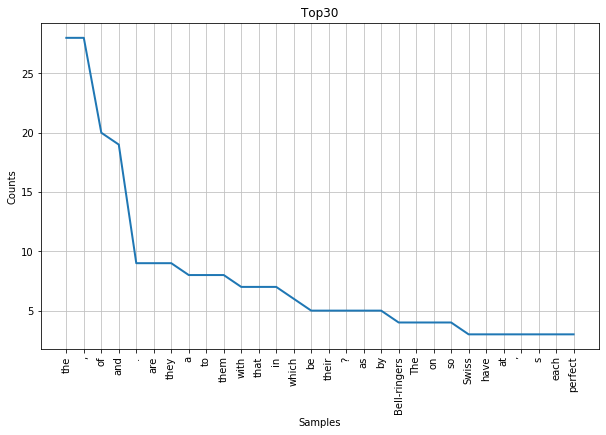

In [22]:
#fdist2.plot(30, title="Top30")

# figure は 1 つ

fig = plt.figure(figsize = (10,6))

fdist2.plot(30, title="Top30")
#plt.plot(x, y3, label='variance')
#plt.legend(loc='upper left',title='Functions')
#plt.title('mean_std_var',loc='left')

filename = new_dir_path_png + "/_top30.png"
fig.savefig(filename)



In [23]:
#大文字小文字を区別しない

In [24]:
#文章中における単語の頻出度数などの統計を計算する方法について
fdist_list = []
for i in range(len(read_book_list)):
    text_ = read_book_list[i]
    #大文字小文字を区別しない
    text = [w.lower() for w in text_] 
    #単語の頻出分布 （frequency distribution）
    fdist = nltk.FreqDist(text)
    fdist_list.append(fdist)
    print("No.",i, "\n", fdist_list[i])
    print("\n", fdist_list[i].most_common(100))


No. 0 
 <FreqDist with 247 samples and 496 outcomes>

 [('the', 33), (',', 28), ('of', 20), ('and', 19), ('a', 9), ('.', 9), ('are', 9), ('they', 9), ('to', 8), ('them', 8), ('with', 7), ('that', 7), ('in', 7), ('their', 6), ('which', 6), ('bell-ringers', 5), ('be', 5), ('?', 5), ('as', 5), ('by', 5), ('swiss', 4), ('on', 4), ('so', 4), ('one', 3), ('automaton', 3), ('we', 3), ('have', 3), ('at', 3), ('’', 3), ('s', 3), ('for', 3), ('each', 3), ('perfect', 3), ('but', 3), ('same', 3), ('mirror', 2), ('man', 2), ('very', 2), ('his', 2), ('an', 2), ('not', 2), ('while', 2), ('these', 2), ('our', 2), ('heard', 2), ('number', 2), ('seven', 2), ('before', 2), ('all', 2), ('precision', 2), ('miss', 2), ('writer', 2), ('pieces', 2), ('contrived', 2), ('maelzel', 2), ('(', 2), ('here', 2), (')', 2), ('electric', 2), ('this', 2), ('such', 2), ('regular', 1), ('allies', 1), ('humorous', 1), ('critical', 1), ('vein', 1), ('has', 1), ('taken', 1), ('it', 1), ('into', 1), ('head', 1), ('prove', 1),

No. 38 
 <FreqDist with 2216 samples and 10330 outcomes>

 [(',', 720), ('the', 558), ('of', 327), ('a', 255), ('and', 254), ('?', 250), ('.', 227), ('to', 170), ('’', 163), ('in', 150), ('that', 149), ('“', 148), ('”', 148), ('i', 148), ('his', 142), ('!', 133), ('was', 114), ('it', 113), ('he', 88), ('at', 73), ('all', 63), ('for', 63), ('as', 60), ('not', 58), ('s', 56), ('you', 50), ('have', 49), ('is', 48), ('bon-bon', 48), ('o', 42), ('by', 42), ('with', 42), ('my', 41), ('be', 41), (';', 41), ('sir', 39), ('me', 39), ('her', 37), ('an', 37), ('no', 36), ('but', 36), ('there', 36), ('had', 36), ('little', 34), ('upon', 33), ('which', 32), ('very', 30), ('were', 29), ('what', 28), ('if', 26), ('from', 26), ('say', 26), ('wid', 25), ('one', 23), ('ye', 22), ('thin', 22), ('are', 22), ('said', 22), ('jist', 21), ('so', 21), ('t', 21), ('him', 21), ('hiccup', 20), ('pathrick', 19), ('or', 19), ('on', 18), ('who', 18), ('been', 18), ('more', 18), ('much', 18), ('well', 18), ('out', 18

<FreqDist with 247 samples and 496 outcomes>


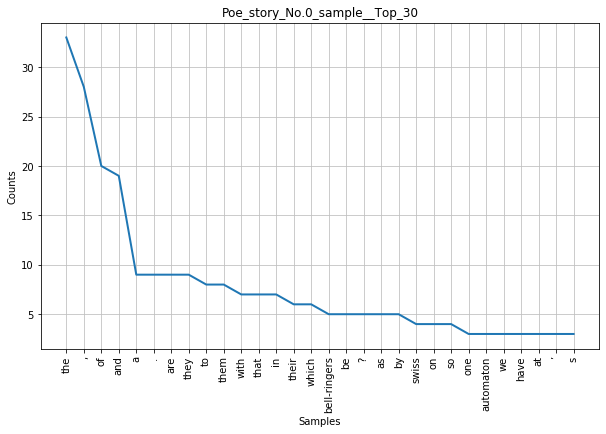

<FreqDist with 365 samples and 805 outcomes>


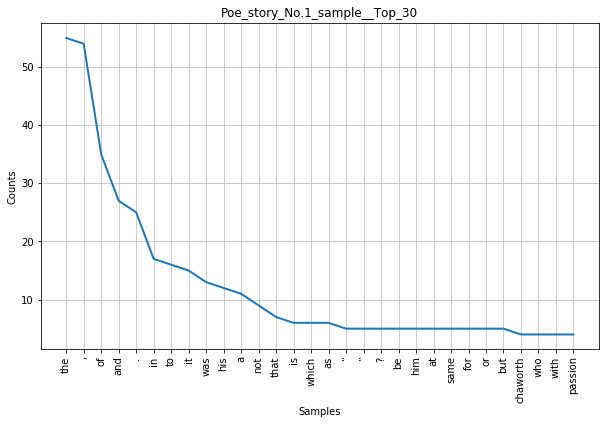

<FreqDist with 388 samples and 975 outcomes>


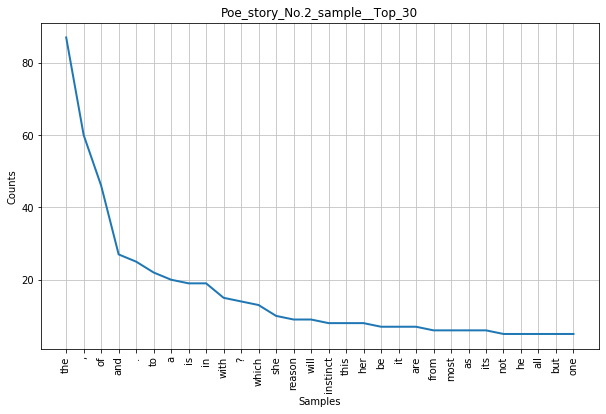

<FreqDist with 1808 samples and 8650 outcomes>


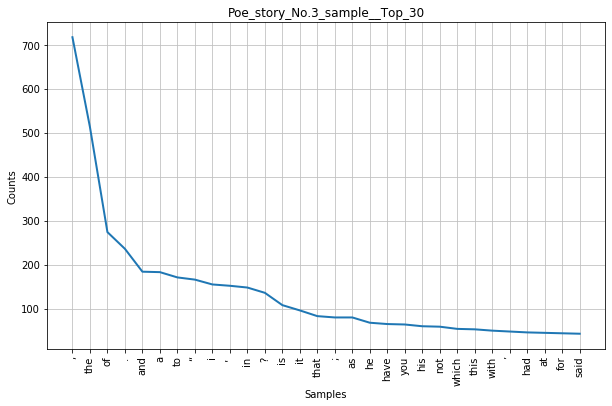

<FreqDist with 1645 samples and 6755 outcomes>


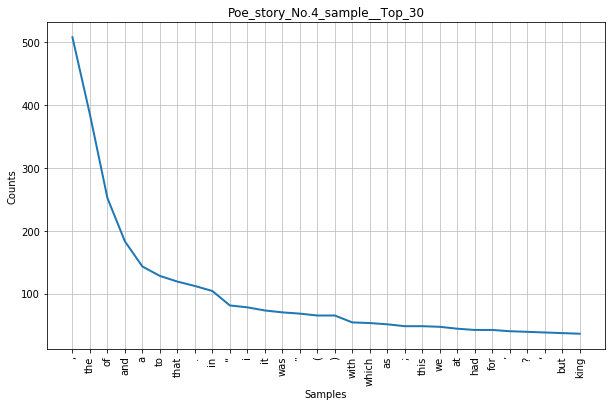

<FreqDist with 1685 samples and 8031 outcomes>


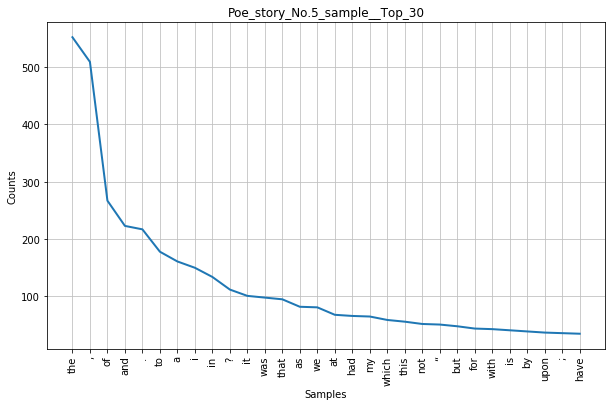

<FreqDist with 954 samples and 3318 outcomes>


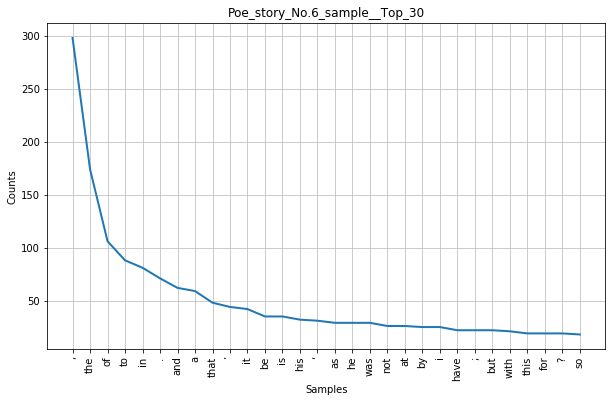

<FreqDist with 1109 samples and 4194 outcomes>


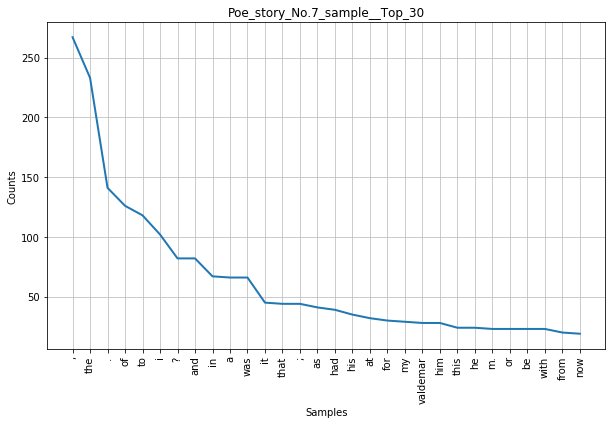

<FreqDist with 1253 samples and 4570 outcomes>


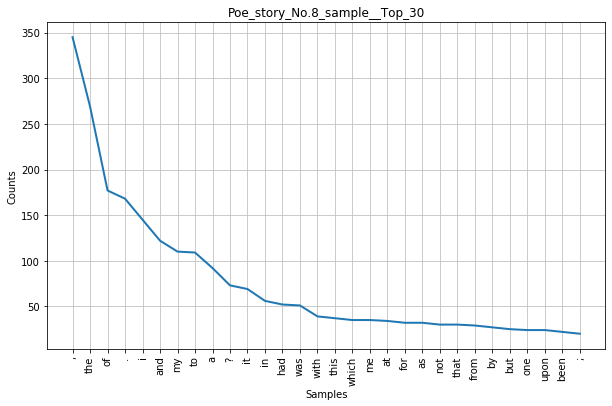

<FreqDist with 2060 samples and 8374 outcomes>


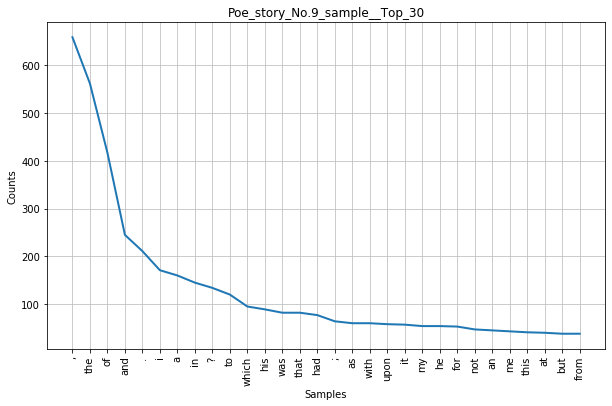

<FreqDist with 403 samples and 1580 outcomes>


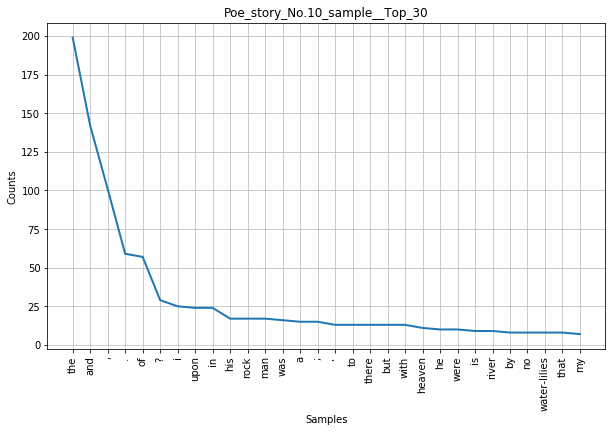

<FreqDist with 859 samples and 2752 outcomes>


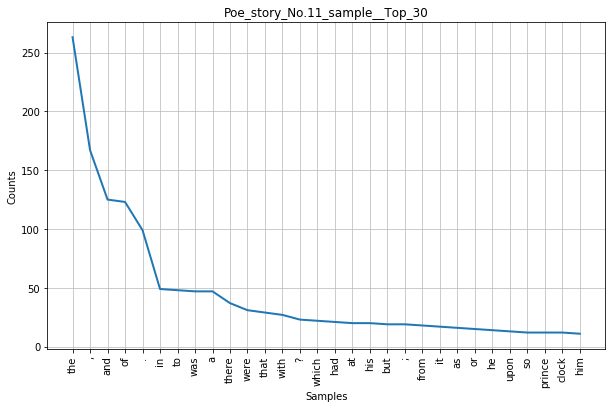

<FreqDist with 816 samples and 2937 outcomes>


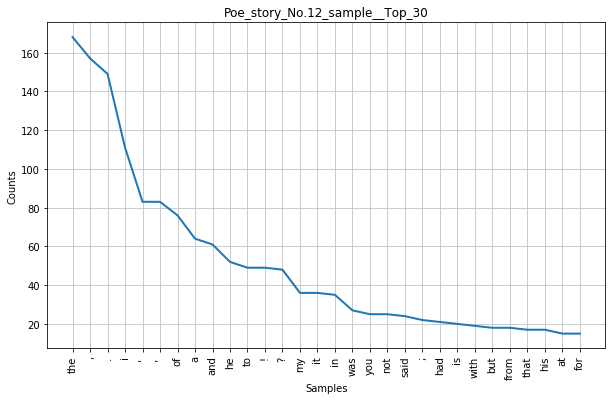

<FreqDist with 892 samples and 2832 outcomes>


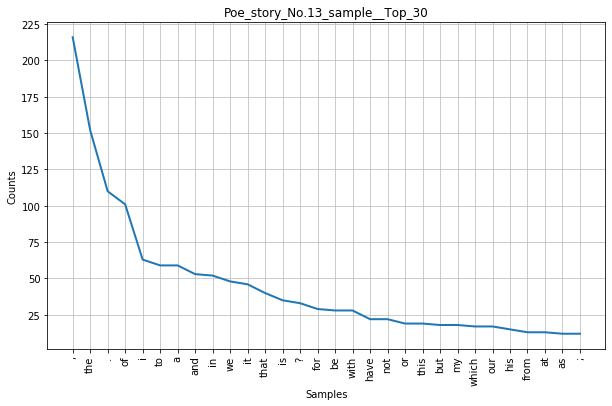

<FreqDist with 782 samples and 2261 outcomes>


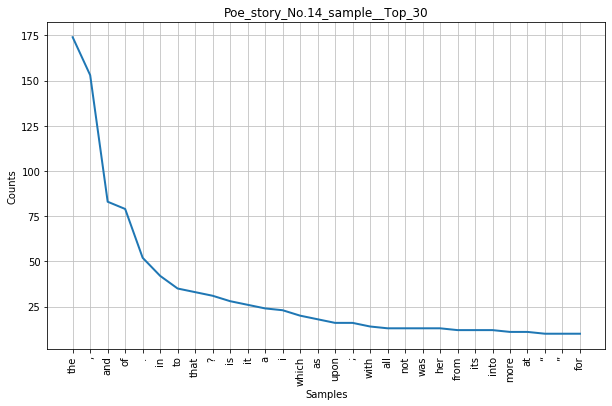

<FreqDist with 1481 samples and 5272 outcomes>


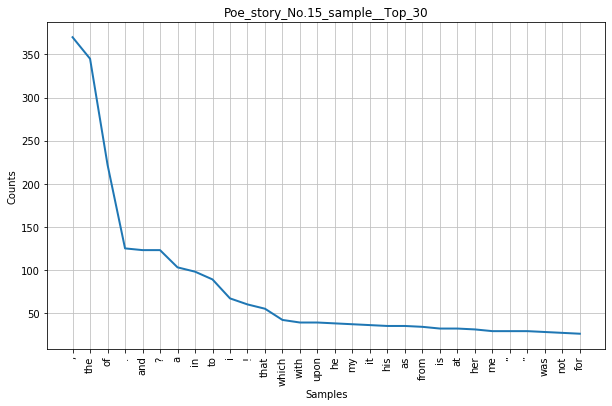

<FreqDist with 1649 samples and 7086 outcomes>


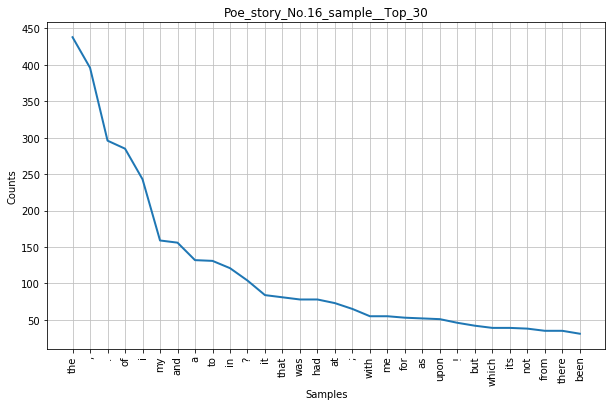

<FreqDist with 1737 samples and 6412 outcomes>


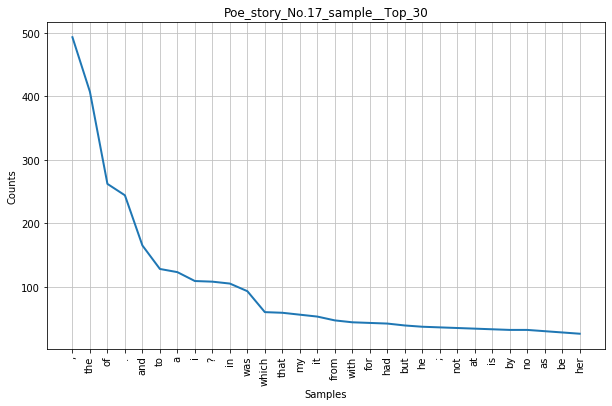

<FreqDist with 1857 samples and 6739 outcomes>


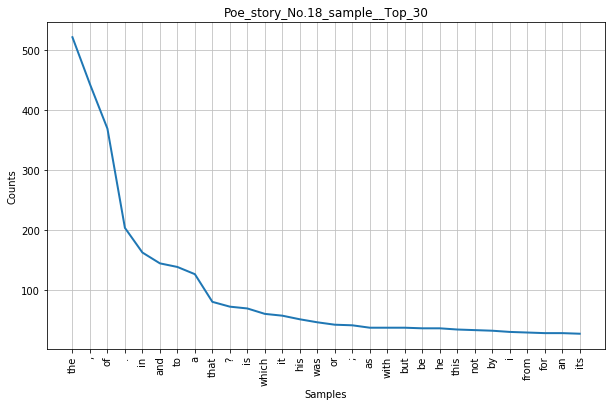

<FreqDist with 1417 samples and 5646 outcomes>


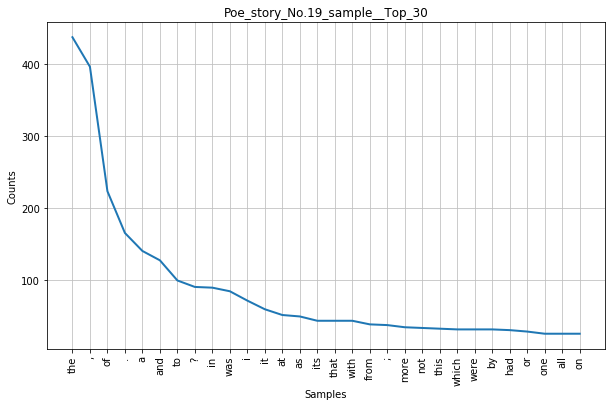

<FreqDist with 2315 samples and 9386 outcomes>


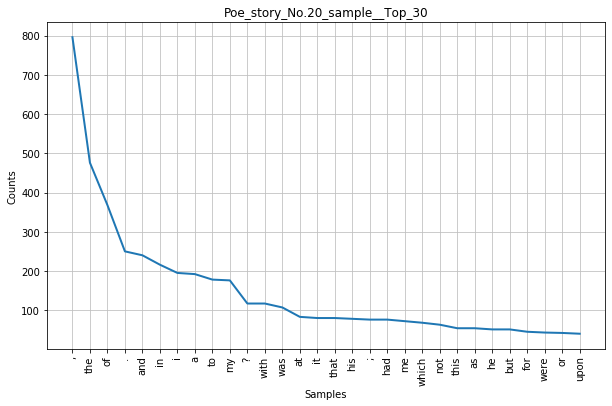

<FreqDist with 655 samples and 2586 outcomes>


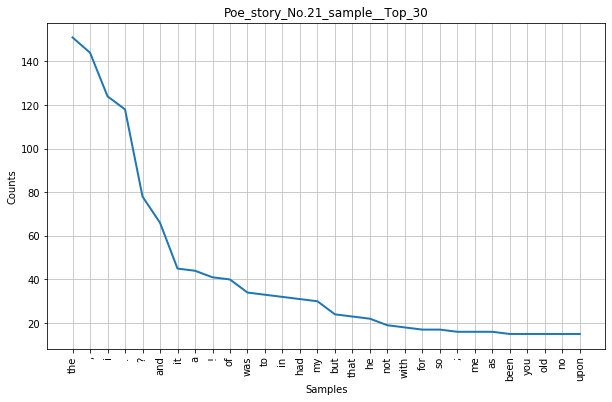

<FreqDist with 1136 samples and 3787 outcomes>


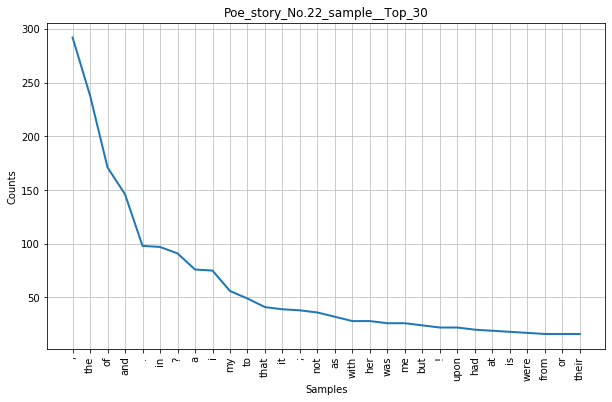

<FreqDist with 840 samples and 2781 outcomes>


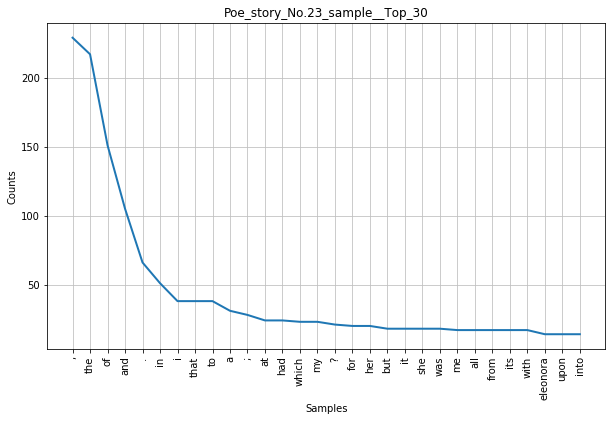

<FreqDist with 2825 samples and 16755 outcomes>


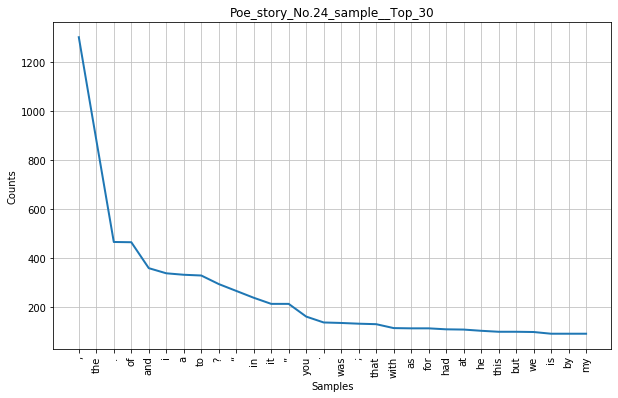

<FreqDist with 976 samples and 3399 outcomes>


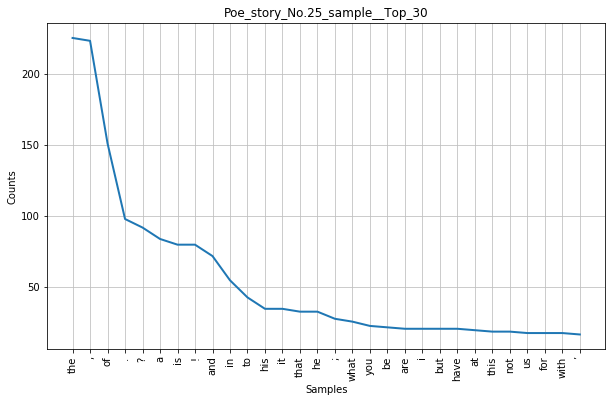

<FreqDist with 2785 samples and 16266 outcomes>


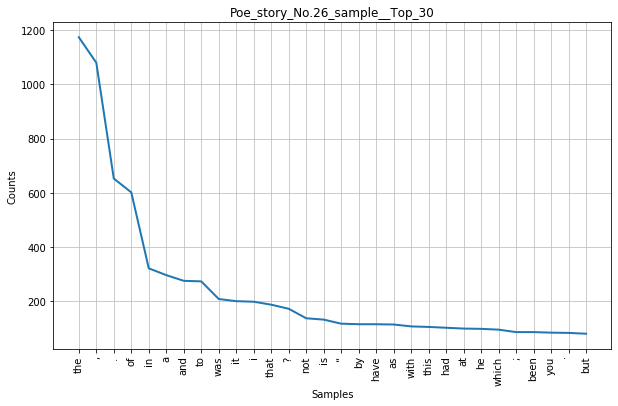

<FreqDist with 3213 samples and 23535 outcomes>


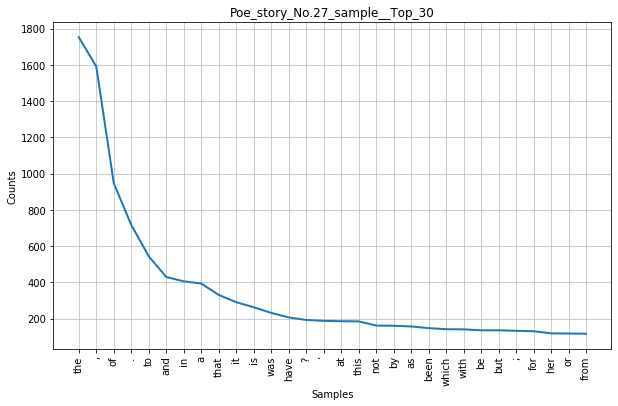

<FreqDist with 1477 samples and 6119 outcomes>


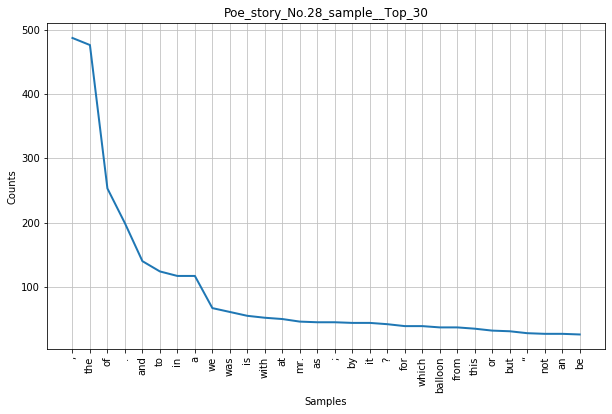

<FreqDist with 1413 samples and 4787 outcomes>


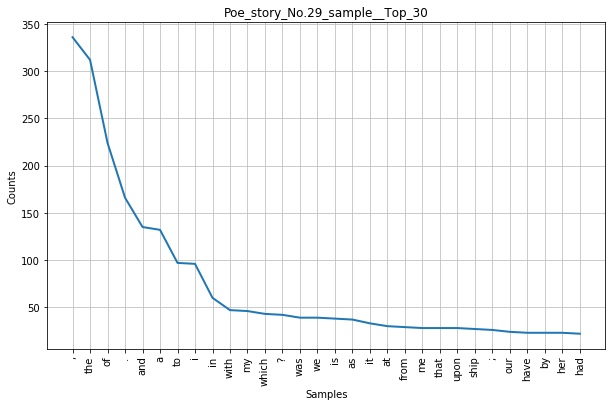

<FreqDist with 534 samples and 1462 outcomes>


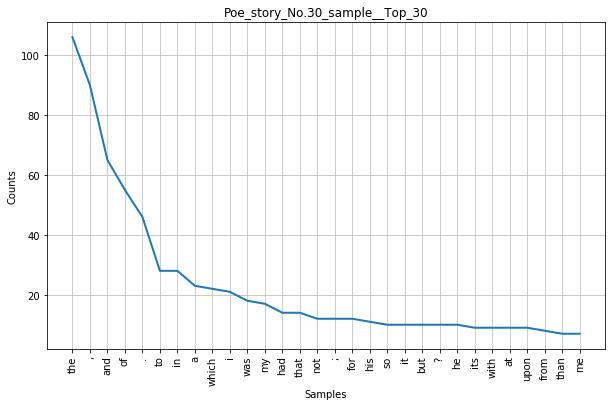

<FreqDist with 940 samples and 2775 outcomes>


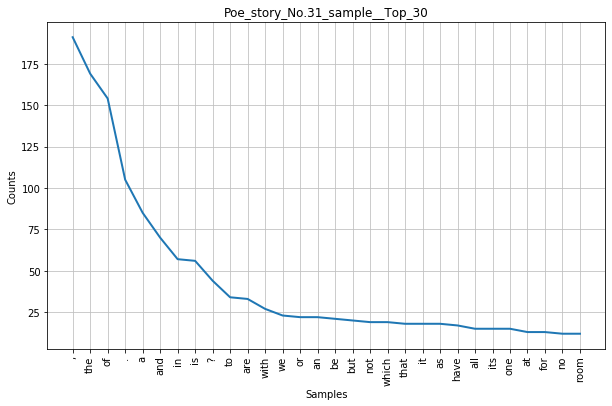

<FreqDist with 623 samples and 1716 outcomes>


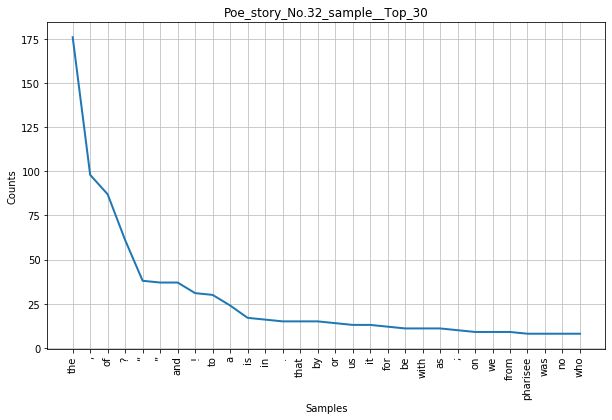

<FreqDist with 759 samples and 2096 outcomes>


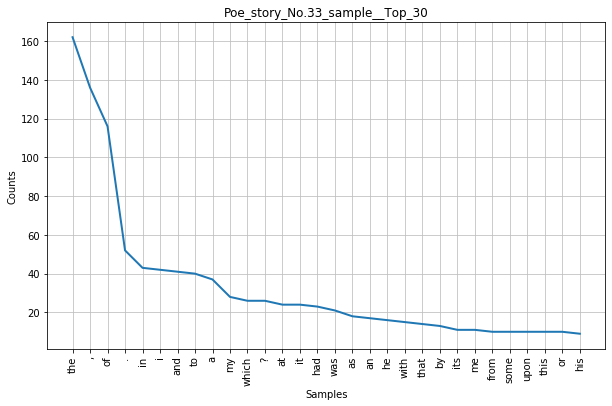

<FreqDist with 1153 samples and 4372 outcomes>


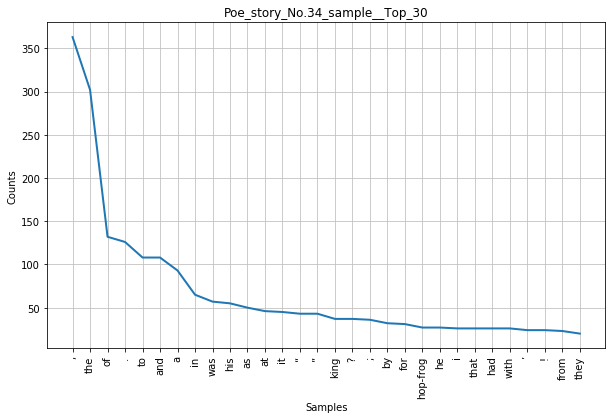

<FreqDist with 1306 samples and 4102 outcomes>


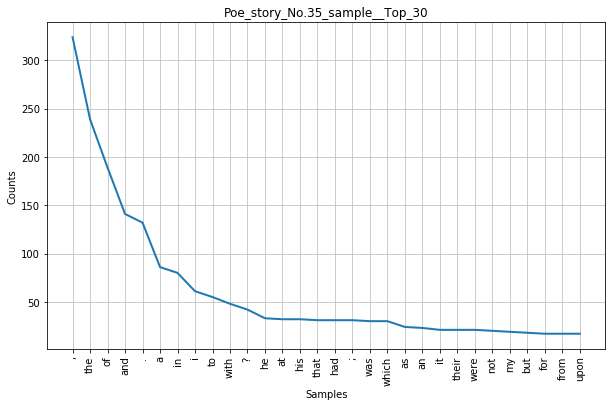

<FreqDist with 1234 samples and 4731 outcomes>


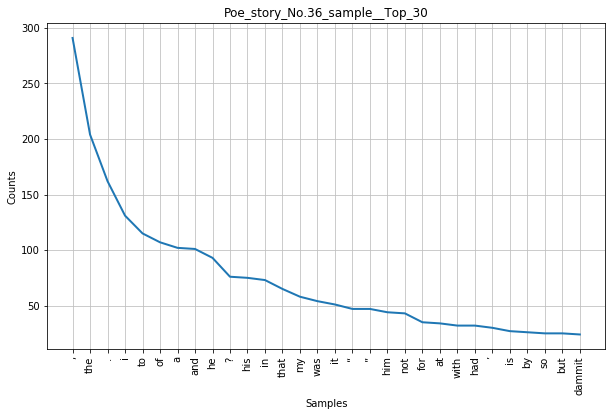

<FreqDist with 1601 samples and 6796 outcomes>


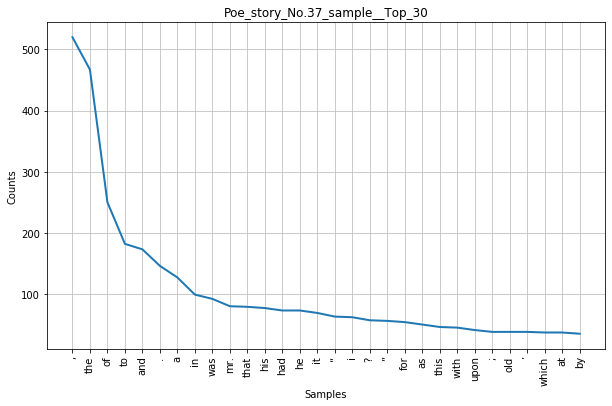

<FreqDist with 2216 samples and 10330 outcomes>


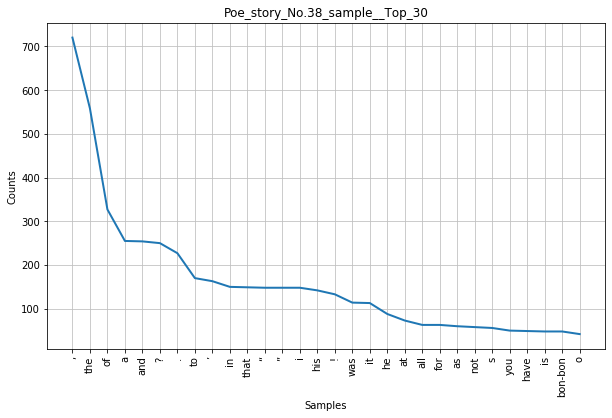

<FreqDist with 1804 samples and 7477 outcomes>


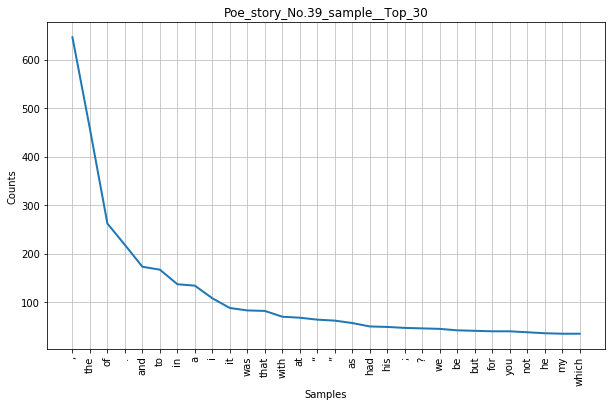

<FreqDist with 1768 samples and 7177 outcomes>


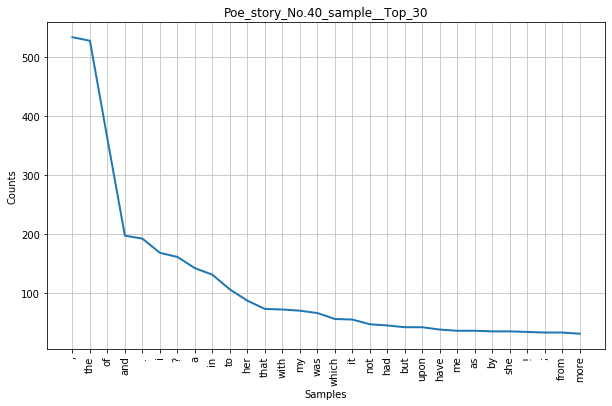

<FreqDist with 767 samples and 2486 outcomes>


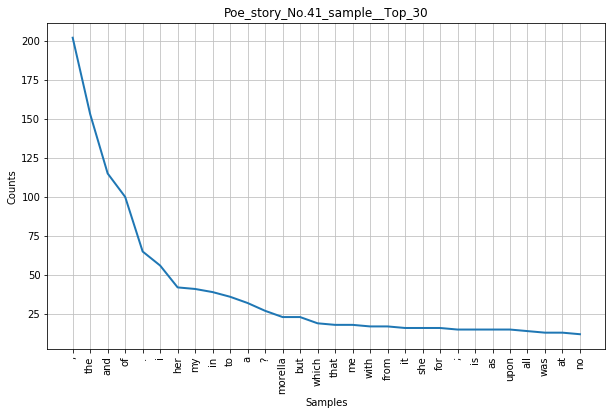

<FreqDist with 1378 samples and 4736 outcomes>


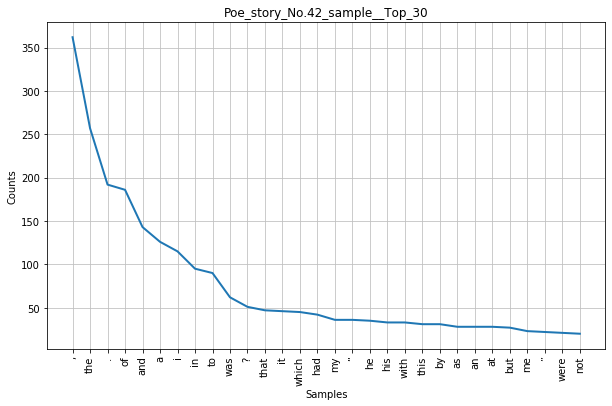

<FreqDist with 2265 samples and 11398 outcomes>


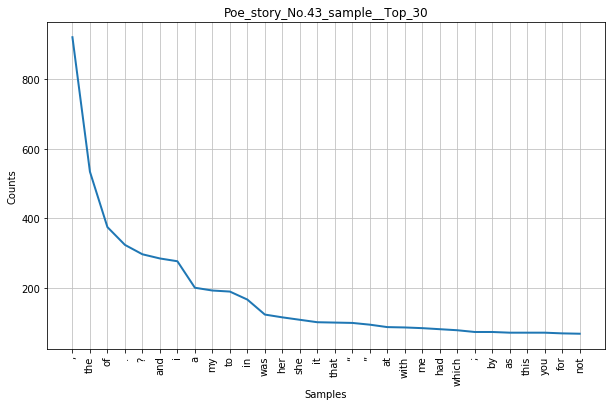

<FreqDist with 1627 samples and 5500 outcomes>


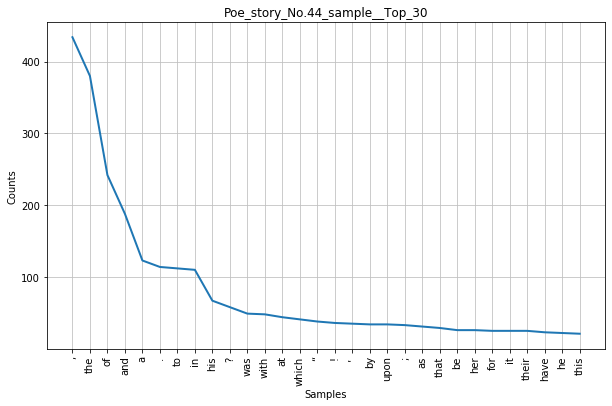

<FreqDist with 804 samples and 3202 outcomes>


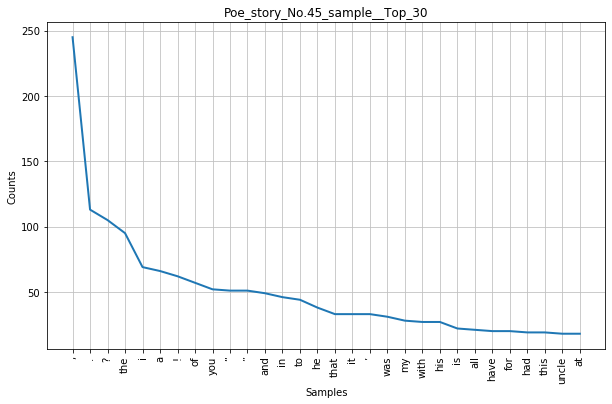

<FreqDist with 1070 samples and 3792 outcomes>


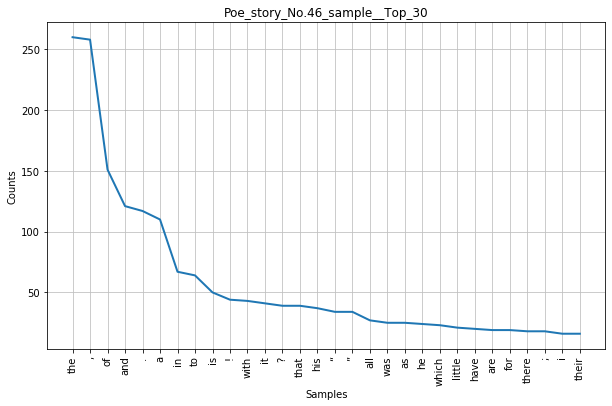

<FreqDist with 673 samples and 2229 outcomes>


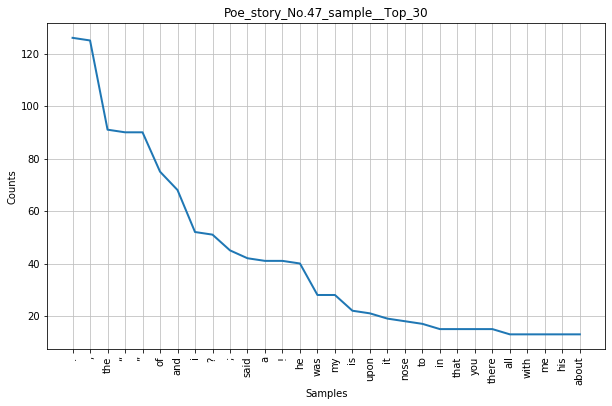

<FreqDist with 892 samples and 3308 outcomes>


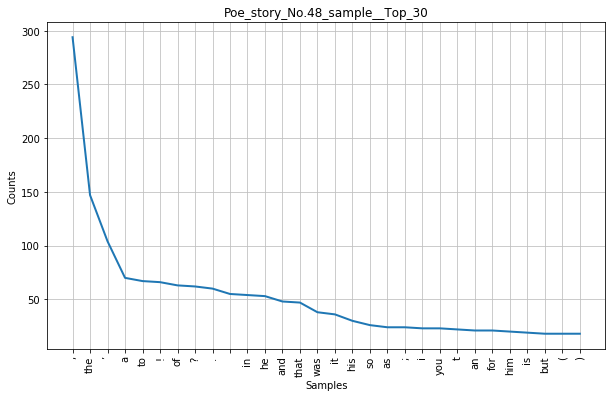

<FreqDist with 1216 samples and 3700 outcomes>


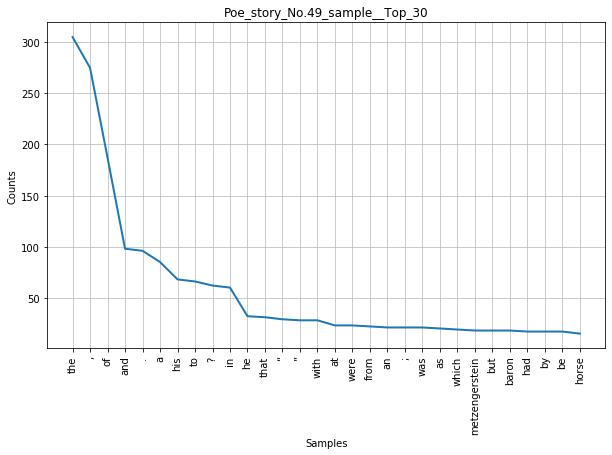

<FreqDist with 1791 samples and 8433 outcomes>


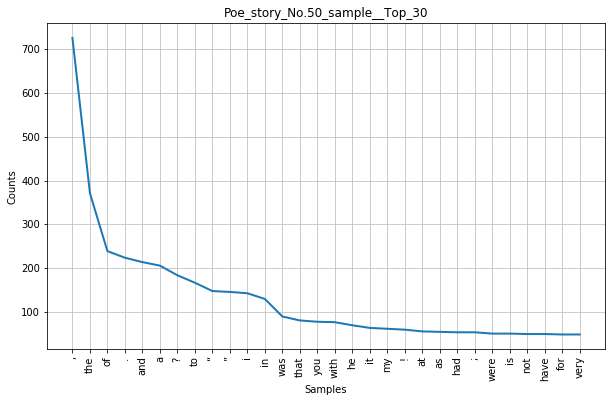

<FreqDist with 1936 samples and 9583 outcomes>


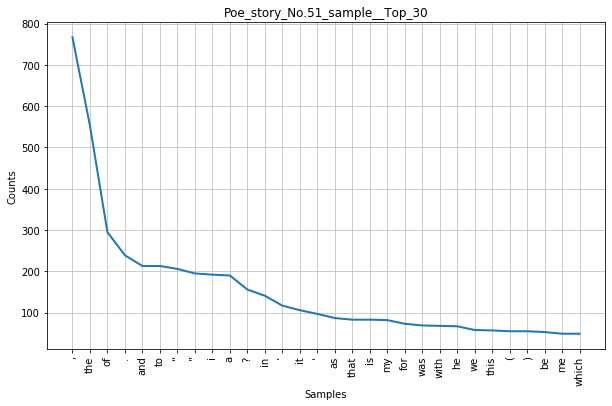

<FreqDist with 1233 samples and 4845 outcomes>


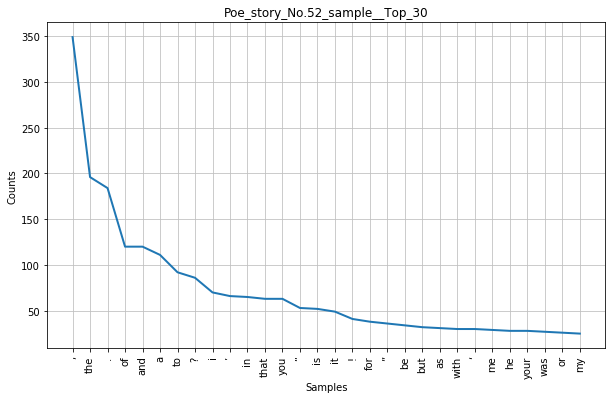

<FreqDist with 1191 samples and 4227 outcomes>


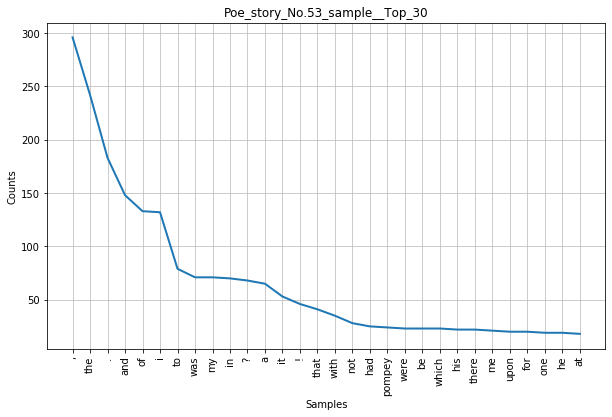

<FreqDist with 1130 samples and 3613 outcomes>


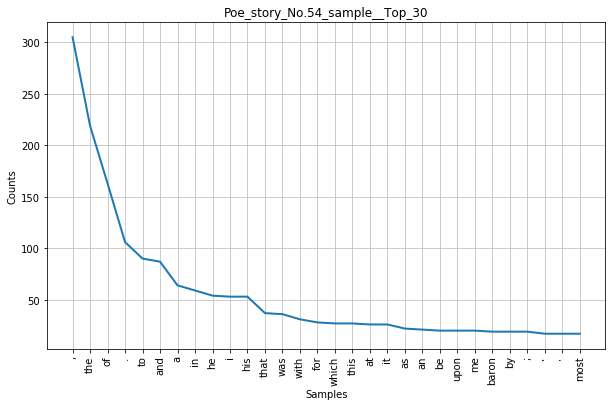

<FreqDist with 1278 samples and 4905 outcomes>


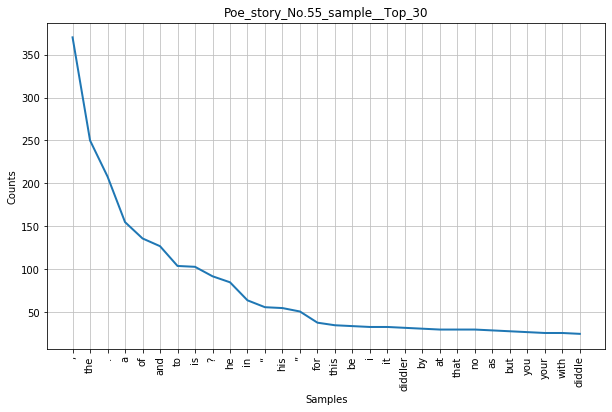

<FreqDist with 1265 samples and 4502 outcomes>


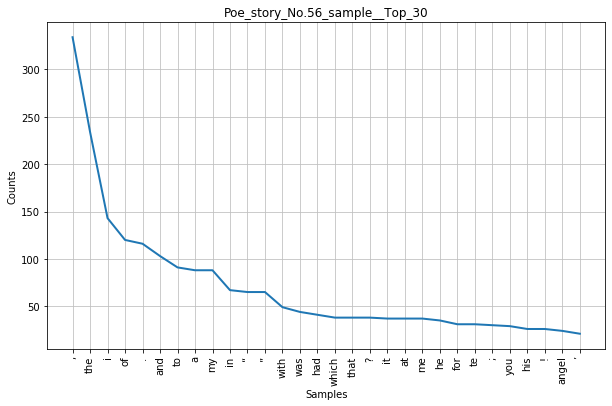

<FreqDist with 1655 samples and 6507 outcomes>


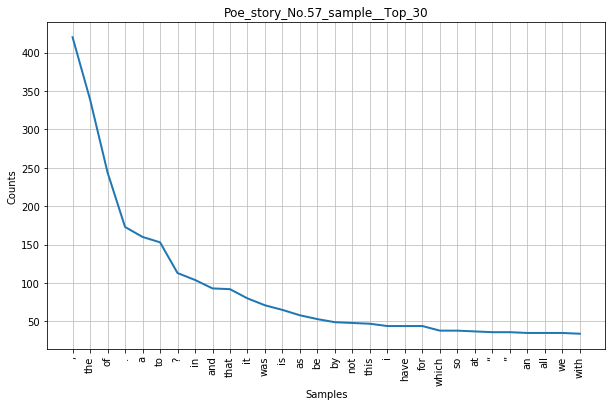

<FreqDist with 625 samples and 1666 outcomes>


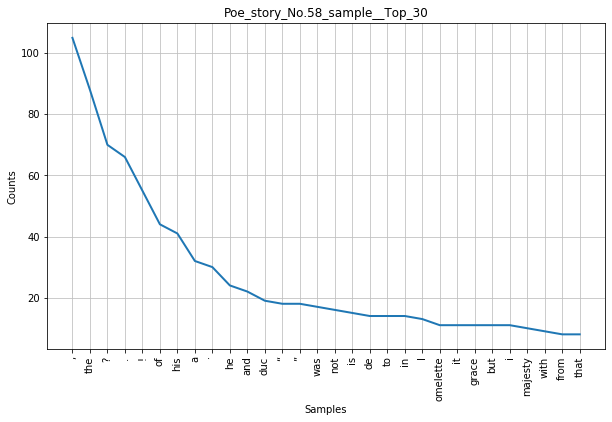

<FreqDist with 1324 samples and 5460 outcomes>


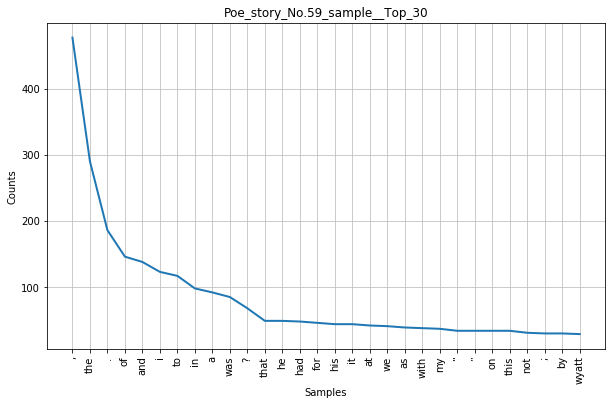

<FreqDist with 1596 samples and 5484 outcomes>


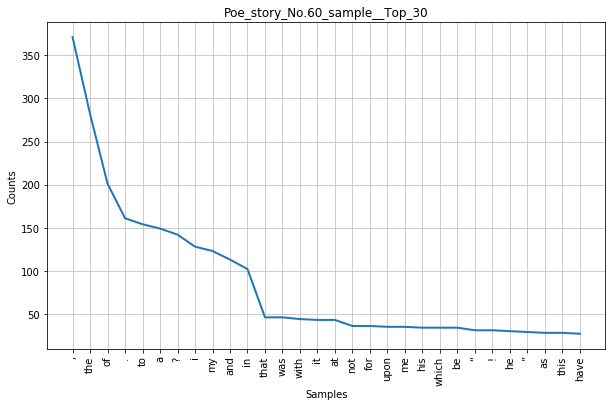

<FreqDist with 1182 samples and 4715 outcomes>


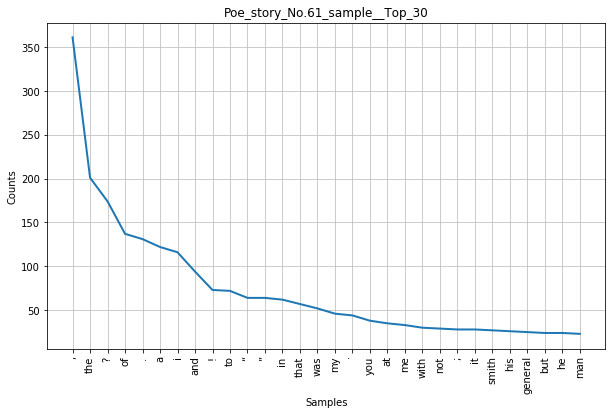

<FreqDist with 1189 samples and 4397 outcomes>


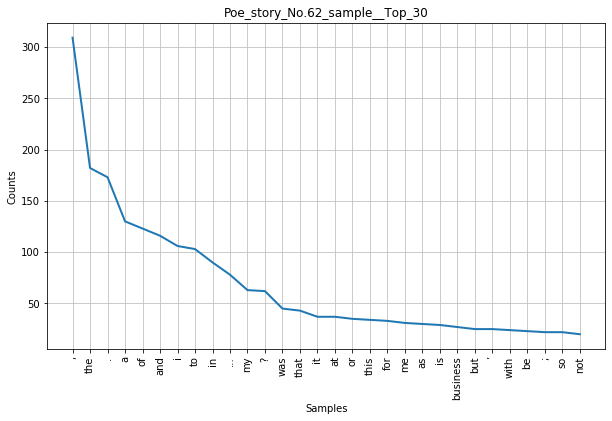

<FreqDist with 1182 samples and 3976 outcomes>


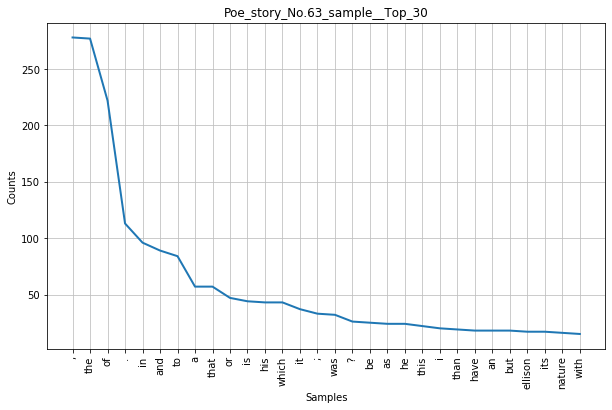

<FreqDist with 1719 samples and 10719 outcomes>


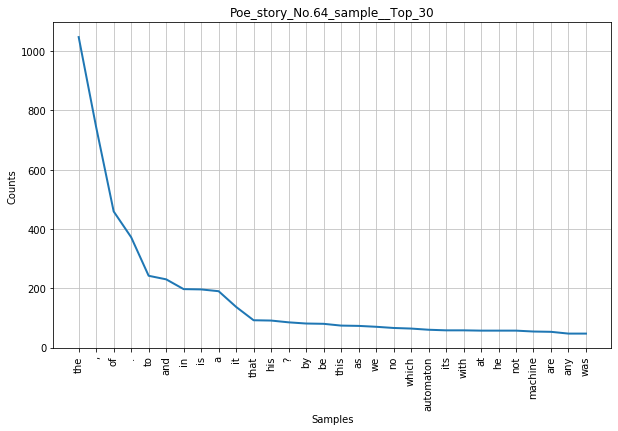

<FreqDist with 513 samples and 1668 outcomes>


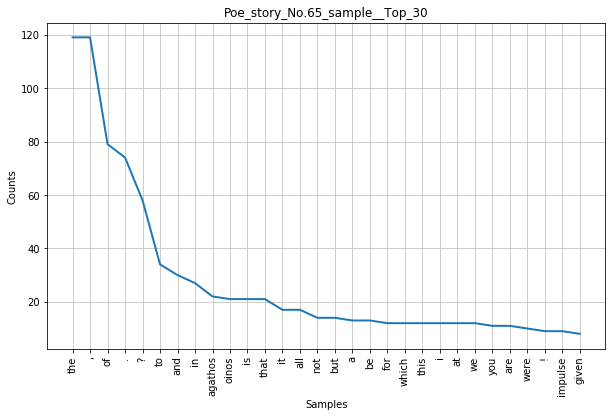

<FreqDist with 1177 samples and 3846 outcomes>


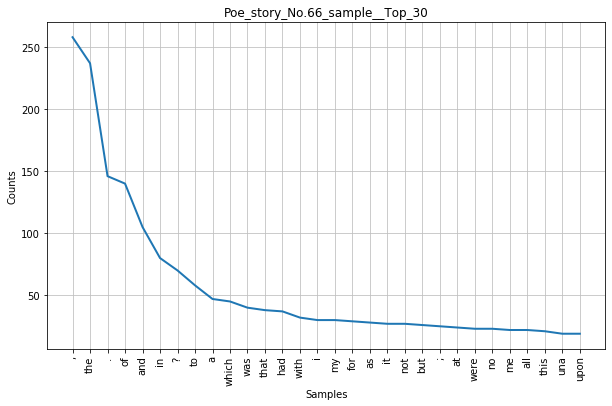

<FreqDist with 777 samples and 2310 outcomes>


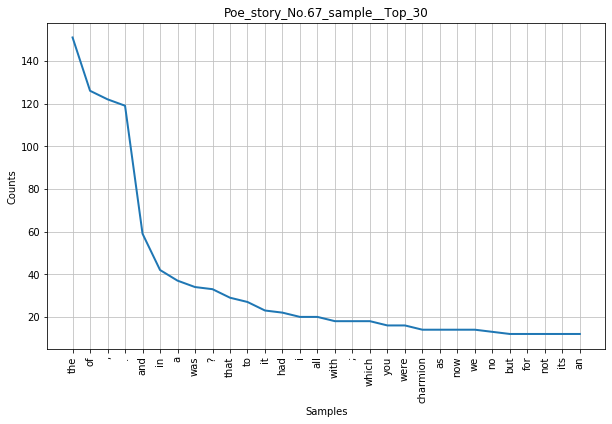

<FreqDist with 440 samples and 1169 outcomes>


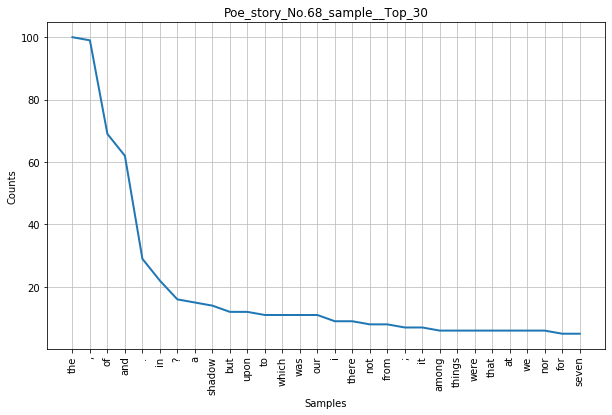

In [25]:
my_makedirs(new_dir_path_png_top)
my_makedirs(new_dir_path_png_top_no_punc)

num_counted = 30
for i in range(len(read_book_list)):
    print(fdist_list[i])
    
    title_ =  str(author[choice[index_i]])+str('_')+str(type_[choice[index_j]])+"_No." + str(i) +str('_sample_')+ "_Top_" + str(num_counted)
        
    fig = plt.figure(figsize = (10,6))
    fdist_list[i].plot(num_counted, 
                       title = title_)
    
    filename = new_dir_path_png_top + "/" + title_ +".png"
    fig.savefig(filename)



In [26]:
fdist_list[0]

FreqDist({'the': 33, ',': 28, 'of': 20, 'and': 19, 'a': 9, '.': 9, 'are': 9, 'they': 9, 'to': 8, 'them': 8, ...})

In [27]:
df_list = []

for i in range(len(read_book_list)):
    df_ = pd.DataFrame.from_dict(fdist_list[i], orient='index', columns=['column1'])
    df_list.append(df_)
    #print(df_list[i].T)
df_list[0].T


,the,swiss,bell-ringers,one,of,regular,allies,mirror,",",a,...,doubt,truth,theory,will,once,removed,noticing,how,electrify,hearers
column1,33,4,5,3,20,1,1,2,28,9,...,1,1,1,1,1,1,1,1,1,1


In [28]:
df_list[0].T["of"]

column1    20
Name: of, dtype: int64

In [29]:
df_list[0].T.loc[:,['of','not']]

,of,not
column1,20,2


In [30]:
prep_list

['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']

In [31]:
#check prep. if in the column
prep_list_checked = []
for ind, i in enumerate(prep_list):
    #print(i)
    if prep_list[ind] in df_list[0].T.columns:
        print(i,'true')
        prep_list_checked.append(i)
    else:
        print(i,'False')

and true
the true
that true
of true
was False
upon true
not true
when False
then False


In [32]:
prep_list_checked

['and', 'the', 'that', 'of', 'upon', 'not']

In [33]:
df_list[0].T.loc[:,prep_list_checked]

,and,the,that,of,upon,not
column1,19,33,7,20,1,2


In [34]:
df_list_T = []
for j in range(len(read_book_list)):
    
    #prep_list = ['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
    print(prep_list)
    
    #check prep. if in the column
    prep_list_checked = []
    for ind, i in enumerate(prep_list):
        #print(i)
        if prep_list[ind] in df_list[j].T.columns:
            print(i,'true')
            prep_list_checked.append(i)
        else:
            print(i,'False')

    print(prep_list_checked)
    
    
    df_list_T.append(df_list[j].T.loc[:,prep_list_checked])

['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
and true
the true
that true
of true
was False
upon true
not true
when False
then False
['and', 'the', 'that', 'of', 'upon', 'not']
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
and true
the true
that true
of true
was true
upon true
not true
when true
then False
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when']
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
and true
the true
that true
of true
was False
upon true
not true
when true
then False
['and', 'the', 'that', 'of', 'upon', 'not', 'when']
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
and true
the true
that true
of true
was true
upon true
not true
when true
then true
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
and true
the true
that true
of true
was true
upon true
not true
when true
then true
['and', 'the', 't

that true
of true
was true
upon true
not true
when true
then true
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
and true
the true
that true
of true
was true
upon true
not true
when true
then true
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
and true
the true
that true
of true
was true
upon true
not true
when true
then true
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
and true
the true
that true
of true
was true
upon true
not true
when true
then true
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']
and true
the true
that true
of true
was true
upon true
not true
when true
then true
['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'th

In [35]:
df_list_T[0]

,and,the,that,of,upon,not
column1,19,33,7,20,1,2


In [36]:
df_list[0].T[prep_list_checked[0]]

column1    19
Name: and, dtype: int64

In [37]:
pd.merge(df_list_T[0], df_list_T[1], how='outer')

,and,the,that,of,upon,not,was,when
0,19,33,7,20,1,2,NaN,NaN
1,27,55,7,35,1,9,13.0,1.0


In [38]:
pd.concat([df_list_T[0], df_list_T[1]])

,and,the,that,of,upon,not,was,when
column1,19,33,7,20,1,2,NaN,NaN
column1,27,55,7,35,1,9,13.0,1.0


In [39]:
for i in range(len(read_book_list)):
    print(i, df_list_T[i])

0          and  the  that  of  upon  not
column1   19   33     7  20     1    2
1          and  the  that  of  was  upon  not  when
column1   27   55     7  35   13     1    9     1
2          and  the  that  of  upon  not  when
column1   27   87     5  46     2    5     1
3          and  the  that   of  was  upon  not  when  then
column1  184  513    83  274   41    40   59    20    20
4          and  the  that   of  was  upon  not  when  then
column1  183  385   119  252   70    27   26    11    10
5          and  the  that   of  was  upon  not  when  then
column1  223  552    95  267   98    37   52    23    13
6          and  the  that   of  was  upon  not  when
column1   62  174    48  106   29    12   26     4
7          and  the  that   of  was  upon  not  when  then
column1   82  233    44  126   66     5   16    11     7
8          and  the  that   of  was  upon  not  when  then
column1  122  269    30  177   51    24   30     9     5
9          and  the  that   of  was  upon 

In [40]:
df_merged = df_list_T[0]
for i in range(1,len(read_book_list)):
    #df_merged = pd.merge(df_merged, df_list_T[i], how='outer')
    df_merged = pd.concat([df_merged, df_list_T[i]])
    df_merged.reset_index(drop=True, inplace=True)
df_merged    

,and,the,that,of,upon,not,was,when,then
0,19,33,7,20,1,2,NaN,NaN,NaN
1,27,55,7,35,1,9,13.0,1.0,NaN
2,27,87,5,46,2,5,NaN,1.0,NaN
3,184,513,83,274,40,59,41.0,20.0,20.0
4,183,385,119,252,27,26,70.0,11.0,10.0
...,...,...,...,...,...,...,...,...,...
64,230,1047,92,459,33,57,47.0,44.0,21.0
65,30,119,21,79,4,14,4.0,1.0,2.0
66,105,237,38,140,19,27,40.0,12.0,3.0
67,59,151,29,126,10,12,34.0,3.0,2.0


In [41]:
df_merged.shape

(69, 9)

In [42]:
total_list = []
for i in range(len(read_book_list)):
    total_list.append(len(read_book_list[i]))
print(total_list)

[496, 805, 975, 8650, 6755, 8031, 3318, 4194, 4570, 8374, 1580, 2752, 2937, 2832, 2261, 5272, 7086, 6412, 6739, 5646, 9386, 2586, 3787, 2781, 16755, 3399, 16266, 23535, 6119, 4787, 1462, 2775, 1716, 2096, 4372, 4102, 4731, 6796, 10330, 7477, 7177, 2486, 4736, 11398, 5500, 3202, 3792, 2229, 3308, 3700, 8433, 9583, 4845, 4227, 3613, 4905, 4502, 6507, 1666, 5460, 5484, 4715, 4397, 3976, 10719, 1668, 3846, 2310, 1169]


In [43]:
len(total_list)

69

In [44]:
#欠損値処理
df_merged["total"] = total_list
df_merged = df_merged.fillna(0)
df_merged

,and,the,that,of,upon,not,was,when,then,total
0,19,33,7,20,1,2,0.0,0.0,0.0,496
1,27,55,7,35,1,9,13.0,1.0,0.0,805
2,27,87,5,46,2,5,0.0,1.0,0.0,975
3,184,513,83,274,40,59,41.0,20.0,20.0,8650
4,183,385,119,252,27,26,70.0,11.0,10.0,6755
...,...,...,...,...,...,...,...,...,...,...
64,230,1047,92,459,33,57,47.0,44.0,21.0,10719
65,30,119,21,79,4,14,4.0,1.0,2.0,1668
66,105,237,38,140,19,27,40.0,12.0,3.0,3846
67,59,151,29,126,10,12,34.0,3.0,2.0,2310


In [45]:
new_dir_path_csv

'csv/Poe-story'

In [46]:
df_merged.to_csv('to_csv_out_original.csv')
csv_name_ = str(author[choice[index_i]])+str('_')+str(type_[choice[index_j]]) +str('_')+str('to_csv_output_original.csv')
df_merged.to_csv(new_dir_path_csv + str('/') + csv_name_ )


In [47]:
df_merged.columns[0]

'and'

In [48]:
#df_merged['then'] = df_merged['then'] / df_merged['total'] 
print(df_merged.columns)
df_merged_per = df_merged.copy()
for i in range(len(df_merged.columns)):
    df_merged_per[df_merged_per.columns[i]] = df_merged_per[df_merged_per.columns[i]] / df_merged_per['total'] 
    print(i)

Index(['and', 'the', 'that', 'of', 'upon', 'not', 'was', 'when', 'then',
       'total'],
      dtype='object')
0
1
2
3
4
5
6
7
8
9


In [49]:
df_merged_per

,and,the,that,of,upon,not,was,when,then,total
0,0.038306,0.066532,0.014113,0.040323,0.002016,0.004032,0.000000,0.000000,0.000000,1.0
1,0.033540,0.068323,0.008696,0.043478,0.001242,0.011180,0.016149,0.001242,0.000000,1.0
2,0.027692,0.089231,0.005128,0.047179,0.002051,0.005128,0.000000,0.001026,0.000000,1.0
3,0.021272,0.059306,0.009595,0.031676,0.004624,0.006821,0.004740,0.002312,0.002312,1.0
4,0.027091,0.056995,0.017617,0.037306,0.003997,0.003849,0.010363,0.001628,0.001480,1.0
...,...,...,...,...,...,...,...,...,...,...
64,0.021457,0.097677,0.008583,0.042821,0.003079,0.005318,0.004385,0.004105,0.001959,1.0
65,0.017986,0.071343,0.012590,0.047362,0.002398,0.008393,0.002398,0.000600,0.001199,1.0
66,0.027301,0.061622,0.009880,0.036401,0.004940,0.007020,0.010400,0.003120,0.000780,1.0
67,0.025541,0.065368,0.012554,0.054545,0.004329,0.005195,0.014719,0.001299,0.000866,1.0


In [50]:
my_makedirs(new_dir_path_csv)
my_makedirs(new_dir_path_png)
my_makedirs(new_dir_path_png_top)
my_makedirs(new_dir_path_png_top_no_punc)
my_makedirs(new_dir_path_png_top_no_punc_no_stopwords)

df_merged_per.to_csv('to_csv_out_percentage.csv')

csv_name_ = str(author[choice[index_i]])+str('_')+str(type_[choice[index_j]]) +str('_')+str('to_csv_output_percentage.csv')
df_merged_per.to_csv(new_dir_path_csv + str('/') + csv_name_ )


In [51]:
df_merged.describe()

,and,the,that,of,upon,not,was,when,then,total
count,69.000000,69.000000,69.000000,69.000000,69.000000,69.000000,69.000000,69.000000,69.000000,69.000000
mean,129.855072,330.985507,53.855072,196.521739,22.666667,29.463768,51.057971,9.318841,7.855072,5282.550725
std,79.180597,273.565859,48.983874,148.557932,18.769238,26.568767,43.307004,9.312378,7.209625,3909.243595
min,19.000000,33.000000,5.000000,20.000000,1.000000,2.000000,0.000000,0.000000,0.000000,496.000000
25%,70.000000,174.000000,28.000000,106.000000,11.000000,14.000000,21.000000,3.000000,3.000000,2781.000000
50%,120.000000,250.000000,41.000000,151.000000,17.000000,21.000000,41.000000,7.000000,5.000000,4397.000000
75%,165.000000,437.000000,79.000000,252.000000,29.000000,36.000000,70.000000,12.000000,11.000000,6739.000000
max,429.000000,1752.000000,330.000000,946.000000,90.000000,161.000000,231.000000,46.000000,35.000000,23535.000000


In [52]:
def zscore(x):
    xmean = x.mean()
    xstd  = np.std(x)

    zscore = (x-xmean)/xstd
    return zscore

df_merged_std = zscore(df_merged)
df_merged_std

,and,the,that,of,upon,not,was,when,then,total
0,-1.410285,-1.097244,-0.963548,-1.196940,-1.162828,-1.041259,-1.187615,-1.008025,-1.097508,-1.233389
1,-1.308510,-1.016236,-0.963548,-1.095230,-1.162828,-0.775862,-0.885233,-0.899855,-1.097508,-1.153766
2,-1.308510,-0.898405,-1.004677,-1.020642,-1.109159,-0.927517,-1.187615,-0.899855,-1.097508,-1.109961
3,0.688825,0.670215,0.599349,0.525356,0.930263,1.119834,-0.233950,1.155388,1.696885,0.867718
4,0.676103,0.198893,1.339669,0.376181,0.232566,-0.131325,0.440594,0.181852,0.299688,0.379418
...,...,...,...,...,...,...,...,...,...,...
64,1.274032,2.636514,0.784429,1.779785,0.554580,1.044006,-0.094389,3.751484,1.836604,1.400853
65,-1.270344,-0.780575,-0.675646,-0.796879,-1.001821,-0.586292,-1.094574,-0.899855,-0.818069,-0.931390
66,-0.316203,-0.346074,-0.326051,-0.383257,-0.196786,-0.093411,-0.257210,0.290023,-0.678349,-0.370168
67,-0.901410,-0.662744,-0.511131,-0.478186,-0.679807,-0.662120,-0.396770,-0.683513,-0.818069,-0.765961


In [53]:
df_merged_std.to_csv('to_csv_out_std.csv')

csv_name_ = str(author[choice[index_i]])+str('_')+str(type_[choice[index_j]]) +str('_')+str('to_csv_output_std.csv')
df_merged_std.to_csv(new_dir_path_csv + str('/') + csv_name_ )


In [54]:
def min_max_normalization(x):
    x_min = x.min()
    x_max = x.max()
    x_norm = (x - x_min) / ( x_max - x_min)
    return x_norm

df_merged_nor = min_max_normalization(df_merged)
df_merged_nor

,and,the,that,of,upon,not,was,when,then,total
0,0.000000,0.000000,0.006154,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.019512,0.012798,0.006154,0.016199,0.000000,0.044025,0.056277,0.021739,0.000000,0.013412
2,0.019512,0.031414,0.000000,0.028078,0.011236,0.018868,0.000000,0.021739,0.000000,0.020791
3,0.402439,0.279232,0.240000,0.274298,0.438202,0.358491,0.177489,0.434783,0.571429,0.353922
4,0.400000,0.204770,0.350769,0.250540,0.292135,0.150943,0.303030,0.239130,0.285714,0.271670
...,...,...,...,...,...,...,...,...,...,...
64,0.514634,0.589878,0.267692,0.474082,0.359551,0.345912,0.203463,0.956522,0.600000,0.443726
65,0.026829,0.050029,0.049231,0.063715,0.033708,0.075472,0.017316,0.021739,0.057143,0.050870
66,0.209756,0.118674,0.101538,0.129590,0.202247,0.157233,0.173160,0.260870,0.085714,0.145406
67,0.097561,0.068645,0.073846,0.114471,0.101124,0.062893,0.147186,0.065217,0.057143,0.078736


In [55]:
df_merged_nor.to_csv('to_csv_out_nor.csv')

csv_name_ = str(author[choice[index_i]])+str('_')+str(type_[choice[index_j]]) +str('_')+str('to_csv_output_nor.csv')
df_merged_nor.to_csv(new_dir_path_csv + str('/') + csv_name_ )

# df_mergedの各columnsにおける分散、標準偏差を求める

In [56]:
def calculate_mean(data):
    s = sum(data)
    N = len(data)
    mean =s/N

    return mean

#平均からの偏差を求める
def find_difference(data):
    mean = calculate_mean(data)
    diff = []

    for num in data:
        diff.append(num-mean)
    return diff

def calculate_variance(data):
    diff = find_difference(data)
    #差の２乗を求める
    squared_diff = []
    for d in diff:
        squared_diff.append(d**2)

    #分散を求める
    sum_squared_diff = sum(squared_diff)
    variance = sum_squared_diff/len(data)
    return variance

if __name__ == '__main__':
    variance_list = []
    mean_list = []
    std_list = []
    for i in range(len(prep_list)):
        print(prep_list[i])
        data = df_merged[prep_list[i]]
        
        variance = calculate_variance(data)
        mean = calculate_mean(data)
        std = variance**0.5
        
        
        variance_list.append(variance)
        print('分散の値は:{0}'.format(variance))

        
        std_list.append(std)
        print('標準偏差は:{0}'.format(std))
        
        mean_list.append(mean)
        print('平均値は:{0}'.format(mean))

and
分散の値は:6178.7036336904
標準偏差は:78.60473035187132
平均値は:129.85507246376812
the
分散の値は:73753.6664566268
標準偏差は:271.57626268992436
平均値は:330.9855072463768
that
分散の値は:2364.6456626759086
標準偏差は:48.6276224246663
平均値は:53.85507246376812
of
分散の値は:21749.611846250787
標準偏差は:147.4774960671993
平均値は:196.52173913043478
was
分散の値は:1848.3154799411886
標準偏差は:42.992039727619215
平均値は:51.05797101449275
upon
分散の値は:347.1787439613523
標準偏差は:18.632733131812742
平均値は:22.666666666666668
not
分散の値は:695.6689771056504
標準偏差は:26.375537475199447
平均値は:29.463768115942027
when
分散の値は:85.46355807603445
標準偏差は:9.244650240870904
平均値は:9.318840579710145
then
分散の値は:51.22537282083596
標準偏差は:7.157190288153303
平均値は:7.855072463768116


In [57]:
len(prep_list), mean_list

(9,
 [129.85507246376812,
  330.9855072463768,
  53.85507246376812,
  196.52173913043478,
  51.05797101449275,
  22.666666666666668,
  29.463768115942027,
  9.318840579710145,
  7.855072463768116])

In [58]:
df_merged.describe()

,and,the,that,of,upon,not,was,when,then,total
count,69.000000,69.000000,69.000000,69.000000,69.000000,69.000000,69.000000,69.000000,69.000000,69.000000
mean,129.855072,330.985507,53.855072,196.521739,22.666667,29.463768,51.057971,9.318841,7.855072,5282.550725
std,79.180597,273.565859,48.983874,148.557932,18.769238,26.568767,43.307004,9.312378,7.209625,3909.243595
min,19.000000,33.000000,5.000000,20.000000,1.000000,2.000000,0.000000,0.000000,0.000000,496.000000
25%,70.000000,174.000000,28.000000,106.000000,11.000000,14.000000,21.000000,3.000000,3.000000,2781.000000
50%,120.000000,250.000000,41.000000,151.000000,17.000000,21.000000,41.000000,7.000000,5.000000,4397.000000
75%,165.000000,437.000000,79.000000,252.000000,29.000000,36.000000,70.000000,12.000000,11.000000,6739.000000
max,429.000000,1752.000000,330.000000,946.000000,90.000000,161.000000,231.000000,46.000000,35.000000,23535.000000


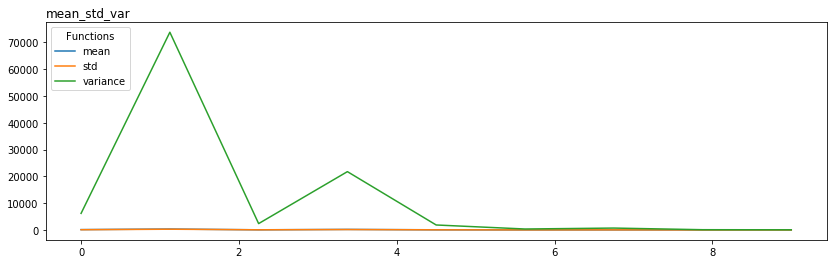

In [59]:
#x = np.linspace(0, 9, 9)
x = np.linspace(0, len(prep_list), len(prep_list))
y1 = mean_list
y2 = std_list
y3 = variance_list

# figure は 1 つ
fig=plt.figure(figsize=(14,4),facecolor='w')

plt.plot(x, y1, label='mean')
plt.plot(x, y2, label='std')
plt.plot(x, y3, label='variance')
plt.legend(loc='upper left',title='Functions')
plt.title('mean_std_var',loc='left')

filename = new_dir_path_png + "/mean_std_var.png"
plt.savefig(filename)

In [60]:
new_dir_path_png

'png/Poe-story'

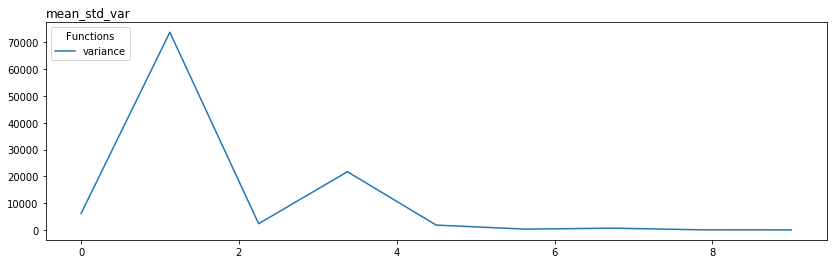

In [61]:
x = np.linspace(0, len(prep_list), len(prep_list))
y1 = mean_list
y2 = std_list
y3 = variance_list

# figure は 1 つ
fig=plt.figure(figsize=(14,4),facecolor='w')


plt.plot(x, y3, label='variance')
plt.legend(loc='upper left',title='Functions')
plt.title('mean_std_var',loc='left')

filename = new_dir_path_png + "/_var.png"
plt.savefig(filename)


In [62]:
for j in range(len(prep_array)):
    print(prep_list[j])
    

and
the
that
of
was
upon
not
when
then


In [63]:
prep_list 

['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']

# fdistから記号を取り除いて可視化
大文字小文字を合併
tokens_l = [w.lower() for w in tokens] 

In [64]:
len(fdist), len(fdist_list[0])

(440, 247)

In [65]:
(fdist) ,(fdist_list[0]), (fdist_list[1])

(FreqDist({'the': 100, ',': 99, 'of': 69, 'and': 62, '.': 29, 'in': 22, '?': 16, 'a': 15, 'shadow': 14, 'but': 12, ...}),
 FreqDist({'the': 33, ',': 28, 'of': 20, 'and': 19, 'a': 9, '.': 9, 'are': 9, 'they': 9, 'to': 8, 'them': 8, ...}),
 FreqDist({'the': 55, ',': 54, 'of': 35, 'and': 27, '.': 25, 'in': 17, 'to': 16, 'it': 15, 'was': 13, 'his': 12, ...}))

In [66]:
fdist_list[0].items(), fdist_list[1].items()

(dict_items([('the', 33), ('swiss', 4), ('bell-ringers', 5), ('one', 3), ('of', 20), ('regular', 1), ('allies', 1), ('mirror', 2), (',', 28), ('a', 9), ('man', 2), ('very', 2), ('humorous', 1), ('critical', 1), ('vein', 1), ('has', 1), ('taken', 1), ('it', 1), ('into', 1), ('his', 2), ('head', 1), ('to', 8), ('prove', 1), ('be', 5), ('an', 2), ('automaton', 3), ('.', 9), ('we', 3), ('have', 3), ('argued', 1), ('point', 1), ('with', 7), ('him', 1), ('till', 1), ('are', 9), ('tired', 1), ('and', 19), ('at', 3), ('last', 1), ('sent', 1), ('beg', 1), ('copy', 1), ('their', 6), ('board-bill', 1), ('affidavits', 1), ('that', 7), ('stomachs', 1), ('not', 2), ('wooden', 1), ('do', 1), ('kindly', 1), ('entertain', 1), ('rolls', 1), ('sausages', 1), ('while', 2), ('these', 2), ('documents', 1), ('coming', 1), ('publish', 1), ('skeleton', 1), ('our', 2), ('friend', 1), ('’', 3), ('s', 3), ('hypothesis', 1), (':', 1), ('?', 5), ('readers', 1), ('scarce', 1), ('need', 1), ('told', 1), ('as', 5), ('

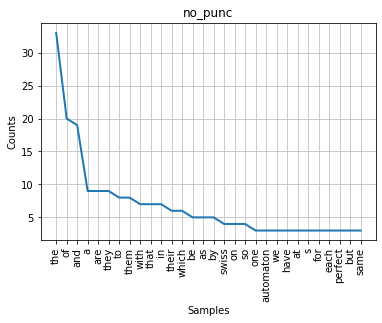

In [67]:
fdist_no_punc = nltk.FreqDist(dict((word, freq) for word, freq in fdist_list[0].items() if word.isalpha()))
fdist_no_punc.plot(30, title='no_punc')

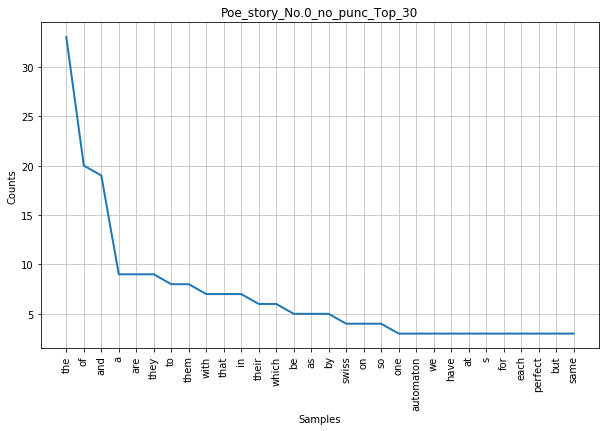

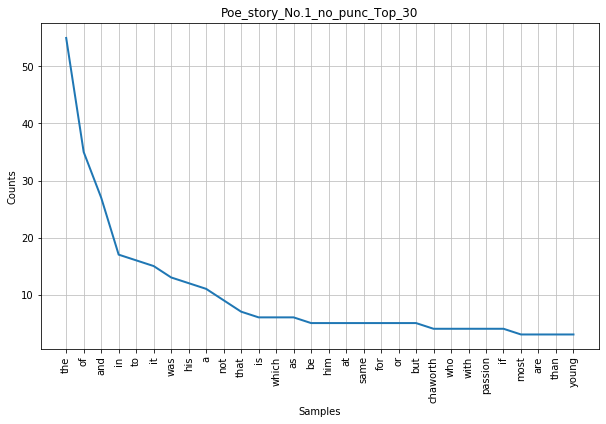

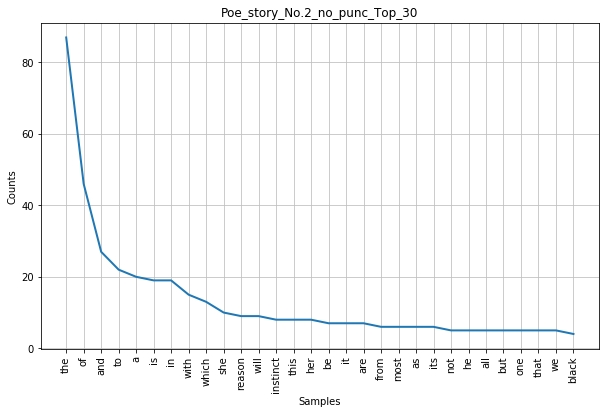

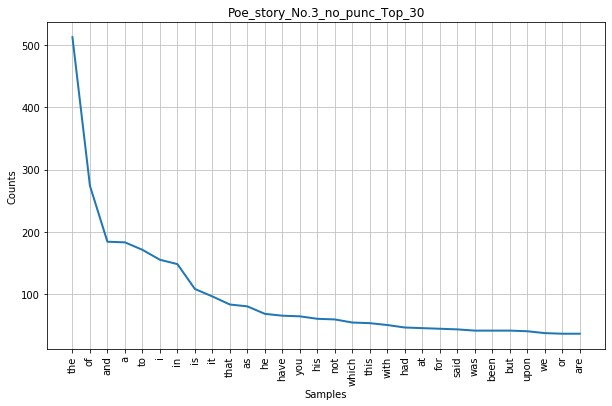

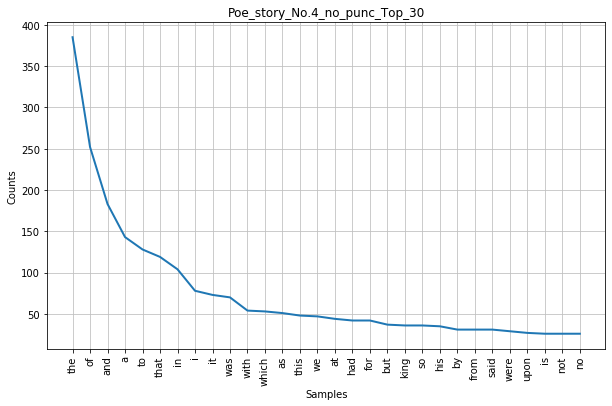

...

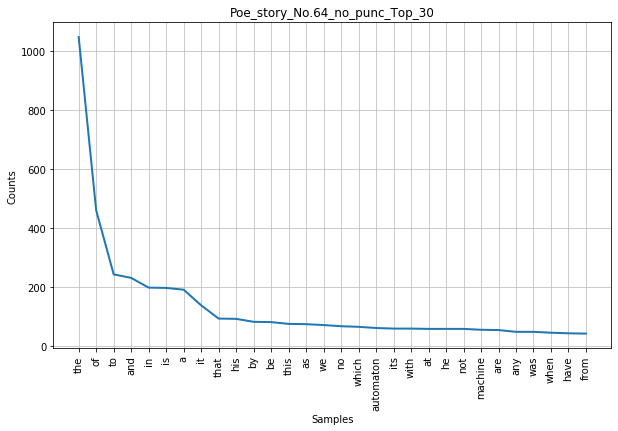

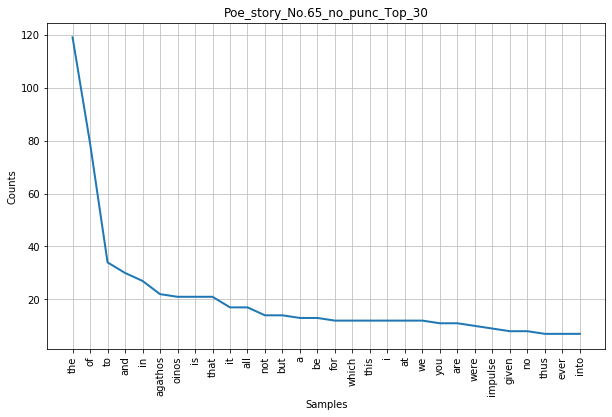

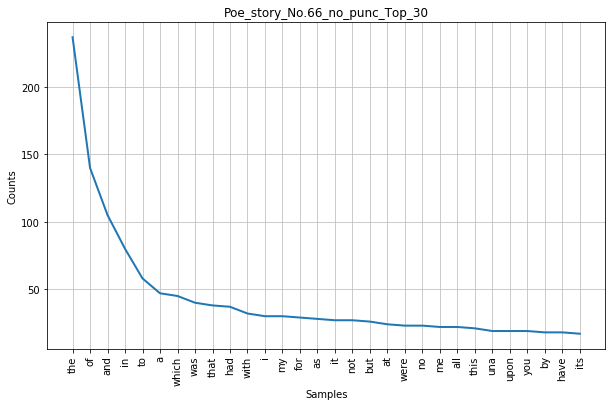

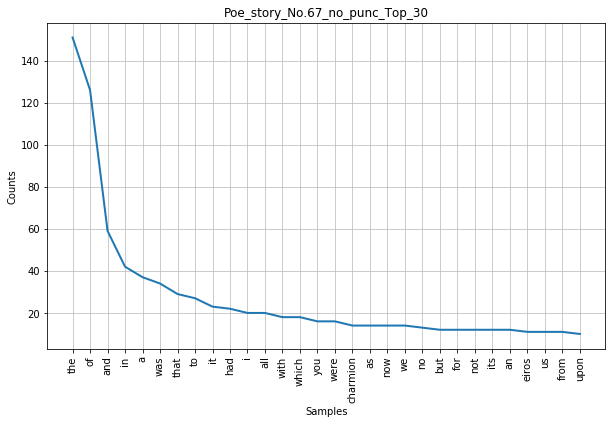

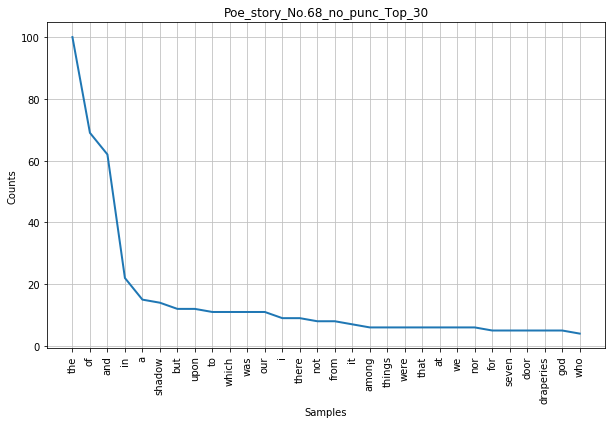

In [68]:
my_makedirs(new_dir_path_png_top)
my_makedirs(new_dir_path_png_top_no_punc)

num_counted = 30
fdist_array = np.array(fdist_list)
#for i in range(len(fdist_array)):
for i in range(len(read_book_list)):
    fig = plt.figure(figsize = (10,6))
    title_ =  str(author[choice[index_i]])+ str('_')+str(type_[choice[index_j]])+"_No." +str(i)+'_no_punc'+'_Top_'+str(num_counted)
    fdist_no_punc = nltk.FreqDist(dict((word, freq) for word, freq in fdist_list[i].items() if word.isalpha()))
    fdist_no_punc.plot(num_counted,  title = title_)
    
    filename = new_dir_path_png_top_no_punc + "/" + title_ +".png"
    fig.savefig(filename)
    

In [69]:
author_type

'Poe-story'

In [70]:
dict((word, freq) for word, freq in fdist_list[0].items() if word.isalpha())

{'the': 33,
 'swiss': 4,
 'one': 3,
 'of': 20,
 'regular': 1,
 'allies': 1,
 'mirror': 2,
 'a': 9,
 'man': 2,
 'very': 2,
 'humorous': 1,
 'critical': 1,
 'vein': 1,
 'has': 1,
 'taken': 1,
 'it': 1,
 'into': 1,
 'his': 2,
 'head': 1,
 'to': 8,
 'prove': 1,
 'be': 5,
 'an': 2,
 'automaton': 3,
 'we': 3,
 'have': 3,
 'argued': 1,
 'point': 1,
 'with': 7,
 'him': 1,
 'till': 1,
 'are': 9,
 'tired': 1,
 'and': 19,
 'at': 3,
 'last': 1,
 'sent': 1,
 'beg': 1,
 'copy': 1,
 'their': 6,
 'affidavits': 1,
 'that': 7,
 'stomachs': 1,
 'not': 2,
 'wooden': 1,
 'do': 1,
 'kindly': 1,
 'entertain': 1,
 'rolls': 1,
 'sausages': 1,
 'while': 2,
 'these': 2,
 'documents': 1,
 'coming': 1,
 'publish': 1,
 'skeleton': 1,
 'our': 2,
 'friend': 1,
 's': 3,
 'hypothesis': 1,
 'readers': 1,
 'scarce': 1,
 'need': 1,
 'told': 1,
 'as': 5,
 'most': 1,
 'them': 8,
 'seen': 1,
 'heard': 2,
 'for': 3,
 'themselves': 1,
 'enter': 1,
 'number': 2,
 'seven': 2,
 'fancifully': 1,
 'costumed': 1,
 'each': 3,
 'armed

In [71]:
for i in range(len(read_book_list)):
    print("No.",i,"\n", fdist_list[i].items(), "\n")
    

No. 0 
 dict_items([('the', 33), ('swiss', 4), ('bell-ringers', 5), ('one', 3), ('of', 20), ('regular', 1), ('allies', 1), ('mirror', 2), (',', 28), ('a', 9), ('man', 2), ('very', 2), ('humorous', 1), ('critical', 1), ('vein', 1), ('has', 1), ('taken', 1), ('it', 1), ('into', 1), ('his', 2), ('head', 1), ('to', 8), ('prove', 1), ('be', 5), ('an', 2), ('automaton', 3), ('.', 9), ('we', 3), ('have', 3), ('argued', 1), ('point', 1), ('with', 7), ('him', 1), ('till', 1), ('are', 9), ('tired', 1), ('and', 19), ('at', 3), ('last', 1), ('sent', 1), ('beg', 1), ('copy', 1), ('their', 6), ('board-bill', 1), ('affidavits', 1), ('that', 7), ('stomachs', 1), ('not', 2), ('wooden', 1), ('do', 1), ('kindly', 1), ('entertain', 1), ('rolls', 1), ('sausages', 1), ('while', 2), ('these', 2), ('documents', 1), ('coming', 1), ('publish', 1), ('skeleton', 1), ('our', 2), ('friend', 1), ('’', 3), ('s', 3), ('hypothesis', 1), (':', 1), ('?', 5), ('readers', 1), ('scarce', 1), ('need', 1), ('told', 1), ('as',

In [72]:
for i in range(len(read_book_list)):
    for word, freq in fdist_list[j].items():
        print(word, freq)

the 269
black 5
cat 12
. 168
for 32
most 9
wild 1
, 345
yet 6
homely 1
narrative 1
which 35
i 145
am 8
about 11
to 109
pen 2
neither 2
expect 2
nor 2
solicit 1
belief 1
mad 2
indeed 2
would 9
be 14
it 69
in 56
a 92
case 1
where 1
my 110
very 13
senses 1
reject 2
their 6
own 8
evidence 1
not 30
? 73
and 122
surely 1
do 3
dream 1
but 25
to-morrow 1
die 1
to-day 1
unburthen 1
soul 7
immediate 1
purpose 2
is 9
place 5
before 4
world 1
plainly 1
succinctly 1
without 3
comment 1
series 1
of 177
mere 4
household 2
events 2
consequences 1
these 8
have 15
terrified 1
tortured 1
destroyed 3
me 35
will 5
attempt 1
expound 1
them 5
they 5
presented 2
little 5
horror 5
many 4
seem 1
less 4
terrible 3
than 12
barroques 1
hereafter 1
perhaps 1
some 8
intellect 2
may 3
found 4
reduce 1
phantasm 2
common-place 1
more 14
calm 1
logical 1
far 3
excitable 1
perceive 1
circumstances 1
detail 1
with 39
awe 2
nothing 3
an 9
ordinary 1
succession 1
natural 1
causes 1
effects 2
from 29
infancy 1
was 51
noted 1

soundly 1
tranquilly 1
aye 1
burden 1
second 1
third 2
passed 1
tormentor 1
breathed 1
freeman 1
premises 2
forever 1
behold 1
happiness 1
supreme 1
guilt 1
dark 1
few 1
inquiries 1
answered 2
instituted 1
discovered 1
future 1
felicity 1
secured 1
fourth 2
assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
delight 1
allayed 1
your 1
suspicions 1
you 2
health 1
courtesy 1
bye 1
house. 1
[ 1
rabid 1
desire 1
uttered 1
] 1
excellently 1
going 1
solidly 1
together 1
phrenzy 1
bravado 1
rapped 1
heavily 1
cane 1
held 1
brick-work 1
behind 1
shield 1
deliver 1
fangs 1
arch-fiend 1
reverberation 1
bl

hit 1
considered 1
expedient 1
determined 1
monks 1
ages 1
are 3
recorded 1
walled 2
victims 1
adapted 1
loosely 1
constructed 3
lately 1
plastered 1
throughout 1
rough 1
dampness 1
atmosphere 1
prevented 1
hardening 1
moreover 1
projection 1
false 1
chimney 1
fireplace 1
resemble 1
red 2
displace 1
bricks 2
insert 1
detect 1
suspicious 1
calculation 1
deceived 1
means 1
crow-bar 1
easily 3
dislodged 1
carefully 2
deposited 1
inner 1
propped 1
position 1
re-laid 1
structure 1
procured 1
mortar 1
sand 1
precaution 1
distinguished 1
over 1
new 1
brickwork 1
finished 1
satisfied 2
right 1
present 3
slightest 1
disturbed 2
rubbish 1
picked 1
minutest 1
care 1
looked 2
around 1
triumphantly 1
least 2
labor 1
vain. 1
next 2
step 1
firmly 1
put 2
able 1
meet 1
fate 1
crafty 1
alarmed 1
previous 1
anger 1
forebore 1
mood 1
impossible 1
describe 1
imagine 1
blissful 1
absence 1
detested 1
occasioned 1
bosom 3
since 1
introduction 1
soundly 1
tranquilly 1
aye 1
burden 1
second 1
third 2
passed 1

assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
delight 1
allayed 1
your 1
suspicions 1
you 2
health 1
courtesy 1
bye 1
house. 1
[ 1
rabid 1
desire 1
uttered 1
] 1
excellently 1
going 1
solidly 1
together 1
phrenzy 1
bravado 1
rapped 1
heavily 1
cane 1
held 1
brick-work 1
behind 1
shield 1
deliver 1
fangs 1
arch-fiend 1
reverberation 1
blows 1
sunk 1
silence 1
voice 2
tomb 2
muffled 1
broken 1
sobbing 1
child 1
quickly 1
swelling 1
loud 1
continuous 1
scream 1
utterly 1
anomalous 1
inhuman 1
howl 1
wailing 1
shriek 1
arisen 1
hell 1
conjointly 1
throats 1
dammed 1
demons 1
exult 1
damnation 

assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
delight 1
allayed 1
your 1
suspicions 1
you 2
health 1
courtesy 1
bye 1
house. 1
[ 1
rabid 1
desire 1
uttered 1
] 1
excellently 1
going 1
solidly 1
together 1
phrenzy 1
bravado 1
rapped 1
heavily 1
cane 1
held 1
brick-work 1
behind 1
shield 1
deliver 1
fangs 1
arch-fiend 1
reverberation 1
blows 1
sunk 1
silence 1
voice 2
tomb 2
muffled 1
broken 1
sobbing 1
child 1
quickly 1
swelling 1
loud 1
continuous 1
scream 1
utterly 1
anomalous 1
inhuman 1
howl 1
wailing 1
shriek 1
arisen 1
hell 1
conjointly 1
throats 1
dammed 1
demons 1
exult 1
damnation 

distinguishing 1
trait 1
source 1
simplest 1
purest 1
pleasures 1
aversion 1
increase 1
followed 2
footsteps 1
pertinacity 1
difficult 1
reader 2
comprehend 1
whenever 1
crouch 1
beneath 2
chair 1
spring 1
knees 1
loathsome 1
walk 1
get 1
feet 1
throw 1
down 2
fastening 1
long 3
sharp 1
claws 1
dress 1
clamber 1
longed 1
destroy 1
blow 3
withheld 1
partly 1
chiefly 1
let 1
absolute 1
dread 4
exactly 1
physical 1
evil 3
define 1
almost 2
ashamed 2
yes 1
felon 1
cell 1
inspired 1
heightened 1
merest 1
chimaeras 1
conceive 1
called 1
mark 2
spoken 1
sole 2
visible 1
difference 1
remember 1
originally 2
imperceptible 1
struggled 1
fanciful 1
assumed 1
rigorous 2
distinctness 1
outline 1
representation 1
loathed 1
dreaded 1
monster 3
dared 1
image 2
hideous 3
ghastly 1
gallows 1
oh 1
mournful 1
engine 1
agony 2
death 2
wretched 1
wretchedness 2
whose 3
fellow 1
contemptuously 1
work 1
out 2
fashioned 1
insufferable 1
wo 1
alas 2
blessing 1
rest 1
moment 2
started 1
hourly 1
dreams 1
fear 1


aroused 1
sleep 2
cry 2
fire 6
curtains 1
bed 2
flames 2
whole 4
blazing 1
servant 1
escape 1
conflagration 1
destruction 1
complete 1
entire 2
worldly 1
wealth 1
swallowed 1
up 7
resigned 1
thenceforward 1
despair 1
above 2
weakness 1
seeking 1
establish 1
sequence 1
cause 2
effect 1
between 3
disaster 1
detailing 1
chain 1
facts 1
wish 2
leave 1
link 1
imperfect 1
succeeding 1
visited 1
ruins 1
walls 6
exception 2
fallen 1
compartment 1
wall 8
thick 1
stood 4
middle 2
against 3
rested 1
head 3
plastering 1
here 3
measure 1
resisted 1
fact 3
attributed 1
having 4
recently 1
spread 1
dense 1
crowd 2
collected 1
persons 1
examining 1
particular 1
portion 3
minute 2
eager 1
attention 3
words 1
“ 6
strange 2
” 6
singular 1
similar 2
expressions 1
excited 1
curiosity 1
approached 2
saw 2
graven 1
bas 1
relief 2
white 4
surface 1
figure 1
gigantic 1
impression 2
accuracy 1
truly 1
marvellous 1
rope 1
beheld 1
apparition 1
scarcely 2
wonder 1
reflection 1
aid 1
garden 2
adjacent 1
alarm 1
im

walls 6
exception 2
fallen 1
compartment 1
wall 8
thick 1
stood 4
middle 2
against 3
rested 1
head 3
plastering 1
here 3
measure 1
resisted 1
fact 3
attributed 1
having 4
recently 1
spread 1
dense 1
crowd 2
collected 1
persons 1
examining 1
particular 1
portion 3
minute 2
eager 1
attention 3
words 1
“ 6
strange 2
” 6
singular 1
similar 2
expressions 1
excited 1
curiosity 1
approached 2
saw 2
graven 1
bas 1
relief 2
white 4
surface 1
figure 1
gigantic 1
impression 2
accuracy 1
truly 1
marvellous 1
rope 1
beheld 1
apparition 1
scarcely 2
wonder 1
reflection 1
aid 1
garden 2
adjacent 1
alarm 1
immediately 3
filled 2
whom 1
must 1
thrown 1
open 1
window 1
chamber 1
probably 1
view 1
arousing 1
falling 1
compressed 1
victim 1
cruelty 2
substance 1
freshly-spread 1
plaster 3
lime 1
ammonia 1
carcass 1
accomplished 2
portraiture 1
although 4
readily 3
accounted 1
altogether 1
conscience 1
startling 1
detailed 1
did 4
fail 1
deep 2
fancy 1
months 1
rid 2
period 2
back 1
half-sentiment 1
regret

every 3
fibre 1
frame 1
took 1
waistcoat-pocket 1
pen-knife 1
opened 1
grasped 1
poor 1
beast 8
throat 1
deliberately 1
cut 2
eyes 4
socket 2
burn 1
shudder 2
while 3
damnable 1
atrocity 2
returned 1
morning 3
slept 3
off 2
fumes 1
debauch 1
sentiment 1
half 5
remorse 3
crime 3
been 22
guilty 1
best 2
feeble 2
equivocal 1
feeling 3
remained 2
untouched 1
again 4
plunged 1
into 14
excess 1
soon 3
drowned 1
wine 1
memory 2
deed 4
meantime 1
slowly 1
recovered 1
eye 3
true 1
frightful 1
appearance 4
appeared 3
suffer 1
any 4
pain 1
usual 4
might 2
expected 1
fled 2
extreme 2
terror 5
approach 1
left 3
first 3
grieved 1
evident 2
dislike 2
on 6
part 2
creature 5
loved 2
gave 1
irritation 1
then 5
if 7
final 2
irrevocable 1
overthrow 2
spirit 4
perverseness 3
philosophy 1
takes 1
account 1
sure 2
lives 1
primitive 1
impulses 1
human 1
indivisible 1
primary 1
faculties 1
sentiments 1
give 1
direction 1
hundred 1
times 2
himself 1
committing 2
vile 2
silly 1
action 2
other 3
because 5
knows 1

pleasure 1
those 2
who 7
cherished 1
affection 2
faithful 1
sagacious 2
dog 3
need 1
hardly 1
at 34
trouble 2
explaining 1
nature 2
or 15
intensity 1
gratification 1
thus 4
derivable 1
there 4
something 2
unselfish 1
self-sacrificing 1
love 1
brute 4
goes 1
directly 1
him 7
has 3
had 52
frequent 3
occasion 1
test 1
paltry 1
friendship 2
gossamer 1
fidelity 1
man 3
married 1
early 1
find 2
wife 10
uncongenial 1
observing 1
partiality 2
domestic 1
she 4
lost 2
no 19
opportunity 1
procuring 1
agreeable 1
kind 1
we 3
birds 1
gold-fish 1
fine 1
rabbits 2
small 1
monkey 2
latter 2
remarkably 1
large 5
beautiful 1
animal 8
entirely 1
astonishing 1
degree 2
speaking 1
his 4
intelligence 1
tinctured 1
superstition 1
made 8
allusion 1
ancient 1
popular 1
notion 1
regarded 1
all 9
cats 1
witches 1
disguise 1
that 30
ever 1
serious 1
upon 24
point 2
mention 1
matter 1
better 2
reason 6
happens 1
just 3
now 8
remembered 2
pluto 7
’ 5
s 5
name 2
favorite 2
pet 2
playmate 1
alone 2
fed 1
he 7
attende

with 39
awe 2
nothing 3
an 9
ordinary 1
succession 1
natural 1
causes 1
effects 2
from 29
infancy 1
was 51
noted 1
docility 1
humanity 3
disposition 4
tenderness 1
heart 9
even 11
so 13
conspicuous 1
as 32
make 5
jest 1
companions 1
especially 1
fond 1
animals 1
indulged 1
by 27
parents 1
great 4
variety 1
pets 3
spent 1
time 3
never 2
happy 2
when 9
feeding 1
caressing 1
this 37
peculiarity 1
character 4
grew 3
growth 1
manhood 1
derived 1
one 24
principal 1
sources 1
pleasure 1
those 2
who 7
cherished 1
affection 2
faithful 1
sagacious 2
dog 3
need 1
hardly 1
at 34
trouble 2
explaining 1
nature 2
or 15
intensity 1
gratification 1
thus 4
derivable 1
there 4
something 2
unselfish 1
self-sacrificing 1
love 1
brute 4
goes 1
directly 1
him 7
has 3
had 52
frequent 3
occasion 1
test 1
paltry 1
friendship 2
gossamer 1
fidelity 1
man 3
married 1
early 1
find 2
wife 10
uncongenial 1
observing 1
partiality 2
domestic 1
she 4
lost 2
no 19
opportunity 1
procuring 1
agreeable 1
kind 1
we 3
birds 1

supreme 1
guilt 1
dark 1
few 1
inquiries 1
answered 2
instituted 1
discovered 1
future 1
felicity 1
secured 1
fourth 2
assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
delight 1
allayed 1
your 1
suspicions 1
you 2
health 1
courtesy 1
bye 1
house. 1
[ 1
rabid 1
desire 1
uttered 1
] 1
excellently 1
going 1
solidly 1
together 1
phrenzy 1
bravado 1
rapped 1
heavily 1
cane 1
held 1
brick-work 1
behind 1
shield 1
deliver 1
fangs 1
arch-fiend 1
reverberation 1
blows 1
sunk 1
silence 1
voice 2
tomb 2
muffled 1
broken 1
sobbing 1
child 1
quickly 1
swelling 1
loud 1
continuous 1
scream 1
utterly 1
anom

end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
delight 1
allayed 1
your 1
suspicions 1
you 2
health 1
courtesy 1
bye 1
house. 1
[ 1
rabid 1
desire 1
uttered 1
] 1
excellently 1
going 1
solidly 1
together 1
phrenzy 1
bravado 1
rapped 1
heavily 1
cane 1
held 1
brick-work 1
behind 1
shield 1
deliver 1
fangs 1
arch-fiend 1
reverberation 1
blows 1
sunk 1
silence 1
voice 2
tomb 2
muffled 1
broken 1
sobbing 1
child 1
quickly 1
swelling 1
loud 1
continuous 1
scream 1
utterly 1
anomalous 1
inhuman 1
howl 1
wailing 1
shriek 1
arisen 1
hell 1
conjointly 1
throats 1
dammed 1
demons 1
exult 1
damnation 1
folly 1
speak 1
swooning 1
staggered 1
opposite 1
instant 1
motionless 1
extremity 1
dozen 1
stout 1
toiling 1
bodily 1
greatly 1
decayed 1
clotted 1
gore 1
erect 1
spectators 1
extended 1
mouth 1
solitary 1
craft 1
seduced 1
informing 1
consig

instituted 1
discovered 1
future 1
felicity 1
secured 1
fourth 2
assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
delight 1
allayed 1
your 1
suspicions 1
you 2
health 1
courtesy 1
bye 1
house. 1
[ 1
rabid 1
desire 1
uttered 1
] 1
excellently 1
going 1
solidly 1
together 1
phrenzy 1
bravado 1
rapped 1
heavily 1
cane 1
held 1
brick-work 1
behind 1
shield 1
deliver 1
fangs 1
arch-fiend 1
reverberation 1
blows 1
sunk 1
silence 1
voice 2
tomb 2
muffled 1
broken 1
sobbing 1
child 1
quickly 1
swelling 1
loud 1
continuous 1
scream 1
utterly 1
anomalous 1
inhuman 1
howl 1
wailing 1
shriek 1
arisen 1
h

chimney 1
fireplace 1
resemble 1
red 2
displace 1
bricks 2
insert 1
detect 1
suspicious 1
calculation 1
deceived 1
means 1
crow-bar 1
easily 3
dislodged 1
carefully 2
deposited 1
inner 1
propped 1
position 1
re-laid 1
structure 1
procured 1
mortar 1
sand 1
precaution 1
distinguished 1
over 1
new 1
brickwork 1
finished 1
satisfied 2
right 1
present 3
slightest 1
disturbed 2
rubbish 1
picked 1
minutest 1
care 1
looked 2
around 1
triumphantly 1
least 2
labor 1
vain. 1
next 2
step 1
firmly 1
put 2
able 1
meet 1
fate 1
crafty 1
alarmed 1
previous 1
anger 1
forebore 1
mood 1
impossible 1
describe 1
imagine 1
blissful 1
absence 1
detested 1
occasioned 1
bosom 3
since 1
introduction 1
soundly 1
tranquilly 1
aye 1
burden 1
second 1
third 2
passed 1
tormentor 1
breathed 1
freeman 1
premises 2
forever 1
behold 1
happiness 1
supreme 1
guilt 1
dark 1
few 1
inquiries 1
answered 2
instituted 1
discovered 1
future 1
felicity 1
secured 1
fourth 2
assassination 1
party 3
police 2
unexpectedly 1
investig

arrangements 1
getting 1
porter 1
hit 1
considered 1
expedient 1
determined 1
monks 1
ages 1
are 3
recorded 1
walled 2
victims 1
adapted 1
loosely 1
constructed 3
lately 1
plastered 1
throughout 1
rough 1
dampness 1
atmosphere 1
prevented 1
hardening 1
moreover 1
projection 1
false 1
chimney 1
fireplace 1
resemble 1
red 2
displace 1
bricks 2
insert 1
detect 1
suspicious 1
calculation 1
deceived 1
means 1
crow-bar 1
easily 3
dislodged 1
carefully 2
deposited 1
inner 1
propped 1
position 1
re-laid 1
structure 1
procured 1
mortar 1
sand 1
precaution 1
distinguished 1
over 1
new 1
brickwork 1
finished 1
satisfied 2
right 1
present 3
slightest 1
disturbed 2
rubbish 1
picked 1
minutest 1
care 1
looked 2
around 1
triumphantly 1
least 2
labor 1
vain. 1
next 2
step 1
firmly 1
put 2
able 1
meet 1
fate 1
crafty 1
alarmed 1
previous 1
anger 1
forebore 1
mood 1
impossible 1
describe 1
imagine 1
blissful 1
absence 1
detested 1
occasioned 1
bosom 3
since 1
introduction 1
soundly 1
tranquilly 1
aye 1


assumed 1
rigorous 2
distinctness 1
outline 1
representation 1
loathed 1
dreaded 1
monster 3
dared 1
image 2
hideous 3
ghastly 1
gallows 1
oh 1
mournful 1
engine 1
agony 2
death 2
wretched 1
wretchedness 2
whose 3
fellow 1
contemptuously 1
work 1
out 2
fashioned 1
insufferable 1
wo 1
alas 2
blessing 1
rest 1
moment 2
started 1
hourly 1
dreams 1
fear 1
hot 1
face 1
vast 1
weight 1
incarnate 1
night-mare 1
power 1
shake 1
incumbent 1
eternally 1
pressure 1
torments 1
remnant 1
good 1
succumbed 1
thoughts 3
intimates 1
darkest 1
moodiness 1
increased 1
things 1
mankind 1
sudden 1
ungovernable 1
outbursts 1
blindly 1
abandoned 1
uncomplaining 1
patient 1
sufferers 1
accompanied 1
errand 1
cellar 7
building 1
poverty 1
compelled 1
us 1
inhabit 1
steep 1
stairs 2
throwing 1
headlong 1
exasperated 1
madness 1
uplifting 1
axe 2
forgetting 1
wrath 1
childish 1
hitherto 1
stayed 1
aimed 1
proved 1
fatal 1
descended 2
wished 1
arrested 1
goaded 1
interference 1
rage 1
demoniacal 1
withdrew 1
arm 

loudly 1
rubbed 1
delighted 1
notice 1
search 3
purchase 1
landlord 1
person 1
claim 1
seen 1
continued 1
caresses 2
prepared 3
go 1
evinced 1
accompany 2
permitted 1
occasionally 1
stooping 1
patting 1
proceeded 2
reached 1
domesticated 1
became 2
arising 1
within 4
reverse 1
anticipated 1
know 1
how 2
why 1
fondness 1
rather 1
disgusted 1
annoyed 1
slow 2
degrees 3
disgust 1
annoyance 1
rose 1
bitterness 1
hatred 3
certain 1
sense 2
shame 1
remembrance 1
former 3
preventing 1
physically 1
abusing 1
weeks 1
strike 1
otherwise 2
violently 1
gradually 2
unutterable 2
loathing 1
flee 1
silently 1
odious 1
breath 2
pestilence 1
added 1
doubt 3
discovery 1
after 1
brought 1
also 1
deprived 1
circumstance 1
endeared 1
already 2
said 3
high 2
distinguishing 1
trait 1
source 1
simplest 1
purest 1
pleasures 1
aversion 1
increase 1
followed 2
footsteps 1
pertinacity 1
difficult 1
reader 2
comprehend 1
whenever 1
crouch 1
beneath 2
chair 1
spring 1
knees 1
loathsome 1
walk 1
get 1
feet 1
throw 1

wrong 2
sake 1
urged 1
continue 1
finally 2
consummate 1
injury 1
unoffending 1
cool 1
blood 1
slipped 1
noose 1
neck 2
hung 5
limb 1
tree 2
tears 1
streaming 1
bitterest 1
felt 3
given 2
offence 1
doing 2
sin 2
deadly 1
jeopardize 1
immortal 1
thing 4
wore 1
possible 4
beyond 2
reach 1
infinite 1
mercy 1
merciful 1
god 3
cruel 1
done 2
aroused 1
sleep 2
cry 2
fire 6
curtains 1
bed 2
flames 2
whole 4
blazing 1
servant 1
escape 1
conflagration 1
destruction 1
complete 1
entire 2
worldly 1
wealth 1
swallowed 1
up 7
resigned 1
thenceforward 1
despair 1
above 2
weakness 1
seeking 1
establish 1
sequence 1
cause 2
effect 1
between 3
disaster 1
detailing 1
chain 1
facts 1
wish 2
leave 1
link 1
imperfect 1
succeeding 1
visited 1
ruins 1
walls 6
exception 2
fallen 1
compartment 1
wall 8
thick 1
stood 4
middle 2
against 3
rested 1
head 3
plastering 1
here 3
measure 1
resisted 1
fact 3
attributed 1
having 4
recently 1
spread 1
dense 1
crowd 2
collected 1
persons 1
examining 1
particular 1
portion

malevolence 1
gin-nurtured 1
thrilled 1
every 3
fibre 1
frame 1
took 1
waistcoat-pocket 1
pen-knife 1
opened 1
grasped 1
poor 1
beast 8
throat 1
deliberately 1
cut 2
eyes 4
socket 2
burn 1
shudder 2
while 3
damnable 1
atrocity 2
returned 1
morning 3
slept 3
off 2
fumes 1
debauch 1
sentiment 1
half 5
remorse 3
crime 3
been 22
guilty 1
best 2
feeble 2
equivocal 1
feeling 3
remained 2
untouched 1
again 4
plunged 1
into 14
excess 1
soon 3
drowned 1
wine 1
memory 2
deed 4
meantime 1
slowly 1
recovered 1
eye 3
true 1
frightful 1
appearance 4
appeared 3
suffer 1
any 4
pain 1
usual 4
might 2
expected 1
fled 2
extreme 2
terror 5
approach 1
left 3
first 3
grieved 1
evident 2
dislike 2
on 6
part 2
creature 5
loved 2
gave 1
irritation 1
then 5
if 7
final 2
irrevocable 1
overthrow 2
spirit 4
perverseness 3
philosophy 1
takes 1
account 1
sure 2
lives 1
primitive 1
impulses 1
human 1
indivisible 1
primary 1
faculties 1
sentiments 1
give 1
direction 1
hundred 1
times 2
himself 1
committing 2
vile 2
si

far 3
excitable 1
perceive 1
circumstances 1
detail 1
with 39
awe 2
nothing 3
an 9
ordinary 1
succession 1
natural 1
causes 1
effects 2
from 29
infancy 1
was 51
noted 1
docility 1
humanity 3
disposition 4
tenderness 1
heart 9
even 11
so 13
conspicuous 1
as 32
make 5
jest 1
companions 1
especially 1
fond 1
animals 1
indulged 1
by 27
parents 1
great 4
variety 1
pets 3
spent 1
time 3
never 2
happy 2
when 9
feeding 1
caressing 1
this 37
peculiarity 1
character 4
grew 3
growth 1
manhood 1
derived 1
one 24
principal 1
sources 1
pleasure 1
those 2
who 7
cherished 1
affection 2
faithful 1
sagacious 2
dog 3
need 1
hardly 1
at 34
trouble 2
explaining 1
nature 2
or 15
intensity 1
gratification 1
thus 4
derivable 1
there 4
something 2
unselfish 1
self-sacrificing 1
love 1
brute 4
goes 1
directly 1
him 7
has 3
had 52
frequent 3
occasion 1
test 1
paltry 1
friendship 2
gossamer 1
fidelity 1
man 3
married 1
early 1
find 2
wife 10
uncongenial 1
observing 1
partiality 2
domestic 1
she 4
lost 2
no 19
opp

effects 2
from 29
infancy 1
was 51
noted 1
docility 1
humanity 3
disposition 4
tenderness 1
heart 9
even 11
so 13
conspicuous 1
as 32
make 5
jest 1
companions 1
especially 1
fond 1
animals 1
indulged 1
by 27
parents 1
great 4
variety 1
pets 3
spent 1
time 3
never 2
happy 2
when 9
feeding 1
caressing 1
this 37
peculiarity 1
character 4
grew 3
growth 1
manhood 1
derived 1
one 24
principal 1
sources 1
pleasure 1
those 2
who 7
cherished 1
affection 2
faithful 1
sagacious 2
dog 3
need 1
hardly 1
at 34
trouble 2
explaining 1
nature 2
or 15
intensity 1
gratification 1
thus 4
derivable 1
there 4
something 2
unselfish 1
self-sacrificing 1
love 1
brute 4
goes 1
directly 1
him 7
has 3
had 52
frequent 3
occasion 1
test 1
paltry 1
friendship 2
gossamer 1
fidelity 1
man 3
married 1
early 1
find 2
wife 10
uncongenial 1
observing 1
partiality 2
domestic 1
she 4
lost 2
no 19
opportunity 1
procuring 1
agreeable 1
kind 1
we 3
birds 1
gold-fish 1
fine 1
rabbits 2
small 1
monkey 2
latter 2
remarkably 1
lar

forebore 1
mood 1
impossible 1
describe 1
imagine 1
blissful 1
absence 1
detested 1
occasioned 1
bosom 3
since 1
introduction 1
soundly 1
tranquilly 1
aye 1
burden 1
second 1
third 2
passed 1
tormentor 1
breathed 1
freeman 1
premises 2
forever 1
behold 1
happiness 1
supreme 1
guilt 1
dark 1
few 1
inquiries 1
answered 2
instituted 1
discovered 1
future 1
felicity 1
secured 1
fourth 2
assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
delight 1
allayed 1
your 1
suspicions 1
you 2
health 1
courtesy 1
bye 1
house. 1
[ 1
rabid 1
desire 1
uttered 1
] 1
excellently 1
going 1
solidly 1
together 1
phren

officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
delight 1
allayed 1
your 1
suspicions 1
you 2
health 1
courtesy 1
bye 1
house. 1
[ 1
rabid 1
desire 1
uttered 1
] 1
excellently 1
going 1
solidly 1
together 1
phrenzy 1
bravado 1
rapped 1
heavily 1
cane 1
held 1
brick-work 1
behind 1
shield 1
deliver 1
fangs 1
arch-fiend 1
reverberation 1
blows 1
sunk 1
silence 1
voice 2
tomb 2
muffled 1
broken 1
sobbing 1
child 1
quickly 1
swelling 1
loud 1
continuous 1
scream 1
utterly 1
anomalous 1
inhuman 1
howl 1
wailing 1
shriek 1
arisen 1
hell 1
conjointly 1
throats 1
dammed 1
demons 1
exult 1
damnation 1
folly 1
speak 1
swooning 1
staggered 1
opposite 1
instant 1
motionless 1
extremity 1
dozen 1
stout 1
toiling 1
bodily 1
greatly 1

freeman 1
premises 2
forever 1
behold 1
happiness 1
supreme 1
guilt 1
dark 1
few 1
inquiries 1
answered 2
instituted 1
discovered 1
future 1
felicity 1
secured 1
fourth 2
assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
delight 1
allayed 1
your 1
suspicions 1
you 2
health 1
courtesy 1
bye 1
house. 1
[ 1
rabid 1
desire 1
uttered 1
] 1
excellently 1
going 1
solidly 1
together 1
phrenzy 1
bravado 1
rapped 1
heavily 1
cane 1
held 1
brick-work 1
behind 1
shield 1
deliver 1
fangs 1
arch-fiend 1
reverberation 1
blows 1
sunk 1
silence 1
voice 2
tomb 2
muffled 1
broken 1
sobbing 1
child 1
quickly 1
sw

loosely 1
constructed 3
lately 1
plastered 1
throughout 1
rough 1
dampness 1
atmosphere 1
prevented 1
hardening 1
moreover 1
projection 1
false 1
chimney 1
fireplace 1
resemble 1
red 2
displace 1
bricks 2
insert 1
detect 1
suspicious 1
calculation 1
deceived 1
means 1
crow-bar 1
easily 3
dislodged 1
carefully 2
deposited 1
inner 1
propped 1
position 1
re-laid 1
structure 1
procured 1
mortar 1
sand 1
precaution 1
distinguished 1
over 1
new 1
brickwork 1
finished 1
satisfied 2
right 1
present 3
slightest 1
disturbed 2
rubbish 1
picked 1
minutest 1
care 1
looked 2
around 1
triumphantly 1
least 2
labor 1
vain. 1
next 2
step 1
firmly 1
put 2
able 1
meet 1
fate 1
crafty 1
alarmed 1
previous 1
anger 1
forebore 1
mood 1
impossible 1
describe 1
imagine 1
blissful 1
absence 1
detested 1
occasioned 1
bosom 3
since 1
introduction 1
soundly 1
tranquilly 1
aye 1
burden 1
second 1
third 2
passed 1
tormentor 1
breathed 1
freeman 1
premises 2
forever 1
behold 1
happiness 1
supreme 1
guilt 1
dark 1
few 

gallows 1
oh 1
mournful 1
engine 1
agony 2
death 2
wretched 1
wretchedness 2
whose 3
fellow 1
contemptuously 1
work 1
out 2
fashioned 1
insufferable 1
wo 1
alas 2
blessing 1
rest 1
moment 2
started 1
hourly 1
dreams 1
fear 1
hot 1
face 1
vast 1
weight 1
incarnate 1
night-mare 1
power 1
shake 1
incumbent 1
eternally 1
pressure 1
torments 1
remnant 1
good 1
succumbed 1
thoughts 3
intimates 1
darkest 1
moodiness 1
increased 1
things 1
mankind 1
sudden 1
ungovernable 1
outbursts 1
blindly 1
abandoned 1
uncomplaining 1
patient 1
sufferers 1
accompanied 1
errand 1
cellar 7
building 1
poverty 1
compelled 1
us 1
inhabit 1
steep 1
stairs 2
throwing 1
headlong 1
exasperated 1
madness 1
uplifting 1
axe 2
forgetting 1
wrath 1
childish 1
hitherto 1
stayed 1
aimed 1
proved 1
fatal 1
descended 2
wished 1
arrested 1
goaded 1
interference 1
rage 1
demoniacal 1
withdrew 1
arm 1
grasp 1
buried 1
brain 1
fell 2
dead 1
spot 1
groan 1
murder 3
set 1
forthwith 1
deliberation 1
task 1
concealing 1
remove 1
ei

distinguishing 1
trait 1
source 1
simplest 1
purest 1
pleasures 1
aversion 1
increase 1
followed 2
footsteps 1
pertinacity 1
difficult 1
reader 2
comprehend 1
whenever 1
crouch 1
beneath 2
chair 1
spring 1
knees 1
loathsome 1
walk 1
get 1
feet 1
throw 1
down 2
fastening 1
long 3
sharp 1
claws 1
dress 1
clamber 1
longed 1
destroy 1
blow 3
withheld 1
partly 1
chiefly 1
let 1
absolute 1
dread 4
exactly 1
physical 1
evil 3
define 1
almost 2
ashamed 2
yes 1
felon 1
cell 1
inspired 1
heightened 1
merest 1
chimaeras 1
conceive 1
called 1
mark 2
spoken 1
sole 2
visible 1
difference 1
remember 1
originally 2
imperceptible 1
struggled 1
fanciful 1
assumed 1
rigorous 2
distinctness 1
outline 1
representation 1
loathed 1
dreaded 1
monster 3
dared 1
image 2
hideous 3
ghastly 1
gallows 1
oh 1
mournful 1
engine 1
agony 2
death 2
wretched 1
wretchedness 2
whose 3
fellow 1
contemptuously 1
work 1
out 2
fashioned 1
insufferable 1
wo 1
alas 2
blessing 1
rest 1
moment 2
started 1
hourly 1
dreams 1
fear 1


entire 2
worldly 1
wealth 1
swallowed 1
up 7
resigned 1
thenceforward 1
despair 1
above 2
weakness 1
seeking 1
establish 1
sequence 1
cause 2
effect 1
between 3
disaster 1
detailing 1
chain 1
facts 1
wish 2
leave 1
link 1
imperfect 1
succeeding 1
visited 1
ruins 1
walls 6
exception 2
fallen 1
compartment 1
wall 8
thick 1
stood 4
middle 2
against 3
rested 1
head 3
plastering 1
here 3
measure 1
resisted 1
fact 3
attributed 1
having 4
recently 1
spread 1
dense 1
crowd 2
collected 1
persons 1
examining 1
particular 1
portion 3
minute 2
eager 1
attention 3
words 1
“ 6
strange 2
” 6
singular 1
similar 2
expressions 1
excited 1
curiosity 1
approached 2
saw 2
graven 1
bas 1
relief 2
white 4
surface 1
figure 1
gigantic 1
impression 2
accuracy 1
truly 1
marvellous 1
rope 1
beheld 1
apparition 1
scarcely 2
wonder 1
reflection 1
aid 1
garden 2
adjacent 1
alarm 1
immediately 3
filled 2
whom 1
must 1
thrown 1
open 1
window 1
chamber 1
probably 1
view 1
arousing 1
falling 1
compressed 1
victim 1
crue

any 4
pain 1
usual 4
might 2
expected 1
fled 2
extreme 2
terror 5
approach 1
left 3
first 3
grieved 1
evident 2
dislike 2
on 6
part 2
creature 5
loved 2
gave 1
irritation 1
then 5
if 7
final 2
irrevocable 1
overthrow 2
spirit 4
perverseness 3
philosophy 1
takes 1
account 1
sure 2
lives 1
primitive 1
impulses 1
human 1
indivisible 1
primary 1
faculties 1
sentiments 1
give 1
direction 1
hundred 1
times 2
himself 1
committing 2
vile 2
silly 1
action 2
other 3
because 5
knows 1
should 3
perpetual 1
inclination 1
judgment 1
violate 1
law 1
merely 1
understand 1
such 6
say 5
unfathomable 1
longing 1
vex 1
itself 3
offer 1
wrong 2
sake 1
urged 1
continue 1
finally 2
consummate 1
injury 1
unoffending 1
cool 1
blood 1
slipped 1
noose 1
neck 2
hung 5
limb 1
tree 2
tears 1
streaming 1
bitterest 1
felt 3
given 2
offence 1
doing 2
sin 2
deadly 1
jeopardize 1
immortal 1
thing 4
wore 1
possible 4
beyond 2
reach 1
infinite 1
mercy 1
merciful 1
god 3
cruel 1
done 2
aroused 1
sleep 2
cry 2
fire 6
curtai

heart 9
even 11
so 13
conspicuous 1
as 32
make 5
jest 1
companions 1
especially 1
fond 1
animals 1
indulged 1
by 27
parents 1
great 4
variety 1
pets 3
spent 1
time 3
never 2
happy 2
when 9
feeding 1
caressing 1
this 37
peculiarity 1
character 4
grew 3
growth 1
manhood 1
derived 1
one 24
principal 1
sources 1
pleasure 1
those 2
who 7
cherished 1
affection 2
faithful 1
sagacious 2
dog 3
need 1
hardly 1
at 34
trouble 2
explaining 1
nature 2
or 15
intensity 1
gratification 1
thus 4
derivable 1
there 4
something 2
unselfish 1
self-sacrificing 1
love 1
brute 4
goes 1
directly 1
him 7
has 3
had 52
frequent 3
occasion 1
test 1
paltry 1
friendship 2
gossamer 1
fidelity 1
man 3
married 1
early 1
find 2
wife 10
uncongenial 1
observing 1
partiality 2
domestic 1
she 4
lost 2
no 19
opportunity 1
procuring 1
agreeable 1
kind 1
we 3
birds 1
gold-fish 1
fine 1
rabbits 2
small 1
monkey 2
latter 2
remarkably 1
large 5
beautiful 1
animal 8
entirely 1
astonishing 1
degree 2
speaking 1
his 4
intelligence 1


scream 1
utterly 1
anomalous 1
inhuman 1
howl 1
wailing 1
shriek 1
arisen 1
hell 1
conjointly 1
throats 1
dammed 1
demons 1
exult 1
damnation 1
folly 1
speak 1
swooning 1
staggered 1
opposite 1
instant 1
motionless 1
extremity 1
dozen 1
stout 1
toiling 1
bodily 1
greatly 1
decayed 1
clotted 1
gore 1
erect 1
spectators 1
extended 1
mouth 1
solitary 1
craft 1
seduced 1
informing 1
consigned 1
hangman 1
the 269
black 5
cat 12
. 168
for 32
most 9
wild 1
, 345
yet 6
homely 1
narrative 1
which 35
i 145
am 8
about 11
to 109
pen 2
neither 2
expect 2
nor 2
solicit 1
belief 1
mad 2
indeed 2
would 9
be 14
it 69
in 56
a 92
case 1
where 1
my 110
very 13
senses 1
reject 2
their 6
own 8
evidence 1
not 30
? 73
and 122
surely 1
do 3
dream 1
but 25
to-morrow 1
die 1
to-day 1
unburthen 1
soul 7
immediate 1
purpose 2
is 9
place 5
before 4
world 1
plainly 1
succinctly 1
without 3
comment 1
series 1
of 177
mere 4
household 2
events 2
consequences 1
these 8
have 15
terrified 1
tortured 1
destroyed 3
me 35
wi

us 1
inhabit 1
steep 1
stairs 2
throwing 1
headlong 1
exasperated 1
madness 1
uplifting 1
axe 2
forgetting 1
wrath 1
childish 1
hitherto 1
stayed 1
aimed 1
proved 1
fatal 1
descended 2
wished 1
arrested 1
goaded 1
interference 1
rage 1
demoniacal 1
withdrew 1
arm 1
grasp 1
buried 1
brain 1
fell 2
dead 1
spot 1
groan 1
murder 3
set 1
forthwith 1
deliberation 1
task 1
concealing 1
remove 1
either 2
risk 1
being 1
observed 1
neighbors 1
projects 1
entered 1
mind 1
thought 1
cutting 1
corpse 4
fragments 1
destroying 1
resolved 2
dig 1
grave 1
floor 2
deliberated 1
casting 1
well 4
yard 1
packing 1
box 1
merchandize 1
arrangements 1
getting 1
porter 1
hit 1
considered 1
expedient 1
determined 1
monks 1
ages 1
are 3
recorded 1
walled 2
victims 1
adapted 1
loosely 1
constructed 3
lately 1
plastered 1
throughout 1
rough 1
dampness 1
atmosphere 1
prevented 1
hardening 1
moreover 1
projection 1
false 1
chimney 1
fireplace 1
resemble 1
red 2
displace 1
bricks 2
insert 1
detect 1
suspicious 1
calc

remnant 1
good 1
succumbed 1
thoughts 3
intimates 1
darkest 1
moodiness 1
increased 1
things 1
mankind 1
sudden 1
ungovernable 1
outbursts 1
blindly 1
abandoned 1
uncomplaining 1
patient 1
sufferers 1
accompanied 1
errand 1
cellar 7
building 1
poverty 1
compelled 1
us 1
inhabit 1
steep 1
stairs 2
throwing 1
headlong 1
exasperated 1
madness 1
uplifting 1
axe 2
forgetting 1
wrath 1
childish 1
hitherto 1
stayed 1
aimed 1
proved 1
fatal 1
descended 2
wished 1
arrested 1
goaded 1
interference 1
rage 1
demoniacal 1
withdrew 1
arm 1
grasp 1
buried 1
brain 1
fell 2
dead 1
spot 1
groan 1
murder 3
set 1
forthwith 1
deliberation 1
task 1
concealing 1
remove 1
either 2
risk 1
being 1
observed 1
neighbors 1
projects 1
entered 1
mind 1
thought 1
cutting 1
corpse 4
fragments 1
destroying 1
resolved 2
dig 1
grave 1
floor 2
deliberated 1
casting 1
well 4
yard 1
packing 1
box 1
merchandize 1
arrangements 1
getting 1
porter 1
hit 1
considered 1
expedient 1
determined 1
monks 1
ages 1
are 3
recorded 1
wal

curtains 1
bed 2
flames 2
whole 4
blazing 1
servant 1
escape 1
conflagration 1
destruction 1
complete 1
entire 2
worldly 1
wealth 1
swallowed 1
up 7
resigned 1
thenceforward 1
despair 1
above 2
weakness 1
seeking 1
establish 1
sequence 1
cause 2
effect 1
between 3
disaster 1
detailing 1
chain 1
facts 1
wish 2
leave 1
link 1
imperfect 1
succeeding 1
visited 1
ruins 1
walls 6
exception 2
fallen 1
compartment 1
wall 8
thick 1
stood 4
middle 2
against 3
rested 1
head 3
plastering 1
here 3
measure 1
resisted 1
fact 3
attributed 1
having 4
recently 1
spread 1
dense 1
crowd 2
collected 1
persons 1
examining 1
particular 1
portion 3
minute 2
eager 1
attention 3
words 1
“ 6
strange 2
” 6
singular 1
similar 2
expressions 1
excited 1
curiosity 1
approached 2
saw 2
graven 1
bas 1
relief 2
white 4
surface 1
figure 1
gigantic 1
impression 2
accuracy 1
truly 1
marvellous 1
rope 1
beheld 1
apparition 1
scarcely 2
wonder 1
reflection 1
aid 1
garden 2
adjacent 1
alarm 1
immediately 3
filled 2
whom 1
mus

astonishing 1
degree 2
speaking 1
his 4
intelligence 1
tinctured 1
superstition 1
made 8
allusion 1
ancient 1
popular 1
notion 1
regarded 1
all 9
cats 1
witches 1
disguise 1
that 30
ever 1
serious 1
upon 24
point 2
mention 1
matter 1
better 2
reason 6
happens 1
just 3
now 8
remembered 2
pluto 7
’ 5
s 5
name 2
favorite 2
pet 2
playmate 1
alone 2
fed 1
he 7
attended 1
wherever 1
went 4
house 11
difficulty 2
could 8
prevent 1
following 1
through 6
streets 1
our 4
lasted 1
manner 2
several 1
years 1
during 4
general 1
temperament 1
instrumentality 1
fiend 1
intemperance 1
( 1
blush 2
confess 2
) 1
experienced 2
radical 1
alteration 1
worse 1
day 9
moody 1
irritable 1
regardless 1
feelings 2
others 1
suffered 1
myself 11
use 2
intemperate 1
language 1
length 6
offered 2
her 3
personal 1
violence 4
course 3
were 7
feel 1
change 1
only 4
neglected 1
ill-used 1
however 4
still 2
retained 1
sufficient 1
regard 2
restrain 1
maltreating 2
scruple 1
accident 1
came 8
way 2
disease 2
what 6
like 3


folly 1
speak 1
swooning 1
staggered 1
opposite 1
instant 1
motionless 1
extremity 1
dozen 1
stout 1
toiling 1
bodily 1
greatly 1
decayed 1
clotted 1
gore 1
erect 1
spectators 1
extended 1
mouth 1
solitary 1
craft 1
seduced 1
informing 1
consigned 1
hangman 1
the 269
black 5
cat 12
. 168
for 32
most 9
wild 1
, 345
yet 6
homely 1
narrative 1
which 35
i 145
am 8
about 11
to 109
pen 2
neither 2
expect 2
nor 2
solicit 1
belief 1
mad 2
indeed 2
would 9
be 14
it 69
in 56
a 92
case 1
where 1
my 110
very 13
senses 1
reject 2
their 6
own 8
evidence 1
not 30
? 73
and 122
surely 1
do 3
dream 1
but 25
to-morrow 1
die 1
to-day 1
unburthen 1
soul 7
immediate 1
purpose 2
is 9
place 5
before 4
world 1
plainly 1
succinctly 1
without 3
comment 1
series 1
of 177
mere 4
household 2
events 2
consequences 1
these 8
have 15
terrified 1
tortured 1
destroyed 3
me 35
will 5
attempt 1
expound 1
them 5
they 5
presented 2
little 5
horror 5
many 4
seem 1
less 4
terrible 3
than 12
barroques 1
hereafter 1
perhaps 1
s

slightest 1
disturbed 2
rubbish 1
picked 1
minutest 1
care 1
looked 2
around 1
triumphantly 1
least 2
labor 1
vain. 1
next 2
step 1
firmly 1
put 2
able 1
meet 1
fate 1
crafty 1
alarmed 1
previous 1
anger 1
forebore 1
mood 1
impossible 1
describe 1
imagine 1
blissful 1
absence 1
detested 1
occasioned 1
bosom 3
since 1
introduction 1
soundly 1
tranquilly 1
aye 1
burden 1
second 1
third 2
passed 1
tormentor 1
breathed 1
freeman 1
premises 2
forever 1
behold 1
happiness 1
supreme 1
guilt 1
dark 1
few 1
inquiries 1
answered 2
instituted 1
discovered 1
future 1
felicity 1
secured 1
fourth 2
assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessnes

descended 2
wished 1
arrested 1
goaded 1
interference 1
rage 1
demoniacal 1
withdrew 1
arm 1
grasp 1
buried 1
brain 1
fell 2
dead 1
spot 1
groan 1
murder 3
set 1
forthwith 1
deliberation 1
task 1
concealing 1
remove 1
either 2
risk 1
being 1
observed 1
neighbors 1
projects 1
entered 1
mind 1
thought 1
cutting 1
corpse 4
fragments 1
destroying 1
resolved 2
dig 1
grave 1
floor 2
deliberated 1
casting 1
well 4
yard 1
packing 1
box 1
merchandize 1
arrangements 1
getting 1
porter 1
hit 1
considered 1
expedient 1
determined 1
monks 1
ages 1
are 3
recorded 1
walled 2
victims 1
adapted 1
loosely 1
constructed 3
lately 1
plastered 1
throughout 1
rough 1
dampness 1
atmosphere 1
prevented 1
hardening 1
moreover 1
projection 1
false 1
chimney 1
fireplace 1
resemble 1
red 2
displace 1
bricks 2
insert 1
detect 1
suspicious 1
calculation 1
deceived 1
means 1
crow-bar 1
easily 3
dislodged 1
carefully 2
deposited 1
inner 1
propped 1
position 1
re-laid 1
structure 1
procured 1
mortar 1
sand 1
precaution

anticipated 1
know 1
how 2
why 1
fondness 1
rather 1
disgusted 1
annoyed 1
slow 2
degrees 3
disgust 1
annoyance 1
rose 1
bitterness 1
hatred 3
certain 1
sense 2
shame 1
remembrance 1
former 3
preventing 1
physically 1
abusing 1
weeks 1
strike 1
otherwise 2
violently 1
gradually 2
unutterable 2
loathing 1
flee 1
silently 1
odious 1
breath 2
pestilence 1
added 1
doubt 3
discovery 1
after 1
brought 1
also 1
deprived 1
circumstance 1
endeared 1
already 2
said 3
high 2
distinguishing 1
trait 1
source 1
simplest 1
purest 1
pleasures 1
aversion 1
increase 1
followed 2
footsteps 1
pertinacity 1
difficult 1
reader 2
comprehend 1
whenever 1
crouch 1
beneath 2
chair 1
spring 1
knees 1
loathsome 1
walk 1
get 1
feet 1
throw 1
down 2
fastening 1
long 3
sharp 1
claws 1
dress 1
clamber 1
longed 1
destroy 1
blow 3
withheld 1
partly 1
chiefly 1
let 1
absolute 1
dread 4
exactly 1
physical 1
evil 3
define 1
almost 2
ashamed 2
yes 1
felon 1
cell 1
inspired 1
heightened 1
merest 1
chimaeras 1
conceive 1
cal

because 5
knows 1
should 3
perpetual 1
inclination 1
judgment 1
violate 1
law 1
merely 1
understand 1
such 6
say 5
unfathomable 1
longing 1
vex 1
itself 3
offer 1
wrong 2
sake 1
urged 1
continue 1
finally 2
consummate 1
injury 1
unoffending 1
cool 1
blood 1
slipped 1
noose 1
neck 2
hung 5
limb 1
tree 2
tears 1
streaming 1
bitterest 1
felt 3
given 2
offence 1
doing 2
sin 2
deadly 1
jeopardize 1
immortal 1
thing 4
wore 1
possible 4
beyond 2
reach 1
infinite 1
mercy 1
merciful 1
god 3
cruel 1
done 2
aroused 1
sleep 2
cry 2
fire 6
curtains 1
bed 2
flames 2
whole 4
blazing 1
servant 1
escape 1
conflagration 1
destruction 1
complete 1
entire 2
worldly 1
wealth 1
swallowed 1
up 7
resigned 1
thenceforward 1
despair 1
above 2
weakness 1
seeking 1
establish 1
sequence 1
cause 2
effect 1
between 3
disaster 1
detailing 1
chain 1
facts 1
wish 2
leave 1
link 1
imperfect 1
succeeding 1
visited 1
ruins 1
walls 6
exception 2
fallen 1
compartment 1
wall 8
thick 1
stood 4
middle 2
against 3
rested 1
head

ill-used 1
however 4
still 2
retained 1
sufficient 1
regard 2
restrain 1
maltreating 2
scruple 1
accident 1
came 8
way 2
disease 2
what 6
like 3
alcohol 1
! 18
becoming 1
old 4
consequently 1
somewhat 2
peevish 1
began 1
experience 1
ill 2
temper 2
night 8
returning 1
home 3
much 4
intoxicated 1
haunts 2
town 1
fancied 1
avoided 2
presence 2
seized 1
; 20
fright 1
inflicted 2
slight 1
wound 1
hand 6
teeth 2
fury 2
demon 1
instantly 2
possessed 2
knew 7
longer 2
original 1
seemed 4
once 8
take 2
its 18
flight 1
body 4
fiendish 1
malevolence 1
gin-nurtured 1
thrilled 1
every 3
fibre 1
frame 1
took 1
waistcoat-pocket 1
pen-knife 1
opened 1
grasped 1
poor 1
beast 8
throat 1
deliberately 1
cut 2
eyes 4
socket 2
burn 1
shudder 2
while 3
damnable 1
atrocity 2
returned 1
morning 3
slept 3
off 2
fumes 1
debauch 1
sentiment 1
half 5
remorse 3
crime 3
been 22
guilty 1
best 2
feeble 2
equivocal 1
feeling 3
remained 2
untouched 1
again 4
plunged 1
into 14
excess 1
soon 3
drowned 1
wine 1
memory 2
d

intelligence 1
tinctured 1
superstition 1
made 8
allusion 1
ancient 1
popular 1
notion 1
regarded 1
all 9
cats 1
witches 1
disguise 1
that 30
ever 1
serious 1
upon 24
point 2
mention 1
matter 1
better 2
reason 6
happens 1
just 3
now 8
remembered 2
pluto 7
’ 5
s 5
name 2
favorite 2
pet 2
playmate 1
alone 2
fed 1
he 7
attended 1
wherever 1
went 4
house 11
difficulty 2
could 8
prevent 1
following 1
through 6
streets 1
our 4
lasted 1
manner 2
several 1
years 1
during 4
general 1
temperament 1
instrumentality 1
fiend 1
intemperance 1
( 1
blush 2
confess 2
) 1
experienced 2
radical 1
alteration 1
worse 1
day 9
moody 1
irritable 1
regardless 1
feelings 2
others 1
suffered 1
myself 11
use 2
intemperate 1
language 1
length 6
offered 2
her 3
personal 1
violence 4
course 3
were 7
feel 1
change 1
only 4
neglected 1
ill-used 1
however 4
still 2
retained 1
sufficient 1
regard 2
restrain 1
maltreating 2
scruple 1
accident 1
came 8
way 2
disease 2
what 6
like 3
alcohol 1
! 18
becoming 1
old 4
conseque

fate 1
crafty 1
alarmed 1
previous 1
anger 1
forebore 1
mood 1
impossible 1
describe 1
imagine 1
blissful 1
absence 1
detested 1
occasioned 1
bosom 3
since 1
introduction 1
soundly 1
tranquilly 1
aye 1
burden 1
second 1
third 2
passed 1
tormentor 1
breathed 1
freeman 1
premises 2
forever 1
behold 1
happiness 1
supreme 1
guilt 1
dark 1
few 1
inquiries 1
answered 2
instituted 1
discovered 1
future 1
felicity 1
secured 1
fourth 2
assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
delight 1
allayed 1
your 1
suspicions 1
you 2
health 1
courtesy 1
bye 1
house. 1
[ 1
rabid 1
desire 1
uttered 1
] 1
exc

mankind 1
sudden 1
ungovernable 1
outbursts 1
blindly 1
abandoned 1
uncomplaining 1
patient 1
sufferers 1
accompanied 1
errand 1
cellar 7
building 1
poverty 1
compelled 1
us 1
inhabit 1
steep 1
stairs 2
throwing 1
headlong 1
exasperated 1
madness 1
uplifting 1
axe 2
forgetting 1
wrath 1
childish 1
hitherto 1
stayed 1
aimed 1
proved 1
fatal 1
descended 2
wished 1
arrested 1
goaded 1
interference 1
rage 1
demoniacal 1
withdrew 1
arm 1
grasp 1
buried 1
brain 1
fell 2
dead 1
spot 1
groan 1
murder 3
set 1
forthwith 1
deliberation 1
task 1
concealing 1
remove 1
either 2
risk 1
being 1
observed 1
neighbors 1
projects 1
entered 1
mind 1
thought 1
cutting 1
corpse 4
fragments 1
destroying 1
resolved 2
dig 1
grave 1
floor 2
deliberated 1
casting 1
well 4
yard 1
packing 1
box 1
merchandize 1
arrangements 1
getting 1
porter 1
hit 1
considered 1
expedient 1
determined 1
monks 1
ages 1
are 3
recorded 1
walled 2
victims 1
adapted 1
loosely 1
constructed 3
lately 1
plastered 1
throughout 1
rough 1
dam

hitherto 1
stayed 1
aimed 1
proved 1
fatal 1
descended 2
wished 1
arrested 1
goaded 1
interference 1
rage 1
demoniacal 1
withdrew 1
arm 1
grasp 1
buried 1
brain 1
fell 2
dead 1
spot 1
groan 1
murder 3
set 1
forthwith 1
deliberation 1
task 1
concealing 1
remove 1
either 2
risk 1
being 1
observed 1
neighbors 1
projects 1
entered 1
mind 1
thought 1
cutting 1
corpse 4
fragments 1
destroying 1
resolved 2
dig 1
grave 1
floor 2
deliberated 1
casting 1
well 4
yard 1
packing 1
box 1
merchandize 1
arrangements 1
getting 1
porter 1
hit 1
considered 1
expedient 1
determined 1
monks 1
ages 1
are 3
recorded 1
walled 2
victims 1
adapted 1
loosely 1
constructed 3
lately 1
plastered 1
throughout 1
rough 1
dampness 1
atmosphere 1
prevented 1
hardening 1
moreover 1
projection 1
false 1
chimney 1
fireplace 1
resemble 1
red 2
displace 1
bricks 2
insert 1
detect 1
suspicious 1
calculation 1
deceived 1
means 1
crow-bar 1
easily 3
dislodged 1
carefully 2
deposited 1
inner 1
propped 1
position 1
re-laid 1
stru

measure 1
resisted 1
fact 3
attributed 1
having 4
recently 1
spread 1
dense 1
crowd 2
collected 1
persons 1
examining 1
particular 1
portion 3
minute 2
eager 1
attention 3
words 1
“ 6
strange 2
” 6
singular 1
similar 2
expressions 1
excited 1
curiosity 1
approached 2
saw 2
graven 1
bas 1
relief 2
white 4
surface 1
figure 1
gigantic 1
impression 2
accuracy 1
truly 1
marvellous 1
rope 1
beheld 1
apparition 1
scarcely 2
wonder 1
reflection 1
aid 1
garden 2
adjacent 1
alarm 1
immediately 3
filled 2
whom 1
must 1
thrown 1
open 1
window 1
chamber 1
probably 1
view 1
arousing 1
falling 1
compressed 1
victim 1
cruelty 2
substance 1
freshly-spread 1
plaster 3
lime 1
ammonia 1
carcass 1
accomplished 2
portraiture 1
although 4
readily 3
accounted 1
altogether 1
conscience 1
startling 1
detailed 1
did 4
fail 1
deep 2
fancy 1
months 1
rid 2
period 2
back 1
half-sentiment 1
regret 1
loss 2
look 3
among 1
habitually 1
frequented 1
another 2
same 1
species 1
supply 1
sat 3
stupified 1
den 1
infamy 1
s

rabbits 2
small 1
monkey 2
latter 2
remarkably 1
large 5
beautiful 1
animal 8
entirely 1
astonishing 1
degree 2
speaking 1
his 4
intelligence 1
tinctured 1
superstition 1
made 8
allusion 1
ancient 1
popular 1
notion 1
regarded 1
all 9
cats 1
witches 1
disguise 1
that 30
ever 1
serious 1
upon 24
point 2
mention 1
matter 1
better 2
reason 6
happens 1
just 3
now 8
remembered 2
pluto 7
’ 5
s 5
name 2
favorite 2
pet 2
playmate 1
alone 2
fed 1
he 7
attended 1
wherever 1
went 4
house 11
difficulty 2
could 8
prevent 1
following 1
through 6
streets 1
our 4
lasted 1
manner 2
several 1
years 1
during 4
general 1
temperament 1
instrumentality 1
fiend 1
intemperance 1
( 1
blush 2
confess 2
) 1
experienced 2
radical 1
alteration 1
worse 1
day 9
moody 1
irritable 1
regardless 1
feelings 2
others 1
suffered 1
myself 11
use 2
intemperate 1
language 1
length 6
offered 2
her 3
personal 1
violence 4
course 3
were 7
feel 1
change 1
only 4
neglected 1
ill-used 1
however 4
still 2
retained 1
sufficient 1
reg

brickwork 1
finished 1
satisfied 2
right 1
present 3
slightest 1
disturbed 2
rubbish 1
picked 1
minutest 1
care 1
looked 2
around 1
triumphantly 1
least 2
labor 1
vain. 1
next 2
step 1
firmly 1
put 2
able 1
meet 1
fate 1
crafty 1
alarmed 1
previous 1
anger 1
forebore 1
mood 1
impossible 1
describe 1
imagine 1
blissful 1
absence 1
detested 1
occasioned 1
bosom 3
since 1
introduction 1
soundly 1
tranquilly 1
aye 1
burden 1
second 1
third 2
passed 1
tormentor 1
breathed 1
freeman 1
premises 2
forever 1
behold 1
happiness 1
supreme 1
guilt 1
dark 1
few 1
inquiries 1
answered 2
instituted 1
discovered 1
future 1
felicity 1
secured 1
fourth 2
assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1

breathed 1
freeman 1
premises 2
forever 1
behold 1
happiness 1
supreme 1
guilt 1
dark 1
few 1
inquiries 1
answered 2
instituted 1
discovered 1
future 1
felicity 1
secured 1
fourth 2
assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
delight 1
allayed 1
your 1
suspicions 1
you 2
health 1
courtesy 1
bye 1
house. 1
[ 1
rabid 1
desire 1
uttered 1
] 1
excellently 1
going 1
solidly 1
together 1
phrenzy 1
bravado 1
rapped 1
heavily 1
cane 1
held 1
brick-work 1
behind 1
shield 1
deliver 1
fangs 1
arch-fiend 1
reverberation 1
blows 1
sunk 1
silence 1
voice 2
tomb 2
muffled 1
broken 1
sobbing 1
child 1
q

distinctness 1
outline 1
representation 1
loathed 1
dreaded 1
monster 3
dared 1
image 2
hideous 3
ghastly 1
gallows 1
oh 1
mournful 1
engine 1
agony 2
death 2
wretched 1
wretchedness 2
whose 3
fellow 1
contemptuously 1
work 1
out 2
fashioned 1
insufferable 1
wo 1
alas 2
blessing 1
rest 1
moment 2
started 1
hourly 1
dreams 1
fear 1
hot 1
face 1
vast 1
weight 1
incarnate 1
night-mare 1
power 1
shake 1
incumbent 1
eternally 1
pressure 1
torments 1
remnant 1
good 1
succumbed 1
thoughts 3
intimates 1
darkest 1
moodiness 1
increased 1
things 1
mankind 1
sudden 1
ungovernable 1
outbursts 1
blindly 1
abandoned 1
uncomplaining 1
patient 1
sufferers 1
accompanied 1
errand 1
cellar 7
building 1
poverty 1
compelled 1
us 1
inhabit 1
steep 1
stairs 2
throwing 1
headlong 1
exasperated 1
madness 1
uplifting 1
axe 2
forgetting 1
wrath 1
childish 1
hitherto 1
stayed 1
aimed 1
proved 1
fatal 1
descended 2
wished 1
arrested 1
goaded 1
interference 1
rage 1
demoniacal 1
withdrew 1
arm 1
grasp 1
buried 1
br

substance 1
freshly-spread 1
plaster 3
lime 1
ammonia 1
carcass 1
accomplished 2
portraiture 1
although 4
readily 3
accounted 1
altogether 1
conscience 1
startling 1
detailed 1
did 4
fail 1
deep 2
fancy 1
months 1
rid 2
period 2
back 1
half-sentiment 1
regret 1
loss 2
look 3
among 1
habitually 1
frequented 1
another 2
same 1
species 1
supply 1
sat 3
stupified 1
den 1
infamy 1
suddenly 1
drawn 1
object 3
reposing 1
immense 1
hogsheads 1
gin 1
rum 1
constituted 2
chief 1
furniture 1
apartment 1
looking 1
steadily 1
top 1
hogshead 1
minutes 1
caused 2
surprise 1
sooner 2
perceived 1
thereupon 1
touched 1
fully 1
closely 1
resembling 1
respect 1
hair 3
indefinite 2
splotch 1
covering 2
nearly 4
region 1
breast 2
touching 1
arose 2
purred 1
loudly 1
rubbed 1
delighted 1
notice 1
search 3
purchase 1
landlord 1
person 1
claim 1
seen 1
continued 1
caresses 2
prepared 3
go 1
evinced 1
accompany 2
permitted 1
occasionally 1
stooping 1
patting 1
proceeded 2
reached 1
domesticated 1
became 2
arisi

fallen 1
compartment 1
wall 8
thick 1
stood 4
middle 2
against 3
rested 1
head 3
plastering 1
here 3
measure 1
resisted 1
fact 3
attributed 1
having 4
recently 1
spread 1
dense 1
crowd 2
collected 1
persons 1
examining 1
particular 1
portion 3
minute 2
eager 1
attention 3
words 1
“ 6
strange 2
” 6
singular 1
similar 2
expressions 1
excited 1
curiosity 1
approached 2
saw 2
graven 1
bas 1
relief 2
white 4
surface 1
figure 1
gigantic 1
impression 2
accuracy 1
truly 1
marvellous 1
rope 1
beheld 1
apparition 1
scarcely 2
wonder 1
reflection 1
aid 1
garden 2
adjacent 1
alarm 1
immediately 3
filled 2
whom 1
must 1
thrown 1
open 1
window 1
chamber 1
probably 1
view 1
arousing 1
falling 1
compressed 1
victim 1
cruelty 2
substance 1
freshly-spread 1
plaster 3
lime 1
ammonia 1
carcass 1
accomplished 2
portraiture 1
although 4
readily 3
accounted 1
altogether 1
conscience 1
startling 1
detailed 1
did 4
fail 1
deep 2
fancy 1
months 1
rid 2
period 2
back 1
half-sentiment 1
regret 1
loss 2
look 3
amo

sufficient 1
regard 2
restrain 1
maltreating 2
scruple 1
accident 1
came 8
way 2
disease 2
what 6
like 3
alcohol 1
! 18
becoming 1
old 4
consequently 1
somewhat 2
peevish 1
began 1
experience 1
ill 2
temper 2
night 8
returning 1
home 3
much 4
intoxicated 1
haunts 2
town 1
fancied 1
avoided 2
presence 2
seized 1
; 20
fright 1
inflicted 2
slight 1
wound 1
hand 6
teeth 2
fury 2
demon 1
instantly 2
possessed 2
knew 7
longer 2
original 1
seemed 4
once 8
take 2
its 18
flight 1
body 4
fiendish 1
malevolence 1
gin-nurtured 1
thrilled 1
every 3
fibre 1
frame 1
took 1
waistcoat-pocket 1
pen-knife 1
opened 1
grasped 1
poor 1
beast 8
throat 1
deliberately 1
cut 2
eyes 4
socket 2
burn 1
shudder 2
while 3
damnable 1
atrocity 2
returned 1
morning 3
slept 3
off 2
fumes 1
debauch 1
sentiment 1
half 5
remorse 3
crime 3
been 22
guilty 1
best 2
feeble 2
equivocal 1
feeling 3
remained 2
untouched 1
again 4
plunged 1
into 14
excess 1
soon 3
drowned 1
wine 1
memory 2
deed 4
meantime 1
slowly 1
recovered 1
ey

human 1
indivisible 1
primary 1
faculties 1
sentiments 1
give 1
direction 1
hundred 1
times 2
himself 1
committing 2
vile 2
silly 1
action 2
other 3
because 5
knows 1
should 3
perpetual 1
inclination 1
judgment 1
violate 1
law 1
merely 1
understand 1
such 6
say 5
unfathomable 1
longing 1
vex 1
itself 3
offer 1
wrong 2
sake 1
urged 1
continue 1
finally 2
consummate 1
injury 1
unoffending 1
cool 1
blood 1
slipped 1
noose 1
neck 2
hung 5
limb 1
tree 2
tears 1
streaming 1
bitterest 1
felt 3
given 2
offence 1
doing 2
sin 2
deadly 1
jeopardize 1
immortal 1
thing 4
wore 1
possible 4
beyond 2
reach 1
infinite 1
mercy 1
merciful 1
god 3
cruel 1
done 2
aroused 1
sleep 2
cry 2
fire 6
curtains 1
bed 2
flames 2
whole 4
blazing 1
servant 1
escape 1
conflagration 1
destruction 1
complete 1
entire 2
worldly 1
wealth 1
swallowed 1
up 7
resigned 1
thenceforward 1
despair 1
above 2
weakness 1
seeking 1
establish 1
sequence 1
cause 2
effect 1
between 3
disaster 1
detailing 1
chain 1
facts 1
wish 2
leave 1

haunts 2
town 1
fancied 1
avoided 2
presence 2
seized 1
; 20
fright 1
inflicted 2
slight 1
wound 1
hand 6
teeth 2
fury 2
demon 1
instantly 2
possessed 2
knew 7
longer 2
original 1
seemed 4
once 8
take 2
its 18
flight 1
body 4
fiendish 1
malevolence 1
gin-nurtured 1
thrilled 1
every 3
fibre 1
frame 1
took 1
waistcoat-pocket 1
pen-knife 1
opened 1
grasped 1
poor 1
beast 8
throat 1
deliberately 1
cut 2
eyes 4
socket 2
burn 1
shudder 2
while 3
damnable 1
atrocity 2
returned 1
morning 3
slept 3
off 2
fumes 1
debauch 1
sentiment 1
half 5
remorse 3
crime 3
been 22
guilty 1
best 2
feeble 2
equivocal 1
feeling 3
remained 2
untouched 1
again 4
plunged 1
into 14
excess 1
soon 3
drowned 1
wine 1
memory 2
deed 4
meantime 1
slowly 1
recovered 1
eye 3
true 1
frightful 1
appearance 4
appeared 3
suffer 1
any 4
pain 1
usual 4
might 2
expected 1
fled 2
extreme 2
terror 5
approach 1
left 3
first 3
grieved 1
evident 2
dislike 2
on 6
part 2
creature 5
loved 2
gave 1
irritation 1
then 5
if 7
final 2
irrevoca

gold-fish 1
fine 1
rabbits 2
small 1
monkey 2
latter 2
remarkably 1
large 5
beautiful 1
animal 8
entirely 1
astonishing 1
degree 2
speaking 1
his 4
intelligence 1
tinctured 1
superstition 1
made 8
allusion 1
ancient 1
popular 1
notion 1
regarded 1
all 9
cats 1
witches 1
disguise 1
that 30
ever 1
serious 1
upon 24
point 2
mention 1
matter 1
better 2
reason 6
happens 1
just 3
now 8
remembered 2
pluto 7
’ 5
s 5
name 2
favorite 2
pet 2
playmate 1
alone 2
fed 1
he 7
attended 1
wherever 1
went 4
house 11
difficulty 2
could 8
prevent 1
following 1
through 6
streets 1
our 4
lasted 1
manner 2
several 1
years 1
during 4
general 1
temperament 1
instrumentality 1
fiend 1
intemperance 1
( 1
blush 2
confess 2
) 1
experienced 2
radical 1
alteration 1
worse 1
day 9
moody 1
irritable 1
regardless 1
feelings 2
others 1
suffered 1
myself 11
use 2
intemperate 1
language 1
length 6
offered 2
her 3
personal 1
violence 4
course 3
were 7
feel 1
change 1
only 4
neglected 1
ill-used 1
however 4
still 2
retained

gore 1
erect 1
spectators 1
extended 1
mouth 1
solitary 1
craft 1
seduced 1
informing 1
consigned 1
hangman 1
the 269
black 5
cat 12
. 168
for 32
most 9
wild 1
, 345
yet 6
homely 1
narrative 1
which 35
i 145
am 8
about 11
to 109
pen 2
neither 2
expect 2
nor 2
solicit 1
belief 1
mad 2
indeed 2
would 9
be 14
it 69
in 56
a 92
case 1
where 1
my 110
very 13
senses 1
reject 2
their 6
own 8
evidence 1
not 30
? 73
and 122
surely 1
do 3
dream 1
but 25
to-morrow 1
die 1
to-day 1
unburthen 1
soul 7
immediate 1
purpose 2
is 9
place 5
before 4
world 1
plainly 1
succinctly 1
without 3
comment 1
series 1
of 177
mere 4
household 2
events 2
consequences 1
these 8
have 15
terrified 1
tortured 1
destroyed 3
me 35
will 5
attempt 1
expound 1
them 5
they 5
presented 2
little 5
horror 5
many 4
seem 1
less 4
terrible 3
than 12
barroques 1
hereafter 1
perhaps 1
some 8
intellect 2
may 3
found 4
reduce 1
phantasm 2
common-place 1
more 14
calm 1
logical 1
far 3
excitable 1
perceive 1
circumstances 1
detail 1
with

blows 1
sunk 1
silence 1
voice 2
tomb 2
muffled 1
broken 1
sobbing 1
child 1
quickly 1
swelling 1
loud 1
continuous 1
scream 1
utterly 1
anomalous 1
inhuman 1
howl 1
wailing 1
shriek 1
arisen 1
hell 1
conjointly 1
throats 1
dammed 1
demons 1
exult 1
damnation 1
folly 1
speak 1
swooning 1
staggered 1
opposite 1
instant 1
motionless 1
extremity 1
dozen 1
stout 1
toiling 1
bodily 1
greatly 1
decayed 1
clotted 1
gore 1
erect 1
spectators 1
extended 1
mouth 1
solitary 1
craft 1
seduced 1
informing 1
consigned 1
hangman 1
the 269
black 5
cat 12
. 168
for 32
most 9
wild 1
, 345
yet 6
homely 1
narrative 1
which 35
i 145
am 8
about 11
to 109
pen 2
neither 2
expect 2
nor 2
solicit 1
belief 1
mad 2
indeed 2
would 9
be 14
it 69
in 56
a 92
case 1
where 1
my 110
very 13
senses 1
reject 2
their 6
own 8
evidence 1
not 30
? 73
and 122
surely 1
do 3
dream 1
but 25
to-morrow 1
die 1
to-day 1
unburthen 1
soul 7
immediate 1
purpose 2
is 9
place 5
before 4
world 1
plainly 1
succinctly 1
without 3
comment 1


belief 1
mad 2
indeed 2
would 9
be 14
it 69
in 56
a 92
case 1
where 1
my 110
very 13
senses 1
reject 2
their 6
own 8
evidence 1
not 30
? 73
and 122
surely 1
do 3
dream 1
but 25
to-morrow 1
die 1
to-day 1
unburthen 1
soul 7
immediate 1
purpose 2
is 9
place 5
before 4
world 1
plainly 1
succinctly 1
without 3
comment 1
series 1
of 177
mere 4
household 2
events 2
consequences 1
these 8
have 15
terrified 1
tortured 1
destroyed 3
me 35
will 5
attempt 1
expound 1
them 5
they 5
presented 2
little 5
horror 5
many 4
seem 1
less 4
terrible 3
than 12
barroques 1
hereafter 1
perhaps 1
some 8
intellect 2
may 3
found 4
reduce 1
phantasm 2
common-place 1
more 14
calm 1
logical 1
far 3
excitable 1
perceive 1
circumstances 1
detail 1
with 39
awe 2
nothing 3
an 9
ordinary 1
succession 1
natural 1
causes 1
effects 2
from 29
infancy 1
was 51
noted 1
docility 1
humanity 3
disposition 4
tenderness 1
heart 9
even 11
so 13
conspicuous 1
as 32
make 5
jest 1
companions 1
especially 1
fond 1
animals 1
indulged 1


rough 1
dampness 1
atmosphere 1
prevented 1
hardening 1
moreover 1
projection 1
false 1
chimney 1
fireplace 1
resemble 1
red 2
displace 1
bricks 2
insert 1
detect 1
suspicious 1
calculation 1
deceived 1
means 1
crow-bar 1
easily 3
dislodged 1
carefully 2
deposited 1
inner 1
propped 1
position 1
re-laid 1
structure 1
procured 1
mortar 1
sand 1
precaution 1
distinguished 1
over 1
new 1
brickwork 1
finished 1
satisfied 2
right 1
present 3
slightest 1
disturbed 2
rubbish 1
picked 1
minutest 1
care 1
looked 2
around 1
triumphantly 1
least 2
labor 1
vain. 1
next 2
step 1
firmly 1
put 2
able 1
meet 1
fate 1
crafty 1
alarmed 1
previous 1
anger 1
forebore 1
mood 1
impossible 1
describe 1
imagine 1
blissful 1
absence 1
detested 1
occasioned 1
bosom 3
since 1
introduction 1
soundly 1
tranquilly 1
aye 1
burden 1
second 1
third 2
passed 1
tormentor 1
breathed 1
freeman 1
premises 2
forever 1
behold 1
happiness 1
supreme 1
guilt 1
dark 1
few 1
inquiries 1
answered 2
instituted 1
discovered 1
future 

brain 1
fell 2
dead 1
spot 1
groan 1
murder 3
set 1
forthwith 1
deliberation 1
task 1
concealing 1
remove 1
either 2
risk 1
being 1
observed 1
neighbors 1
projects 1
entered 1
mind 1
thought 1
cutting 1
corpse 4
fragments 1
destroying 1
resolved 2
dig 1
grave 1
floor 2
deliberated 1
casting 1
well 4
yard 1
packing 1
box 1
merchandize 1
arrangements 1
getting 1
porter 1
hit 1
considered 1
expedient 1
determined 1
monks 1
ages 1
are 3
recorded 1
walled 2
victims 1
adapted 1
loosely 1
constructed 3
lately 1
plastered 1
throughout 1
rough 1
dampness 1
atmosphere 1
prevented 1
hardening 1
moreover 1
projection 1
false 1
chimney 1
fireplace 1
resemble 1
red 2
displace 1
bricks 2
insert 1
detect 1
suspicious 1
calculation 1
deceived 1
means 1
crow-bar 1
easily 3
dislodged 1
carefully 2
deposited 1
inner 1
propped 1
position 1
re-laid 1
structure 1
procured 1
mortar 1
sand 1
precaution 1
distinguished 1
over 1
new 1
brickwork 1
finished 1
satisfied 2
right 1
present 3
slightest 1
disturbed 2
r

circumstance 1
endeared 1
already 2
said 3
high 2
distinguishing 1
trait 1
source 1
simplest 1
purest 1
pleasures 1
aversion 1
increase 1
followed 2
footsteps 1
pertinacity 1
difficult 1
reader 2
comprehend 1
whenever 1
crouch 1
beneath 2
chair 1
spring 1
knees 1
loathsome 1
walk 1
get 1
feet 1
throw 1
down 2
fastening 1
long 3
sharp 1
claws 1
dress 1
clamber 1
longed 1
destroy 1
blow 3
withheld 1
partly 1
chiefly 1
let 1
absolute 1
dread 4
exactly 1
physical 1
evil 3
define 1
almost 2
ashamed 2
yes 1
felon 1
cell 1
inspired 1
heightened 1
merest 1
chimaeras 1
conceive 1
called 1
mark 2
spoken 1
sole 2
visible 1
difference 1
remember 1
originally 2
imperceptible 1
struggled 1
fanciful 1
assumed 1
rigorous 2
distinctness 1
outline 1
representation 1
loathed 1
dreaded 1
monster 3
dared 1
image 2
hideous 3
ghastly 1
gallows 1
oh 1
mournful 1
engine 1
agony 2
death 2
wretched 1
wretchedness 2
whose 3
fellow 1
contemptuously 1
work 1
out 2
fashioned 1
insufferable 1
wo 1
alas 2
blessing 1
r

thereupon 1
touched 1
fully 1
closely 1
resembling 1
respect 1
hair 3
indefinite 2
splotch 1
covering 2
nearly 4
region 1
breast 2
touching 1
arose 2
purred 1
loudly 1
rubbed 1
delighted 1
notice 1
search 3
purchase 1
landlord 1
person 1
claim 1
seen 1
continued 1
caresses 2
prepared 3
go 1
evinced 1
accompany 2
permitted 1
occasionally 1
stooping 1
patting 1
proceeded 2
reached 1
domesticated 1
became 2
arising 1
within 4
reverse 1
anticipated 1
know 1
how 2
why 1
fondness 1
rather 1
disgusted 1
annoyed 1
slow 2
degrees 3
disgust 1
annoyance 1
rose 1
bitterness 1
hatred 3
certain 1
sense 2
shame 1
remembrance 1
former 3
preventing 1
physically 1
abusing 1
weeks 1
strike 1
otherwise 2
violently 1
gradually 2
unutterable 2
loathing 1
flee 1
silently 1
odious 1
breath 2
pestilence 1
added 1
doubt 3
discovery 1
after 1
brought 1
also 1
deprived 1
circumstance 1
endeared 1
already 2
said 3
high 2
distinguishing 1
trait 1
source 1
simplest 1
purest 1
pleasures 1
aversion 1
increase 1
follow

purchase 1
landlord 1
person 1
claim 1
seen 1
continued 1
caresses 2
prepared 3
go 1
evinced 1
accompany 2
permitted 1
occasionally 1
stooping 1
patting 1
proceeded 2
reached 1
domesticated 1
became 2
arising 1
within 4
reverse 1
anticipated 1
know 1
how 2
why 1
fondness 1
rather 1
disgusted 1
annoyed 1
slow 2
degrees 3
disgust 1
annoyance 1
rose 1
bitterness 1
hatred 3
certain 1
sense 2
shame 1
remembrance 1
former 3
preventing 1
physically 1
abusing 1
weeks 1
strike 1
otherwise 2
violently 1
gradually 2
unutterable 2
loathing 1
flee 1
silently 1
odious 1
breath 2
pestilence 1
added 1
doubt 3
discovery 1
after 1
brought 1
also 1
deprived 1
circumstance 1
endeared 1
already 2
said 3
high 2
distinguishing 1
trait 1
source 1
simplest 1
purest 1
pleasures 1
aversion 1
increase 1
followed 2
footsteps 1
pertinacity 1
difficult 1
reader 2
comprehend 1
whenever 1
crouch 1
beneath 2
chair 1
spring 1
knees 1
loathsome 1
walk 1
get 1
feet 1
throw 1
down 2
fastening 1
long 3
sharp 1
claws 1
dress

suffer 1
any 4
pain 1
usual 4
might 2
expected 1
fled 2
extreme 2
terror 5
approach 1
left 3
first 3
grieved 1
evident 2
dislike 2
on 6
part 2
creature 5
loved 2
gave 1
irritation 1
then 5
if 7
final 2
irrevocable 1
overthrow 2
spirit 4
perverseness 3
philosophy 1
takes 1
account 1
sure 2
lives 1
primitive 1
impulses 1
human 1
indivisible 1
primary 1
faculties 1
sentiments 1
give 1
direction 1
hundred 1
times 2
himself 1
committing 2
vile 2
silly 1
action 2
other 3
because 5
knows 1
should 3
perpetual 1
inclination 1
judgment 1
violate 1
law 1
merely 1
understand 1
such 6
say 5
unfathomable 1
longing 1
vex 1
itself 3
offer 1
wrong 2
sake 1
urged 1
continue 1
finally 2
consummate 1
injury 1
unoffending 1
cool 1
blood 1
slipped 1
noose 1
neck 2
hung 5
limb 1
tree 2
tears 1
streaming 1
bitterest 1
felt 3
given 2
offence 1
doing 2
sin 2
deadly 1
jeopardize 1
immortal 1
thing 4
wore 1
possible 4
beyond 2
reach 1
infinite 1
mercy 1
merciful 1
god 3
cruel 1
done 2
aroused 1
sleep 2
cry 2
fire

again 4
plunged 1
into 14
excess 1
soon 3
drowned 1
wine 1
memory 2
deed 4
meantime 1
slowly 1
recovered 1
eye 3
true 1
frightful 1
appearance 4
appeared 3
suffer 1
any 4
pain 1
usual 4
might 2
expected 1
fled 2
extreme 2
terror 5
approach 1
left 3
first 3
grieved 1
evident 2
dislike 2
on 6
part 2
creature 5
loved 2
gave 1
irritation 1
then 5
if 7
final 2
irrevocable 1
overthrow 2
spirit 4
perverseness 3
philosophy 1
takes 1
account 1
sure 2
lives 1
primitive 1
impulses 1
human 1
indivisible 1
primary 1
faculties 1
sentiments 1
give 1
direction 1
hundred 1
times 2
himself 1
committing 2
vile 2
silly 1
action 2
other 3
because 5
knows 1
should 3
perpetual 1
inclination 1
judgment 1
violate 1
law 1
merely 1
understand 1
such 6
say 5
unfathomable 1
longing 1
vex 1
itself 3
offer 1
wrong 2
sake 1
urged 1
continue 1
finally 2
consummate 1
injury 1
unoffending 1
cool 1
blood 1
slipped 1
noose 1
neck 2
hung 5
limb 1
tree 2
tears 1
streaming 1
bitterest 1
felt 3
given 2
offence 1
doing 2
sin 2

avoided 2
presence 2
seized 1
; 20
fright 1
inflicted 2
slight 1
wound 1
hand 6
teeth 2
fury 2
demon 1
instantly 2
possessed 2
knew 7
longer 2
original 1
seemed 4
once 8
take 2
its 18
flight 1
body 4
fiendish 1
malevolence 1
gin-nurtured 1
thrilled 1
every 3
fibre 1
frame 1
took 1
waistcoat-pocket 1
pen-knife 1
opened 1
grasped 1
poor 1
beast 8
throat 1
deliberately 1
cut 2
eyes 4
socket 2
burn 1
shudder 2
while 3
damnable 1
atrocity 2
returned 1
morning 3
slept 3
off 2
fumes 1
debauch 1
sentiment 1
half 5
remorse 3
crime 3
been 22
guilty 1
best 2
feeble 2
equivocal 1
feeling 3
remained 2
untouched 1
again 4
plunged 1
into 14
excess 1
soon 3
drowned 1
wine 1
memory 2
deed 4
meantime 1
slowly 1
recovered 1
eye 3
true 1
frightful 1
appearance 4
appeared 3
suffer 1
any 4
pain 1
usual 4
might 2
expected 1
fled 2
extreme 2
terror 5
approach 1
left 3
first 3
grieved 1
evident 2
dislike 2
on 6
part 2
creature 5
loved 2
gave 1
irritation 1
then 5
if 7
final 2
irrevocable 1
overthrow 2
spirit 4

explaining 1
nature 2
or 15
intensity 1
gratification 1
thus 4
derivable 1
there 4
something 2
unselfish 1
self-sacrificing 1
love 1
brute 4
goes 1
directly 1
him 7
has 3
had 52
frequent 3
occasion 1
test 1
paltry 1
friendship 2
gossamer 1
fidelity 1
man 3
married 1
early 1
find 2
wife 10
uncongenial 1
observing 1
partiality 2
domestic 1
she 4
lost 2
no 19
opportunity 1
procuring 1
agreeable 1
kind 1
we 3
birds 1
gold-fish 1
fine 1
rabbits 2
small 1
monkey 2
latter 2
remarkably 1
large 5
beautiful 1
animal 8
entirely 1
astonishing 1
degree 2
speaking 1
his 4
intelligence 1
tinctured 1
superstition 1
made 8
allusion 1
ancient 1
popular 1
notion 1
regarded 1
all 9
cats 1
witches 1
disguise 1
that 30
ever 1
serious 1
upon 24
point 2
mention 1
matter 1
better 2
reason 6
happens 1
just 3
now 8
remembered 2
pluto 7
’ 5
s 5
name 2
favorite 2
pet 2
playmate 1
alone 2
fed 1
he 7
attended 1
wherever 1
went 4
house 11
difficulty 2
could 8
prevent 1
following 1
through 6
streets 1
our 4
lasted 1
m

minutest 1
care 1
looked 2
around 1
triumphantly 1
least 2
labor 1
vain. 1
next 2
step 1
firmly 1
put 2
able 1
meet 1
fate 1
crafty 1
alarmed 1
previous 1
anger 1
forebore 1
mood 1
impossible 1
describe 1
imagine 1
blissful 1
absence 1
detested 1
occasioned 1
bosom 3
since 1
introduction 1
soundly 1
tranquilly 1
aye 1
burden 1
second 1
third 2
passed 1
tormentor 1
breathed 1
freeman 1
premises 2
forever 1
behold 1
happiness 1
supreme 1
guilt 1
dark 1
few 1
inquiries 1
answered 2
instituted 1
discovered 1
future 1
felicity 1
secured 1
fourth 2
assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
d

walk 1
get 1
feet 1
throw 1
down 2
fastening 1
long 3
sharp 1
claws 1
dress 1
clamber 1
longed 1
destroy 1
blow 3
withheld 1
partly 1
chiefly 1
let 1
absolute 1
dread 4
exactly 1
physical 1
evil 3
define 1
almost 2
ashamed 2
yes 1
felon 1
cell 1
inspired 1
heightened 1
merest 1
chimaeras 1
conceive 1
called 1
mark 2
spoken 1
sole 2
visible 1
difference 1
remember 1
originally 2
imperceptible 1
struggled 1
fanciful 1
assumed 1
rigorous 2
distinctness 1
outline 1
representation 1
loathed 1
dreaded 1
monster 3
dared 1
image 2
hideous 3
ghastly 1
gallows 1
oh 1
mournful 1
engine 1
agony 2
death 2
wretched 1
wretchedness 2
whose 3
fellow 1
contemptuously 1
work 1
out 2
fashioned 1
insufferable 1
wo 1
alas 2
blessing 1
rest 1
moment 2
started 1
hourly 1
dreams 1
fear 1
hot 1
face 1
vast 1
weight 1
incarnate 1
night-mare 1
power 1
shake 1
incumbent 1
eternally 1
pressure 1
torments 1
remnant 1
good 1
succumbed 1
thoughts 3
intimates 1
darkest 1
moodiness 1
increased 1
things 1
mankind 1
sudde

know 1
how 2
why 1
fondness 1
rather 1
disgusted 1
annoyed 1
slow 2
degrees 3
disgust 1
annoyance 1
rose 1
bitterness 1
hatred 3
certain 1
sense 2
shame 1
remembrance 1
former 3
preventing 1
physically 1
abusing 1
weeks 1
strike 1
otherwise 2
violently 1
gradually 2
unutterable 2
loathing 1
flee 1
silently 1
odious 1
breath 2
pestilence 1
added 1
doubt 3
discovery 1
after 1
brought 1
also 1
deprived 1
circumstance 1
endeared 1
already 2
said 3
high 2
distinguishing 1
trait 1
source 1
simplest 1
purest 1
pleasures 1
aversion 1
increase 1
followed 2
footsteps 1
pertinacity 1
difficult 1
reader 2
comprehend 1
whenever 1
crouch 1
beneath 2
chair 1
spring 1
knees 1
loathsome 1
walk 1
get 1
feet 1
throw 1
down 2
fastening 1
long 3
sharp 1
claws 1
dress 1
clamber 1
longed 1
destroy 1
blow 3
withheld 1
partly 1
chiefly 1
let 1
absolute 1
dread 4
exactly 1
physical 1
evil 3
define 1
almost 2
ashamed 2
yes 1
felon 1
cell 1
inspired 1
heightened 1
merest 1
chimaeras 1
conceive 1
called 1
mark 2
s

cool 1
blood 1
slipped 1
noose 1
neck 2
hung 5
limb 1
tree 2
tears 1
streaming 1
bitterest 1
felt 3
given 2
offence 1
doing 2
sin 2
deadly 1
jeopardize 1
immortal 1
thing 4
wore 1
possible 4
beyond 2
reach 1
infinite 1
mercy 1
merciful 1
god 3
cruel 1
done 2
aroused 1
sleep 2
cry 2
fire 6
curtains 1
bed 2
flames 2
whole 4
blazing 1
servant 1
escape 1
conflagration 1
destruction 1
complete 1
entire 2
worldly 1
wealth 1
swallowed 1
up 7
resigned 1
thenceforward 1
despair 1
above 2
weakness 1
seeking 1
establish 1
sequence 1
cause 2
effect 1
between 3
disaster 1
detailing 1
chain 1
facts 1
wish 2
leave 1
link 1
imperfect 1
succeeding 1
visited 1
ruins 1
walls 6
exception 2
fallen 1
compartment 1
wall 8
thick 1
stood 4
middle 2
against 3
rested 1
head 3
plastering 1
here 3
measure 1
resisted 1
fact 3
attributed 1
having 4
recently 1
spread 1
dense 1
crowd 2
collected 1
persons 1
examining 1
particular 1
portion 3
minute 2
eager 1
attention 3
words 1
“ 6
strange 2
” 6
singular 1
similar 2
e

if 7
final 2
irrevocable 1
overthrow 2
spirit 4
perverseness 3
philosophy 1
takes 1
account 1
sure 2
lives 1
primitive 1
impulses 1
human 1
indivisible 1
primary 1
faculties 1
sentiments 1
give 1
direction 1
hundred 1
times 2
himself 1
committing 2
vile 2
silly 1
action 2
other 3
because 5
knows 1
should 3
perpetual 1
inclination 1
judgment 1
violate 1
law 1
merely 1
understand 1
such 6
say 5
unfathomable 1
longing 1
vex 1
itself 3
offer 1
wrong 2
sake 1
urged 1
continue 1
finally 2
consummate 1
injury 1
unoffending 1
cool 1
blood 1
slipped 1
noose 1
neck 2
hung 5
limb 1
tree 2
tears 1
streaming 1
bitterest 1
felt 3
given 2
offence 1
doing 2
sin 2
deadly 1
jeopardize 1
immortal 1
thing 4
wore 1
possible 4
beyond 2
reach 1
infinite 1
mercy 1
merciful 1
god 3
cruel 1
done 2
aroused 1
sleep 2
cry 2
fire 6
curtains 1
bed 2
flames 2
whole 4
blazing 1
servant 1
escape 1
conflagration 1
destruction 1
complete 1
entire 2
worldly 1
wealth 1
swallowed 1
up 7
resigned 1
thenceforward 1
despair 1


matter 1
better 2
reason 6
happens 1
just 3
now 8
remembered 2
pluto 7
’ 5
s 5
name 2
favorite 2
pet 2
playmate 1
alone 2
fed 1
he 7
attended 1
wherever 1
went 4
house 11
difficulty 2
could 8
prevent 1
following 1
through 6
streets 1
our 4
lasted 1
manner 2
several 1
years 1
during 4
general 1
temperament 1
instrumentality 1
fiend 1
intemperance 1
( 1
blush 2
confess 2
) 1
experienced 2
radical 1
alteration 1
worse 1
day 9
moody 1
irritable 1
regardless 1
feelings 2
others 1
suffered 1
myself 11
use 2
intemperate 1
language 1
length 6
offered 2
her 3
personal 1
violence 4
course 3
were 7
feel 1
change 1
only 4
neglected 1
ill-used 1
however 4
still 2
retained 1
sufficient 1
regard 2
restrain 1
maltreating 2
scruple 1
accident 1
came 8
way 2
disease 2
what 6
like 3
alcohol 1
! 18
becoming 1
old 4
consequently 1
somewhat 2
peevish 1
began 1
experience 1
ill 2
temper 2
night 8
returning 1
home 3
much 4
intoxicated 1
haunts 2
town 1
fancied 1
avoided 2
presence 2
seized 1
; 20
fright 1
inf

party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
guiltlessness 1
gentlemen 3
last 1
ascended 1
steps 1
delight 1
allayed 1
your 1
suspicions 1
you 2
health 1
courtesy 1
bye 1
house. 1
[ 1
rabid 1
desire 1
uttered 1
] 1
excellently 1
going 1
solidly 1
together 1
phrenzy 1
bravado 1
rapped 1
heavily 1
cane 1
held 1
brick-work 1
behind 1
shield 1
deliver 1
fangs 1
arch-fiend 1
reverberation 1
blows 1
sunk 1
silence 1
voice 2
tomb 2
muffled 1
broken 1
sobbing 1
child 1
quickly 1
swelling 1
loud 1
continuous 1
scream 1
utterly 1
anomalous 1
inhuman 1
howl 1
wailing 1
shriek 1
arisen 1
hell 1
conjointly 1
throats 1
dammed 1
demons 1
exult 1
damnation 1
folly 1
speak 

merchandize 1
arrangements 1
getting 1
porter 1
hit 1
considered 1
expedient 1
determined 1
monks 1
ages 1
are 3
recorded 1
walled 2
victims 1
adapted 1
loosely 1
constructed 3
lately 1
plastered 1
throughout 1
rough 1
dampness 1
atmosphere 1
prevented 1
hardening 1
moreover 1
projection 1
false 1
chimney 1
fireplace 1
resemble 1
red 2
displace 1
bricks 2
insert 1
detect 1
suspicious 1
calculation 1
deceived 1
means 1
crow-bar 1
easily 3
dislodged 1
carefully 2
deposited 1
inner 1
propped 1
position 1
re-laid 1
structure 1
procured 1
mortar 1
sand 1
precaution 1
distinguished 1
over 1
new 1
brickwork 1
finished 1
satisfied 2
right 1
present 3
slightest 1
disturbed 2
rubbish 1
picked 1
minutest 1
care 1
looked 2
around 1
triumphantly 1
least 2
labor 1
vain. 1
next 2
step 1
firmly 1
put 2
able 1
meet 1
fate 1
crafty 1
alarmed 1
previous 1
anger 1
forebore 1
mood 1
impossible 1
describe 1
imagine 1
blissful 1
absence 1
detested 1
occasioned 1
bosom 3
since 1
introduction 1
soundly 1
tranq

present 3
slightest 1
disturbed 2
rubbish 1
picked 1
minutest 1
care 1
looked 2
around 1
triumphantly 1
least 2
labor 1
vain. 1
next 2
step 1
firmly 1
put 2
able 1
meet 1
fate 1
crafty 1
alarmed 1
previous 1
anger 1
forebore 1
mood 1
impossible 1
describe 1
imagine 1
blissful 1
absence 1
detested 1
occasioned 1
bosom 3
since 1
introduction 1
soundly 1
tranquilly 1
aye 1
burden 1
second 1
third 2
passed 1
tormentor 1
breathed 1
freeman 1
premises 2
forever 1
behold 1
happiness 1
supreme 1
guilt 1
dark 1
few 1
inquiries 1
answered 2
instituted 1
discovered 1
future 1
felicity 1
secured 1
fourth 2
assassination 1
party 3
police 2
unexpectedly 1
investigation 1
secure 1
inscrutability 1
concealment 1
embarrassment 1
whatever 1
officers 1
bade 1
nook 1
corner 1
unexplored 1
quivered 1
muscle 1
beat 1
calmly 1
slumbers 1
innocence 1
walked 1
end 2
folded 1
arms 2
roamed 1
fro 1
thoroughly 1
depart 1
glee 1
too 1
strong 1
restrained 1
burned 1
word 1
triumph 2
render 1
doubly 1
assurance 1
gu

withheld 1
partly 1
chiefly 1
let 1
absolute 1
dread 4
exactly 1
physical 1
evil 3
define 1
almost 2
ashamed 2
yes 1
felon 1
cell 1
inspired 1
heightened 1
merest 1
chimaeras 1
conceive 1
called 1
mark 2
spoken 1
sole 2
visible 1
difference 1
remember 1
originally 2
imperceptible 1
struggled 1
fanciful 1
assumed 1
rigorous 2
distinctness 1
outline 1
representation 1
loathed 1
dreaded 1
monster 3
dared 1
image 2
hideous 3
ghastly 1
gallows 1
oh 1
mournful 1
engine 1
agony 2
death 2
wretched 1
wretchedness 2
whose 3
fellow 1
contemptuously 1
work 1
out 2
fashioned 1
insufferable 1
wo 1
alas 2
blessing 1
rest 1
moment 2
started 1
hourly 1
dreams 1
fear 1
hot 1
face 1
vast 1
weight 1
incarnate 1
night-mare 1
power 1
shake 1
incumbent 1
eternally 1
pressure 1
torments 1
remnant 1
good 1
succumbed 1
thoughts 3
intimates 1
darkest 1
moodiness 1
increased 1
things 1
mankind 1
sudden 1
ungovernable 1
outbursts 1
blindly 1
abandoned 1
uncomplaining 1
patient 1
sufferers 1
accompanied 1
errand 1


In [73]:
dict_element_list = []
for i in range(len(read_book_list)):
    for word, freq in fdist_list[i].items():
        #print(word, freq)
        if word.isalpha():
            dict_element = [word,freq]
            dict_element_list.append( dict_element)
            #print(dict_element_list)
            #dict((word,freq))
print(len(dict_element_list))

85227


In [74]:
dict_element_list

[['the', 33],
 ['swiss', 4],
 ['one', 3],
 ['of', 20],
 ['regular', 1],
 ['allies', 1],
 ['mirror', 2],
 ['a', 9],
 ['man', 2],
 ['very', 2],
 ['humorous', 1],
 ['critical', 1],
 ['vein', 1],
 ['has', 1],
 ['taken', 1],
 ['it', 1],
 ['into', 1],
 ['his', 2],
 ['head', 1],
 ['to', 8],
 ['prove', 1],
 ['be', 5],
 ['an', 2],
 ['automaton', 3],
 ['we', 3],
 ['have', 3],
 ['argued', 1],
 ['point', 1],
 ['with', 7],
 ['him', 1],
 ['till', 1],
 ['are', 9],
 ['tired', 1],
 ['and', 19],
 ['at', 3],
 ['last', 1],
 ['sent', 1],
 ['beg', 1],
 ['copy', 1],
 ['their', 6],
 ['affidavits', 1],
 ['that', 7],
 ['stomachs', 1],
 ['not', 2],
 ['wooden', 1],
 ['do', 1],
 ['kindly', 1],
 ['entertain', 1],
 ['rolls', 1],
 ['sausages', 1],
 ['while', 2],
 ['these', 2],
 ['documents', 1],
 ['coming', 1],
 ['publish', 1],
 ['skeleton', 1],
 ['our', 2],
 ['friend', 1],
 ['s', 3],
 ['hypothesis', 1],
 ['readers', 1],
 ['scarce', 1],
 ['need', 1],
 ['told', 1],
 ['as', 5],
 ['most', 1],
 ['them', 8],
 ['seen', 1],

In [75]:
dict(dict_element_list)

{'the': 100,
 'swiss': 4,
 'one': 1,
 'of': 69,
 'regular': 1,
 'allies': 1,
 'mirror': 3,
 'a': 15,
 'man': 3,
 'very': 5,
 'humorous': 1,
 'critical': 1,
 'vein': 1,
 'has': 2,
 'taken': 1,
 'it': 7,
 'into': 3,
 'his': 4,
 'head': 15,
 'to': 11,
 'prove': 3,
 'be': 4,
 'an': 1,
 'automaton': 60,
 'we': 6,
 'have': 1,
 'argued': 1,
 'point': 1,
 'with': 4,
 'him': 1,
 'till': 1,
 'are': 4,
 'tired': 1,
 'and': 62,
 'at': 6,
 'last': 3,
 'sent': 1,
 'beg': 1,
 'copy': 2,
 'their': 4,
 'affidavits': 6,
 'that': 6,
 'stomachs': 1,
 'not': 8,
 'wooden': 1,
 'do': 1,
 'kindly': 1,
 'entertain': 1,
 'rolls': 2,
 'sausages': 1,
 'while': 3,
 'these': 1,
 'documents': 1,
 'coming': 1,
 'publish': 1,
 'skeleton': 3,
 'our': 11,
 'friend': 1,
 's': 1,
 'hypothesis': 3,
 'readers': 1,
 'scarce': 1,
 'need': 2,
 'told': 1,
 'as': 3,
 'most': 4,
 'them': 2,
 'seen': 3,
 'heard': 1,
 'for': 5,
 'themselves': 1,
 'enter': 1,
 'number': 1,
 'seven': 5,
 'fancifully': 1,
 'costumed': 1,
 'each': 1,
 

In [76]:
for i in range(len(read_book_list)):
    print(dict((word, freq) for word, freq in fdist_list[i].items() if word.isalpha()))

{'the': 33, 'swiss': 4, 'one': 3, 'of': 20, 'regular': 1, 'allies': 1, 'mirror': 2, 'a': 9, 'man': 2, 'very': 2, 'humorous': 1, 'critical': 1, 'vein': 1, 'has': 1, 'taken': 1, 'it': 1, 'into': 1, 'his': 2, 'head': 1, 'to': 8, 'prove': 1, 'be': 5, 'an': 2, 'automaton': 3, 'we': 3, 'have': 3, 'argued': 1, 'point': 1, 'with': 7, 'him': 1, 'till': 1, 'are': 9, 'tired': 1, 'and': 19, 'at': 3, 'last': 1, 'sent': 1, 'beg': 1, 'copy': 1, 'their': 6, 'affidavits': 1, 'that': 7, 'stomachs': 1, 'not': 2, 'wooden': 1, 'do': 1, 'kindly': 1, 'entertain': 1, 'rolls': 1, 'sausages': 1, 'while': 2, 'these': 2, 'documents': 1, 'coming': 1, 'publish': 1, 'skeleton': 1, 'our': 2, 'friend': 1, 's': 3, 'hypothesis': 1, 'readers': 1, 'scarce': 1, 'need': 1, 'told': 1, 'as': 5, 'most': 1, 'them': 8, 'seen': 1, 'heard': 2, 'for': 3, 'themselves': 1, 'enter': 1, 'number': 2, 'seven': 2, 'fancifully': 1, 'costumed': 1, 'each': 3, 'armed': 1, 'four': 1, 'or': 1, 'five': 1, 'various': 1, 'sizes': 1, 'which': 6, 't

In [77]:
fdist_no_punc = nltk.FreqDist(dict(dict_element_list))
fdist_no_punc

FreqDist({'the': 100, 'marie': 75, 'of': 69, 'and': 62, 'automaton': 60, 'machine': 54, 'legrand': 47, 'maelzel': 38, 'box': 38, 'massa': 34, ...})

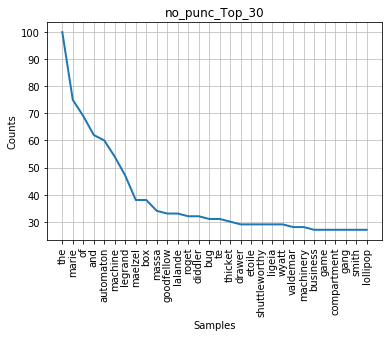

In [78]:
num_counted = 30
fdist_no_punc.plot(num_counted, title='no_punc'+'_Top_'+str(num_counted))

# fdistからstopwordを取り除いて可視化

一般的に、全文検索を行うシステムでは、「at」「of」などの前置詞や、「a」「an」「the」などの冠詞、「I」「He」「She」などの代名詞のほか、さまざまな単語をストップワードとして扱う

stopwordは、NTLKに用意されています


In [79]:
nltk.download('stopwords')
stopwords = nltk.corpus.stopwords.words('english')
stopwords

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Si\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

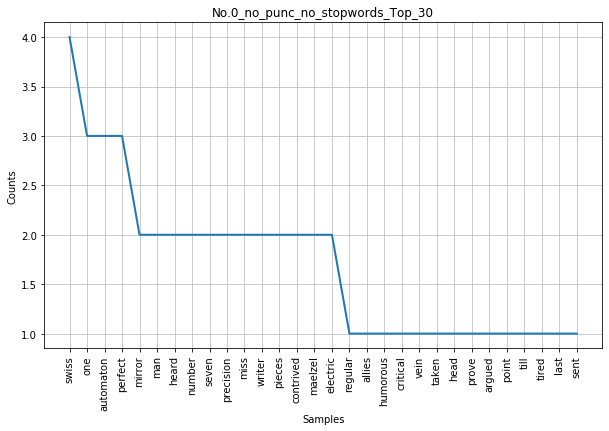

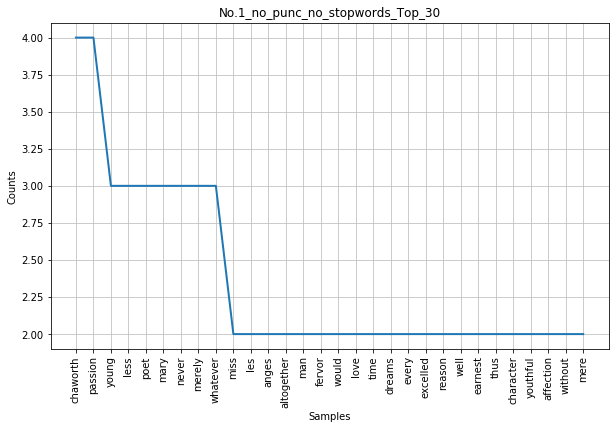

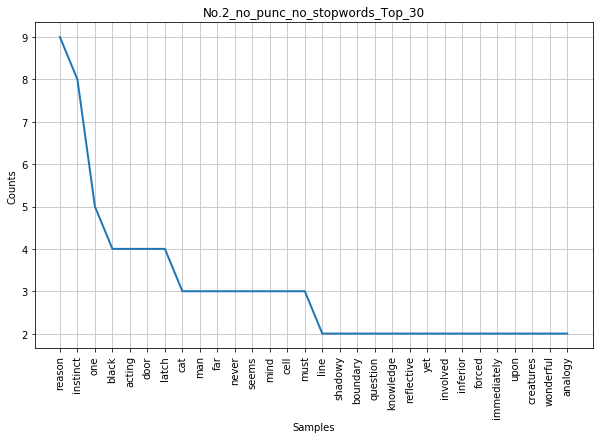

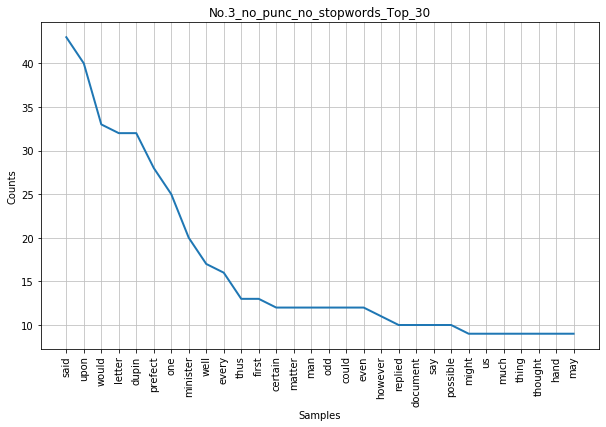

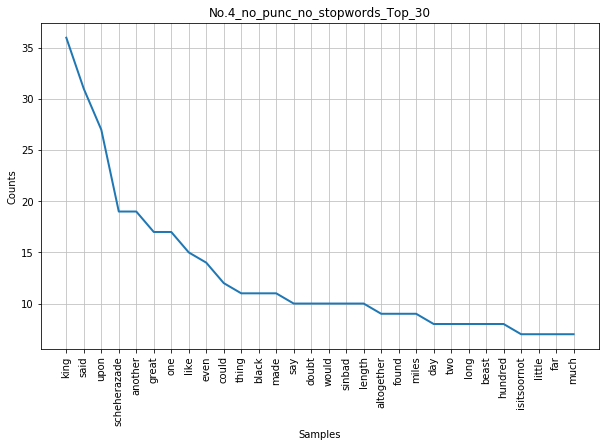

...

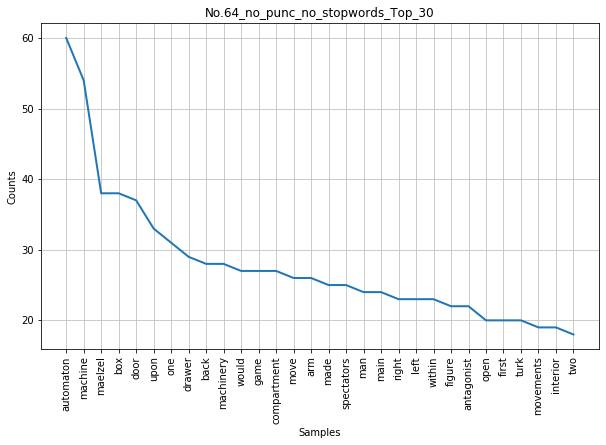

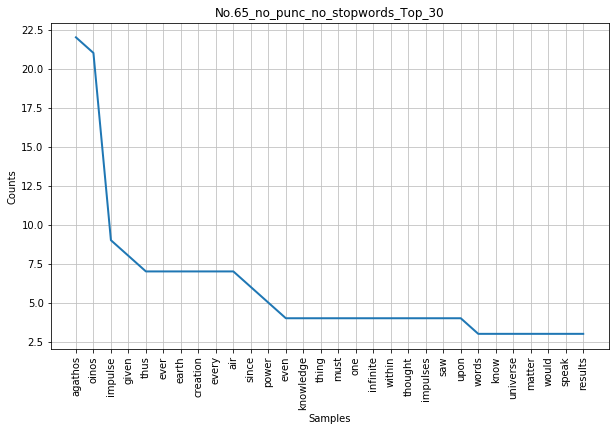

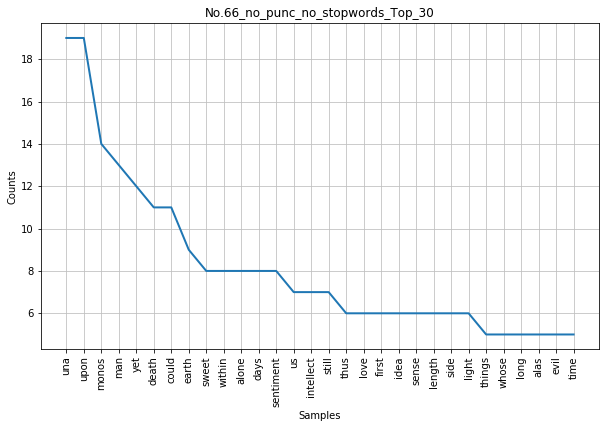

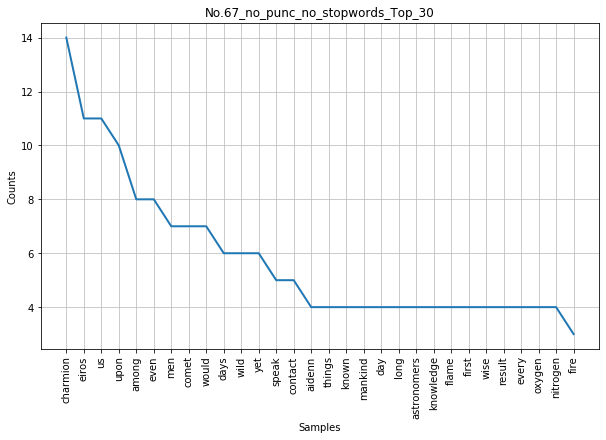

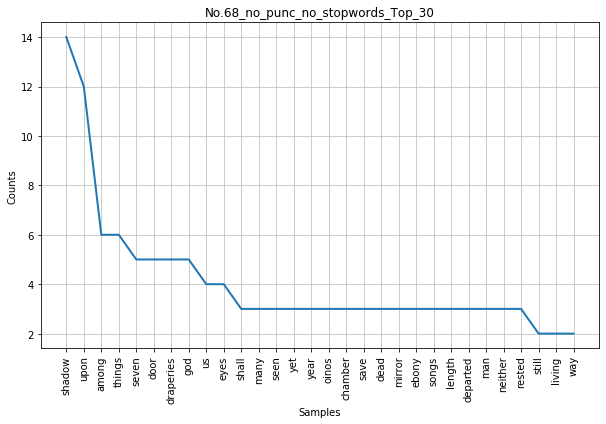

In [80]:
my_makedirs(new_dir_path_png_top)
my_makedirs(new_dir_path_png_top_no_punc)
my_makedirs(new_dir_path_png_top_no_punc_no_stopwords)

num_counted = 30
fdist_array = np.array(fdist_list)
#for i in range(len(fdist_array)):
for i in range(len(read_book_list)):
    fig = plt.figure(figsize = (10,6))
    title_ =  str(author[choice[index_i]])+ str('_')+str(type_[choice[index_j]])+"_No." +str(i)+'_no_punc_no_stopwords'+'_Top_'+str(num_counted)
    
    dict_no_punc_no_stopword = dict((word, freq) for word, freq in fdist_list[i].items() if word.lower() not in stopwords and word.isalpha() )
    fdist_no_punc_no_stopword = nltk.FreqDist(dict_no_punc_no_stopword)
    
    fdist_no_punc_no_stopword.plot(num_counted,  title="No."+str(i)+'_no_punc_no_stopwords'+'_Top_'+str(num_counted))
    filename = new_dir_path_png_top_no_punc_no_stopwords + "/" + title_ +".png"
    fig.savefig(filename)

In [81]:
#辞書に含まれるすべてのキーを取得する
for i in range(len(read_book_list)):
    dict_no_punc_no_stopword = dict((word, freq) for word, freq in fdist_list[i].items() if word.lower() not in stopwords and word.isalpha() )
    vocabulary = dict_no_punc_no_stopword.keys()
    print(i , "\n",vocabulary)

0 
 dict_keys(['swiss', 'one', 'regular', 'allies', 'mirror', 'man', 'humorous', 'critical', 'vein', 'taken', 'head', 'prove', 'automaton', 'argued', 'point', 'till', 'tired', 'last', 'sent', 'beg', 'copy', 'affidavits', 'stomachs', 'wooden', 'kindly', 'entertain', 'rolls', 'sausages', 'documents', 'coming', 'publish', 'skeleton', 'friend', 'hypothesis', 'readers', 'scarce', 'need', 'told', 'seen', 'heard', 'enter', 'number', 'seven', 'fancifully', 'costumed', 'armed', 'four', 'five', 'various', 'sizes', 'deposit', 'cushioned', 'table', 'retaining', 'hand', 'continually', 'changing', 'others', 'armory', 'putting', 'taking', 'rapidity', 'jugglers', 'ringing', 'changes', 'upon', 'delicate', 'harmony', 'precision', 'perfect', 'symphony', 'haydn', 'miss', 'lucy', 'writer', 'alludes', 'say', 'may', 'correct', 'erroneous', 'common', 'idea', 'real', 'living', 'beings', 'firmly', 'convinced', 'ingenious', 'pieces', 'mechanism', 'contrived', 'principle', 'maelzel', 'trumpeter', 'player', 'exhib

49 
 dict_keys(['metzengerstein', 'pestis', 'eram', 'vivus', 'moriens', 'tua', 'mors', 'ero', 'martin', 'luther', 'horror', 'fatality', 'stalking', 'abroad', 'ages', 'give', 'date', 'story', 'tell', 'let', 'suffice', 'say', 'period', 'speak', 'existed', 'interior', 'hungary', 'settled', 'although', 'hidden', 'belief', 'doctrines', 'metempsychosis', 'falsity', 'probability', 'nothing', 'assert', 'however', 'much', 'incredulity', 'la', 'bruyere', 'says', 'unhappiness', 'vient', 'de', 'ne', 'pouvoir', 'etre', 'points', 'hungarian', 'superstition', 'fast', 'verging', 'absurdity', 'hungarians', 'differed', 'essentially', 'eastern', 'authorities', 'example', 'soul', 'said', 'former', 'words', 'acute', 'intelligent', 'parisian', 'demeure', 'qu', 'un', 'seul', 'fois', 'dans', 'corps', 'sensible', 'au', 'reste', 'cheval', 'chien', 'homme', 'meme', 'n', 'est', 'que', 'ressemblance', 'peu', 'tangible', 'ces', 'families', 'berlifitzing', 'variance', 'centuries', 'never', 'two', 'houses', 'illustri

# 条件付き頻度分布 単語の間の関連性
(ConditionalFrequencyDistribution)を用いてbigramを扱う

In [82]:
read_book_list[0]

['THE',
 'SWISS',
 'BELL-RINGERS',
 'One',
 'of',
 'the',
 'regular',
 'allies',
 'of',
 'the',
 'Mirror',
 ',',
 'a',
 'man',
 'of',
 'a',
 'very',
 'humorous',
 'critical',
 'vein',
 ',',
 'has',
 'taken',
 'it',
 'into',
 'his',
 'head',
 'to',
 'prove',
 'the',
 'Swiss',
 'Bell-ringers',
 'to',
 'be',
 'an',
 'automaton',
 '.',
 'We',
 'have',
 'argued',
 'the',
 'point',
 'with',
 'him',
 'till',
 'we',
 'are',
 'tired',
 ',',
 'and',
 'have',
 'at',
 'last',
 'sent',
 'to',
 'beg',
 'a',
 'copy',
 'of',
 'their',
 'board-bill',
 'with',
 'affidavits',
 'that',
 'their',
 'stomachs',
 'are',
 'not',
 'wooden',
 'and',
 'do',
 'kindly',
 'entertain',
 'rolls',
 'and',
 'sausages',
 '.',
 'While',
 'these',
 'documents',
 'are',
 'coming',
 ',',
 'we',
 'publish',
 'the',
 'skeleton',
 'of',
 'our',
 'friend',
 '’',
 's',
 'hypothesis',
 ':',
 '?',
 'The',
 'Swiss',
 'Bell-ringers',
 '.',
 '?',
 'The',
 'readers',
 'of',
 'the',
 'Mirror',
 'scarce',
 'need',
 'be',
 'told',
 ',',
 

In [83]:
read_book_list

[['THE',
  'SWISS',
  'BELL-RINGERS',
  'One',
  'of',
  'the',
  'regular',
  'allies',
  'of',
  'the',
  'Mirror',
  ',',
  'a',
  'man',
  'of',
  'a',
  'very',
  'humorous',
  'critical',
  'vein',
  ',',
  'has',
  'taken',
  'it',
  'into',
  'his',
  'head',
  'to',
  'prove',
  'the',
  'Swiss',
  'Bell-ringers',
  'to',
  'be',
  'an',
  'automaton',
  '.',
  'We',
  'have',
  'argued',
  'the',
  'point',
  'with',
  'him',
  'till',
  'we',
  'are',
  'tired',
  ',',
  'and',
  'have',
  'at',
  'last',
  'sent',
  'to',
  'beg',
  'a',
  'copy',
  'of',
  'their',
  'board-bill',
  'with',
  'affidavits',
  'that',
  'their',
  'stomachs',
  'are',
  'not',
  'wooden',
  'and',
  'do',
  'kindly',
  'entertain',
  'rolls',
  'and',
  'sausages',
  '.',
  'While',
  'these',
  'documents',
  'are',
  'coming',
  ',',
  'we',
  'publish',
  'the',
  'skeleton',
  'of',
  'our',
  'friend',
  '’',
  's',
  'hypothesis',
  ':',
  '?',
  'The',
  'Swiss',
  'Bell-ringers',
  '

In [84]:
#単語数（ただし，大文字・小文字を区別している）
##異なり語数（ただし，大文字・小文字を区別している）
for i in range(len(read_book_list)):
    tokens = read_book_list[i]
    print(i,"\n",tokens, len(tokens), len(set(tokens)))

0 
 ['THE', 'SWISS', 'BELL-RINGERS', 'One', 'of', 'the', 'regular', 'allies', 'of', 'the', 'Mirror', ',', 'a', 'man', 'of', 'a', 'very', 'humorous', 'critical', 'vein', ',', 'has', 'taken', 'it', 'into', 'his', 'head', 'to', 'prove', 'the', 'Swiss', 'Bell-ringers', 'to', 'be', 'an', 'automaton', '.', 'We', 'have', 'argued', 'the', 'point', 'with', 'him', 'till', 'we', 'are', 'tired', ',', 'and', 'have', 'at', 'last', 'sent', 'to', 'beg', 'a', 'copy', 'of', 'their', 'board-bill', 'with', 'affidavits', 'that', 'their', 'stomachs', 'are', 'not', 'wooden', 'and', 'do', 'kindly', 'entertain', 'rolls', 'and', 'sausages', '.', 'While', 'these', 'documents', 'are', 'coming', ',', 'we', 'publish', 'the', 'skeleton', 'of', 'our', 'friend', '’', 's', 'hypothesis', ':', '?', 'The', 'Swiss', 'Bell-ringers', '.', '?', 'The', 'readers', 'of', 'the', 'Mirror', 'scarce', 'need', 'be', 'told', ',', '?', 'as', 'most', 'of', 'them', 'have', 'seen', 'and', 'heard', 'for', 'themselves', ',', '?', 'that', 't

In [85]:
#全ての単語を小文字化した上で，異なり語数を調べる。
for i in range(len(read_book_list)):
    tokens = read_book_list[i]
    tokens_l = [w.lower() for w in tokens] 
    print(len(set(tokens_l)))


247
365
388
1808
1645
1685
954
1109
1253
2060
403
859
816
892
782
1481
1649
1737
1857
1417
2315
655
1136
840
2825
976
2785
3213
1477
1413
534
940
623
759
1153
1306
1234
1601
2216
1804
1768
767
1378
2265
1627
804
1070
673
892
1216
1791
1936
1233
1191
1130
1278
1265
1655
625
1324
1596
1182
1189
1182
1719
513
1177
777
440


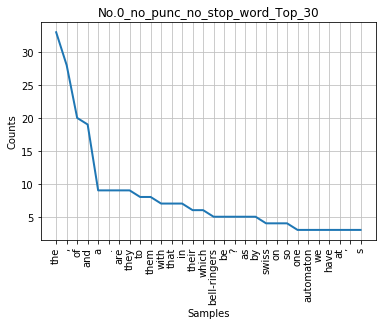

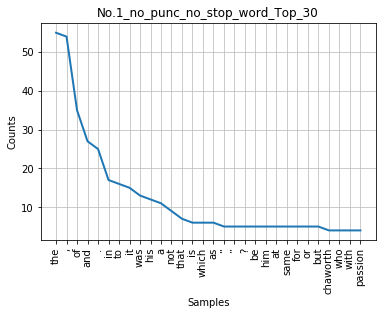

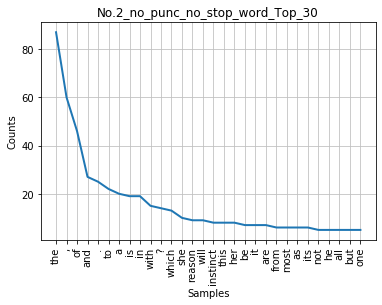

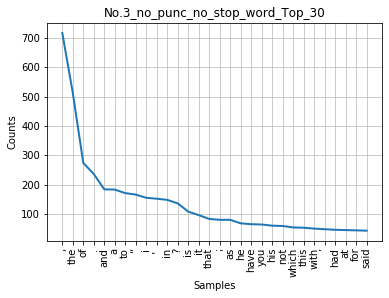

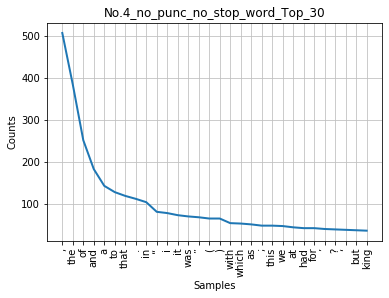

...

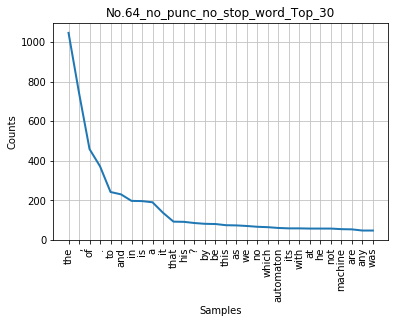

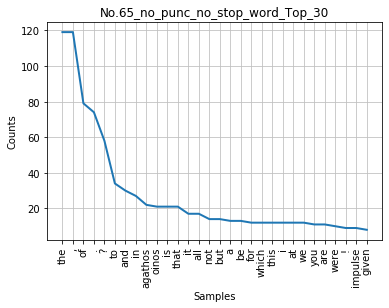

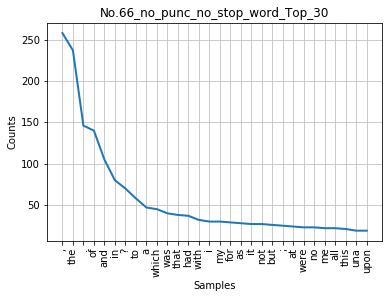

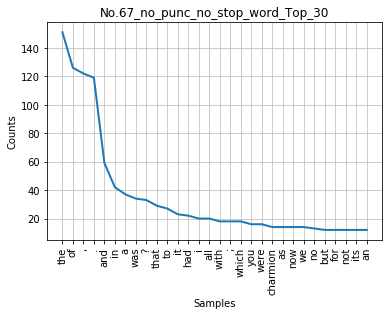

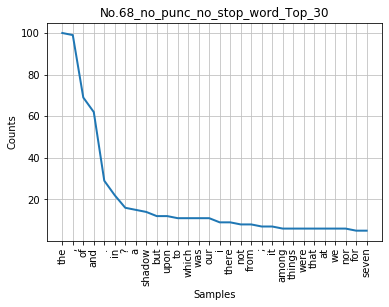

In [86]:
num_counted = 30
for i in range(len(read_book_list)):
    tokens = read_book_list[i]
    tokens_l = [w.lower() for w in tokens] 
    
    fd = nltk.FreqDist(tokens_l)
    fd.plot(30, title = "No."+str(i)+'_no_punc_no_stop_word'+'_Top_'+str(num_counted))
    
    
    
    

In [87]:
fdist_list[0]

FreqDist({'the': 33, ',': 28, 'of': 20, 'and': 19, 'a': 9, '.': 9, 'are': 9, 'they': 9, 'to': 8, 'them': 8, ...})

In [88]:
#バイグラムを作る。
#バイグラムの頻度分布を得る。
#符号を先に除去！！
#stopwords

fd_list = []
for i in range(len(read_book_list)):
    tokens = read_book_list[i]  
    tokens_l = [w.lower() for w in tokens] 
    #バイグラムを作る。
    bigrams = nltk.bigrams(tokens_l)
    #バイグラムの頻度分布を得る。
    fd = nltk.FreqDist(bigrams)
    fd_list.append(fd)
    #print(i , "\n", fd_list[i].items(),"\n")  
    ##頻度付きで共起の結果を得る。（上位10個）
    print(i , "\n", fd.most_common(10))
   
    
    

0 
 [(('of', 'the'), 8), ((',', 'and'), 7), (('the', 'swiss'), 4), (('swiss', 'bell-ringers'), 4), (('’', 's'), 3), ((',', 'which'), 3), (('which', 'they'), 3), (('they', 'are'), 3), (('that', 'they'), 3), (('on', 'the'), 3)]
1 
 [(('of', 'the'), 13), (('of', 'his'), 8), (('it', 'was'), 7), (('the', 'same'), 5), ((',', 'and'), 5), (('.', 'the'), 4), (('.', 'it'), 4), ((',', 'in'), 4), ((',', 'or'), 4), ((',', 'it'), 4)]
2 
 [(('of', 'the'), 16), ((',', 'and'), 11), (('in', 'the'), 8), (('.', 'the'), 6), (('with', 'the'), 6), (('to', 'the'), 5), ((',', 'the'), 5), (('the', 'most'), 4), (('?', 'and'), 4), ((',', 'with'), 4)]
3 
 [((',', 'and'), 92), (('of', 'the'), 90), (('”', '“'), 81), ((',', '”'), 53), (('.', '“'), 42), (('in', 'the'), 39), ((',', 'i'), 33), (('”', 'said'), 31), ((',', '“'), 30), ((',', 'in'), 29)]
4 
 [((',', 'and'), 75), (('of', 'the'), 61), (('the', 'king'), 36), (('.', '“'), 36), (('“', '‘'), 32), ((',', 'i'), 30), (('in', 'the'), 29), (('”', 'said'), 25), (('’', 

62 
 [(('...', '...'), 69), ((',', 'and'), 60), (('.', 'i'), 26), (('in', 'the'), 26), (('of', 'the'), 25), ((',', 'i'), 20), (('i', 'was'), 18), ((',', 'or'), 18), (('.', 'the'), 17), ((',', 'but'), 15)]
63 
 [(('of', 'the'), 51), (('in', 'the'), 41), (('to', 'the'), 25), ((',', 'the'), 20), ((',', 'and'), 17), (('of', 'his'), 17), ((',', 'or'), 17), ((',', 'in'), 14), (('.', 'the'), 13), (('the', 'most'), 12)]
64 
 [(('of', 'the'), 247), ((',', 'and'), 141), (('.', 'the'), 79), (('in', 'the'), 66), (('the', 'automaton'), 59), ((',', 'the'), 56), (('to', 'the'), 44), (('the', 'box'), 36), (('and', 'the'), 36), (('the', 'machine'), 27)]
65 
 [(('of', 'the'), 30), (('oinos', '.'), 16), (('agathos', '.'), 16), (('.', 'oinos'), 11), ((',', 'and'), 9), (('.', 'agathos'), 9), (('?', 'and'), 8), (('agathos', ','), 6), (('.', 'but'), 6), (('of', 'all'), 6)]
66 
 [(('of', 'the'), 45), ((',', 'and'), 38), (('in', 'the'), 26), (('.', 'the'), 23), (('to', 'the'), 13), (('.', 'and'), 11), ((',', '

In [89]:
prep_list, prep_list[5]

(['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then'], 'upon')

0 
 ['the', 'a', 'their', 'our', 'them', 'seven', 'various', 'jugglers', 'haydn', 'mechanism', 'maelzel'] dict_items([('the', 8), ('a', 1), ('their', 1), ('our', 2), ('them', 2), ('seven', 1), ('various', 1), ('jugglers', 1), ('haydn', 1), ('mechanism', 1), ('maelzel', 1)])


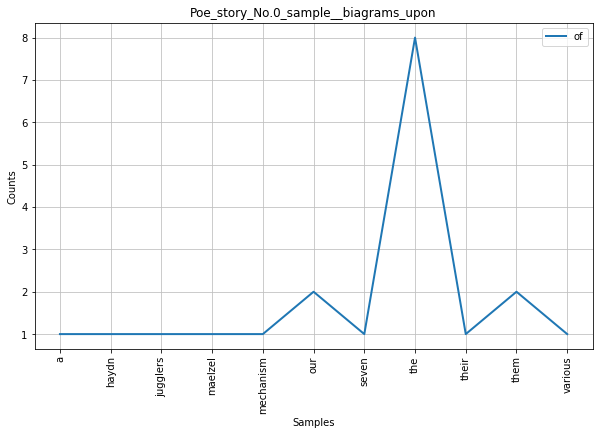

1 
 ['the', 'a', 'him', 'heaven', '“', 'almost', 'his', 'this', 'mary', 'hourly', 'no', 'warmth', 'soul-passion', 'romance', 'fire'] dict_items([('the', 13), ('a', 2), ('him', 1), ('heaven', 1), ('“', 1), ('almost', 1), ('his', 8), ('this', 1), ('mary', 1), ('hourly', 1), ('no', 1), ('warmth', 1), ('soul-passion', 1), ('romance', 1), ('fire', 1)])


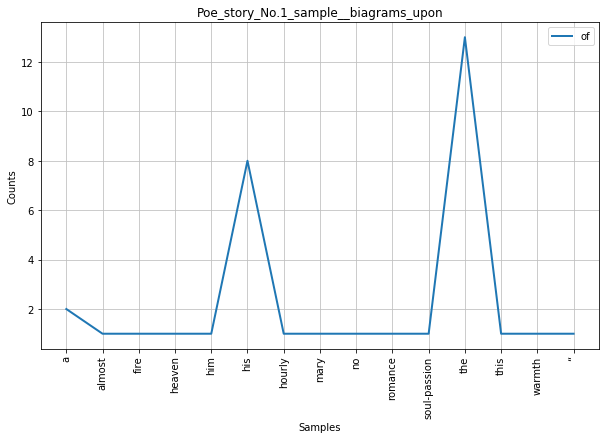

2 
 ['the', 'man', 'knowledge', 'decrying', 'all', 'many', 'spiders', 'some', 'this', 'instinct', 'continents', 'building', 'purpose', 'prophecy', 'its', 'strength', 'analytical', 'sides', 'action', 'one', 'them', 'a', 'opening', 'supposing', 'reason'] dict_items([('the', 16), ('man', 3), ('knowledge', 1), ('decrying', 1), ('all', 2), ('many', 1), ('spiders', 1), ('some', 1), ('this', 2), ('instinct', 1), ('continents', 1), ('building', 1), ('purpose', 1), ('prophecy', 1), ('its', 1), ('strength', 1), ('analytical', 1), ('sides', 1), ('action', 2), ('one', 1), ('them', 1), ('a', 2), ('opening', 1), ('supposing', 1), ('reason', 1)])


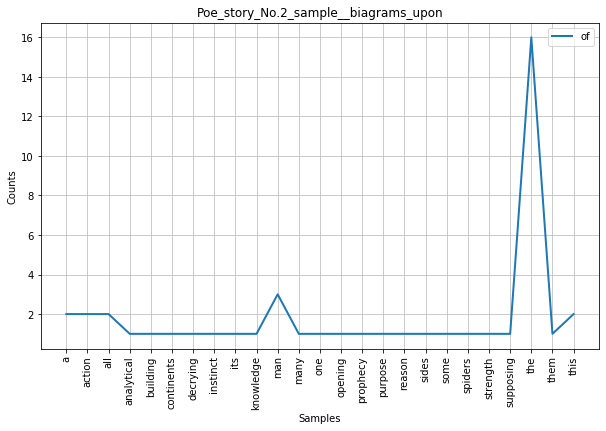

3 
 ['18-', 'meditation', 'smoke', 'the', 'marie', 'a', 'our', 'lighting', 'my', 'trouble', 'your', 'calling', '“', 'that', 'it', 'such', 'me', 'certain', 'diplomacy', 'most', 'course', 'no', 'reclaiming', 'searching', 'which', 'affairs', 'those', 'being', 'nearly', 'course.', 'each', 'this', 'bulk', 'space', 'furniture', 'bedposts', 'cotton', 'every', 'recent', 'gimlet-dust', 'trouble.', 'some', 'more', 'his', 'abernethy', 'spunging', 'an', 'joy', 'their', 'highly', 'procrustean', 'age', '‘', 'these', 'another', 'guessing', 'cunning', 'reasoning', 'all', 'ingenuity', 'principle', 'practice', 'd', 'action', 'principles', 'search', 'notions', 'thought', 'concealment', 'importance', 'magnitude', 'its', 'centuries', 'any', 'honorablemen.', 'paris', 'form', 'what', 'general', 'relation', 'motive', 'error', 'memory', 'equal', 'experiment', 'giving', 'policial', 'choice', 'truth', 'inferior', 'hesitation', 'attention', 'puzzles', 'town', 'best', 'not', 'green', 'ennui', 'pasteboard', 'corres

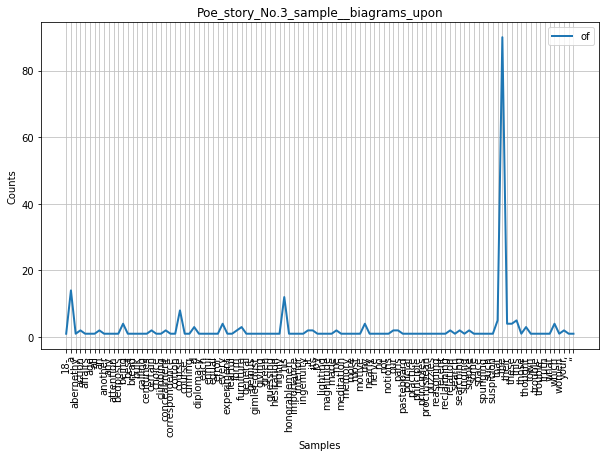

4 
 ['scheherazade', 'some', 'simeon', 'the', 'american', 'what', 'his', 'devout', 'all', 'her', 'giving', 'easy', 'a', 'course', 'things', 'hearing', 'no', 'this', 'it', 'talk', 'eden', 'correcting', 'great', 'sinbad', 'their', 'misconduct', 'gratification', 'tranquillity', 'visiting', 'my', 'such', 'any', 'perceiving', 'its', 'foam', 'fire', 'three', 'audience', 'ordinary', 'which', 'six', 'eyes', 'an', 'these', 'solid', 'animals', 'men', 'servitude', 'smoke', 'him', 'monster', 'creatures', 'sulphur', 'inflicting', 'wrath', 'teaching', 'seeing', 'miles', 'little', 'thirty', 'far', 'gems', 'towers', 'melted', 'ashes', 'tall', 'unspeakable', 'amber', 'horror', 'monstrous', 'them', 'death', 'other', 'living', 'mankind', 'appointed', 'geometry', 'two', 'big', 'years', 'fowls', 'millions', 'fowl.', 'another', 'caliphs', 'belly', 'frightful', 'frightening', 'rage', 'immense', 'imagination', 'very', 'corn', 'so', 'most', 'flesh', 'mighty', 'brass', 'like', 'fifty', 'lead', 'prodigious', 'ne

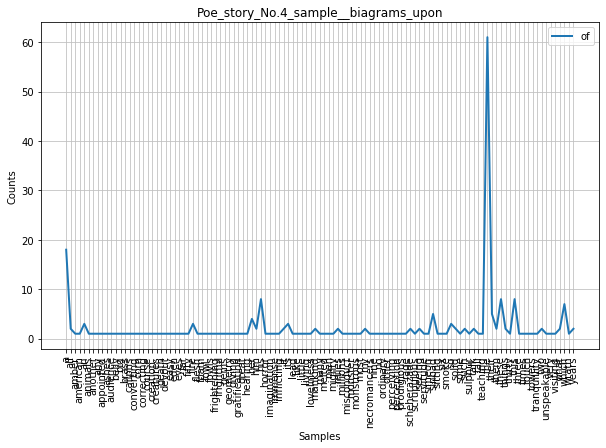

5 
 ['god', 'his', 'democritus', 'the', 'my', '?', 'deadly', 'black', 'crags', 'its', 'that', 'latitude', 'nordland', 'lofoden', 'vapor', 'ocean', 'horridly', 'gloom', 'some', 'surge', 'smaller', 'dark', 'sight', 'water', 'foam', 'helseggen', 'a', 'buffaloes', 'another', 'more', 'gleaming', 'this', 'niagara', 'nervous', 'moskoe', 'jonas', 'any', 'view', 'splitting', 'such', 'tranquility', 'an', 'it', 'firs', 'craggy', 'sexagesima', 'belief', 'which', 'waves', 'rocks', 'all', 'bothnia', 'about', 'fishing', 'going', 'desperate', 'life', 'labor', '.', 'everything', 'flimen', 'great', 'three', 'july', 'us', 'danger', 'proposing', 'things', 'precaution', 'ascertaining', 'hope', 'clear', 'shrill', 'many', 'surf', 'course', 'so', 'mind', 'action', 'these', 'falling', 'awe', 'golden', 'terrific', 'liquid', 'vessels', 'building', 'trees', 'house', 'their', 'reflection', 'buoyant', 'being', 'splinters', 'them', 'those', 'equal', 'descent', 'no'] dict_items([('god', 2), ('his', 6), ('democritus',

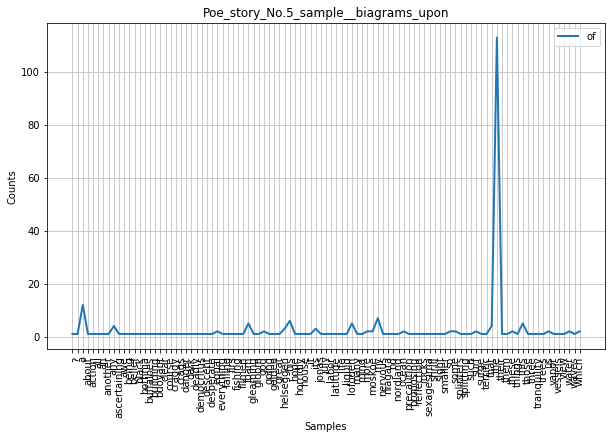

6 
 ['the', 'course', 'view', 'von', 'a', 'interest', 'this', 'sir', 'his', 'brunswick', 'common', 'science', 'their', 'inquiry', 'azote', 'my', 'appearing', 'crude', 'doubt', 'service', 'houses', 'intrinsic', 'so', 'him', 'presburg', 'new', 'automaton-chess-player', 'having', 'aladdin', 'gutsmuth', 'that', 'narrow', 'great', 'seven', 'which', 'duplicate', 'these', 'lead', 'fusion', 'antimony', 'ante-chamber', 'no', 'them', 'old', 'brass', 'its', 'pocketing', 'arago', 'bismuth', 'gold', 'going', 'it', 'those', 'far', 'california', 'two', 'silver'] dict_items([('the', 23), ('course', 5), ('view', 1), ('von', 5), ('a', 3), ('interest', 1), ('this', 5), ('sir', 2), ('his', 5), ('brunswick', 1), ('common', 1), ('science', 1), ('their', 1), ('inquiry', 1), ('azote', 1), ('my', 1), ('appearing', 1), ('crude', 1), ('doubt', 1), ('service', 1), ('houses', 1), ('intrinsic', 1), ('so', 1), ('him', 1), ('presburg', 2), ('new', 1), ('automaton-chess-player', 1), ('having', 1), ('aladdin', 1), ('gu

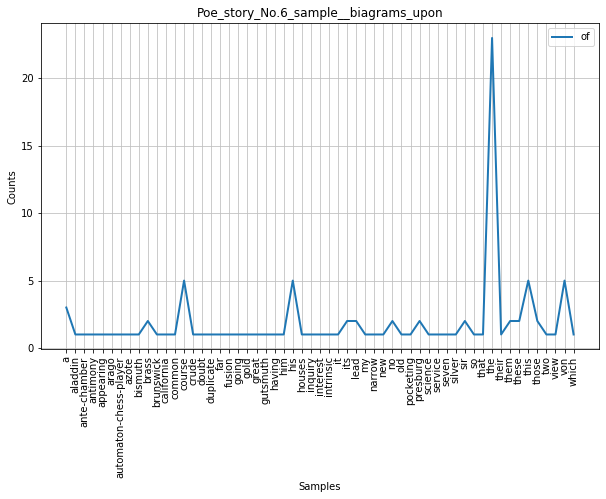

7 
 ['m.', 'course', 'all', 'many', 'a', 'disbelief', 'mesmerism', 'experiments', 'death', 'its', 'my', 'the', 'issachar', '“', 'his', 'john', 'sympathy', 'that', 'exact', 'physical', 'vitality', 'purulent', 'comparatively', 'it', 'aneurism', 'both', 'this', 'sudden', 'eight', 'mesmerizing', 'half', 'an', 'uneasy', 'sleep-waking', 'mesmeric', 'succeeding', 'conversation', 'dr', 'each', 'their', 'nothing', 'humanity', 'touch', 'distinct', 'even', 'respiration', 'awakening', 'last', 'nearly', 'what', 'relieving', 'revival', 'loathsome', 'detestable'] dict_items([('m.', 6), ('course', 3), ('all', 2), ('many', 1), ('a', 9), ('disbelief', 1), ('mesmerism', 1), ('experiments', 1), ('death', 2), ('its', 3), ('my', 5), ('the', 32), ('issachar', 1), ('“', 4), ('his', 7), ('john', 1), ('sympathy', 1), ('that', 1), ('exact', 1), ('physical', 1), ('vitality', 2), ('purulent', 1), ('comparatively', 1), ('it', 1), ('aneurism', 1), ('both', 2), ('this', 5), ('sudden', 1), ('eight', 1), ('mesmerizing'

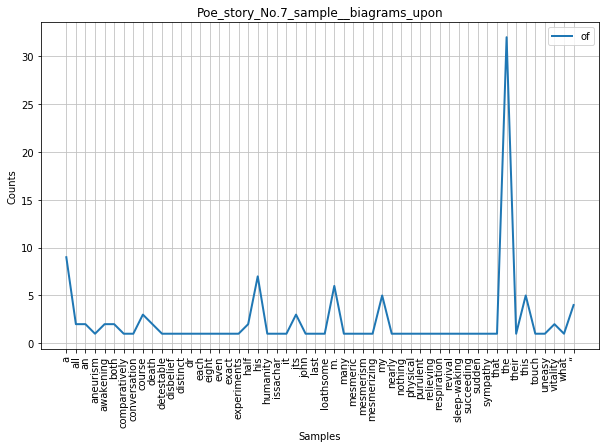

8 
 ['mere', 'very', 'my', 'heart', 'animals', 'pets', 'character', 'pleasure', 'explaining', 'the', 'a', 'him', 'procuring', 'his', 'others', 'course', 'maltreating', 'its', 'horror', 'remorse', 'which', 'perverseness', 'this', 'man', 'our', 'offence', 'fire', 'seeking', 'cause', 'facts', 'it', 'whom', 'arousing', 'other', 'somewhat', 'more', 'one', 'gin', 'rum', 'white', 'what', 'disgust', 'hatred', 'shame', 'cruelty', 'feeling', 'many', 'physical', 'outline', 'an', 'crime', 'agony', 'death', 'insufferable', 'rest', 'unutterable', 'torments', 'thoughts', 'all', 'sufferers', 'concealing', 'being', 'cutting', 'these', 'having', 'so', 'relief', 'murder', 'concealment', 'triumph', 'bravado', 'hell', 'terror', 'awe'] dict_items([('mere', 3), ('very', 1), ('my', 23), ('heart', 1), ('animals', 1), ('pets', 1), ('character', 1), ('pleasure', 1), ('explaining', 1), ('the', 50), ('a', 11), ('him', 1), ('procuring', 1), ('his', 2), ('others', 1), ('course', 3), ('maltreating', 1), ('its', 3), (

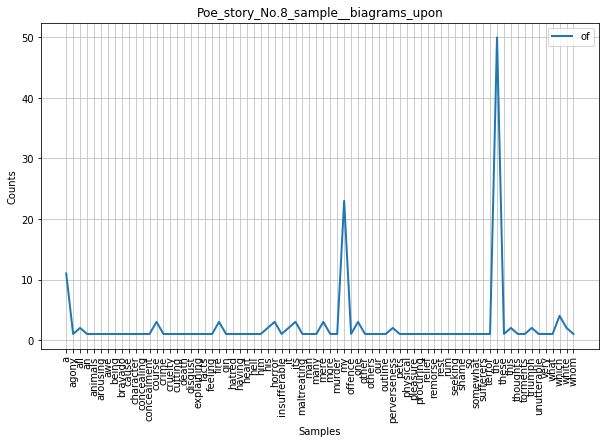

9 
 ['the', 'usher', 'a', 'country', 'insufferable', 'that', 'decayed', 'soul', 'thought', 'very', 'thus', 'this', 'gloom', 'some', 'my', 'no', 'nervous', 'acute', 'an', 'attempting', 'his', 'mind', 'temperament', 'exalted', 'late', 'munificent', 'musical', 'descent', 'centuries', 'collateral', 'looking', 'all', 'heaven', 'ages', 'parts', 'old', 'extensive', 'instability', 'stealthy', 'which', 'low', 'encrimsoned', 'sorrow', 'stern', 'pity', 'awe', 'complexion', 'nostril', 'prominence', 'moral', 'these', 'change', 'simple', 'feeble', 'certain', 'energetic', 'opium', 'unnatural', 'terror', 'any', 'danger', 'long', 'stupor', 'her', 'von', 'merely', 'intolerable', 'fuseli', 'abstraction', 'its', 'light', 'intense', 'stringed', 'one', 'our', 'echoes', 'surpassing', 'their', 'inorganization', 'collocation', 'landaff', 'phantasm', 'gresset', 'machiavelli', 'swedenborg', 'nicholas', 'robert', 'jean', 'de', 'tieck', 'campanella', 'preserving', 'admission', 'deposit', 'massive', 'horror', 'yout

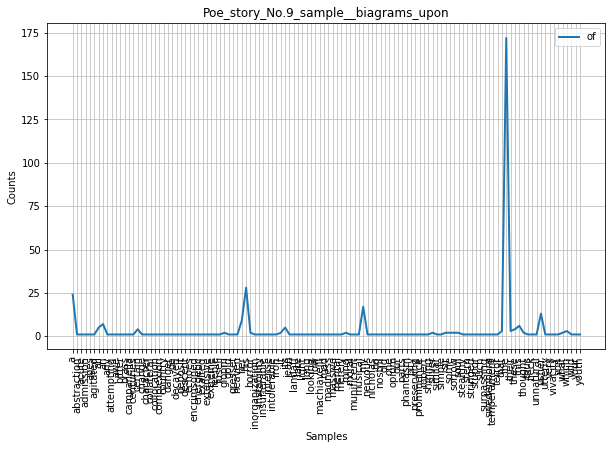

10 
 ['which', 'the', 'gigantic', 'subterrene', 'their', 'water-lilies', 'old', 'his', 'a', 'sorrow', 'tumult', 'silence', 'sound', 'all'] dict_items([('which', 1), ('the', 41), ('gigantic', 1), ('subterrene', 1), ('their', 1), ('water-lilies', 1), ('old', 2), ('his', 3), ('a', 1), ('sorrow', 1), ('tumult', 1), ('silence', 1), ('sound', 1), ('all', 1)])


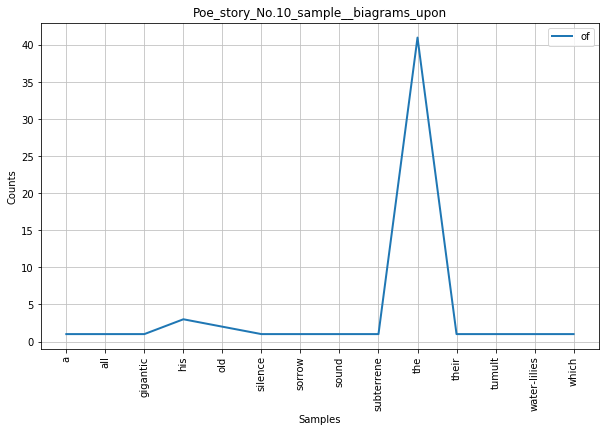

11 
 ['the', 'blood', 'his', 'half', 'one', 'iron', 'ingress', 'despair', 'frenzy', 'itself', 'pleasure', 'each', 'stained', 'golden', 'any', 'chambers', 'fire', 'gaudy', 'those', 'ebony', 'so', 'an', 'sixty', 'these', 'mere', 'this', 'what', 'that', 'dreams', 'their', 'life', 'midnight', 'all', 'thought', 'time', 'a', 'no', 'disapprobation', 'terror', 'horror', 'disgust', 'phantasms', 'even', 'which', 'prince', 'pale'] dict_items([('the', 64), ('blood', 1), ('his', 7), ('half', 1), ('one', 1), ('iron', 1), ('ingress', 1), ('despair', 2), ('frenzy', 1), ('itself', 1), ('pleasure', 1), ('each', 1), ('stained', 1), ('golden', 1), ('any', 1), ('chambers', 1), ('fire', 1), ('gaudy', 1), ('those', 1), ('ebony', 2), ('so', 1), ('an', 1), ('sixty', 1), ('these', 1), ('mere', 1), ('this', 3), ('what', 1), ('that', 1), ('dreams', 1), ('their', 2), ('life', 1), ('midnight', 1), ('all', 1), ('thought', 1), ('time', 1), ('a', 3), ('no', 1), ('disapprobation', 1), ('terror', 2), ('horror', 1), ('di

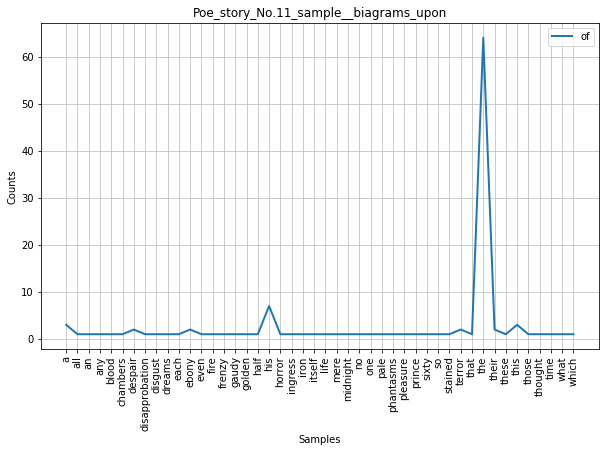

12 
 ['amontillado', 'fortunato', 'my', 'risk', 'his', 'old', 'the', 'what', 'losing', 'black', 'rooms', 'intoxication', 'a', 'alarming', 'this', 'its', 'piled', 'moisture', 'de', 'low', 'paris', 'some', 'their', 'solid', 'these', 'bones', 'which', 'building', 'loud', 'an', 'him', 'god'] dict_items([('amontillado', 1), ('fortunato', 2), ('my', 7), ('risk', 1), ('his', 1), ('old', 1), ('the', 30), ('what', 1), ('losing', 1), ('black', 1), ('rooms', 1), ('intoxication', 1), ('a', 5), ('alarming', 1), ('this', 3), ('its', 1), ('piled', 1), ('moisture', 1), ('de', 1), ('low', 1), ('paris', 1), ('some', 1), ('their', 1), ('solid', 1), ('these', 1), ('bones', 2), ('which', 1), ('building', 1), ('loud', 1), ('an', 1), ('him', 1), ('god', 2)])


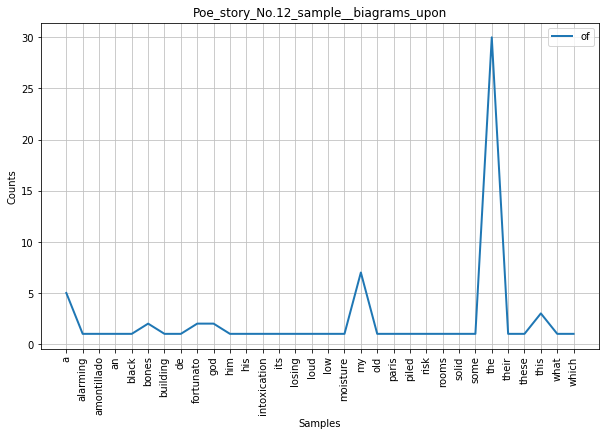

13 
 ['the', 'belief', 'faith', 'it', 'its', 'this', 'humanity', 'jehovah', 'these', 'mind', 'phrenology', 'alimentiveness', 'amativeness', 'human', 'their', 'man', 'his', 'what', 'creation', 'a', 'any', 'analysis', 'that', 'self-defence', 'combativeness', 'him', 'all', 'our', 'whose', 'anxiety', 'unnamable', 'which', 'death', 'good', 'detection', 'reading', 'my', 'god.', 'satisfaction', 'time', 'some', 'murmuring', 'petulance', 'perversity', 'thought', 'suffocation', 'interruption'] dict_items([('the', 30), ('belief', 1), ('faith', 1), ('it', 2), ('its', 2), ('this', 3), ('humanity', 1), ('jehovah', 1), ('these', 1), ('mind', 1), ('phrenology', 2), ('alimentiveness', 1), ('amativeness', 1), ('human', 2), ('their', 1), ('man', 1), ('his', 1), ('what', 3), ('creation', 1), ('a', 9), ('any', 1), ('analysis', 1), ('that', 2), ('self-defence', 1), ('combativeness', 1), ('him', 3), ('all', 2), ('our', 3), ('whose', 1), ('anxiety', 1), ('unnamable', 1), ('which', 2), ('death', 1), ('good', 1

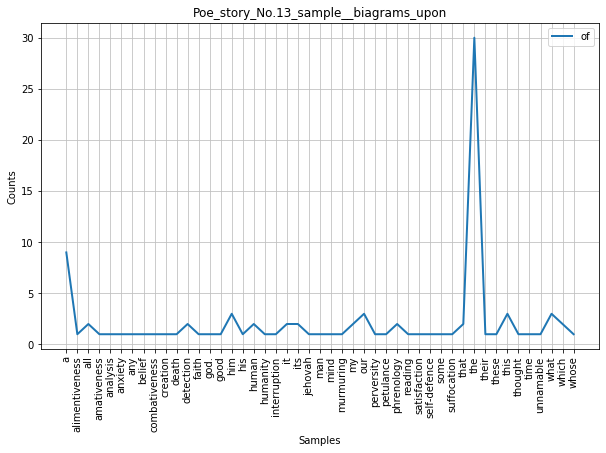

14 
 ['the', 'their', 'complete', 'point', 'music', 'fallen', 'seclusion', 'natural', 'god', 'human', 'life', 'one', 'all', 'a', 'ourselves', 'bodies', 'those', 'matter', 'deity', 'more', 'what', 'many', 'zimmerman', 'my', 'mountain', 'an', 'phantasm', 'garden', 'eastern', 'innumerable', 'mortal', 'its', 'graves', 'joy', 'light', 'her', 'care', 'elastic'] dict_items([('the', 34), ('their', 2), ('complete', 1), ('point', 1), ('music', 1), ('fallen', 1), ('seclusion', 1), ('natural', 1), ('god', 1), ('human', 1), ('life', 2), ('one', 2), ('all', 1), ('a', 1), ('ourselves', 1), ('bodies', 1), ('those', 2), ('matter', 3), ('deity', 1), ('more', 1), ('what', 1), ('many', 1), ('zimmerman', 1), ('my', 1), ('mountain', 1), ('an', 2), ('phantasm', 1), ('garden', 1), ('eastern', 1), ('innumerable', 1), ('mortal', 1), ('its', 1), ('graves', 1), ('joy', 1), ('light', 1), ('her', 2), ('care', 1), ('elastic', 1)])


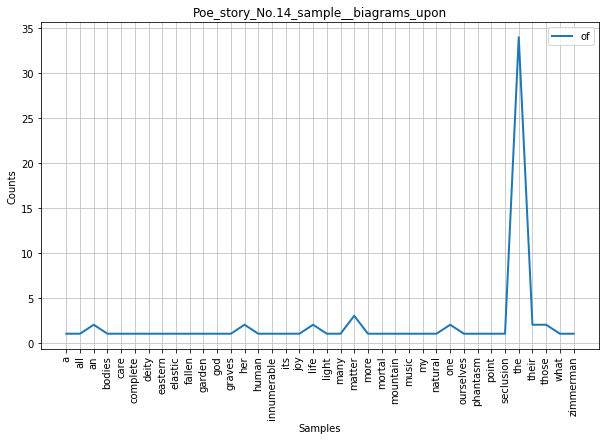

15 
 ['his', 'chichester', 'thine', 'magnificent', 'dim', 'the', 'whose', 'her', 'life', 'whom', 'that', 'sighs', 'woman', 'romance', 'unusual', 'recovery', 'its', 'all', 'heart', 'marble', 'diamonds', 'very', 'mentoni', 'a', 'europe', 'ungovernable', 'those', 'my', 'our', 'great', 'these', 'intense', 'more', 'curling', 'their', 'recalling', 'each', 'gloomy', 'mosaics', 'ridiculous', 'any', 'exhaustion', 'what', 'nationality', 'untutored', 'low', 'emerald', 'crimson-tinted', 'molten', 'natural', 'rich', 'chili', 'so', 'conception', 'voice', 'cordiality', 'ravisius', 'characters', 'scarcely', 'socle', 'peaaema', 'laughter', 'fashionable', 'splendor', 'virtu', 'this', 'it', 'spirit', 'dalliance', 'merriment', 'persepolis', 'levity', 'little', 'trepidation', 'nervous', 'manner', 'apparent', 'novel', 'date', 'course', 'melancholy', 'chapman', 'richly', 'dreams', 'venice', 'architectural', 'ionia', 'egypt', 'gold', 'place', 'time', 'folly', 'real'] dict_items([('his', 7), ('chichester', 2),

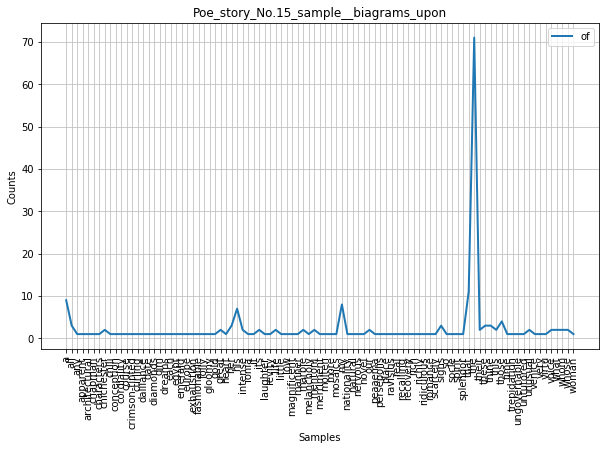

16 
 ['a', 'the', 'death', 'distinct', 'revolution', 'their', 'firmness', 'immoveable', 'stern', 'human', 'what', 'my', 'delirious', 'charity', 'flame', 'darkness', 'consciousness', 'it', 'slumbers', 'some', 'mental', 'physical', 'seeming', 'success', 'memory', 'tall', 'that', 'sudden', 'its', 'existence', 'soul', 'all', 'endeavor', 'eternal', 'time', 'these', 'suspense', 'catching', 'light', 'fates', 'toledo', 'starvation', 'more', 'stone', 'ascertaining', 'coarse', 'forcing', 'departure', 'solid', 'decayed', 'course', 'torture', 'which', 'mind', 'cowards', 'life', 'spirit', 'water', 'vain', 'less', 'serge', 'great', 'total', 'this', 'fiends', 'menace', 'low', 'wood', 'much', 'glittering', 'brass', 'hell', 'accidents', 'such', 'horror', 'utter', 'joy', 'hope', 'iron', 'attention', 'cloth', 'despair', 'deliverance', 'effect', 'movement', 'pain', 'escape', 'agony', 'heated', 'crimson', 'blood', 'men', 'terrors', 'foothold', 'many', 'general'] dict_items([('a', 21), ('the', 99), ('death'

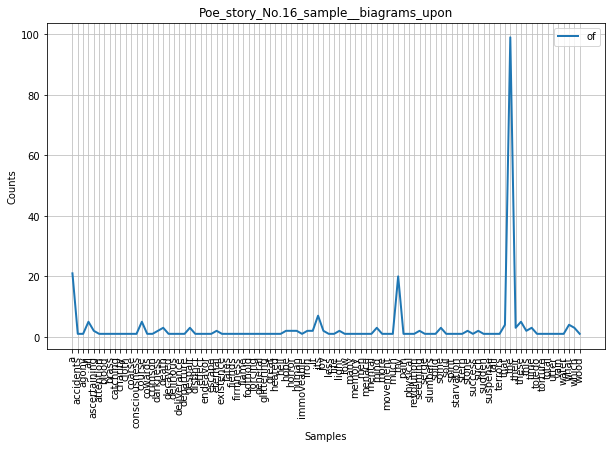

17 
 ['which', 'legitimate', 'truth', '“', 'the', 'st.', 'human', 'these', 'disaster', 'agony', 'mere', 'all', 'vitality', 'such', 'suspended', 'medical', 'very', 'some', 'my', 'baltimore', 'one', 'eminence', 'congress', 'her', 'death', 'what', 'this', 'a', 'his', 'oil', 'living', 'illustrious', 'wealth', 'great', 'paris', 'birth', 'disinterring', 'its', 'detaching', 'love', 'years', 'leipsic', 'high', 'artillery', 'gigantic', 'robust', 'relief', 'stupor', 'life', 'ultimate', 'those', 'restoring', 'london', 'converse', 'typhus', 'body-snatchers', 'life-likeness', 'testing', 'mind', 'ether', 'everything', 'suspicions', 'bodily', 'mental', 'dear', 'our', 'appalling', 'nothing', 'degree', 'exaggerated', 'warmth', 'absolute', 'decay', 'hemi-syncope', 'moral', 'worms', 'tombs', 'premature', 'meditation', 'thought', 'phantasms', 'gloom', 'more', 'him', 'woe', 'despairing', 'me', 'elaborate', 'being', 'air', 'springs', 'man', 'existence', 'dull', 'pleasurable', 'an', 'wretchedness', 'not', 'm

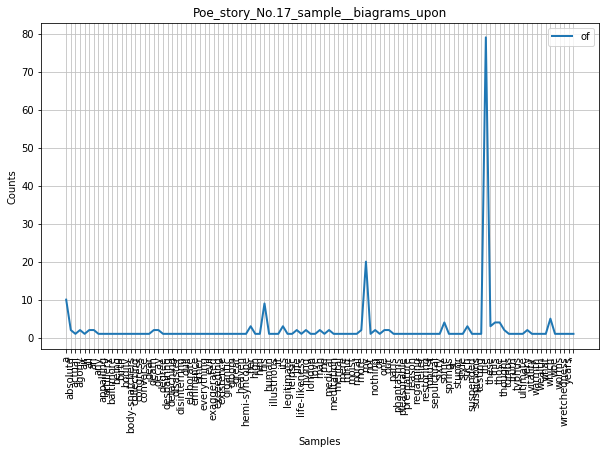

18 
 ['arnheim', 'heaven', 'light', 'dew', 'prosperity', 'whom', 'foreshadowing', 'turgot', 'exemplifying', 'the', 'ellison', 'bliss', 'his', 'a', 'humanity', 'mankind', 'content', 'all', 'observation', 'preconcert', 'experience', 'unhappiness', 'pre-eminent', 'my', 'free', 'woman', 'realization', 'ambition', 'unceasing', 'attainable', 'this', 'good', 'that', 'knowledge', 'women', 'those', 'fate', 'age', 'suffering', 'investment', 'blood', 'four', 'dollars', 'course', 'its', 'any', 'money', 'nobility', 'virtu', 'letters', 'science', 'art', 'charity', 'supposition', 'at', 'utterly', 'these', 'man', 'novel', 'beauty', 'purely', 'happiness', 'genius', 'accidents', 'mind', 'triumphant', 'which', 'music', 'expatiating', 'opportunities', 'imagination', 'forms', 'nature', 'scenery', 'claude', 'natural', 'improvement', 'offence', 'sculpture', 'points', 'human', 'generalization', 'matter', 'form', 'exaltation', 'perfection', 'considering', 'death', 'view', 'beings', 'discussion', 'landscape-gar

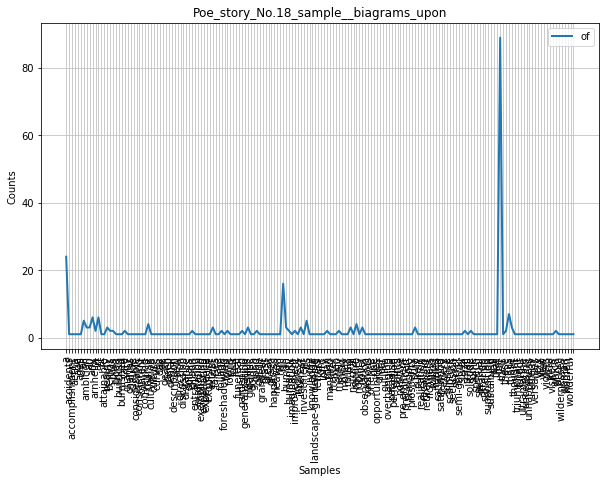

19 
 ['arnheim', 'the', 'new', 'b', 'course', 'that', 'being', 'my', 'them', 'light', 'a', 'its', 'evident', 'which', '?', 'england', 'half-precise', 'wild', 'all', 'art', 'curvature', 'color', 'view', '“', 'water', 'some', 'magic', 'vapor', 'granite', 'these', '.', 'west', 'unexplored', 'this', 'numerous', 'trees', 'fine', 'rocks', 'nearly', 'magnolias', 'about', 'other', 'two', 'east', 'sweeps', 'irregular', 'pebbles', 'no', 'fish', 'veritable', 'an', 'picturesqueness', 'excessive', 'geraniums', 'brilliantly-plumed', 'rare', 'sufficient', 'rock', 'combined', 'poetry', 'needing', 'hard', 'projecting', 'lozenge', 'glass', 'sweet', 'different', 'unexampled', 'it', 'egyptian', 'gorgeous', 'amity', 'age', 'step', 'natural', 'enthusiasm', 'romance', 'unworldliness', 'hearts', 'annie', 'her', 'invitations', 'excellent', 'snowy', 'great', 'julien', 'oriental', 'cane', 'resplendently-blooming', 'brilliant', 'mr.', 'another'] dict_items([('arnheim', 1), ('the', 84), ('new', 1), ('b', 1), ('cou

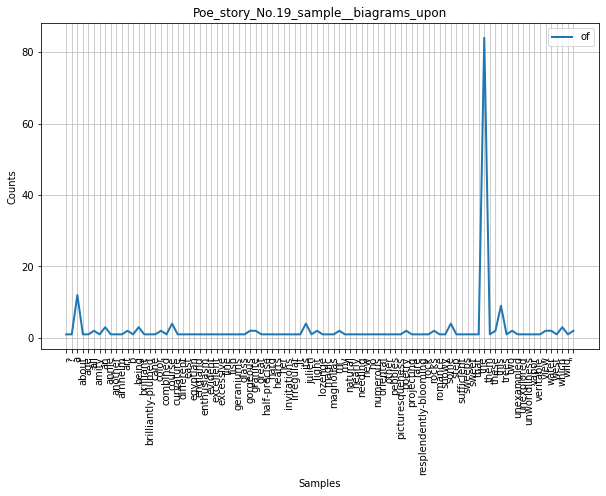

20 
 ['it', 'conscience', 'my', 'the', 'all', 'unspeakable', 'a', 'an', 'circumstances', 'fatality', 'error', 'having', 'serious', 'positive', 'course', 'england', 'gigantic', 'its', 'pleasure', 'mortar', 'our', 'this', 'wonder', 'late', 'deep', 'mystery', 'matter', 'these', 'enchantment', 'oak', 'eight', 'awe', 'original', 'stupendous', 'childhood', 'incident', 'very', 'feeble', 'sensation', 'rich', 'varied', 'excitement', 'those', 'mind', 'treating', 'his', 'manner', 'patronage', 'name', 'their', 'january', 'wilson', 'contradiction', 'victory', 'pride', 'strong', 'uneasy', 'companions', 'affairs', 'banter', 'mere', 'that', 'achilles', 'vexation', 'person', 'feature', 'relationship', 'comment', 'annoyance', 'myself', 'advice', 'avoiding', 'violence', 'demeanor', 'dr.', 'accommodating', 'narrow', 'practical', 'feeling', 'william', 'incoherent', 'arrival', 'human', 'some', 'scepticism', 'thoughtless', 'folly', 'vice', 'soulless', 'insisting', 'more', 'petulant', 'solemn', 'bygone', 'mor

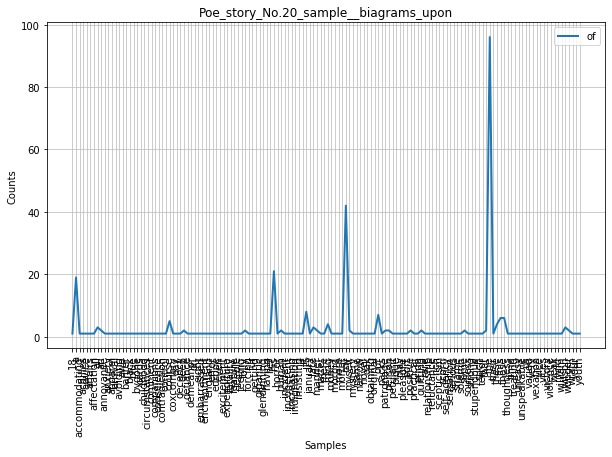

21 
 ['hearing', 'a', 'the', 'his', 'my', 'triumph', 'robbers', 'mortal', 'pain', 'grief', 'that', 'all', 'any', 'these', 'foul', 'familiar'] dict_items([('hearing', 1), ('a', 2), ('the', 17), ('his', 2), ('my', 7), ('triumph', 1), ('robbers', 1), ('mortal', 1), ('pain', 1), ('grief', 1), ('that', 1), ('all', 1), ('any', 1), ('these', 1), ('foul', 1), ('familiar', 1)])


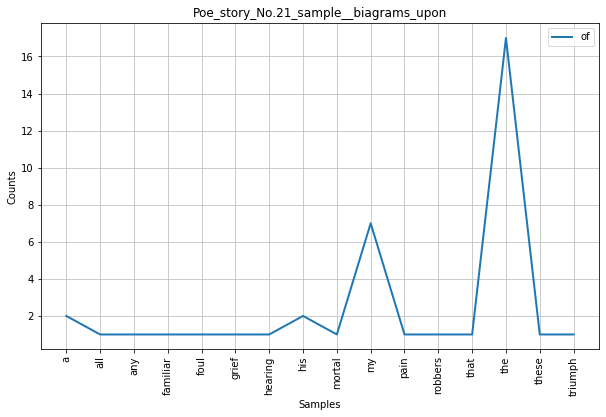

22 
 ['earth', 'that', 'unloveliness', 'peace', 'sorrow', 'good', 'joy', 'past', 'to-day', 'my', 'visionaries', 'the', 'some', 'antique', 'which', 'aerial', 'spiritual', 'sounds', 'it', 'what', 'fairy', 'imagination', 'monastic', 'manhood', 'dreams', 'health', 'memory', 'her', 'arnheim', 'change', 'maladies', 'so', 'epilepsy', 'recovery', 'a', 'those', 'interest', 'meditation', 'even', 'frequent', 'motion', 'absolute', 'ardent', 'such', 'this', 'deductions', 'his', 'sight', 'mind', 'god', 'laborious', 'by', 'human', 'berenice', 'mankind', 'love', 'marriage', 'our', 'insufferable', 'peculiar', 'their', 'moral', 'mademoiselle', 'horror', 'troubled', 'pain', 'no', 'dental'] dict_items([('earth', 1), ('that', 4), ('unloveliness', 1), ('peace', 1), ('sorrow', 2), ('good', 1), ('joy', 1), ('past', 1), ('to-day', 1), ('my', 19), ('visionaries', 1), ('the', 54), ('some', 1), ('antique', 1), ('which', 1), ('aerial', 1), ('spiritual', 1), ('sounds', 1), ('it', 1), ('what', 1), ('fairy', 1), ('im

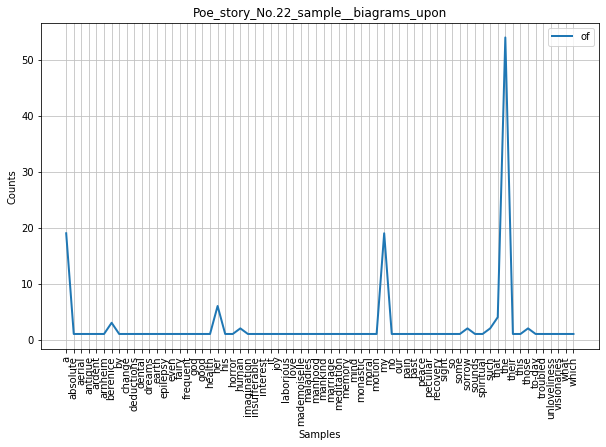

23 
 ['a', 'fancy', 'passion', 'thought', 'mind', 'the', 'many', 'eternity', 'good', 'evil', 'my', 'events', 'shadow', 'what', 'whom', 'giant', 'putting', 'forest', 'crushing', 'fragrant', 'our', 'eleonora', 'silence', 'pebbles', 'god', 'dreams', 'ebony', 'syria', 'her', 'that', 'them', 'which', 'aeolus-sweeter', 'hesper', 'grandeur', 'glory', 'love', 'schiraz', 'phrase', 'death', 'earth', 'him', 'it', 'aeolus', 'its', 'old', 'spiritual', 'arms', 'women', 'adoration', 'thy'] dict_items([('a', 4), ('fancy', 1), ('passion', 1), ('thought', 1), ('mind', 1), ('the', 60), ('many', 3), ('eternity', 1), ('good', 1), ('evil', 1), ('my', 10), ('events', 1), ('shadow', 1), ('what', 2), ('whom', 1), ('giant', 1), ('putting', 1), ('forest', 1), ('crushing', 1), ('fragrant', 1), ('our', 3), ('eleonora', 10), ('silence', 3), ('pebbles', 1), ('god', 1), ('dreams', 1), ('ebony', 1), ('syria', 1), ('her', 7), ('that', 1), ('them', 3), ('which', 2), ('aeolus-sweeter', 1), ('hesper', 2), ('grandeur', 1),

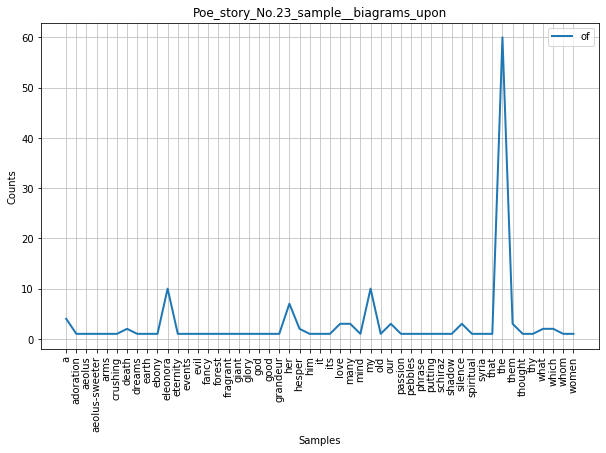

24 
 ['an', 'misfortunes', 'his', 'little', 'a', 'reeds', 'the', 'any', 'this', 'hard', 'england', 'fifteen', 'mind', 'alternate', 'shells', 'attendance', 'legrand', 'sullivan', 'october', 'remarkable', 'my', 'nine', 'passage', 'enthusiasm', 'scarabai', 'all', 'him', 'what', 'that', 'its', 'physiology', 'superstition', '?', 'mine', 'notin', 'conduct', 'importance', 'misfortune', 'money', 'jupiter', 'fort', 'some', 'real', 'profound', 'which', 'course', 'view', 'burnished', 'me', 'fate', 'fever', 'yours', 'your', 'trusting', 'industry', 'dark', 'whip-cord', 'success', 'minor', 'country', 'table', 'still', 'breaking', 'american', 'ascension', 'halloo', 'de', 'fifty', 'escape', 'disturbing', 'necessity', 'deliberation', 'five', 'four', 'two', 'vision', 'curvets', 'method', 'forethought', 'thought', 'playfulness', 'human', 'metal', 'decayed', 'gold', 'these', 'extreme', 'iron', 'more', 'wood', 'mercury', 'wrought', 'open', 'removing', 'incalculable', 'jewels', 'things', 'our', 'even', 'sil

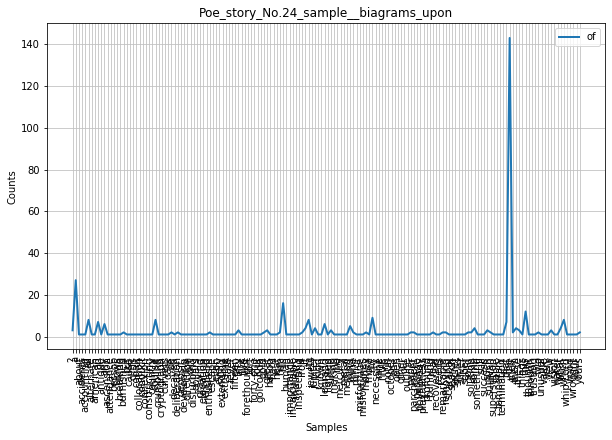

25 
 ['the', 'cyrus', 'any', 'christ', 'diana', 'holies', 'eleven', 'a', 'his', 'man', 'antioch', 'that', 'antiochia', 'daphne', 'their', 'buildings', 'houses', 'our', 'this', 'decay', 'its', 'your', 'fame', 'epidaphne', 'stately', 'antiquity.', 'mud', 'filth', 'idolatrous', 'egypt', 'her', 'yonder', 'what', 'elah', 'philosophers', 'valets-de-chambre', 'too', 'unusual', 'laughter', 'fun', 'timarchus', 'people', 'heraclides', 'ashimah', 'future', 'gore', 'wine', 'trumpets', 'idiots', 'syria', 'all', 'gigantic', 'especial', 'triumph', 'poets', 'cameleopards.', 'safety', 'propriety', 'no', 'mastication', 'cameleopards', 'speed', 'sects', 'costumes', 'languages', 'beasts', 'instruments', 'it', 'victory', 'aurelian'] dict_items([('the', 47), ('cyrus', 1), ('any', 1), ('christ', 1), ('diana', 1), ('holies', 1), ('eleven', 1), ('a', 14), ('his', 11), ('man', 1), ('antioch', 1), ('that', 1), ('antiochia', 1), ('daphne', 1), ('their', 2), ('buildings', 1), ('houses', 1), ('our', 1), ('this', 2)

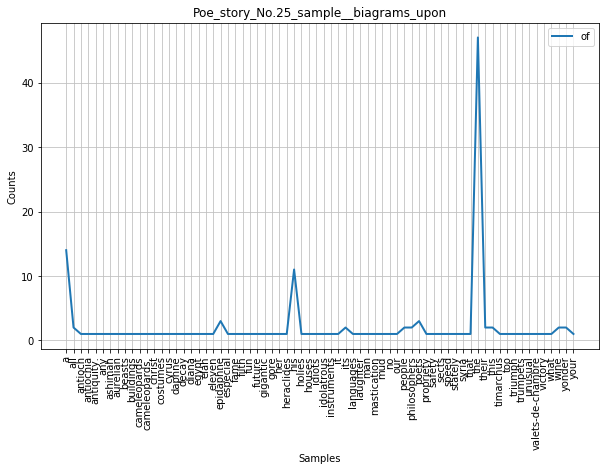

26 
 ['as', 'analysis', 'them', 'the', 'enigmas', 'conundrums', 'hieroglyphics', 'each', 'acumen', 'method', 'intuition', 're-solution', 'it', 'its', 'chess', 'draughts', 'such', 'ten', 'inadvertence', 'course', 'some', 'ordinary', 'his', 'intellect', 'a', 'all', 'thought', 'hoyle', 'good', 'mere', 'observations', 'what', 'assorting', 'face', 'certainty', 'surprise', 'triumph', 'chagrin', 'gathering', 'their', 'affairs', 'purpose', '18', 'an', 'untoward', 'life', 'our', 'renting', 'fancy', 'tapers', 'rays', 'these', 'mental', 'my', 'us', 'that', '?', 'whom', 'chantilly', 'xerxes', 'soles', 'sufficient', 'apples', 'charlatanerie', 'your', 'interest', 'horses', 'paving', 'late', 'necessity', 'experiment', 'pavement', 'atomies', 'epicurus', 'name', 'orion', 'terrific', 'one', 'stairs', 'which', 'grey', 'topaz', 'metal', 'little', 'madame', 'soot', 'finger', 'every', 'humanity', 'import', 'living', 'selling', 'tobacco', 'muset', 'either', 'amsterdam', 'those', 'mignaud', '4000', 'several',

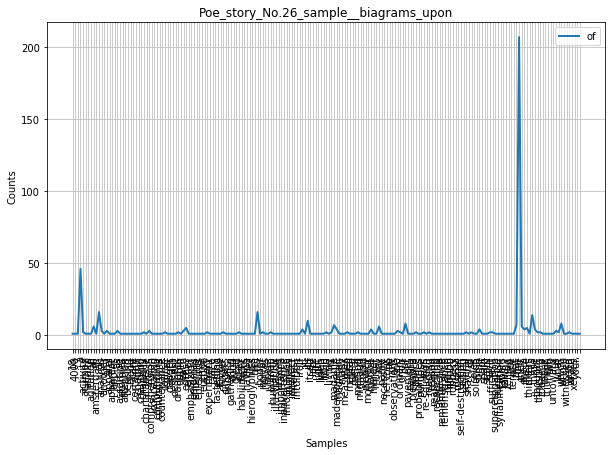

27 
 ['marie', 'events', 'protestantism', 'so', 'which', 'thought', 'chance', 'probabilities', 'the', 'time', 'a', 'scarcely', 'mary', 'my', 'character', 'circumstances', 'extorted', 'madame', 'moody', 'its', 'dupin', 'those', 'course', 'intuition', 'such', 'his', 'our', 'hesitation', 'making', 'curiosity', 'her', 'this', 'all', 'twenty', 'any', 'citizens', 'us', 'july', 'respectful', 'every', 'information', 'sunday', 'some', 'age', 'disappearance', 'june', 'fingers', 'ropes', 'blows', 'lace', 'hitch', 'fine', 'beauvais', 'going', 'nature', 'scars', 'it', 'news', 'an', 'him', 'private', 'affairs', 'desperadoes', 'extensive', 'people', 'one', 'le', 'seat', 'dress', 'them', 'blackguards', 'dark', 'miscreants', 'evidence', 'seemingly', 'st.', 'what', 'self-destruction', 'crime', 'solution', 'g', 'these', 'success', 'nothing', 'suicide', 'self-murder', 'whose', 'justice', 'l', 'their', 'little', 'truth', 'merit', 'disposal', 'individuals', 'less', 'particular', 'five', 'bodies', 'two', 'fr

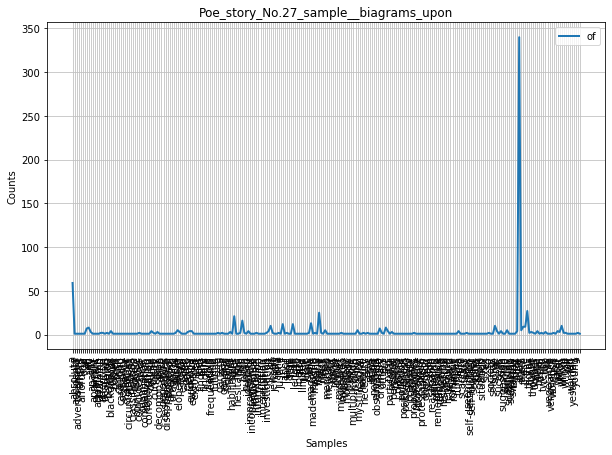

28 
 ['mr.', 'seventy-five', 'the', 'admiration', 'fact', 'creating', 'an', 'this', 'lord', '“', 'interest', 'throwing', 'our', 'late', 'aerial', 'science', 'impinging', 'a', 'these', 'adapting', 'itself', 'support', 'its', 'his', 'employing', 'propulsion', 'sir', 'surface', 'gas', 'light', 'hollow', 'steel', 'flattened', 'oiled', 'spring', 'great', 'raising', 'four', 'cane', 'time', 'five', 'simplicity', 'arial', 'some', 'sufficient', 'arostation', 'silk', 'vast', 'aerostation', 'inflation', 'hydrogen', 'coal-gas', '1300', 'which', 'different', 'slack-lime', 'many', 'dew', 'several', 'ascending', 'length', 'moisture', 'weight', 'just', 'rope', 'water', 'copper', 'office', 'weal-vor', 'either', '15,000', 'lakes', 'eastern', 'altitude', 'breakers', 'altering', 'direction', 'parchment', 'place', 'one', 'reach', 'wind', 'not', 'beating', 'north', 'ballast', 'progress', 'all', 'them', 'geneva', 'caps', 'night', 'success', 'cloaks', 'my', 'human', 'such', 'innumerable', 'ordinary', 'yesterd

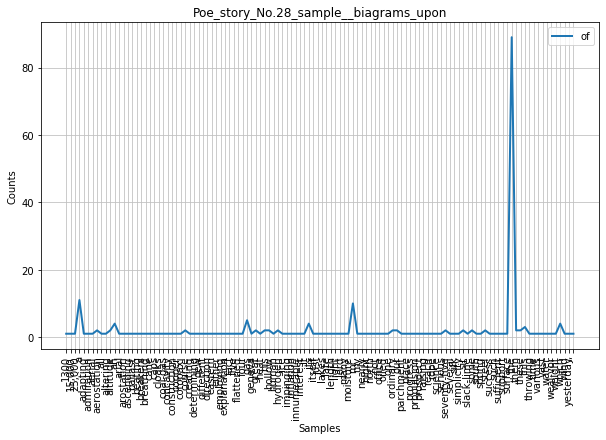

29 
 ['my', 'years', 'no', 'mind', 'the', 'their', 'rigid', 'imagination', 'this', 'referring', 'such', 'that', 'truth', 'superstition', 'a', 'fancy', 'batavia', 'java', 'nervous', 'about', 'malabar', 'opium', 'wind', 'our', 'vapor', 'low', 'detecting', 'danger', 'malays', 'evil', 'foam', 'mountainous', 'an', 'ourselves', 'going', 'course', 'jaggeree', 'new', 'surf', 'ebony', 'ocean', 'calculating', 'having', 'ice', 'hope', 'way', 'one', 'these', 'red', ',', 'any', 'brass', 'innumerable', 'sail', 'intense', 'her', 'secreting', 'awe', 'people', 'vague', 'it', 'concealment', 'observing', 'great', 'singular-looking', 'navigation', 'second', 'bygone', 'transmitting', 'ungoverned', 'ratlin-stuff', 'war', 'spars', 'canvas', 'familiar', 'recollection', 'old', 'spanish', 'his', 'attention', 'them', 'water', 'miracles', 'eternity', 'some', 'irrepressible', 'wonder', 'body', 'science', 'eld', 'buried', 'fallen', 'which', 'eternal', 'foamless', 'us', 'death', 'despair', 'whose', 'tempest', 'merca

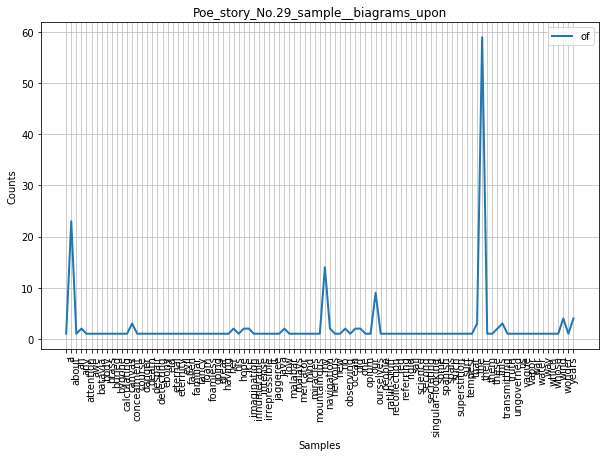

30 
 ['those', 'commingled', 'mrs.', 'the', 'very', 'rich', 'a', 'my', 'black', 'these', 'sully', 'art', 'all', 'its', 'expression', 'rarest', 'glee', 'her', 'his'] dict_items([('those', 1), ('commingled', 1), ('mrs.', 1), ('the', 23), ('very', 1), ('rich', 1), ('a', 6), ('my', 2), ('black', 1), ('these', 1), ('sully', 1), ('art', 1), ('all', 1), ('its', 2), ('expression', 1), ('rarest', 2), ('glee', 2), ('her', 2), ('his', 5)])


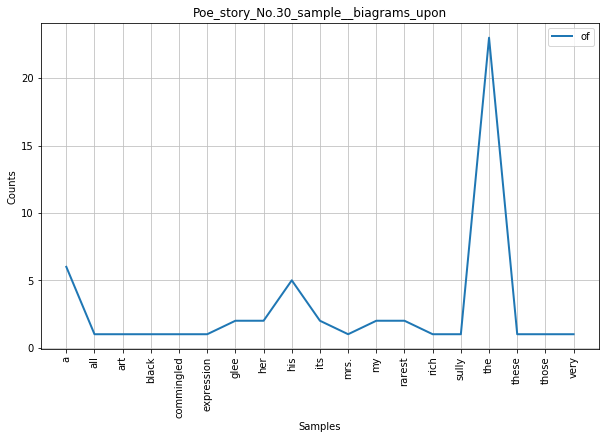

31 
 ['furniture', 'their', 'gadabouts', 'which', 'a', 'the', 'hangmen', 'blood', 'dollars', 'wealth', 'taste', 'costly', 'ambition', 'legitimate', 'magnificence', 'an', 'its', 'view', 'what', 'keeping', 'art', 'adaptation', 'many', 'place', 'drapery', 'any', 'late', 'ancient', 'all', 'carpets', 'large', 'small', 'fashion', 'no', 'flowers', 'well-known', 'christendom', 'this', 'huge', 'time-servers', 'baal', 'mammon', 'american', 'gas', 'glass', 'course', 'argand', 'these', 'good', 'mirrors', 'numerous', 'artistic', 'discordant', 'something', 'pleasure', 'our', 'americans', 'moderns', 'gold', 'rich', 'crimson', 'saxony', 'short', 'paper', 'stanfield', 'chapman', 'sully', 'each', 'so', 'burnished', 'rosewood', 'two', 'rose-wood', 'sweet', 'my'] dict_items([('furniture', 4), ('their', 2), ('gadabouts', 1), ('which', 1), ('a', 15), ('the', 37), ('hangmen', 1), ('blood', 2), ('dollars', 1), ('wealth', 1), ('taste', 4), ('costly', 1), ('ambition', 1), ('legitimate', 1), ('magnificence', 2),

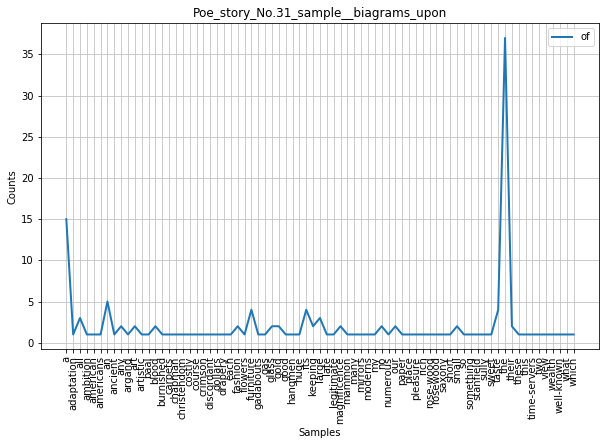

32 
 ['jerusalem', 'the', 'benjamin', 'david', 'pompey', 'baal.', 'adonai', 'generosity', 'my', 'saints', 'dashing', 'that', 'rome', 'appropriating', 'heaven', 'smoke', 'its', 'zion', 'great', 'white', 'two', 'all', 'conference', 'cheops', 'belus', 'adommin.', 'silver', 'pluto', 'a', 'every', 'whom', 'yonder', 'some', 'their', 'this', 'office', 'good', 'an', 'ben-levi', 'engedi', 'jehosaphat', 'his', 'hebron.', 'bashan', 'no'] dict_items([('jerusalem', 3), ('the', 38), ('benjamin', 2), ('david', 1), ('pompey', 1), ('baal.', 1), ('adonai', 1), ('generosity', 1), ('my', 1), ('saints', 1), ('dashing', 1), ('that', 1), ('rome', 1), ('appropriating', 1), ('heaven', 1), ('smoke', 1), ('its', 1), ('zion', 1), ('great', 1), ('white', 1), ('two', 1), ('all', 1), ('conference', 1), ('cheops', 1), ('belus', 1), ('adommin.', 1), ('silver', 1), ('pluto', 1), ('a', 2), ('every', 1), ('whom', 1), ('yonder', 1), ('some', 1), ('their', 1), ('this', 1), ('office', 1), ('good', 1), ('an', 1), ('ben-levi'

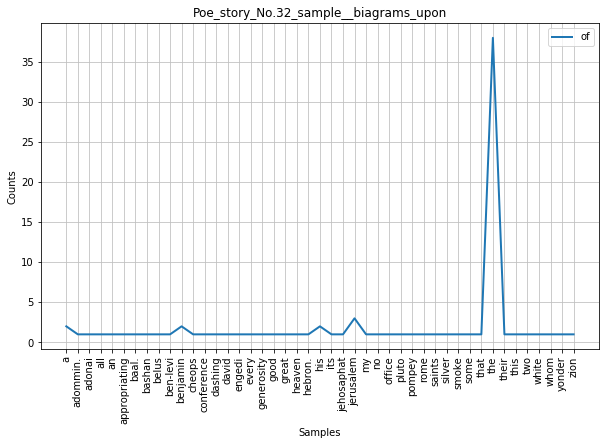

33 
 ['the', 'a', 'his', 'summer', 'some', 'every', 'my', 'any', 'terror', 'its', 'abnormal', 'hereditary', 'faith', 'suggestion', 'truth', 'genius', 'exceedingly', 'which', 'hideous', 'these', 'one', 'our', 'an', 'this', 'black', 'buffaloes', 'infinitely', 'it', 'pure', 'wings', 'forthcoming', 'wo', 'course', 'what', 'repugnance', 'absolute', 'mania', 'various', 'speculative', 'discussion', 'error', 'democracy', 'government', 'natural', 'insecta', 'metallic', 'mandibles', 'cry', 'death', 'beholding'] dict_items([('the', 41), ('a', 7), ('his', 2), ('summer', 1), ('some', 3), ('every', 1), ('my', 5), ('any', 1), ('terror', 1), ('its', 5), ('abnormal', 1), ('hereditary', 1), ('faith', 1), ('suggestion', 1), ('truth', 1), ('genius', 1), ('exceedingly', 1), ('which', 2), ('hideous', 1), ('these', 1), ('one', 1), ('our', 1), ('an', 6), ('this', 2), ('black', 1), ('buffaloes', 1), ('infinitely', 1), ('it', 1), ('pure', 1), ('wings', 2), ('forthcoming', 1), ('wo', 1), ('course', 1), ('what', 

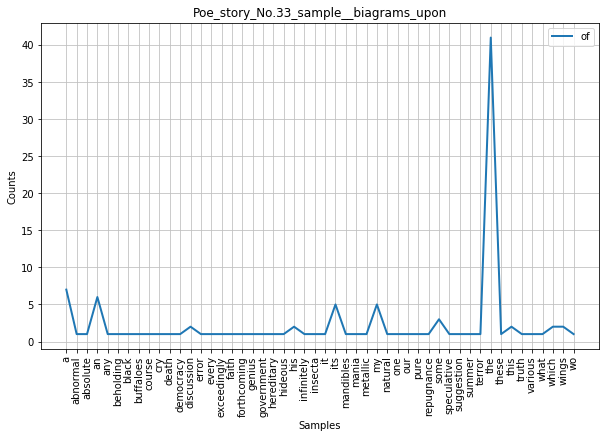

34 
 ['the', 'wit', 'it', 'voltaire', 'my', 'fashion', 'course', 'folly', 'his', 'a', 'self-gratulation', 'interjectional', 'compensation', 'wonderful', '?', 'our', 'exquisite', 'sport', 'her', 'hop-frog', 'that', 'getting', 'device', 'expectation', 'indecision', 'being', 'wine', 'your', 'good', 'characters', 'us', 'something', 'this', 'large', 'idea', 'eight', 'masqueraders', 'you.', 'increasing', 'delicately', 'equipping', 'such', 'tar', 'each', 'their', 'some', 'thought', 'reach', 'laughter', 'ourang-outangs', 'about', 'trippetta', 'maniacal', 'vivid', 'people', 'both', 'vengeance'] dict_items([('the', 51), ('wit', 1), ('it', 1), ('voltaire', 1), ('my', 3), ('fashion', 1), ('course', 4), ('folly', 1), ('his', 7), ('a', 7), ('self-gratulation', 1), ('interjectional', 1), ('compensation', 1), ('wonderful', 1), ('?', 1), ('our', 1), ('exquisite', 1), ('sport', 1), ('her', 3), ('hop-frog', 3), ('that', 1), ('getting', 1), ('device', 1), ('expectation', 1), ('indecision', 1), ('being', 1

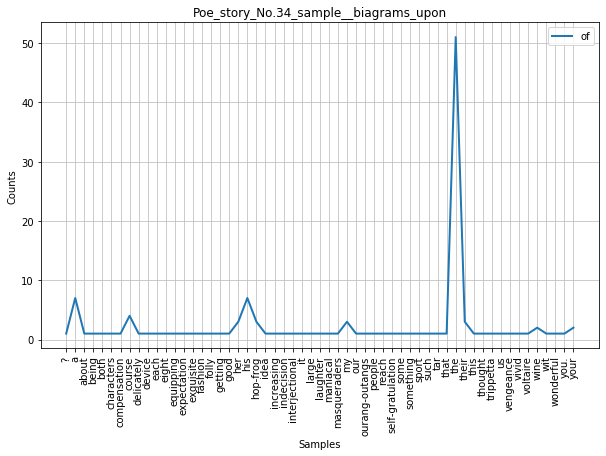

35 
 ['the', 'a', 'ghostly', 'heart', 'throat', 'mysteries', 'man', 'all', 'an', 'those', 'ennui', 'leibnitz', 'gorgias', 'pain', 'population', 'human', 'emotion', 'things', 'them', 'figure', 'countenance', 'making', 'impatience', 'society', 'leisure', 'their', 'clerks', 'flash', 'carriage', 'these', 'what', 'bon', 'staunch', 'black', 'standing', 'respectability', 'dashing', 'swell', 'wristband', 'excessive', 'whom', 'dress', 'complexion', 'eye', 'lip', 'tone', 'men', 'abject', 'some', 'ruffians', 'her', 'parian', 'immature', 'every', 'infamy', 'tertullian', 'individual', 'light', 'long', 'age', 'its', 'my', 'vast', 'caution', 'penuriousness', 'avarice', 'coolness', 'malice', 'blood', 'triumph', 'merriment', 'intense', 'supreme', 'him', 'examining', 'beautiful', 'weather', 'which', 'umbrellas', 'losing', 'seeing', 'buyers', 'caoutchouc', 'devious', 'one', 'his', 'agitation', 'london', 'intemperance', 'wretched', 'joy', 'that', 'deep', 'god', 'grunninger'] dict_items([('the', 61), ('a',

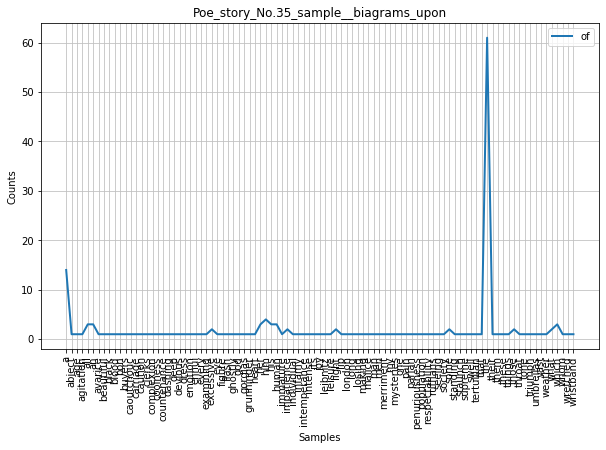

36 
 ['an', 'his', 'poetical', 'print', 'readers', 'themselves', 'their', 'staying', 'mitigating', 'the', 'la', 'a', 'flogging', 'wickedness', 'making', 'age', 'cards', 'catching', 'taking', 'congress', 'telling', 'dammit', 'such', 'speech', 'disposition', 'wager', 'devotion', 'enunciation', 'my', 'himself', 'veracity', 'me', 'this', 'protection', 'uneasy', 'austere', 'odd', 'some', 'mr.', 'style', 'venerable', 'black', 'profundity', 'our', 'america', 'man', 'all', 'mere', 'toby', 'conscience', 'course'] dict_items([('an', 1), ('his', 16), ('poetical', 1), ('print', 1), ('readers', 1), ('themselves', 1), ('their', 2), ('staying', 1), ('mitigating', 1), ('the', 21), ('la', 1), ('a', 8), ('flogging', 1), ('wickedness', 1), ('making', 1), ('age', 1), ('cards', 1), ('catching', 1), ('taking', 1), ('congress', 1), ('telling', 1), ('dammit', 1), ('such', 1), ('speech', 1), ('disposition', 1), ('wager', 1), ('devotion', 1), ('enunciation', 1), ('my', 9), ('himself', 2), ('veracity', 1), ('me'

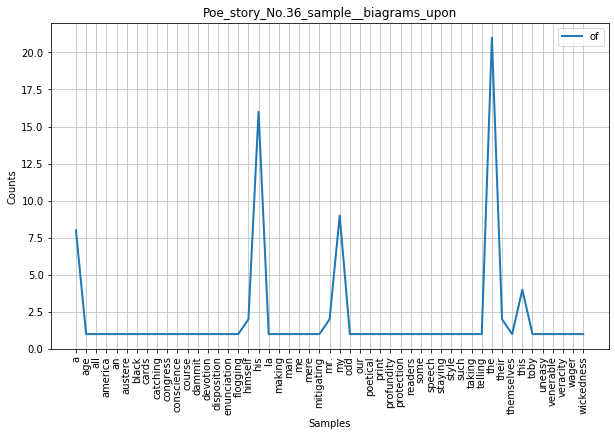

37 
 ['the', 'unsuitable', '18', 'foul', 'proceeding', 'returning', 'mr.', 'no', 'all', 'them', 'his', 'recommendation.', 'wine', 'a', 'swearing', 'it', 'these', 'liberality', 'showing', 'action', 'mind', 'any', 'rattleborough', '“', 'very', 'rather', '‘', 'liberty', 'which', 'anger', 'dispersion', 'course', 'reasoning', 'that', 'out-of-the-way', 'existing', 'woodland', 'stagnant', '.', 'some', 'going', 'coming', 'draining', 'its', 'saying', 'living', 'passion', 'this', 'business.', 'blunders', 'their', 'disinheritance', 'beings', 'cui', 'mrs.', 'bulwer', 'turnapenny', 'revenge', 'reinstation', 'rattle', 'half', 'himself', 'endeavoring', 'an', 'money', 'rescinding', 'cutting', 'every', 'constables', 'carrying', 'discovering', 'moulds', 'property', 'circumstantial', 'murder', 'death', 'forwarding', 'chateau-margaux', '?', 'ever', 'especial', 'providence', 'friends', 'broaching', 'months', 'mock', 'disinterring', 'pleasure.', 'affright', 'marble', 'concealment', 'avenging', 'frankness', 

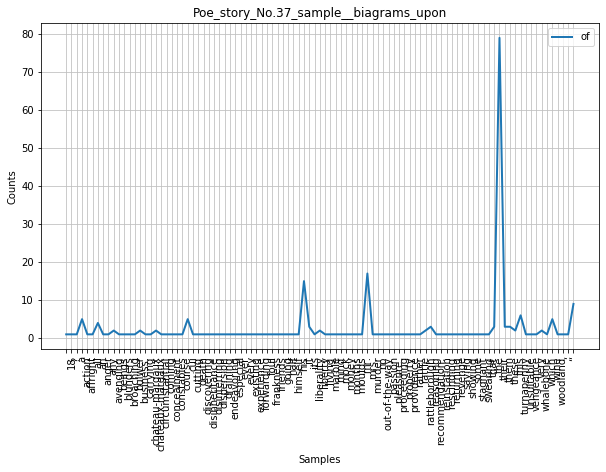

38 
 ['purliteness', 'the', 'all', 'a', 'being', 'doing', 'this', 'her', 'my', 'connaught', 'that', 'you', 'mounseer', 'one', 'his', 'in', 'uncommon', '?', '“', 'reading', 'understanding', 'comprehension', 'their', 'ethical', 'trebizonde', 'restaurateur', 'mine', 'gluttony', 'very', 'virtues', 'these', 'making', 'any', 'our', 'bon-bon', 'an', 'perilous', 'at', 'unaccountable', 'extraordinary', 'such', 'chambertin', 'propriety', 'mind', 'strange', 'genius', 'inferiority', 'deportment', 'magnificence', 'habiliment', 'those', 'restaurateurs', 'genoa', 'benevenuta', 'florence', 'paradise', 'perfection.', 'matter-of-fact', 'antique', 'curtains', 'polemics', 'dudecimo', 'german', 'eusebius', 'labelled', 'blazing', 'wind', 'solid', 'before', 'retouching', 'calling', 'no', 'black', 'considerable', 'green', 'filthy', 'steel', 'contemplation', 'anger', 'feeling', 'exterior', 'men', 'satisfaction', 'affairs', 'morals', 'mousseux', 'jagged', 'red', 'embarrassment', 'curiosity', 'flesh', 'so', 'ecc

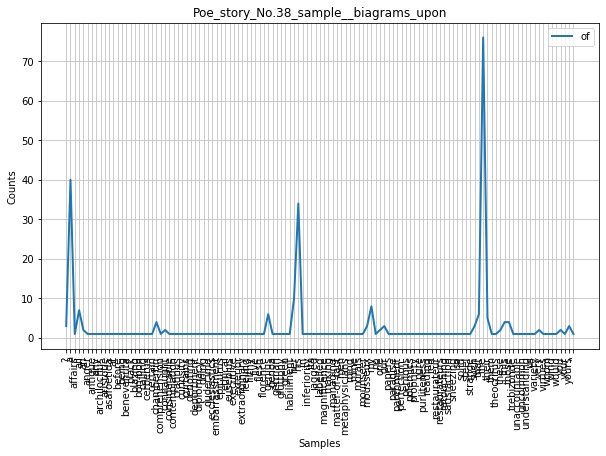

39 
 ['the', 'going', 'supper', 'course', 'welsh', 'difference', 'brown', 'condiment', 'enjoying', 'a', 'humanity', 'bed', 'my', 'ponnonner', 'higher', 'affording', 'rich', 'papyrus', 'position', 'hieroglyphical', 'our', 'its', 'that', 'linen', 'these', 'sheath', 'plaster', 'his', 'cylindrical', 'deities', 'somewhat', 'opinion', 'camphor', 'embalming', 'an', 'electricity', 'less', 'galvanic', 'astonishment', 'exceeding', 'discharging', 'prosecuting', 'doctor', 'your', 'conduct', 'contraries', 'every', 'paradox', 'indemnification', 'american', 'messieurs', 'images', 'sensible', 'conveying', 'charcoal', 'ninety', 'mummies', 'conscience', 'which', 'black', 'allamistakeo', 'shivering', 'sky-blue', 'brocade', 'whiskers', 'size', 'cigars', 'questions', 'interment', 'time', 'what', 'mercury.', 'calvanism', 'ignorance', 'embalmment', 'scarabaei.', 'vitality', 'it', 'those', 'man', 'six', 'centuries', 'science', 'history', 'this', 'five', 'hap-hazard', 'literary', 'whole', 'exasperated', 'annot

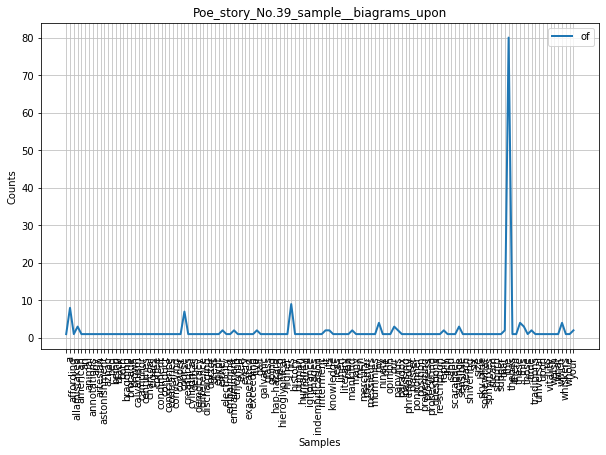

40 
 ['the', 'its', 'his', 'my', 'beauty', 'her', 'a', 'affection', 'idolatrous', 'ligeia', 'face', 'an', 'delos', 'that', 'all', '“', 'surface', 'breadth', 'our', 'nourjahad', 'intense', 'beings', 'black', 'great', 'no', 'mere', 'so', 'democritus', 'leda', 'astrologers', 'mind', 'remembrance', 'their', 'analogies', 'running', 'unusually', 'which', 'joseph', 'years', 'stern', 'such', 'those', 'utterance', 'europe', 'moral', 'metaphysical', 'resistance', 'desire', 'expressing', 'hopes', 'god', 'vast', 'madness', 'sin', 'these', 'death', 'what', 'mortals', 'weary', 'fair', 'utter', 'alleviating', 'more', 'grief', 'incipient', 'egypt', 'tufted', 'opium', 'mental', 'tremaine', 'gold', 'deep', 'capacious', 'unbroken', 'either', 'this', 'gloomy-looking', 'them', 'parti-colored', 'eastern', 'solid', 'immemorial', 'view', 'antiquity', 'simple', 'wind', 'regret', 'half-slumber', 'sounds', 'motions', 'suffering', 'alarming', 'fear', 'september', 'anxiety', 'vague', 'india', 'light', 'angelic', '

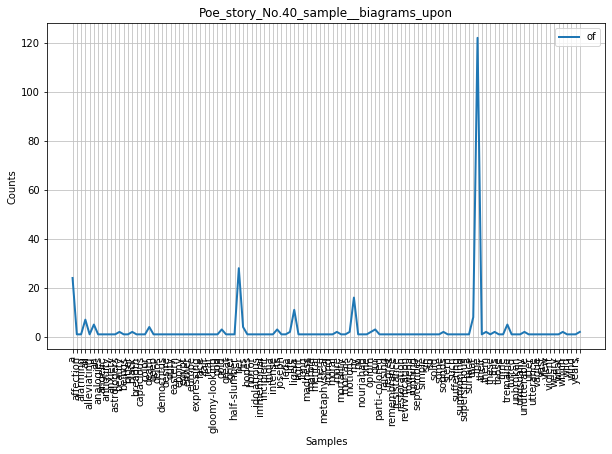

41 
 ['deep', 'eros', 'passion', 'love', 'no', 'mind', 'her', 'those', 'the', 'time', 'habit', 'this', 'my', 'a', 'morella', 'fichte', 'identity', 'discussion', 'beauty', 'rational', 'that', 'intense', 'its', 'one', 'clay', 'days', 'all', 'earth', 'heaven', 'sorrow', 'impressions', 'trees', 'thy', 'paestum', 'experience', 'infancy', 'maturity', 'resemblance', 'similitude', 'baptism', 'old', 'death', 'our'] dict_items([('deep', 1), ('eros', 1), ('passion', 1), ('love', 1), ('no', 1), ('mind', 1), ('her', 14), ('those', 2), ('the', 24), ('time', 2), ('habit', 1), ('this', 2), ('my', 11), ('a', 4), ('morella', 2), ('fichte', 1), ('identity', 1), ('discussion', 1), ('beauty', 1), ('rational', 1), ('that', 3), ('intense', 1), ('its', 2), ('one', 1), ('clay', 1), ('days', 1), ('all', 1), ('earth', 2), ('heaven', 1), ('sorrow', 1), ('impressions', 1), ('trees', 1), ('thy', 1), ('paestum', 1), ('experience', 1), ('infancy', 1), ('maturity', 1), ('resemblance', 1), ('similitude', 1), ('baptism'

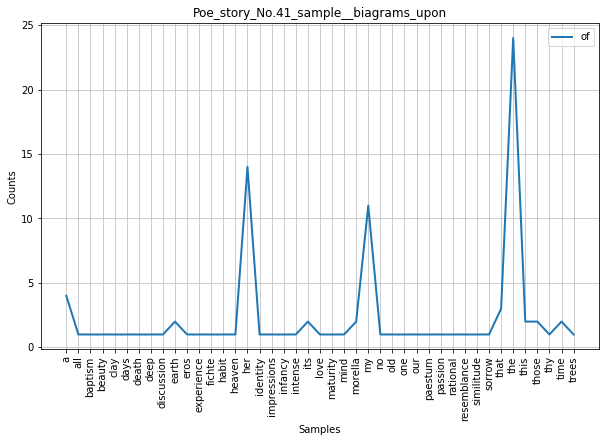

42 
 ['the', 'mr.', 'his', 'speaking', 'age', 'profound', 'a', 'light', 'excitement', 'an', 'person', 'half', 'neuralgic', 'more', 'mesmer', 'magnetic', 'confidence', 'these', 'late', 'which', 'serious', 'bedloe', 'morphine', 'it', 'strong', 'wild', 'charlottesville', 'november', 'him', 'this', 'dreary', 'accidents', 'enduing', 'interest', 'grass', 'suggestion', 'rhapsodical', 'nervous', 'men', 'course', 'large', 'steel', 'water', 'sunshine', 'fearful', 'my', 'novel', 'multitudinous', 'astonishment', 'wind', 'in', 'balconies', 'verandas', 'minarets', 'shrines', 'black', 'flowing', 'holy', 'steps', 'deeply-burthened', 'vast', 'rice', 'tests', 'animosity', 'despair', 'kiosk', 'them', 'tall', 'arrows', 'your', 'darkness', 'death', 'electricity', 'elasticity', 'weight', 'volition', 'substance', 'deep', 'to-day', 'some', 'horror', 'warren', 'benares', 'cheyte', 'turbans', 'announcing', 'especial', 'blood'] dict_items([('the', 46), ('mr.', 2), ('his', 10), ('speaking', 1), ('age', 2), ('prof

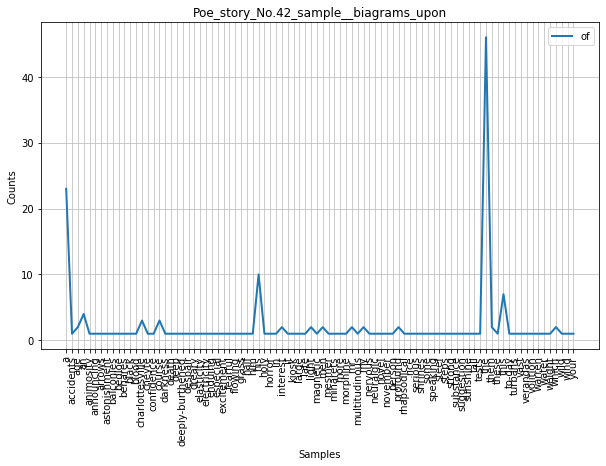

43 
 ['“', 'the', 'age', 'names', 'sound', 'some', 'my', 'paris', 'croissart', 'one', 'similar', 'descent', 'legislature', 'wearing', 'a', 'demureness', 'sanctimoniousness', 'downright', 'these', 'little', 'it', 'female', 'which', 'gaze', 'apuleius', 'rich', 'extraordinary', 'jewels', 'all', 'even', 'soul', 'thought', 'merely', 'this', 'transport', 'calm', 'enthusiastic', 'feeling', 'mind', 'extravagance', 'her', 'fashion', 'late', 'applying', 'course', 'gravity', 'weariness', 'several', 'mere', 'admiration', 'madame', 'so', 'an', 'both', 'agitation', 'excitement', 'love', 'pistols', 'heart', 'happiness', 'impatience', 'erebus', 'his', 'introducing', 'friends', 'public', 'meeting', 'exchanging', 'wrath', 'madness', 'our', 'devotion', 'expectation', 'philosophy', 'every', 'presentation', 'watching', 'hands', 'decorum', 'concealing', 'each', 'naivete', 'rashness', 'imprudence', 'true', 'rendering', 'unhappiness', 'candor', 'answer', 'summer', 'light', 'vienna', 'superior', 'seeing', 'hea

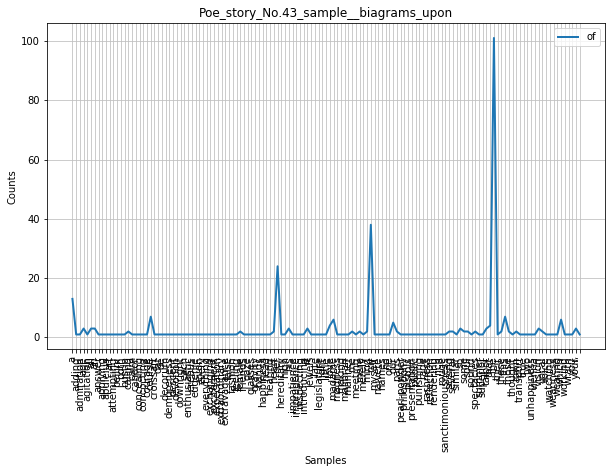

44 
 ['ferrex', 'october', 'the', 'an', 'st.', 'a', 'such', 'these', '“', 'his', 'dogged', 'stumpy', 'no', 'flesh', 'complacent', 'licking', 'ben', 'unpaid-for', 'that', 'decyphering', 'inditing', 'either', 'both', 'dirty', 'legs', 'what', 'their', 'this', 'disease', 'death', 'nightly', 'every', 'wines', 'removal', 'exile', 'human', 'mischief', 'forbidden', 'prohibited', 'exercise', 'many', 'images', 'men', 'courage', 'vocal', 'rubbish', 'wild', 'things', 'curses', 'wine-cellars', 'bursting', 'which', 'various', 'six', 'ghastly', 'all', 'intoxication', 'sable', 'peculiarity', 'her', 'whom', 'some', 'physiognomy', 'cambric', 'gave', 'oporto', 'departed', 'muslin', 'prodigious', 'indescribable', 'elegance', 'convenience', 'forty-five', 'huge', 'wind', 'ignited', 'decorum', 'very', 'red', 'ill-breeding', 'guests', '‘', 'will', 'our', 'those', 'liqueur', 'black', 'utter', 'king', 'respect', 'ballast', 'means', 'your', 'bellows', 'two', 'toddy', 'foam', 'light', 'liquor', 'punch', 'death-fu

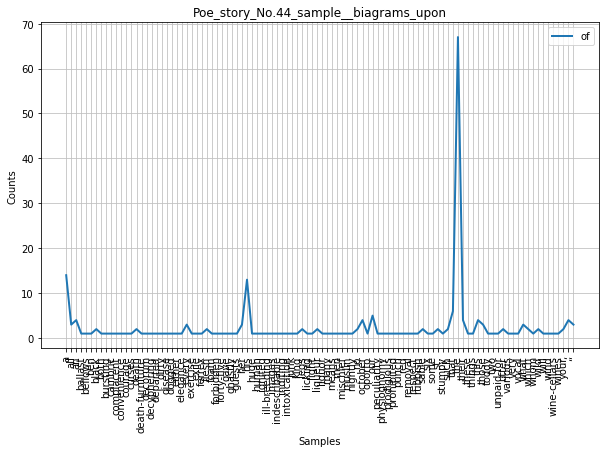

45 
 ['port', 'smiles', 'your', 'yours', 'course', 'my', 'the', 'his', 'contradiction', 'a', 'tantalization', 'quoting', 'logical', 'horace', '“', 'late', 'what', 'this', 'correction', 'job', 'these', 'rigmarole', 'honor', 'setting', 'which', 'all', 'england', 'sunday', 'you', 'events', 'good', 'whist', 'extent', 'one', 'us'] dict_items([('port', 2), ('smiles', 1), ('your', 2), ('yours', 1), ('course', 2), ('my', 5), ('the', 9), ('his', 5), ('contradiction', 1), ('a', 1), ('tantalization', 1), ('quoting', 1), ('logical', 1), ('horace', 1), ('“', 1), ('late', 1), ('what', 1), ('this', 2), ('correction', 1), ('job', 1), ('these', 1), ('rigmarole', 1), ('honor', 1), ('setting', 1), ('which', 1), ('all', 1), ('england', 1), ('sunday', 1), ('you', 2), ('events', 1), ('good', 1), ('whist', 1), ('extent', 1), ('one', 2), ('us', 1)])


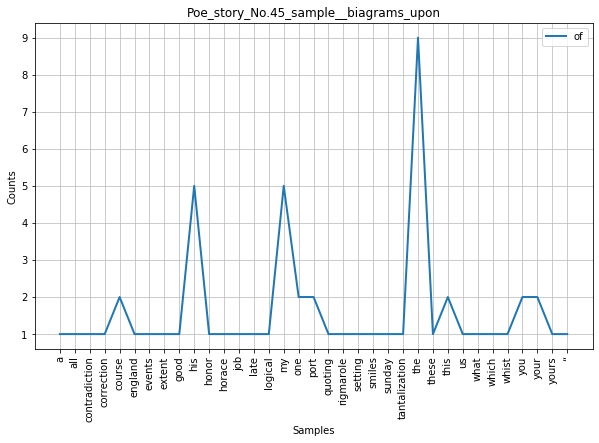

46 
 ['vondervotteimittiss', 'the', 'my', 'those', 'it', 'enlisting', 'authorities', 'historian', 'medals', 'this', 'indefinite', 'its', 'opinions', 'grogswigg', 'kroutaplenttey', 'such', 'information', 'dundergutz', 'stuffundpuff', 'gruntundguzzell', 'vondervotteimittis', 'any', 'a', 'sixty', 'course', 'each', 'architecture', 'hard-burned', 'sash', 'tiles', 'pattern', 'mind', 'square', 'black-looking', 'outrider', 'sauer-kraut', 'orange-colored', 'her', 'green', 'pink', 'yellow', 'them', 'mother-of-pearl', 'more', 'his', 'things', 'sinecures', 'antiquity', 'their', 'reverence', 'prophecy', 'noon', 'dismay', 'teeth', 'displaying', 'whose', 'white', 'black', 'fantastic', 'face', 'dignity', 'double-bass', 'vengeance', 'absolute', 'uproar', 'every', 'thirteen', 'all', 'playing', 'correct'] dict_items([('vondervotteimittiss', 10), ('the', 42), ('my', 2), ('those', 1), ('it', 3), ('enlisting', 1), ('authorities', 1), ('historian', 1), ('medals', 1), ('this', 1), ('indefinite', 1), ('its', 2

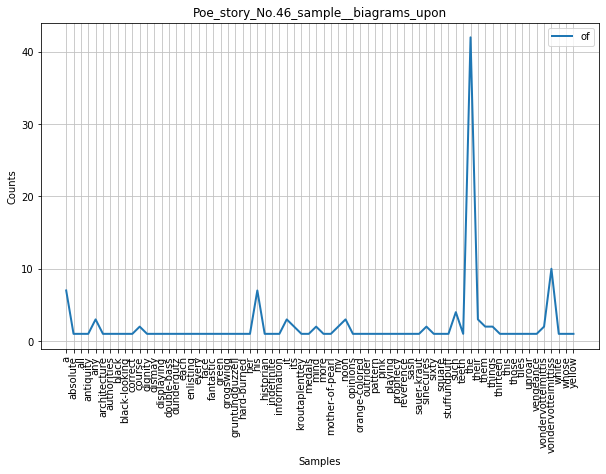

47 
 ['junius', 'fum-fudge', 'my', 'pulls', 'drams', 'age', 'your', 'nosology.', 'noses.', 'a', 'the', 'us', 'an', 'bless-my-soul', 'so-and-so', 'this-and-that', 'touch-me-not', 'her', 'virtu', 'wales', 'fire', 'eusebius', 'nice', 'red', 'cimabue', 'caravaggio', 'albano', 'titian', 'rubens', 'jan', 'opinion', 'green', 'aschylus', 'isaus', 'lysias', 'theophrastus', 'apollonius', 'pindar', 'homer', 'myself', 'nosology', 'it', 'bluddennuff', 'his'] dict_items([('junius', 1), ('fum-fudge', 1), ('my', 6), ('pulls', 1), ('drams', 1), ('age', 1), ('your', 2), ('nosology.', 1), ('noses.', 1), ('a', 2), ('the', 18), ('us', 1), ('an', 1), ('bless-my-soul', 2), ('so-and-so', 1), ('this-and-that', 1), ('touch-me-not', 1), ('her', 1), ('virtu', 1), ('wales', 1), ('fire', 1), ('eusebius', 1), ('nice', 1), ('red', 1), ('cimabue', 1), ('caravaggio', 1), ('albano', 1), ('titian', 1), ('rubens', 1), ('jan', 1), ('opinion', 1), ('green', 1), ('aschylus', 1), ('isaus', 1), ('lysias', 1), ('theophrastus', 

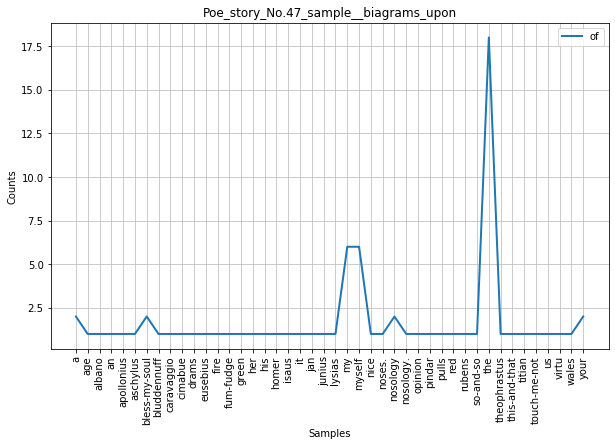

48 
 ['the', 'which', 'a', 'alexander-the-great-o-nopolis', 'taking', 'having', '‘', 'bullethead', 'them', 'nopolis', 'excited', 'yesterday', 'his', 'mr.', 'frogpondium', 'any', 'this', 'advising', 'convincing', 'him', 'some', 'eternity', 'concord', 'your', 'an', 'conscious', 'course', 'all', 'it', 'their', 'pitch', 'fight', 'rare', 'riding', 'sediment', 'opinion', 'fancy', 'so', 'x', 'bob'] dict_items([('the', 11), ('which', 1), ('a', 4), ('alexander-the-great-o-nopolis', 1), ('taking', 1), ('having', 1), ('‘', 3), ('bullethead', 1), ('them', 2), ('nopolis', 2), ('excited', 1), ('yesterday', 1), ('his', 1), ('mr.', 1), ('frogpondium', 1), ('any', 1), ('this', 2), ('advising', 1), ('convincing', 1), ('him', 5), ('some', 1), ('eternity', 1), ('concord', 1), ('your', 1), ('an', 2), ('conscious', 1), ('course', 1), ('all', 1), ('it', 1), ('their', 1), ('pitch', 1), ('fight', 1), ('rare', 1), ('riding', 1), ('sediment', 1), ('opinion', 1), ('fancy', 1), ('so', 1), ('x', 1), ('bob', 1)])


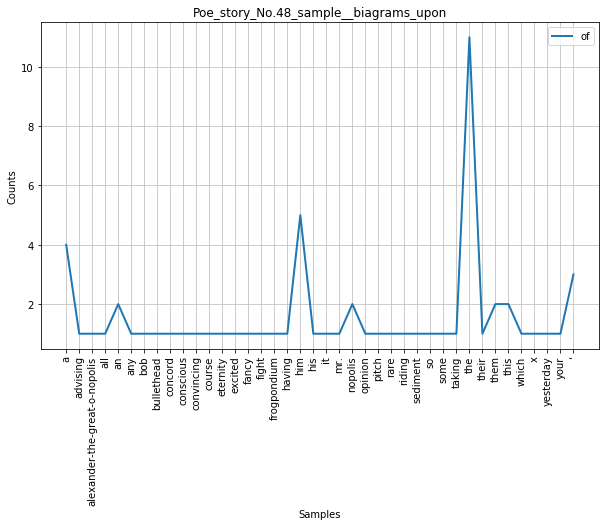

49 
 ['which', 'hungary', 'the', 'their', 'our', 'all', 'an', 'berlifitzing', 'this', 'metzengerstein', 'berlifitzing.', 'a', 'that', 'hereditary', 'course', 'his', 'horses', 'hunting', 'age', 'splendor', 'fifty', 'conduct', 'three', 'conscience', 'papal', 'fallen', 'days', 'imaginary', 'audacity', 'being', 'ruddy', 'its', 'red', 'voice', 'foreign', 'having', 'wilhelm', 'your', 'emotions', 'determined', 'some', 'many', 'self-consequence', 'morbid', 'noon', 'night', 'peculiar', 'exciting', 'triumphant', 'ungovernable', 'human', 'inanimate', 'aged', 'superhuman', 'terror', 'hoofs', 'chaotic', 'preternatural', 'smoke', '?'] dict_items([('which', 1), ('hungary', 2), ('the', 70), ('their', 3), ('our', 1), ('all', 3), ('an', 4), ('berlifitzing', 2), ('this', 2), ('metzengerstein', 4), ('berlifitzing.', 2), ('a', 19), ('that', 5), ('hereditary', 2), ('course', 2), ('his', 19), ('horses', 1), ('hunting', 1), ('age', 1), ('splendor', 1), ('fifty', 1), ('conduct', 1), ('three', 1), ('conscience'

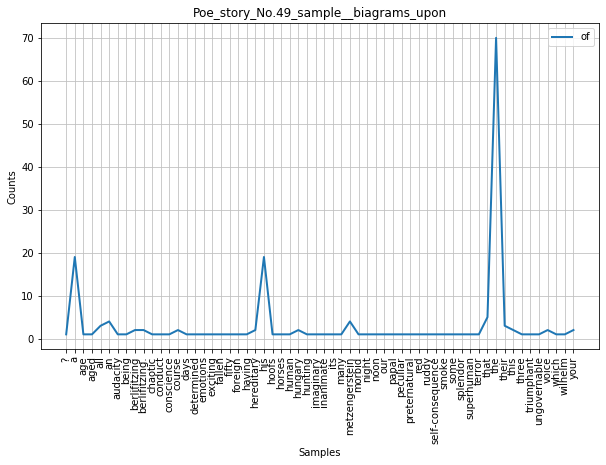

50 
 ['doctor', '18', 'france', 'a', 'the', 'my', 'these', 'maillard', 'lunacy', 'his', 'gravity', 'refined', 'flowers', 'sorrow', 'mingled', 'monsieur', 'soothing', 'them', 'persons', 'mania', 'sanity', 'which', 'course', 'your', 'forethought', 'thoughtlessness', 'our', 'roaming', 'exclusion', 'stupidity', 'acquiescence', 'books', 'all', 'keepers.', 'any', 'some', 'fury', 'france.', 'treatment', 'what', 'others', 'every', 'clos', 'rank-certainly', 'high', 'jewelry', 'brussels', 'oddity', 'antiquated', 'good', 'elegance', 'life', 'wax', 'noises', 'myself', 'thought', 'conventional', 'good-humored', 'this', 'offending', 'taking', 'dressing', 'their', 'that', 'champagne', 'wine', 'it', 'snuff', 'two', 'cicero', 'great', 'her', 'madame', 'eugenie', 'habiliment', 'inside', 'loud', 'reasonable', 'dogs', 'lunatics', 'ma', 'you', 'thing', 'very', 'whom', 'right', 'an', 'either', 'sauterne.', 'phalaris', 'pandemonium', 'sauterne', 'being', 'niagara', 'madmen', 'dr.', 'mind', 'sense', 'governme

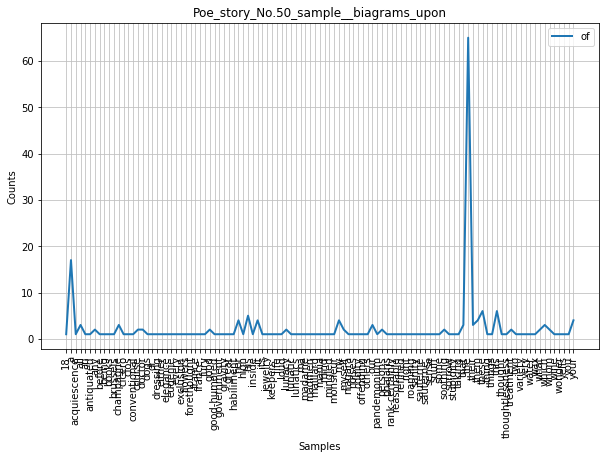

51 
 ['thingum', 'the', 'letters', 'signalizing', 'my', 'him', 'calling', 'america', 'those', 'human', 'one', 'his', 'a', 'smug', 'all', 'what', 'positive', 'our', 'thomas', 'making', 'editor', 'things', 'men', 'ultimate', 'their', 'genius', 'an', 'these', 'brats', 'lines', 'that', 'some', 'remembering', 'them', 'this', 'which', 'imagination', 'poesy', 'us', 'either', 'bitterness', '‘', 'most', 'grace', 'trash', 'woes', 'composing', 'publishing', 'me', 'incoherent', 'heaven', 'about', 'like', 'cruelty', 'study', 'mature', 'no', 'it', 'seeing', 'bob.', 'mankind', 'profound', 'extreme', 'mr.', 'course', 'at', 'himself', 'quacking', 'desperate', 'uplifting', 'compensation', 'pain', 'its', '100,000', 'contributors', 'station', 'dinners', '200,000', 'any', 'pretension', '300,000', 'drivel', 'confounding', 'so', 'sufficient', 'preeminence', 'precisely', 'days', 'eloquence', 'scullion', 'high', 'speech', 'glorifying', 'mine', 'myself', 'by', 'regard', 'astonishment', 'poor-devil', 'playing', 

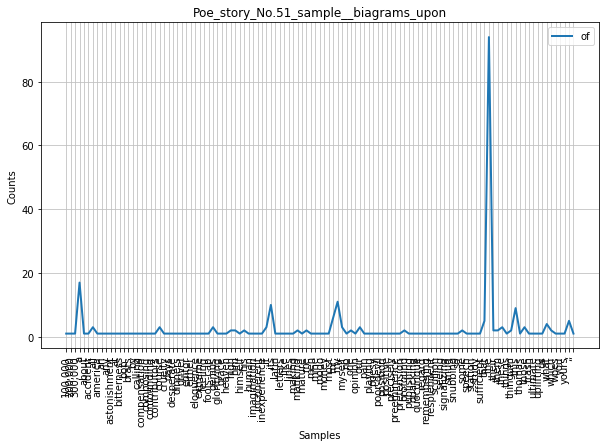

52 
 ['the', 'me', 'psyche', 'green', 'orange-colored', 'a', 'it', 'zenobia', 'arts', 'useful', 'discussion', 'first', 'any', 'things.', 'thinking', 'that', 'course', 'tailor', 'slang-whang.', 'these', 'what', 'writing', 'composition', 'intensities', 'manner', 'intensity', 'however', 'whose', 'articles', 'model', 'his', 'tastes', 'an', 'fire', 'flummery', 'hollands', 'them', 'your', 'garters', 'brandreth', 'misadventure', 'our', 'meaning', 'all', 'archytas', 'scratching', 'equal', 'affairs', 'can.', 'every', 'erudition', 'extensive', 'accomplishing', 'little', 'either', 'similes', 'its', 'java', 'this', 'each', 'combat', 'sense', 'jupiter', 'profundity', 'ultimatum', 'very', 'my', 'which'] dict_items([('the', 28), ('me', 3), ('psyche', 1), ('green', 1), ('orange-colored', 1), ('a', 9), ('it', 4), ('zenobia', 1), ('arts', 1), ('useful', 1), ('discussion', 1), ('first', 1), ('any', 2), ('things.', 1), ('thinking', 1), ('that', 4), ('course', 2), ('tailor', 1), ('slang-whang.', 1), ('thes

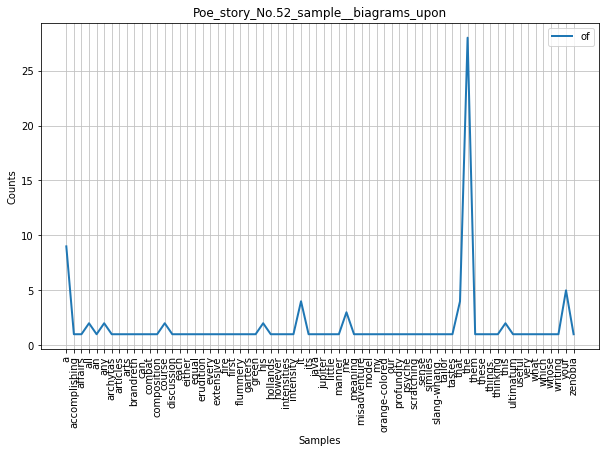

53 
 ['edina', 'gloomy', 'genius', 'a', 'the', 'what', 'recollections', 'things', 'that', 'creatures', 'hair', 'injured', 'age', 'nine', 'them', 'remark', 'which', 'green', 'mystery', 'early', 'too', 'view', 'my', 'man', 'human', 'myself', 'pompey', 'love', 'his', 'black', 'disdain', 'regret', 'java', 'about', 'true', 'wheels', 'your', 'edinburgh', 'an', 'these', 'solid', 'some', 'its', 'forcing', 'time', 'mr.', 'better', 'music', 'dr.', 'breeding', 'exquisite', 'independence', 'skin', 'entire', 'ariosto', 'demosthenes', 'schiller'] dict_items([('edina', 2), ('gloomy', 1), ('genius', 1), ('a', 2), ('the', 50), ('what', 1), ('recollections', 1), ('things', 1), ('that', 5), ('creatures', 1), ('hair', 1), ('injured', 1), ('age', 1), ('nine', 1), ('them', 2), ('remark', 1), ('which', 2), ('green', 1), ('mystery', 1), ('early', 1), ('too', 1), ('view', 1), ('my', 11), ('man', 1), ('human', 2), ('myself', 1), ('pompey', 4), ('love', 1), ('his', 2), ('black', 1), ('disdain', 1), ('regret', 1)

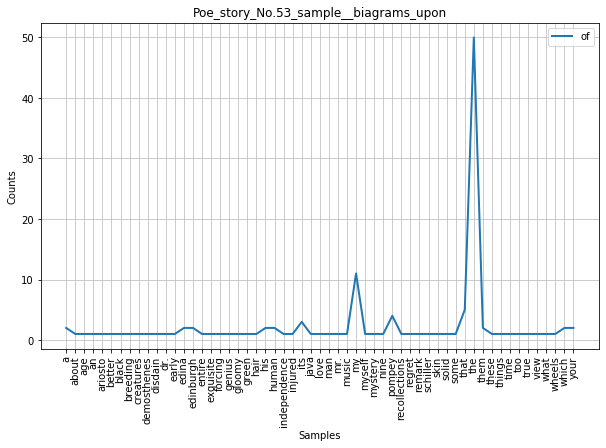

54 
 ['which', 'some', 'grotesquerie', 'the', 'droll', 'curiosity', 'june', 'his', 'people', 'no', 'human', 'unmitigated', 'those', 'mystification', 'their', 'mind', 'myself', 'a', 'heraclitus', 'theology', 'all', 'alma', 'even', 'observation', 'whim', 'society', 'them', 'events', 'wine', 'seven', 'these', 'wealth', 'high', 'great', 'honor', 'etiquette', 'arms', 'manner', 'duelling', 'coleridge', 'one', 'courage', 'this', 'sentiment', 'hermann', 'serious', 'giving', 'countenance', 'conduct', 'personal', 'your', 'resentment', 'physical', 'course', 'my', 'so', 'business', 'musty', 'philip', 'duels', 'elzevir', 'mysterious', 'me', 'feeling', 'perfect', 'our', 'apology', 'discrimination', 'being', 'offering', 'sieur', '“', 'profound', 'confidential', 'second', 'general', 'it', 'meaning', 'du', 'intelligibility', 'profundity', 'ludicrous', 'unusual'] dict_items([('which', 7), ('some', 2), ('grotesquerie', 1), ('the', 37), ('droll', 1), ('curiosity', 1), ('june', 1), ('his', 14), ('people', 

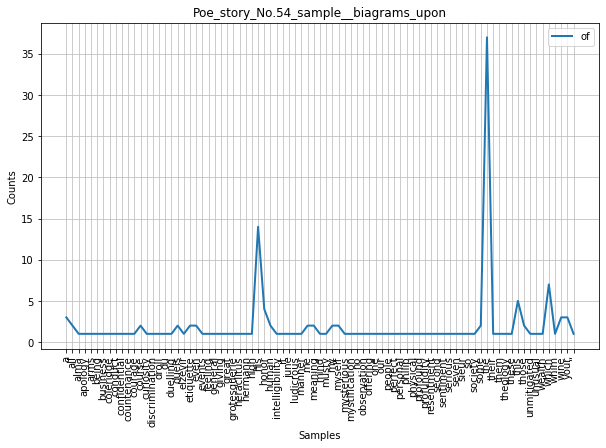

55 
 ['the', 'ways', 'plato', 'picked', 'diddling', 'creatures', 'which', 'magnitude', 'a', 'his', 'patent', 'frey', 'doors', 'ancient', 'another', 'course', 'antiquity', 'by', 'some', 'several', 'bows', 'this', 'an', 'mrs.', 'city', 'value', 'taking', 'advertising', 'north', 'one', 'people', 'these', 'them', 'discussion', 'reaching', 'shillings', 'performing', 'twists', 'tobacco', 'brandy', 'your', 'heading', 'general', 'time', 'ton', 'very', 'its', 'no', 'importance', 'her', 'real', 'business', 'mere', 'every', 'it', 'solomon', 'three', 'money', 'those', 'fifty', 'morality', 'ten', 'messrs.', 'each', 'proper', 'bogs', 'neglect'] dict_items([('the', 38), ('ways', 1), ('plato', 1), ('picked', 1), ('diddling', 1), ('creatures', 1), ('which', 4), ('magnitude', 1), ('a', 10), ('his', 5), ('patent', 1), ('frey', 1), ('doors', 2), ('ancient', 1), ('another', 1), ('course', 2), ('antiquity', 1), ('by', 1), ('some', 1), ('several', 1), ('bows', 1), ('this', 3), ('an', 2), ('mrs.', 1), ('city'

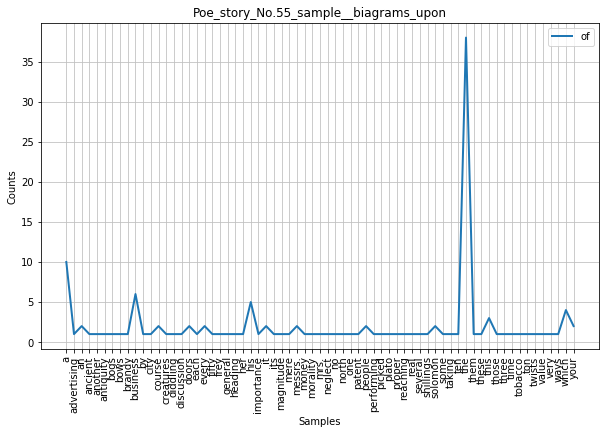

56 
 ['the', 'which', 'wine', 'frequent', '“', 'its', 'four', 'a', 'some', 'accidents', 'improbable', 'my', 'late', 'all', 'lafitte', 'trepidation', 'looking', 'that', 'legs', 'was', 'those', 'your', 'one', 'port', 'his', 'mankind', 'mine', 'rendering', 'consequence', 'insurance', 'directors', 'odd', 'six', 'course', 'kirschenwasser', 'an', 'this', 'her', 'events', 'sight', 'brandy-saturated', 'resigning', 'impudence', 'te'] dict_items([('the', 42), ('which', 2), ('wine', 1), ('frequent', 1), ('“', 3), ('its', 1), ('four', 1), ('a', 8), ('some', 5), ('accidents', 1), ('improbable', 1), ('my', 16), ('late', 1), ('all', 1), ('lafitte', 2), ('trepidation', 1), ('looking', 1), ('that', 1), ('legs', 1), ('was', 1), ('those', 1), ('your', 1), ('one', 1), ('port', 1), ('his', 2), ('mankind', 1), ('mine', 1), ('rendering', 1), ('consequence', 1), ('insurance', 1), ('directors', 1), ('odd', 1), ('six', 1), ('course', 1), ('kirschenwasser', 2), ('an', 2), ('this', 2), ('her', 1), ('events', 1), 

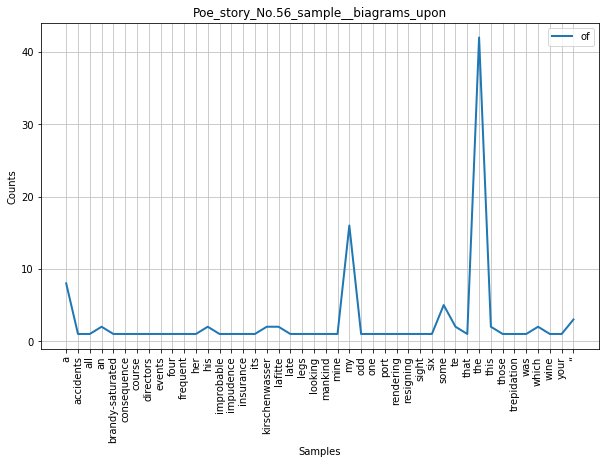

57 
 ['the', 'sending', 'an', 'a', 'pleasure', 'touching', 'my', 'progress', 'them', 'our', 'perceiving', 'travelling', 'giddiness', 'prey', 'five', 'earth-worm', 'fruit', 'processes', 'female', 'material', 'silk', 'its', 'gum', 'twist', 'drag-ropes', 'about', 'passengers', 'course', 'sight', 'humanity', 'his', 'floating', 'telegraph', 'interest', 'individuals', 'balloons', 'so', 'human', 'traversing', 'madman', 'science', 'old', 'truth', 'time', 'investigation', 'one', 'all', 'years', 'ages', 'imagination', 'these', 'little', 'light', 'which', 'their', 'in', 'him', 'some', 'axiomatic', 'disputing', 'creeping', 'crawling', 'gravitation', 'metaphysics', 'contempt', 'more', 'consistency', 'god', 'this', 'ardent', 'scorn', 'inconsistency', 'at', 'nearly', 'external', 'track', 'nothing', 'such', 'every-man-for-himself', 'gradation', 'votes', 'prevention', 'new', 'mob', 'forgetting', 'government', 'alpha', 'half', 'gravity', '117,000,000', 'non-luminosity', 'glorious', 'straight', 'it', 'li

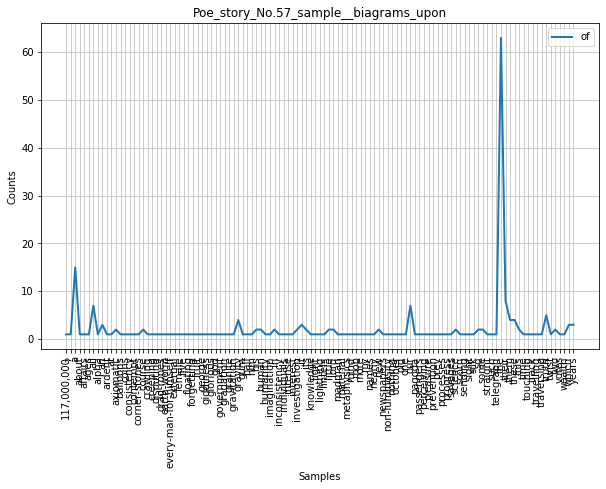

58 
 ['“', 'an', 'apicius', 'the', 'his', 'cadet', 'soft', 'birds', 'men', 'disgust', 'hauteur', 'putting', 'age', 'paper', 'cemeteries', 'linen', 'no', 'avenging', 'fiery-colored', 'boston', 'such', 'poppies', 'these', 'gigantic', 'those', 'all', 'abbe', 'francis'] dict_items([('“', 1), ('an', 2), ('apicius', 1), ('the', 13), ('his', 4), ('cadet', 1), ('soft', 1), ('birds', 1), ('men', 1), ('disgust', 1), ('hauteur', 1), ('putting', 1), ('age', 1), ('paper', 1), ('cemeteries', 1), ('linen', 1), ('no', 1), ('avenging', 1), ('fiery-colored', 1), ('boston', 1), ('such', 1), ('poppies', 1), ('these', 1), ('gigantic', 1), ('those', 1), ('all', 1), ('abbe', 1), ('francis', 1)])


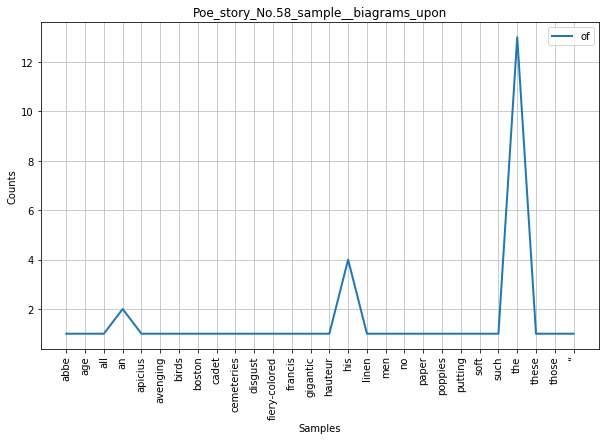

59 
 ['new', 'the', 'ladies', 'my', 'mr.', 'warm', 'genius', 'misanthropy', 'passengers', 'those', 'mind', 'ill-bred', 'mine', 'course', 'so', 'enthusiasm', 'surpassing', 'being', 'sailing.', 'his', 'moody', 'woman', 'leonardo', 'this', 'nicolino', 'cornelius', 'albany', 'these', 'him', 'what', 'her', 'fate', 'enthusiastic', 'mirth', 'covert', 'pleasant', 'opening', 'that', 'wyatt', 'all', 'it', 'a', 'mrs.', 'artistic', 'which', 'any', 'its', 'water', 'saving', 'good', 'even', 'captain', 'taking', 'heaven', 'salvation', 'strength', 'astonishment', 'intense', 'poor', 'june', 'salt', 'suitable', 'late'] dict_items([('new', 1), ('the', 41), ('ladies', 1), ('my', 10), ('mr.', 3), ('warm', 1), ('genius', 1), ('misanthropy', 1), ('passengers', 1), ('those', 1), ('mind', 1), ('ill-bred', 1), ('mine', 1), ('course', 7), ('so', 1), ('enthusiasm', 1), ('surpassing', 1), ('being', 1), ('sailing.', 1), ('his', 12), ('moody', 1), ('woman', 1), ('leonardo', 1), ('this', 3), ('nicolino', 1), ('cornel

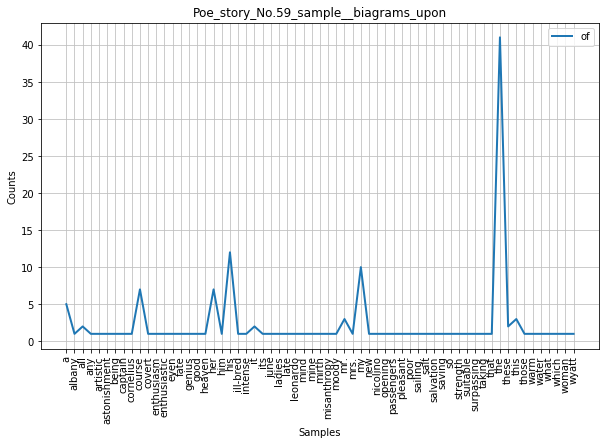

60 
 ['breath', 'philosophy', 'an', 'the', 'a', 'iniquity', 'all', 'opprobrium', 'her', 'which', 'propriety', 'this', 'calamity', 'arch', 'my', 'utterance', 'voice', 'no', 'suicide', 'human', 'atrocities', 'its', 'vague', 'absurdity', 'false', 'hips', 'billets-doux', 'mrs.', 'grandjean', 'archangels', 'recommending', 'eluding', 'success', '“', 'such', 'it', 'demosthenes', 'those', 'confining', 'having', 'colossal', 'phalaris', 'demonstrating', 'his', 'both', 'animation', 'information', 'mortification', 'speech', 'elevating', 'cyrus', 'persia', 'babylon', 'contempt', 'remaining', 'sight', '(', 'their', 'destination', 'course', 'experience', 'ladies', 'marston', 'amusement', 'crabbe', 'flames', 'mountains', 'pelion', 'self-moving', 'unwelcome', 'compassioning', 'mortality', 'tall', '!', 'them', 'lombardy', 'relieving', 'mr.', 'thine', 'physical', 'incurring', 'our', 'subterranean', 'some', 'that', 'heaven'] dict_items([('breath', 5), ('philosophy', 2), ('an', 5), ('the', 38), ('a', 21), 

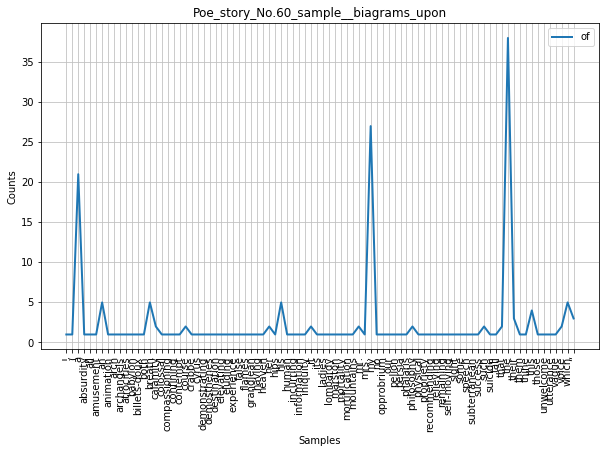

61 
 ['the', 'that', 'great', 'anxious', 'either', 'mystery', 'any', 'agitation', 'a', 'high', 'smith', 'melancholy', 'hair', 'his', 'these', 'whiskers', 'all', 'surpassing', 'eyes', 'such', 'interesting', 'shoulders', 'conscious', 'good', 'brevet', 'je', 'measured', 'rectangular', 'affectation', 'reserve', 'what', 'colossal', 'comment', 'valor', 'him', 'course', 'teeth', 'greater', 'delicacy', 'philosophical', 'mechanical', 'electro', 'invention', 'mine', 'affairs', 'wretches', 'dignified', 'satisfying', 'those', 'affability', 'my', 'stage', 'shakespeare', 'which', 'hearing', 'ill', 'you', 'breath', 'deciding', 'lord', 'animosity', 'drawling', 'being', 'this', 'something', 'coming', 'it', 'pompey'] dict_items([('the', 30), ('that', 4), ('great', 2), ('anxious', 1), ('either', 1), ('mystery', 2), ('any', 1), ('agitation', 1), ('a', 9), ('high', 1), ('smith', 2), ('melancholy', 1), ('hair', 1), ('his', 11), ('these', 2), ('whiskers', 1), ('all', 1), ('surpassing', 1), ('eyes', 1), ('suc

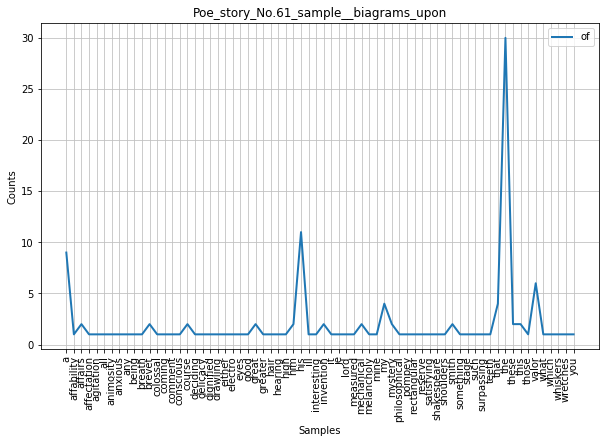

62 
 ['business', 'order', 'a', 'pine-knots', 'things', 'their', 'those', 'that', 'the', 'accuracy', 'my', 'me', 'age', 'what', 'fiddlestick', 'this', 'fever', 'thing', 'boys', 'these', 'being', 'in', 'him', 'public', 'all', 'ingrates', 'proud', 'two', 'honor', 'three', 'foolscap', 'fifty', 'messrs.', 'one', 'putting', 'them', 'fancy', 'course', 'five', 'our', 'methodical', 'men', 'books', 'blowing', 'which', 'bag', 'his', 'finding', 'champagne', 'mr', 'suit', 'no', 'snap', 'body', 'shape', 'mud', 'system', 'pantaloons', 'snuff', 'capital', 'having', 'demnition', 'employment', 'great', 'sham', 'each', 'conscience', 'late', 'toms', 'macassar'] dict_items([('business', 7), ('order', 2), ('a', 5), ('pine-knots', 1), ('things', 1), ('their', 2), ('those', 1), ('that', 2), ('the', 25), ('accuracy', 1), ('my', 7), ('me', 1), ('age', 2), ('what', 1), ('fiddlestick', 1), ('this', 4), ('fever', 1), ('thing', 1), ('boys', 1), ('these', 3), ('being', 1), ('in', 1), ('him', 1), ('public', 1), ('al

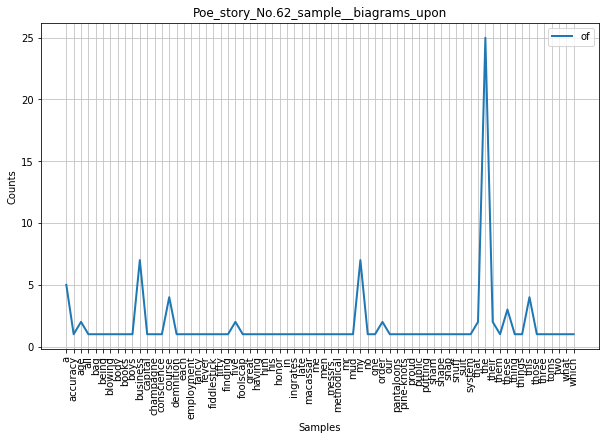

63 
 ['heaven', 'light', 'dew', 'good', 'the', 'whom', 'foreshadowing', 'turgot', 'exemplifying', 'ellison', 'bliss', 'his', 'a', 'humanity', 'mankind', 'content', 'all', 'observation', 'preconcert', 'experience', 'unhappiness', 'preeminent', 'my', 'free', 'woman', 'ambition', 'unceasing', 'happiness', 'this', 'that', 'knowledge', 'women', 'those', 'fate', 'suffering', 'investment', 'blood', 'four', 'dollars', 'course', 'its', 'any', 'money', 'nobility', 'virtu', 'letters', 'charity', 'supposition', 'at', 'utterly', 'discussion', 'novel', 'beauty', 'purely', 'an', 'genius', 'accidents', 'mind', 'triumphant', 'art', 'which', 'music', 'sculpture', 'expatiating', 'opportunities', 'invention', 'forms', 'nature', 'scenery', 'claude', 'natural', 'improvement', 'offence', 'portraiture', 'points', 'human', 'their', 'generalization', 'matter', 'form', '“', 'view', 'beings', 'our', 'landscape-gardening', 'size', 'gardening', 'building', 'versailles', 'pure', 'order', 'care', '‘', 'speech', 'avoi

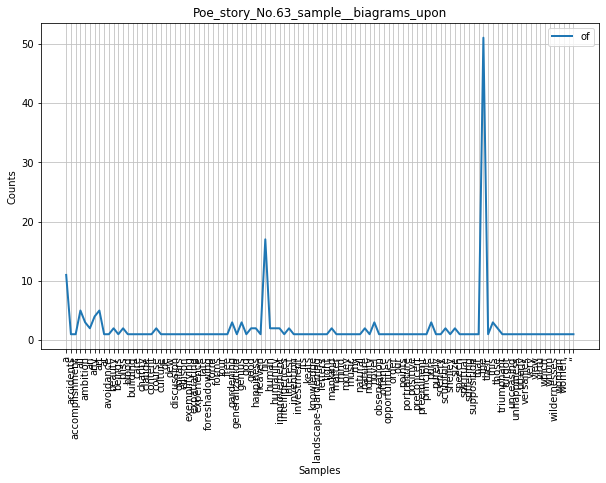

64 
 ['the', 'maelzel', 'intense', 'its', 'mechanical', 'great', 'mankind', 'either', 'louis', 'wood', 'm.', 'notice', 'it', 'dr.', 'mechanism', 'answering', 'a', 'questions', 'these', 'brass', 'an', 'which', 'vaucanson', 'life', 'quacking', 'mr.', 'correcting', 'man', 'unerring', 'so', 'chess', 'necessity', 'each', 'his', 'such', 'our', 'witnessing', 'presburg', 'late', 'all', 'richmond', 'automaton', 'maple', 'this', 'both', 'equal', 'keys', 'them', 'machinery', 'chessmen', 'that', 'steel', 'having', 'any', 'chess-men', 'squares', 'course', 'collusion', 'exciting', 'triumph', 'reasoning', 'in', 'reference', 'minute', 'exhibiting', 'other', 'no', 'proving', 'baron', 'reach', 'door', 'cupboard', 'discovery', 'gauze', 'about', 'different', 'time', 'regularity', 'irregularity', 'making', 'complexity', 'setting', 'perspective', 'mirrors', 'being', 'giving', 'convincing', 'wax-works', 'inability', 'intentional', 'artificiality', 'their', 'persons', 'pure', 'impressing', 'words', 'magnitude

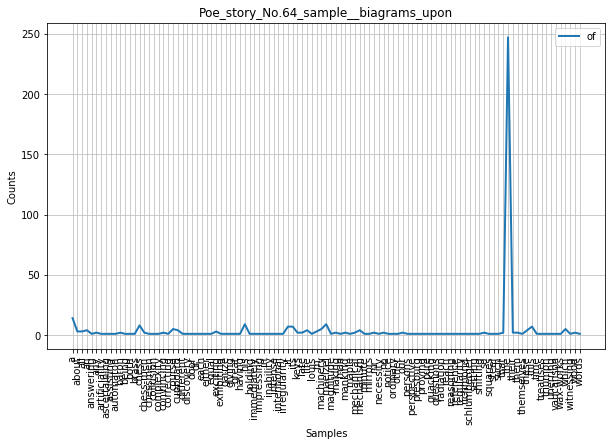

65 
 ['words', 'a', 'intuition', 'the', 'all', 'knowledge', 'matter', 'this', 'what', 'creation', 'animalculae', 'which', 'nonentity', 'our', 'exact', 'given', 'any', 'these', 'algebraic', 'analysis', 'him', 'deep', 'infinite', 'time', 'an', 'old', 'new', 'retrogradation', 'referring', 'course', 'degree', 'impulses', 'whatever', 'my', 'hearts'] dict_items([('words', 2), ('a', 3), ('intuition', 1), ('the', 30), ('all', 6), ('knowledge', 1), ('matter', 2), ('this', 1), ('what', 2), ('creation', 3), ('animalculae', 1), ('which', 1), ('nonentity', 1), ('our', 1), ('exact', 1), ('given', 1), ('any', 1), ('these', 2), ('algebraic', 1), ('analysis', 1), ('him', 1), ('deep', 1), ('infinite', 2), ('time', 1), ('an', 1), ('old', 1), ('new', 1), ('retrogradation', 1), ('referring', 1), ('course', 1), ('degree', 1), ('impulses', 2), ('whatever', 1), ('my', 1), ('hearts', 1)])


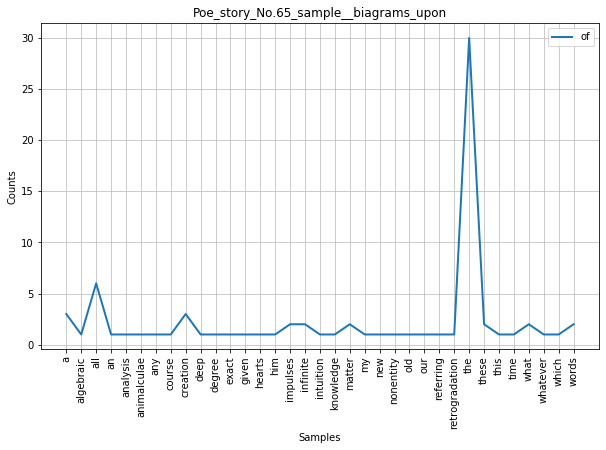

66 
 ['monos', 'the', 'death', 'old', 'that', 'these', 'past', 'your', 'her', 'man', 'life', 'love', 'our', 'all', 'knowledge', 'its', 'his', 'rough', 'nature', 'universal', 'analogy', 'god', 'gradation', 'furnaces', 'some', 'plato', 'mankind', 'highest', 'china', 'paradise', 'duration', 'pain', 'dreamy', 'which', 'sentience', 'him', 'flowers', 'precision', 'sensibility', 'pleasure', 'moral', 'sad', 'a', 'my', 'shrieks', 'terror', 'horror', 'wo', 'surf', 'each', 'melodious', 'time', 'this', 'such', 'abstract', 'any', 'events', 'electricity', 'contact', 'what', 'entity', 'one', 'those', 'being', 'mere', 'place', 'enduring', 'una'] dict_items([('monos', 1), ('the', 45), ('death', 2), ('old', 1), ('that', 1), ('these', 2), ('past', 1), ('your', 2), ('her', 1), ('man', 2), ('life', 1), ('love', 1), ('our', 3), ('all', 4), ('knowledge', 2), ('its', 4), ('his', 3), ('rough', 1), ('nature', 2), ('universal', 1), ('analogy', 1), ('god', 1), ('gradation', 1), ('furnaces', 1), ('some', 2), ('pla

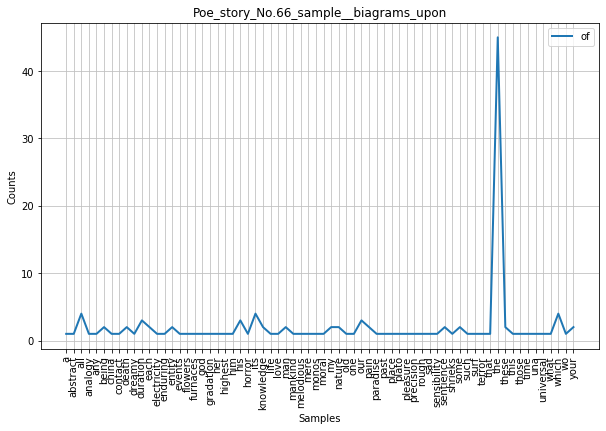

67 
 ['eiros', 'these', 'the', 'heart', 'stupor', 'your', 'many', 'their', 'it', 'pain', 'all', 'this', 'simple', 'that', 'familiar', 'intense', 'discussion', 'flame', 'jupiter', 'inconceivable', 'doing', 'contact', 'late', 'a', 'agitation', 'secondary', 'even', 'very', 'men', 'fear', 'loved', 'her', 'our', 'which', 'fire', 'no', 'elaborate', 'slight', 'probable', 'possible', 'any', 'evil', 'emotion', 'rare', 'frame', 'mind', 'foliage', 'investigation', 'man', 'oxygen', 'twenty-one', 'nitrogen', 'combustion', 'heat', 'animal', 'supporting', 'mankind', 'despair', 'fate', 'hope', 'him', 'ether', 'pure'] dict_items([('eiros', 1), ('these', 3), ('the', 38), ('heart', 1), ('stupor', 1), ('your', 1), ('many', 1), ('their', 2), ('it', 3), ('pain', 3), ('all', 4), ('this', 3), ('simple', 1), ('that', 1), ('familiar', 1), ('intense', 2), ('discussion', 2), ('flame', 1), ('jupiter', 2), ('inconceivable', 1), ('doing', 1), ('contact', 1), ('late', 1), ('a', 8), ('agitation', 1), ('secondary', 1),

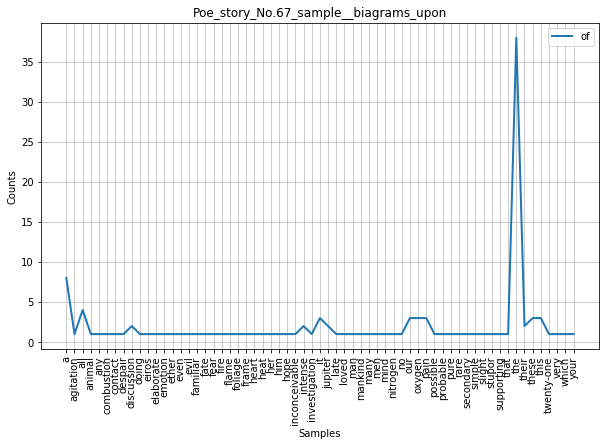

68 
 ['the', 'david', 'shadows', 'men', 'iron', 'terror', 'feelings', 'ill', 'that', 'aries', 'mankind', 'a', 'seven', 'brass', 'rare', 'evil', 'which', 'suffocation', 'existence', 'thought', 'light', 'ebony', 'us', 'his', 'anacreon', 'blood', 'our', 'young', 'those', 'their', 'teios', 'man', 'god', 'any', 'greece', 'chaldaea', 'ptolemais', 'helusion', 'beings', 'many'] dict_items([('the', 22), ('david', 1), ('shadows', 1), ('men', 1), ('iron', 1), ('terror', 1), ('feelings', 1), ('ill', 1), ('that', 1), ('aries', 1), ('mankind', 1), ('a', 3), ('seven', 1), ('brass', 2), ('rare', 1), ('evil', 1), ('which', 1), ('suffocation', 1), ('existence', 1), ('thought', 1), ('light', 1), ('ebony', 2), ('us', 1), ('his', 2), ('anacreon', 1), ('blood', 1), ('our', 1), ('young', 1), ('those', 1), ('their', 1), ('teios', 1), ('man', 2), ('god', 2), ('any', 2), ('greece', 1), ('chaldaea', 1), ('ptolemais', 1), ('helusion', 1), ('beings', 1), ('many', 1)])


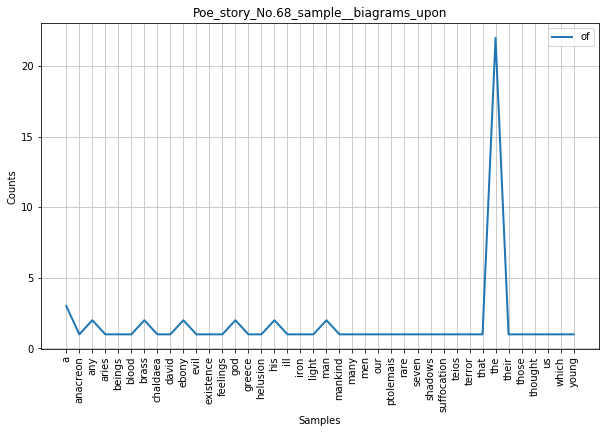

In [90]:
my_makedirs(new_dir_path_png_biagram_plot)

for i in range(len(read_book_list)):
    tokens = read_book_list[i]  
    tokens_l = [w.lower() for w in tokens] 
    tokens_l
    bigrams = nltk.bigrams(tokens_l)
    bigrams 
    cfd = nltk.ConditionalFreqDist(bigrams)
    print(i , "\n", list(cfd['of']), cfd["of"].items())
    #cfd_no_punc = nltk.FreqDist(dict((word, freq) for word, freq in cfd["of"].items() if word.isalpha()))
    #fdist_no_punc.plot()
    #print(cfd_no_punc[i])
    
    title_ =  str(author[choice[index_i]])+str('_')+str(type_[choice[index_j]])+"_No." + str(i) +str('_sample_')+ "_biagrams_" + str(prep_list[5])
        
    fig = plt.figure(figsize = (10,6))
    cfd.plot(conditions=['of'], title = title_)
    filename = new_dir_path_png_biagram_plot + "/" + title_ +".png"
    fig.savefig(filename)
    

In [91]:
##頻度付きで共起の結果を得
fd.items()

dict_items([(('shadow', '?'), 2), (('?', 'a'), 3), (('a', 'parable'), 1), (('parable', 'yea'), 1), (('yea', ','), 1), ((',', 'though'), 1), (('though', 'i'), 1), (('i', 'walk'), 1), (('walk', 'through'), 1), (('through', 'the'), 1), (('the', 'valley'), 1), (('valley', 'of'), 1), (('of', 'the'), 22), (('the', 'shadow'), 10), (('shadow', ':'), 1), ((':', '?'), 1), (('?', 'psalm'), 1), (('psalm', 'of'), 1), (('of', 'david'), 1), (('david', '.'), 1), (('.', 'ye'), 1), (('ye', 'who'), 1), (('who', 'read'), 1), (('read', 'are'), 1), (('are', 'still'), 1), (('still', 'among'), 1), (('among', 'the'), 4), (('the', 'living'), 1), (('living', ';'), 1), ((';', 'but'), 1), (('but', 'i'), 1), (('i', 'who'), 1), (('who', 'write'), 1), (('write', 'shall'), 1), (('shall', 'have'), 1), (('have', 'long'), 1), (('long', 'since'), 1), (('since', 'gone'), 1), (('gone', 'my'), 1), (('my', 'way'), 1), (('way', 'into'), 1), (('into', 'the'), 3), (('the', 'region'), 1), (('region', 'of'), 1), (('of', 'shadows')

# 単語が、テキストのどのぐらいの位置に出現するかを可視化

In [92]:
nltk.Text(read_book_list[i]), nltk.Text(read_book_list[i]), 

(<Text: SHADOW ? A PARABLE Yea , though I...>,
 <Text: SHADOW ? A PARABLE Yea , though I...>)

In [93]:
prep_list

['and', 'the', 'that', 'of', 'was', 'upon', 'not', 'when', 'then']

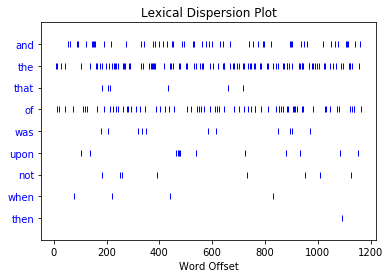

In [94]:
#単語が、テキストのどのぐらいの位置に出現するかを可視化
(nltk.Text(read_book_list[i])).dispersion_plot(prep_list)

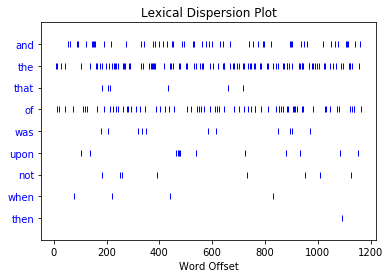

In [98]:
(nltk.Text(read_book_list[i])).dispersion_plot(prep_list)

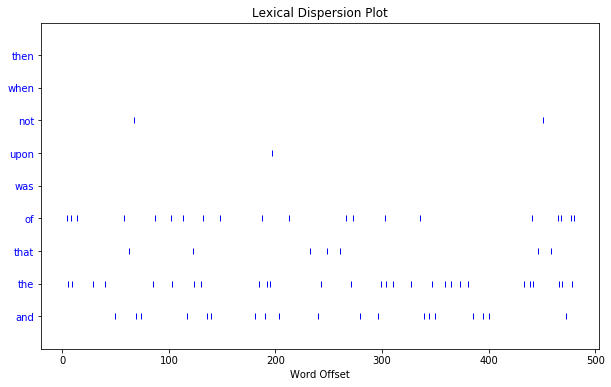

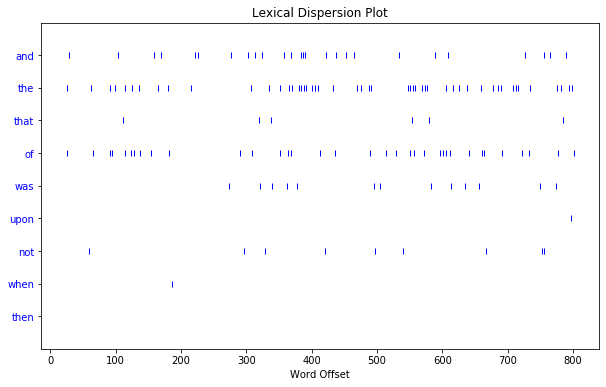

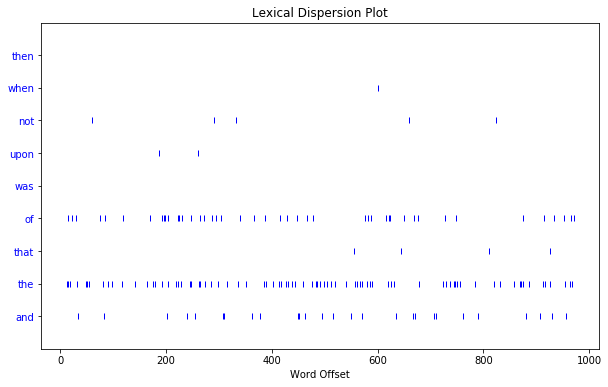

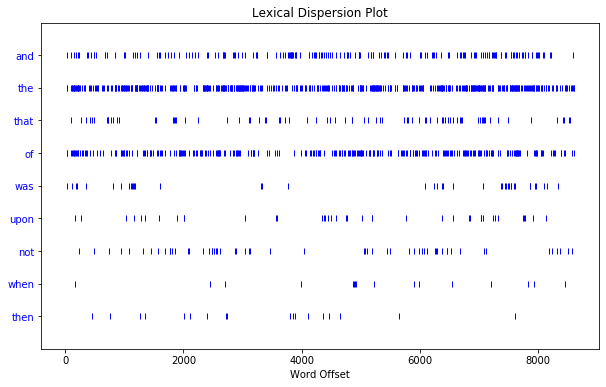

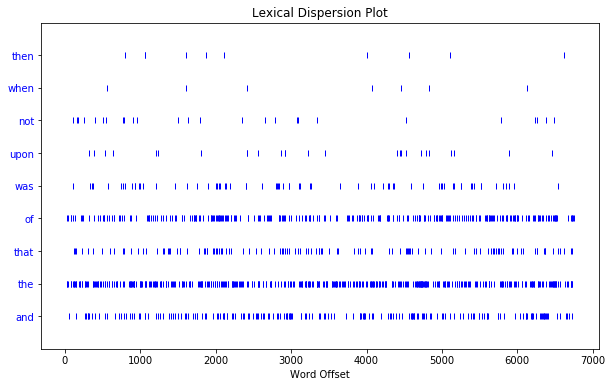

...

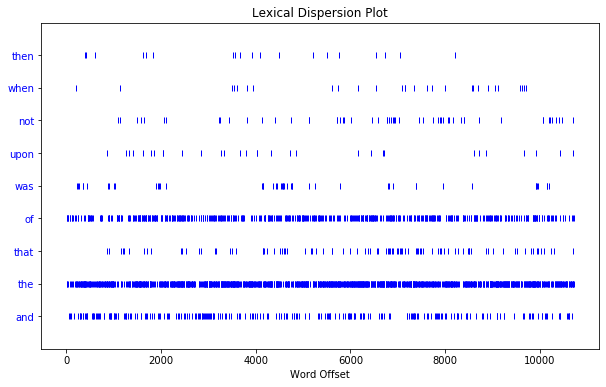

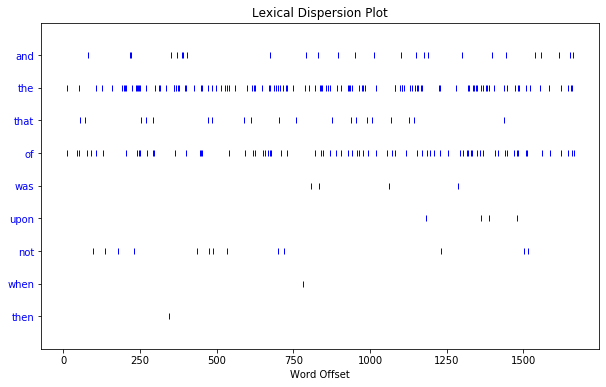

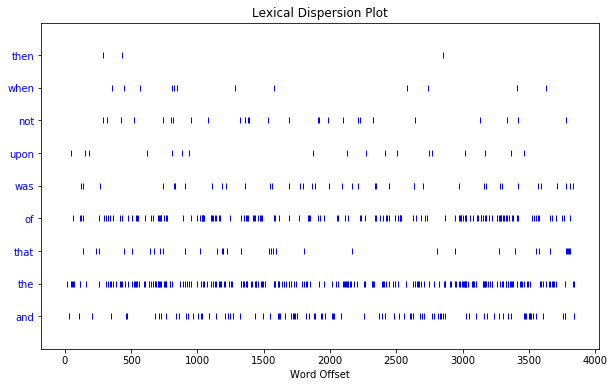

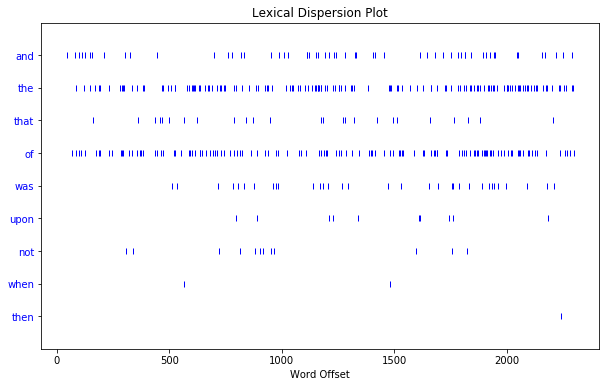

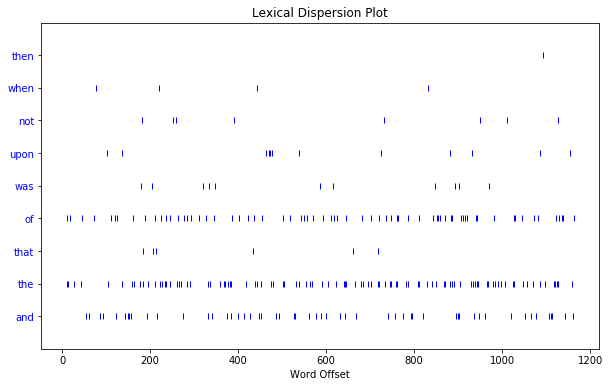

In [95]:
my_makedirs(new_dir_path_png_dispersion_plot)

for i in range(len(read_book_list)):
    fig = plt.figure(figsize = (10,6))
    nltk.Text(read_book_list[i]).dispersion_plot(prep_list)
    filename = new_dir_path_png_dispersion_plot + "/" + "_No." +str(i)+".png"
    fig.savefig(filename)

# Appendix

In [96]:
#変な文字列を除去
s = 'one two one two one 乬'

print(s.replace('乬', '-'))
# one-two-one-two-one

#変な文字を除去
s = 'one two one two one乬'
print(s.translate(str.maketrans({'乬': 'O', 't': 'T'})))
# One TwO One TwO One

print(s.translate(str.maketrans({'乬': None, 't': 'T'})))
# XXXne wXXX XXXne wXXX XXXne

one two one two one -
one Two one Two oneO
one Two one Two one
